# Exercises  

This notebook focuses on **data understanding and preparation** for a particular problem and dataset.
The data comes from the Residential Property Price Register (RPPR) (https://www.propertypriceregister.ie/website/npsra/pprweb.nsf/page/ppr-home-en). The Residential Property Price Register is produced by the Property Services Regulatory Authority (PSRA). It includes Date of Sale, Price and Address of all residential properties purchased in Ireland since the 1st January 2010, until 5th May 2023, as declared to the Revenue Commissioners for stamp duty purposes. In this analysis, **we focus on using the data collected by RPPR to build a data analytics solution for residential property price prediction**. 

We will work with the full set of the data collected in a CSV file. There are 4 parts in this notebook:


(1). Prepare a data quality report for your CSV file. 

(2). Prepare a data quality plan for the cleaned CSV file. 
        
(3). Exploring relationships between feature pairs.
    
(4). Create a few new features (at least 3) with the aim to better capture the problem domain and the target outcome. 

In [1]:
# import packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.backends.backend_pdf import PdfPages


In [2]:
# load dataset
df = pd.read_csv('PPR-ALL.csv', encoding = 'unicode_escape')

/var/folders/bn/6x11zktd6n14vfwyb0jymgt00000gp/T/ipykernel_31017/4033051617.py:2: DtypeWarning: Columns (3,8) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('PPR-ALL.csv', encoding = 'unicode_escape')


In [3]:
# show dataset details
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 596528 entries, 0 to 596527
Data columns (total 9 columns):
 #   Column                     Non-Null Count   Dtype 
---  ------                     --------------   ----- 
 0   Date of Sale (dd/mm/yyyy)  596528 non-null  object
 1   Address                    596528 non-null  object
 2   County                     596528 non-null  object
 3   Eircode                    91579 non-null   object
 4   Price ()                  596528 non-null  object
 5   Not Full Market Price      596528 non-null  object
 6   VAT Exclusive              596528 non-null  object
 7   Description of Property    596528 non-null  object
 8   Property Size Description  52816 non-null   object
dtypes: object(9)
memory usage: 41.0+ MB


# 1 - Prepare a data quality report for your CSV file. 

<b> - Check how many rows and columns your CSV has. </b>

In [4]:
# Check how many rows and columns this dataframe has
df.shape

(596528, 9)

 <b> - Print the first and the last 5 rows. </b>

In [5]:
# check first 5 rows
df.head(5)

,Date of Sale (dd/mm/yyyy),Address,County,Eircode,Price (),Not Full Market Price,VAT Exclusive,Description of Property,Property Size Description
0,01/01/2010,"5 Braemor Drive, Churchtown, Co.Dublin",Dublin,NaN,"343,000.00",No,No,Second-Hand Dwelling house /Apartment,NaN
1,03/01/2010,"134 Ashewood Walk, Summerhill Lane, Portlaoise",Laois,NaN,"185,000.00",No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
2,04/01/2010,"1 Meadow Avenue, Dundrum, Dublin 14",Dublin,NaN,"438,500.00",No,No,Second-Hand Dwelling house /Apartment,NaN
3,04/01/2010,"1 The Haven, Mornington",Meath,NaN,"400,000.00",No,No,Second-Hand Dwelling house /Apartment,NaN
4,04/01/2010,"11 Melville Heights, Kilkenny",Kilkenny,NaN,"160,000.00",No,No,Second-Hand Dwelling house /Apartment,NaN


In [6]:
# check last 5 rows
df.tail(5)

,Date of Sale (dd/mm/yyyy),Address,County,Eircode,Price (),Not Full Market Price,VAT Exclusive,Description of Property,Property Size Description
596523,05/05/2023,"Palmersgate, Kennelsfort Road Lower, Palmerstown",Dublin,NaN,"2,116,150.75",No,No,New Dwelling house /Apartment,NaN
596524,05/05/2023,"PARK RD, SWINFORD, MAYO",Mayo,F12F992,"190,000.00",No,No,Second-Hand Dwelling house /Apartment,NaN
596525,05/05/2023,"SPRING COTTAGE, SHALLON, THE WARD",Dublin,D11P582,"740,000.00",No,No,Second-Hand Dwelling house /Apartment,NaN
596526,05/05/2023,"THE ORCHARD, GARRYHILL, CARLOW",Carlow,R21H683,"375,000.00",No,No,Second-Hand Dwelling house /Apartment,NaN
596527,05/05/2023,"TULLYCROSS MOYDRUM, ATHLONE, WESTMEATH",Westmeath,N37TY28,"381,000.00",No,No,Second-Hand Dwelling house /Apartment,NaN


 <b> - Convert the features to their appropriate data types (e.g., decide which features are more appropriate as continuos and which ones as categorical types).  </b>

In [7]:
# Firstly look at column names
df.columns

Index(['Date of Sale (dd/mm/yyyy)', 'Address', 'County', 'Eircode',
       'Price ()', 'Not Full Market Price', 'VAT Exclusive',
       'Description of Property', 'Property Size Description'],
      dtype='object')

In [8]:
# Clean the column names to remove white space after the name or in the name
df.columns = df.columns.str.replace(' ', '')

# Look at column names
df.columns

Index(['DateofSale(dd/mm/yyyy)', 'Address', 'County', 'Eircode', 'Price()',
       'NotFullMarketPrice', 'VATExclusive', 'DescriptionofProperty',
       'PropertySizeDescription'],
      dtype='object')

In [9]:
# check type of each feature
df.dtypes

DateofSale(dd/mm/yyyy)     object
Address                    object
County                     object
Eircode                    object
Price()                   object
NotFullMarketPrice         object
VATExclusive               object
DescriptionofProperty      object
PropertySizeDescription    object
dtype: object

Date of Sale (dd/mm/yyyy) should have datetime data.   I might create two separate columns later that identify both the date and month, in which case it will be useful to have datetime data.   Datetime data will also make it possible to plot this feature on a histogram.

In [10]:
# convert date of sale data from string to datetime data type
df['DateofSale(dd/mm/yyyy)'] = pd.to_datetime(df['DateofSale(dd/mm/yyyy)'], format="%d/%m/%Y")


- I will rename the date and price columns to remove special characters, making them easier to manipulate.

In [11]:
# rename columns
df = df.rename({'Price()': 'Price', 'DateofSale(dd/mm/yyyy)': 'DateofSale'}, axis='columns')
df.columns

Index(['DateofSale', 'Address', 'County', 'Eircode', 'Price',
       'NotFullMarketPrice', 'VATExclusive', 'DescriptionofProperty',
       'PropertySizeDescription'],
      dtype='object')

- Price data is currently string data when it should be of type float in order to be considered continuous data.   To convert this feature's data type, I will remove '€' from each row in the Price column.

In [12]:
# remove '€' and ',' characters from each row of Price and convert its data type to float
df['Price'] = df['Price'].replace('[\,)]','', regex=True)
df['Price'] = df['Price'].astype('float64')

In [13]:
# check first 5 rows
df.head(5)

,DateofSale,Address,County,Eircode,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
0,2010-01-01,"5 Braemor Drive, Churchtown, Co.Dublin",Dublin,NaN,343000.0,No,No,Second-Hand Dwelling house /Apartment,NaN
1,2010-01-03,"134 Ashewood Walk, Summerhill Lane, Portlaoise",Laois,NaN,185000.0,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
2,2010-01-04,"1 Meadow Avenue, Dundrum, Dublin 14",Dublin,NaN,438500.0,No,No,Second-Hand Dwelling house /Apartment,NaN
3,2010-01-04,"1 The Haven, Mornington",Meath,NaN,400000.0,No,No,Second-Hand Dwelling house /Apartment,NaN
4,2010-01-04,"11 Melville Heights, Kilkenny",Kilkenny,NaN,160000.0,No,No,Second-Hand Dwelling house /Apartment,NaN


In [14]:
# Check type of each feature
df.dtypes

DateofSale                 datetime64[ns]
Address                            object
County                             object
Eircode                            object
Price                             float64
NotFullMarketPrice                 object
VATExclusive                       object
DescriptionofProperty              object
PropertySizeDescription            object
dtype: object

<b> - Look for duplicate rows and columns. Consider whether it makes sense to keep them or drop them. </b>

In [15]:
# Print the number of duplicates, without the original rows that were duplicated
print('Number of duplicate (excluding first) rows in the table is: ', df.duplicated().sum())

# Check for duplicate rows. 
# Use "keep=False" to mark all duplicates as true, including the original rows that were duplicated.
print('Number of duplicate rows (including first) in the table is:', df[df.duplicated(keep=False)].shape[0])


Number of duplicate (excluding first) rows in the table is:  850
Number of duplicate rows (including first) in the table is: 1597


- There appears to be 850 duplicated rows. We will check duplicated data below and make sure this is correct and we can drop duplicated rows.

In [16]:
# show rows that have been duplicated and sort by address
df[df.duplicated(keep=False)].sort_values(by=['Address'])

,DateofSale,Address,County,Eircode,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
246466,2017-03-16,"1 AN BRUACH, BALLYDESMOND, MALLOW",Cork,NaN,96500.0,Yes,No,Second-Hand Dwelling house /Apartment,NaN
246467,2017-03-16,"1 AN BRUACH, BALLYDESMOND, MALLOW",Cork,NaN,96500.0,Yes,No,Second-Hand Dwelling house /Apartment,NaN
418518,2020-03-18,"1 Belcamp Manor, Malahide Road, Balgriffin",Dublin,NaN,337500.0,Yes,Yes,New Dwelling house /Apartment,NaN
418519,2020-03-18,"1 Belcamp Manor, Malahide Road, Balgriffin",Dublin,NaN,337500.0,Yes,Yes,New Dwelling house /Apartment,NaN
442381,2020-10-15,"1 COURT DEVENISH, ATHLONE, WESTMEATH",Westmeath,N37YC98,134000.0,No,No,Second-Hand Dwelling house /Apartment,NaN
...,...,...,...,...,...,...,...,...,...
2064,2010-02-18,"Wyanstown, Oldtown",Dublin,NaN,6350.0,No,No,Second-Hand Dwelling house /Apartment,NaN
40242,2012-01-23,"caherduggan, leamlara",Cork,NaN,300000.0,No,No,Second-Hand Dwelling house /Apartment,NaN
40244,2012-01-23,"caherduggan, leamlara",Cork,NaN,300000.0,No,No,Second-Hand Dwelling house /Apartment,NaN
10496,2010-07-16,"drumboy, mohill",Leitrim,NaN,46000.0,No,No,Second-Hand Dwelling house /Apartment,NaN


- Clearly data has been entered more than once in error since it is highly unlikely that a property has been sold more than once in a single day. We can drop these duplicates.

In [17]:
# drop duplicate rows
df = df.drop_duplicates()

In [18]:
#Print the number of duplicates, without the original rows that were duplicated
print('Number of duplicate (excluding first) rows in the table is: ', df.duplicated().sum())

# Check for duplicate rows. 
# Use "keep=False" to mark all duplicates as true, including the original rows that were duplicated.
print('Number of duplicate rows (including first) in the table is:', df[df.duplicated(keep=False)].shape[0])


Number of duplicate (excluding first) rows in the table is:  0
Number of duplicate rows (including first) in the table is: 0


In [19]:
# show new number of rows and columns after dropping duplicates
df.shape

(595678, 9)

In [20]:
# check cardinality of each feature
df.nunique()

DateofSale                   4605
Address                    542347
County                         26
Eircode                     89876
Price                       35166
NotFullMarketPrice              2
VATExclusive                    2
DescriptionofProperty           5
PropertySizeDescription         6
dtype: int64

- Two columns, 'NotFullMarketPrice' and 'VATExclusive', appear to have the same cardinality and so it is possible that these could be a copy of each other. I will check whether these are duplicate columns. 

In [21]:
# create a series with a boolean value stating whether each row in the NotFullMarketPrice and VATEsclusive columns are equal
# and sum the results to give a number which indicates the amount of duplicate rows
(df['NotFullMarketPrice'] == df['VATExclusive']).sum()

479604

In [22]:
#check number of empty rows per feature
df.isnull().sum()

DateofSale                      0
Address                         0
County                          0
Eircode                    504162
Price                           0
NotFullMarketPrice              0
VATExclusive                    0
DescriptionofProperty           0
PropertySizeDescription    543099
dtype: int64

- 'NotFullMarketPrice' and 'VATExclusive' have 479,604 rows that have duplicate information.   This means they are not duplicate columns since they both have 595,678 non-empty rows.

<b> - Look for constant columns. Consider whether it makes sense to keep them or drop them. </b>

- As seen above, each feature has a cardinality greater than 1.   This means there are no constant columns.

<b> - Logic check </b>

In [23]:
# check first 5 rows
df.head(5)

,DateofSale,Address,County,Eircode,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
0,2010-01-01,"5 Braemor Drive, Churchtown, Co.Dublin",Dublin,NaN,343000.0,No,No,Second-Hand Dwelling house /Apartment,NaN
1,2010-01-03,"134 Ashewood Walk, Summerhill Lane, Portlaoise",Laois,NaN,185000.0,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
2,2010-01-04,"1 Meadow Avenue, Dundrum, Dublin 14",Dublin,NaN,438500.0,No,No,Second-Hand Dwelling house /Apartment,NaN
3,2010-01-04,"1 The Haven, Mornington",Meath,NaN,400000.0,No,No,Second-Hand Dwelling house /Apartment,NaN
4,2010-01-04,"11 Melville Heights, Kilkenny",Kilkenny,NaN,160000.0,No,No,Second-Hand Dwelling house /Apartment,NaN


- The first logical check I will make is that the addresses are within the range of 1/1/2010 until 5/5/2023.

In [24]:
# check first date of data entered
pd.DatetimeIndex(df['DateofSale']).min()

Timestamp('2010-01-01 00:00:00')

In [25]:
# check last date of data entered
pd.DatetimeIndex(df['DateofSale']).max()

Timestamp('2023-05-05 00:00:00')

In [26]:
# Double check row with latest date.
df[df['DateofSale'] == pd.DatetimeIndex(df['DateofSale']).max()]

,DateofSale,Address,County,Eircode,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
596485,2023-05-05,"1 GRANGE VIEW DR, CLONDALKIN, DUBLIN 22",Dublin,D22TE24,300000.00,No,No,Second-Hand Dwelling house /Apartment,NaN
596486,2023-05-05,"1 OAKS AVE, CARRAIG AN AIRD, SIX CROSS ROADS",Waterford,X91HEE7,249000.00,No,No,Second-Hand Dwelling house /Apartment,NaN
596487,2023-05-05,"10 BARN ELMS, UPPER CHURCHTOWN ROAD, CHURCHTOWN",Dublin,NaN,995000.00,No,Yes,New Dwelling house /Apartment,NaN
596488,2023-05-05,"114 SCEILG ARD, HEADFORD RD, GALWAY",Galway,H91CP7X,295000.00,No,No,Second-Hand Dwelling house /Apartment,NaN
596489,2023-05-05,"147 Station Walk, Rickardstown, Newbridge",Kildare,NaN,352423.00,No,Yes,New Dwelling house /Apartment,NaN
596490,2023-05-05,"15 LAVEY MANOR DUBLIN RD, CHARLESTOWN, MAYO",Mayo,F12TK38,165000.00,No,No,Second-Hand Dwelling house /Apartment,NaN
596491,2023-05-05,"15 Rinn na Mara, Kinvara",Galway,H91A9WH,365638.76,No,Yes,New Dwelling house /Apartment,NaN
596492,2023-05-05,"154 MEADOW GROVE, DUNDRUM, DUBLIN 16",Dublin,D16YW59,645000.00,No,No,Second-Hand Dwelling house /Apartment,NaN
596493,2023-05-05,"16 FAIRYFIELD, PARTEEN, CLARE",Clare,V94A9N9,385000.00,No,No,Second-Hand Dwelling house /Apartment,NaN
596494,2023-05-05,"18 REDINGTON WOODS, CLARINBRIDGE, GALWAY",Galway,H91W29T,770000.00,No,No,Second-Hand Dwelling house /Apartment,NaN


- There appears to be no problem with the dates entered.

In [27]:
# check cardinality of each feature
df.nunique()

DateofSale                   4605
Address                    542347
County                         26
Eircode                     89876
Price                       35166
NotFullMarketPrice              2
VATExclusive                    2
DescriptionofProperty           5
PropertySizeDescription         6
dtype: int64

In [28]:
# change address values to upper case for readability, easier string identification and consistent formatting
df['Address'] = df['Address'].str.upper()
df.head(5)

,DateofSale,Address,County,Eircode,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
0,2010-01-01,"5 BRAEMOR DRIVE, CHURCHTOWN, CO.DUBLIN",Dublin,NaN,343000.0,No,No,Second-Hand Dwelling house /Apartment,NaN
1,2010-01-03,"134 ASHEWOOD WALK, SUMMERHILL LANE, PORTLAOISE",Laois,NaN,185000.0,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
2,2010-01-04,"1 MEADOW AVENUE, DUNDRUM, DUBLIN 14",Dublin,NaN,438500.0,No,No,Second-Hand Dwelling house /Apartment,NaN
3,2010-01-04,"1 THE HAVEN, MORNINGTON",Meath,NaN,400000.0,No,No,Second-Hand Dwelling house /Apartment,NaN
4,2010-01-04,"11 MELVILLE HEIGHTS, KILKENNY",Kilkenny,NaN,160000.0,No,No,Second-Hand Dwelling house /Apartment,NaN


- I will now check the unique values of other features with low cardinality and make sure they are logical.

In [29]:
# check unique values for County feature
county_array = []
for i in df['County'].unique():
    county_array += [i]
print(county_array)

['Dublin', 'Laois', 'Meath', 'Kilkenny', 'Limerick', 'Carlow', 'Cork', 'Clare', 'Sligo', 'Cavan', 'Tipperary', 'Wicklow', 'Roscommon', 'Wexford', 'Mayo', 'Donegal', 'Longford', 'Galway', 'Offaly', 'Kildare', 'Waterford', 'Louth', 'Kerry', 'Westmeath', 'Monaghan', 'Leitrim']


- County values are entered correctly, with all 26 counties in the Republic of Ireland represented.

In [30]:
# check unique values for NotFullMarketPrice feature
df['NotFullMarketPrice'].unique()

array(['No', 'Yes'], dtype=object)

In [31]:
# check unique values for VATExclusive feature
df['VATExclusive'].unique()

array(['No', 'Yes'], dtype=object)

In [32]:
# check unique values for DescriptionofProperty feature
df['DescriptionofProperty'].unique()


array(['Second-Hand Dwelling house /Apartment',
       'New Dwelling house /Apartment', 'Teach/Árasán Cónaithe Atháimhe',
       'Teach/Árasán Cónaithe Nua', 'Teach/?ras?n C?naithe Nua'],
      dtype=object)

- There are three categories in Irish for this feature, I will change them to the English translation which are the same as 'Second-Hand Dwelling house /Apartment' and 'New Dwelling house /Apartment'.

In [33]:
# Change value to english translation
df['DescriptionofProperty'] = df['DescriptionofProperty'].replace('Teach/Árasán Cónaithe Atháimhe', 
                                      'Second-Hand Dwelling house /Apartment',regex=True)
df['DescriptionofProperty'] = df['DescriptionofProperty'].replace('Teach/Árasán Cónaithe Nua', 
                                      'New Dwelling house /Apartment',regex=True)


In [34]:
# show property descriptions that are still in Irish
df[(df['DescriptionofProperty'] != 'Second-Hand Dwelling house /Apartment') & (df['DescriptionofProperty'] != 'New Dwelling house /Apartment')]

,DateofSale,Address,County,Eircode,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
39803,2012-01-12,"APARTMENT 12 BLOCK B, COROFIN HOUSE CLARE VI...",Dublin,NaN,115045.0,No,Yes,Teach/?ras?n C?naithe Nua,n?os l? n? 38 m?adar cearnach


In [35]:
# change one row to English description
df.at[39803, 'DescriptionofProperty'] = 'New Dwelling house /Apartment'

In [36]:
# check cardinality of feature
df['DescriptionofProperty'].nunique()

2

In [37]:
# check unique values for PropertySizeDescription feature
df['PropertySizeDescription'].unique()

array([nan,
       'greater than or equal to 38 sq metres and less than 125 sq metres',
       'greater than 125 sq metres', 'less than 38 sq metres',
       'greater than or equal to 125 sq metres',
       'níos mó ná nó cothrom le 38 méadar cearnach agus níos lú ná 125 méadar cearnach',
       'n?os l? n? 38 m?adar cearnach'], dtype=object)

- Two values, 'greater than 125 sq metres' and 'greater than or equal to 125 sq metres', should fall under the same category so I will combine the two. 'níos mó ná nó cothrom le 38 méadar cearnach agus níos lú ná 125 méadar cearnach' and 'n?os l? n? 38 m?adar cearnach' should also be translated to English.

In [38]:
# replace value to reduce cardinality
df['PropertySizeDescription'] = df['PropertySizeDescription'].replace('greater than 125 sq metres', 
                                      'greater than or equal to 125 sq metres',regex=True)

In [39]:
# replace to English translations
df['PropertySizeDescription'] = df['PropertySizeDescription'].replace('níos mó ná nó cothrom le 38 méadar cearnach agus níos lú ná 125 méadar cearnach', 
                                      'greater than or equal to 38 sq metres and less than 125 sq metres',regex=True)
df['PropertySizeDescription'] = df['PropertySizeDescription'].replace('n?os l? n? 38 m?adar cearnach', 
                                      'less than 38 sq metres',regex=True)
df['PropertySizeDescription'].unique()

array([nan,
       'greater than or equal to 38 sq metres and less than 125 sq metres',
       'greater than or equal to 125 sq metres', 'less than 38 sq metres',
       'n?os l? n? 38 m?adar cearnach'], dtype=object)

In [40]:
# show property descriptions that are still in Irish
df[(df['PropertySizeDescription'] != 'greater than or equal to 38 sq metres and less than 125 sq metres') & (df['PropertySizeDescription'] != 'greater than or equal to 125 sq metres')
  & (df['PropertySizeDescription'] != 'less than 38 sq metres')& (df['PropertySizeDescription'].notnull())]




,DateofSale,Address,County,Eircode,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
39803,2012-01-12,"APARTMENT 12 BLOCK B, COROFIN HOUSE CLARE VI...",Dublin,NaN,115045.0,No,Yes,New Dwelling house /Apartment,n?os l? n? 38 m?adar cearnach


In [41]:
# change one row to English description
df.at[39803, 'PropertySizeDescription'] = 'less than 38 sq metres'

In [42]:
# check cardinality of feature
df['PropertySizeDescription'].nunique()

3

In [43]:
df['PropertySizeDescription'].unique()

array([nan,
       'greater than or equal to 38 sq metres and less than 125 sq metres',
       'greater than or equal to 125 sq metres', 'less than 38 sq metres'],
      dtype=object)

In [44]:
# check types
df.dtypes

DateofSale                 datetime64[ns]
Address                            object
County                             object
Eircode                            object
Price                             float64
NotFullMarketPrice                 object
VATExclusive                       object
DescriptionofProperty              object
PropertySizeDescription            object
dtype: object

- Both EirCode and PropertySizeDescription still have a very high amount of empty rows. I will address this in the data quality plan.

<b> - Save your updated/cleaned data frame to a new csv file. </b>

In [45]:
# saving cleaned dataframe to a csv
df.to_csv("PPR-ALL_cleaned_section1.csv")

In [46]:
# convert all object data into categorical columns, except for address column
object_columns = list(df.select_dtypes(['object']).columns)
object_columns.remove('Address')

for column in object_columns:
    df[column] = df[column].astype('category')
df.dtypes

DateofSale                 datetime64[ns]
Address                            object
County                           category
Eircode                          category
Price                             float64
NotFullMarketPrice               category
VATExclusive                     category
DescriptionofProperty            category
PropertySizeDescription          category
dtype: object

<b> - Prepare a table with descriptive statistics for all the continuous features. </b>


In [47]:
# I will need separate tables for the numeric and date columns as the nature of the descriptive statistics will be different
# I will start with the numeric columns
numeric_columns = df.select_dtypes(['float64', 'int64']).columns
numeric_columns


Index(['Price'], dtype='object')

In [48]:
df[numeric_columns].describe().T

,count,mean,std,min,25%,50%,75%,max
Price,595678.0,281362.668497,1.013935e+06,5001.0,126000.0,213656.39,322000.0,225000000.0


In [49]:
# Add cardinality column
numeric_columns_card = df[numeric_columns].nunique()

# store the values in a dataframe
df_numeric_card = pd.DataFrame(numeric_columns_card, columns=['card'])

df_numeric_card

,card
Price,35166


In [50]:
# I will now create the table with descriptive statistics for the datetime columns
date_columns = df.select_dtypes(['datetime64[ns]']).columns
date_columns

Index(['DateofSale'], dtype='object')

In [51]:
df[date_columns].describe().T

,count,mean,min,25%,50%,75%,max
DateofSale,595678,2017-11-09 00:34:28.338934784,2010-01-01,2015-03-31,2018-02-16,2020-11-12,2023-05-05


In [52]:
# Add cardinality column
date_columns_card = df[date_columns].nunique()

# store the values in a dataframe
df_date_card = pd.DataFrame(date_columns_card, columns=['card'])

df_date_card

,card
DateofSale,4605


In [53]:
# Prepare %missing column
numeric_columns_missing  = 100 * (df[numeric_columns].isnull().sum()/df.shape[0])
date_columns_missing  = 100 * (df[date_columns].isnull().sum()/df.shape[0])

# store the values in a dataframe
df_numeric_missing = pd.DataFrame(numeric_columns_missing, columns=['%missing'])
df_date_missing = pd.DataFrame(date_columns_missing, columns=['%missing'])
                

In [54]:
# Add missing values column
df_table_numeric = df[numeric_columns].describe().T

# Put the columns together to prepare the final table for numeric_columns
df_numeric_columns_data_quality_report_table = pd.concat([df_table_numeric, df_numeric_missing, df_numeric_card], axis=1)

df_numeric_columns_data_quality_report_table

,count,mean,std,min,25%,50%,75%,max,%missing,card
Price,595678.0,281362.668497,1.013935e+06,5001.0,126000.0,213656.39,322000.0,225000000.0,0.0,35166


In [55]:
# Add missing values column
df_table_date = df[date_columns].describe().T

# Put the columns together to prepare the final table for numeric_columns
df_date_columns_data_quality_report_table = pd.concat([df_table_date, df_date_missing, df_date_card], axis=1)

df_date_columns_data_quality_report_table

,count,mean,min,25%,50%,75%,max,%missing,card
DateofSale,595678,2017-11-09 00:34:28.338934784,2010-01-01,2015-03-31,2018-02-16,2020-11-12,2023-05-05,0.0,4605


- Prepare a table with descriptive statistics for all the categorical features.


In [56]:
category_columns = df.select_dtypes(['category']).columns
category_columns

Index(['County', 'Eircode', 'NotFullMarketPrice', 'VATExclusive',
       'DescriptionofProperty', 'PropertySizeDescription'],
      dtype='object')

In [57]:
# Add cardinality column
# A simpler way to get the number of unique values per feature
category_columns_card = df[category_columns].nunique()
# store the values in a dataframe
df_category_card = pd.DataFrame(category_columns_card, columns=['card'])
df_category_card

,card
County,26
Eircode,89876
NotFullMarketPrice,2
VATExclusive,2
DescriptionofProperty,2
PropertySizeDescription,3


In [58]:
# Prepare %missing column
category_columns_missing  = 100 * (df[category_columns].isnull().sum()/df.shape[0])

# store the values in a dataframe
df_category_missing = pd.DataFrame(category_columns_missing, columns=['%missing'])
df_category_missing

,%missing
County,0.000000
Eircode,84.636666
NotFullMarketPrice,0.000000
VATExclusive,0.000000
DescriptionofProperty,0.000000
PropertySizeDescription,91.173251


In [59]:
df[category_columns].describe().T

,count,unique,top,freq
County,595678,26,Dublin,187661
Eircode,91516,89876,A96WV79,8
NotFullMarketPrice,595678,2,No,567023
VATExclusive,595678,2,No,499505
DescriptionofProperty,595678,2,Second-Hand Dwelling house /Apartment,497608
PropertySizeDescription,52579,3,greater than or equal to 38 sq metres and less...,37891


In [60]:
# Add missing values column
df_table_category = df[category_columns].describe().T

# Put the columns together to prepare the final table for numeric_columns
df_category_columns_data_quality_report_table = pd.concat([df_table_category, df_category_missing, df_category_card], axis=1)

df_category_columns_data_quality_report_table

,count,unique,top,freq,%missing,card
County,595678,26,Dublin,187661,0.000000,26
Eircode,91516,89876,A96WV79,8,84.636666,89876
NotFullMarketPrice,595678,2,No,567023,0.000000,2
VATExclusive,595678,2,No,499505,0.000000,2
DescriptionofProperty,595678,2,Second-Hand Dwelling house /Apartment,497608,0.000000,2
PropertySizeDescription,52579,3,greater than or equal to 38 sq metres and less...,37891,91.173251,3


<b> - Plot histograms for all the continuous features. </b>

- I will start by creating the histograms the numeric and datetime features.

<Axes: >

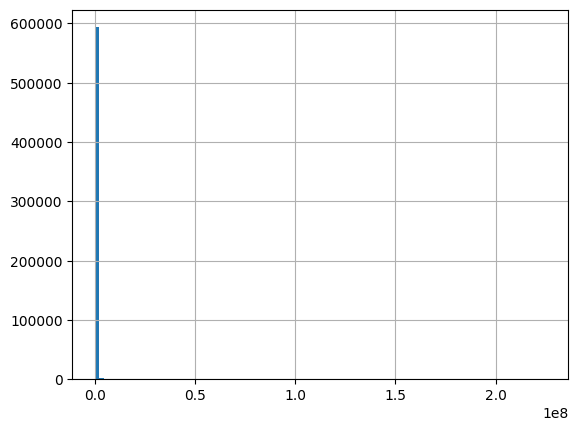

In [61]:
# Plot histogram for Price
df['Price'].hist(bins=100)

- The histogram for Price shows that most of the data is below €50,000,000. So much so that only one bin is visible which does not tell us much about the distribution of the data. This could suggest that there are a number of outliers spread out across a range of roughly €50,000,000 - €250,000,000.

<Axes: >

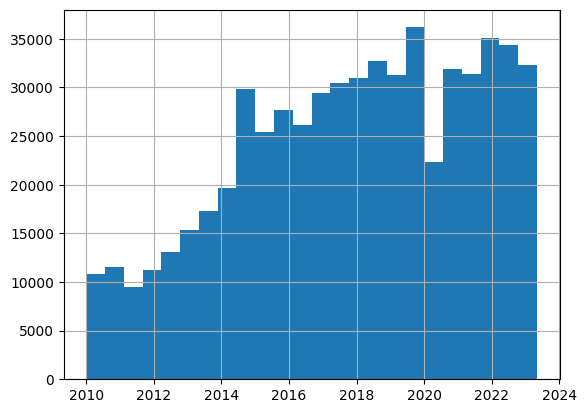

In [62]:
#Plot histogram for date of sale
df['DateofSale'].hist(bins=24)

- The DateofSale histogram shows most sales occured at the end of 2019, while the number of sales generally trended upwards from 2010 to 2023.

<b> - Plot box plots for all the continuous features. </b>


<Axes: >

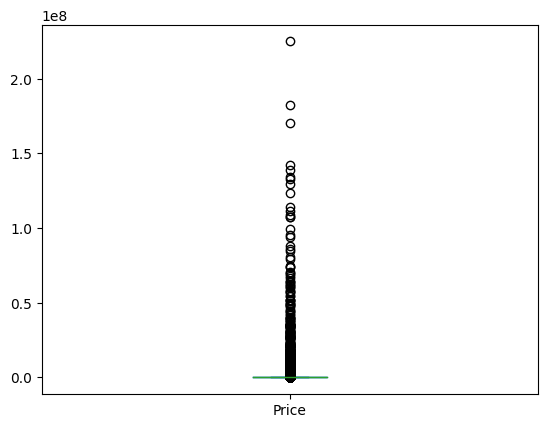

In [63]:
# Plot boxplot for Price
df['Price'].plot(kind='box')

- The boxplot of Price shows a large number of outliers with a large price range.

<b> - Plot bar plots for all the categorical features.</b> 


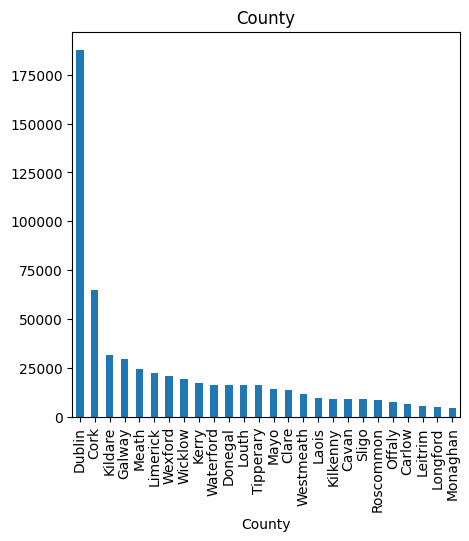

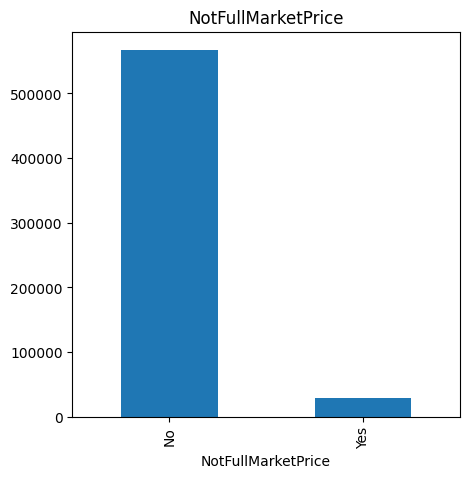

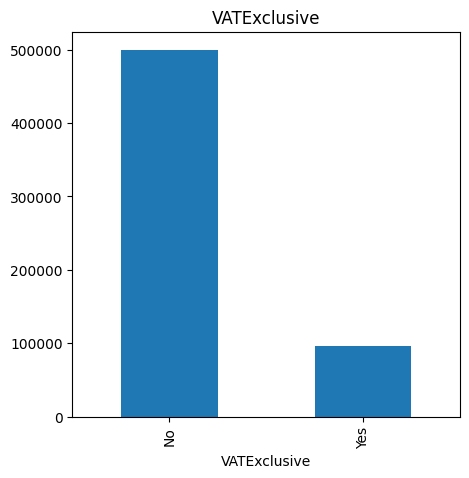

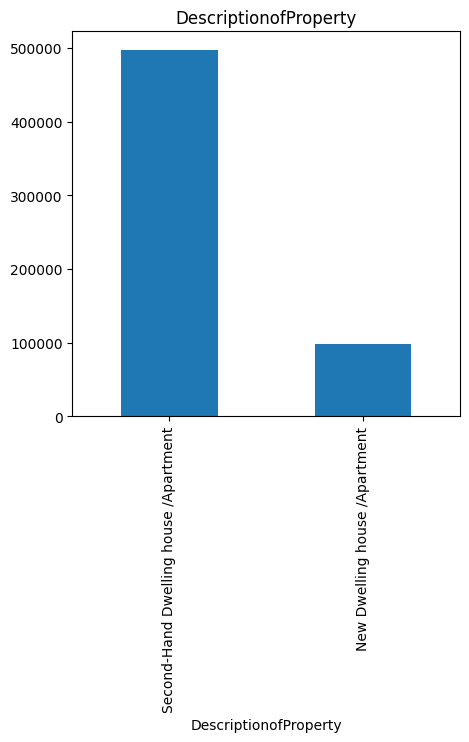

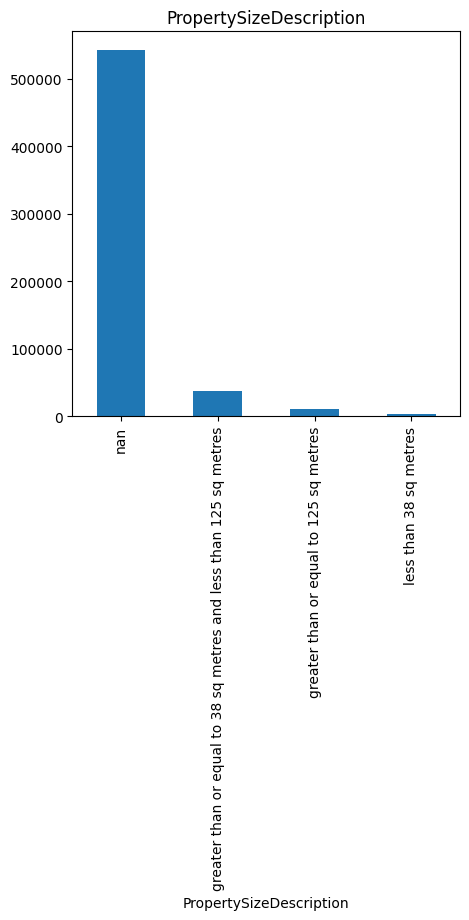

In [64]:
categorical_columns = list(df.select_dtypes(['category']).columns)
categorical_columns.remove('Eircode')

# loop over categorical columns and print a bar chart for each
for column in categorical_columns:
    f = df[column].value_counts(dropna=False).plot(kind='bar', title=column, figsize=(5,5))
    plt.show()



<b> - The significant bar charts above are the following: </b>

County
- Here we can clearly see that the most common addresses are in Dublin, with the next most common is Cork. These are the two most populous counties in Ireland and it would make sense for them to have the most properties sold, although it is interesting that the number of Dublin sales are over double the amount of Cork sales.

DescriptionofProperty
 - It appears over 80% of properties sold are a Second-Hand Dwelling house/appartment. This would suggest that the number of new homes being built is quite low compared to available housing.

PropertySizeDescription
- The most common properties have a range of size between 38 sq metres and less than 125 sq metres. However, most of the data is missing from this feature, which will be addressed in the data quality report.

### Detailed report of initial findings in accompanying file:  <i> Data_Quality_Report_Initial_Findings.pdf </i> 

# 2 - Prepare a data quality plan for the cleaned CSV file.

In [65]:
df = pd.read_csv("PPR-ALL_cleaned_section1.csv", index_col=0)
df.shape

/var/folders/bn/6x11zktd6n14vfwyb0jymgt00000gp/T/ipykernel_31017/1354650328.py:1: DtypeWarning: Columns (4,9) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("PPR-ALL_cleaned_section1.csv", index_col=0)


(595678, 9)

<b> - Mark down all the features where there are potential problems or data quality issues. </b>

As outlined in the accompanying pdf containing the data quality report the following problems have been identified with the data:

    - Missing values in Eircode column
    - Missing values in PropertySizeDescription column
    - Outliers in Price data

<b> - Propose solutions to deal with the problems identified. Explain why did you choose one solution over 
potentially many other. It is very important to provide justification for your thinking in this part and to  list potential solutions, including the solution that will be implemented to clean the data. </b>


1. <u>“Missing values in Eircode column"</u>

Upon first inspection, there does not appear to be Eircode data within Address data of some rows.   I will inspect the Address data further and try to extract Eircode data from the Address column.  

Initially I considered dropping this column as Eircode data is missing from over 84% of rows. I have decided not to drop it since it could provide useful in extracting further information on property location such as lattitude and longitude, however I will drop it if I am unable to extract a significant number of Eircodes.

2. <u>“Missing values in PropertySizeDescription column"</u>

This data is missing over 91% of data and could be considered reasonable to drop this column altogether.   However, I believe the count of non-empty rows of PropertySizeDescription is close to the frequency of 'New Dwelling house /Apartment'.   If this is true, it could contain useful information about newly built properties, and so I will investigate and see if there is a correlation between rows with 'New Dwelling house /Apartment' and non-empty PropertySizeDescription to see if any action needs to be taken.

3. <u>“Outliers in Price data"</u>

I will investigate the outliers and see if any action needs to be taken.



<b> - Apply your solutions to obtain a new CSV file where the identified data quality issues were addressed. </b>

1. <u>“Missing values in Eircode column"</u>


In [4]:
# check amount of addresses with a description of the property size
df['Eircode'].isnull().sum()

504162

In [5]:
# replace NaN values as 'other'
df['Eircode'] = df['Eircode'].astype('object')
df.Eircode = df.Eircode.fillna('other')

df.Eircode.isnull().sum()

0

- Here I will use the Address column to look for Eircodes to fill in missing Eircode data. Eircodes are quite structured, so there shouldn’t be a need to normalise the address before extraction. There are 139 eircode routing keys, so we will look for one of these within each address.


In [6]:
# list of eircode routing keys found at 
# https://www.autoaddress.ie/blog/autoaddressblog/2016/09/21/eircode-routing-keys
eircode_routing_keys = [
        'a41', 'a42', 'a45', 'a63', 'a67', 'a75', 'a81', 'a82', 'a83', 'a84', 'a85', 'a86', 'a91', 'a92', 'a94', 'a96',
        'a98', 'c15', 'd01', 'd02', 'd03', 'd04', 'd05', 'd06', 'd6w', 'd07', 'd08', 'd09', 'd10', 'd11', 'd12', 'd13',
        'd14', 'd15', 'd16', 'd17', 'd18', 'd20', 'd22', 'd24', 'e21', 'e25', 'e32', 'e34', 'e41', 'e45', 'e53', 'e91',
        'f12', 'f23', 'f26', 'f28', 'f31', 'f35', 'f42', 'f45', 'f52', 'f56', 'f91', 'f92', 'f93', 'f94', 'h12', 'h14',
        'h16', 'h18', 'h23', 'h53', 'h54', 'h62', 'h65', 'h71', 'h91', 'k32', 'k34', 'k36', 'k45', 'k56', 'k67', 'k78',
        'n37', 'n39', 'n41', 'n91', 'p12', 'p14', 'p17', 'p24', 'p25', 'p31', 'p32', 'p36', 'p43', 'p47', 'p51', 'p56',
        'p61', 'p67', 'p72', 'p75', 'p81', 'p85', 'r14', 'r21', 'r32', 'r35', 'r42', 'r45', 'r51', 'r56', 'r93', 'r95',
        't12', 't23', 't34', 't45', 't56', 'v14', 'v15', 'v23', 'v31', 'v35', 'v42', 'v92', 'v93', 'v94', 'v95', 'w12',
        'w23', 'w34', 'w91', 'x35', 'x42', 'x91', 'y14', 'y21', 'y25', 'y34', 'y35'
    ]

In [7]:
addressRow = []

# for each address, check if one of the routing keys are present 
for row in range(0, len(df)):
    address = df['Address'][row]
    for key in eircode_routing_keys:
        if key.upper() in address:
            addressRow += [row]
        
len(addressRow)

101

- We can see that there are 101 rows with Eircode routing keys present in the address data. We'll examine these rows below.

In [8]:
pd.set_option('display.max_rows', len(df))

# show rows with Eircode key in Address and no Eircode listed
df.iloc[addressRow][df['Eircode'] == 'other']['Address']


/var/folders/bn/6x11zktd6n14vfwyb0jymgt00000gp/T/ipykernel_23318/2817090869.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df.iloc[addressRow][df['Eircode'] == 'other']['Address']


3046      APARTMENT 146 WYCKHAM POINT, WYCKHAM WAY, DUND...
5529         APARTMENT NO. A42/42A, DRUMBEAR WOOD, MONAGHAN
17925     25 OAK HOUSE, CARRICKMINES GREEN, GLENAMUCK  C...
19496                             25 CASTAHENY, CLONEE, D15
20158     34 LUTTRELSTOWN RISE, LUTTRESTOWN GLEN, CASTLE...
22935     26 ORCHARD WAY GREENWOOD WALK, AYREFIELD MALAH...
23581                              APT. C15 CITYGATE, SLIGO
32322     DOOR 16 (SITE34), THE BIRCHES LOUGH NA GLACK, ...
37038           19 ALLENTON DRIVE, BALLYCRAGH, TALLAGHT D24
47840     APT 603 VANTAGE EAST, CENTRAL PARK, LEOPARDSTO...
56932                  14 DELHURST TERRACE ONGAR D15, ONGAR
58359      47 KILCARRIG CRESCENT, FETTERCAIRN, TALLAGHT D24
58906                     25 LATCHFORD PARK CLONEE D15, D15
81794                        APT12  CHURCHFIELDS, ASHBOURNE
82603                 THE STUDIO, WOODTOWN, RATHFARNHAM D16
95888     37  THE COURTYARD, COLLEGE DRIVE  FORTFIELD, S...
106072                   H160 BRU NA SIO

- Some of the addresses that have the keys present are not actually used for the Eircode, meaning we will only be able to extract less than 101 new Eircodes.

In [9]:
# properties with no Eircode and have a routing key in the address
no_code = df.iloc[addressRow][df['Eircode'] == 'other']['Address'].index

# extract Eircode if in address
for row in no_code:
    address = df['Address'][row].split(',')[-1].split(' ')
    for key in eircode_routing_keys:
        if (key.upper() in address[-1]) & (len(address[-1]) > 3):
#             print(address[-1])
            df.at[row, 'Eircode'] = address[-1]
        elif (key.upper() in address[-2]):
#             print(address[-2] + address[-1])
            df.at[row, 'Eircode'] = address[-2] + address[-1]

# new number of empty Eircodes
df[df['Eircode'] == 'other'].count()

/var/folders/bn/6x11zktd6n14vfwyb0jymgt00000gp/T/ipykernel_23318/1464443346.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  no_code = df.iloc[addressRow][df['Eircode'] == 'other']['Address'].index


DateofSale                 504125
Address                    504125
County                     504125
Eircode                    504125
Price                      504125
NotFullMarketPrice         504125
VATExclusive               504125
DescriptionofProperty      504125
PropertySizeDescription     52554
dtype: int64

- We were only able to fill in 37 new Eircodes. This is an insignificant amount so I will drop this feature.

In [10]:
df = df.drop(columns='Eircode')
df.shape

(595678, 8)

2. <u>“Missing values in PropertySizeDescription column"</u>


- Here I will check if rows with nonempty PropertySizeDescription data are related to rows that are new addresses.

In [11]:
# check amount of addresses with a description of the property size
df['PropertySizeDescription'].notnull().sum()

52579

In [12]:
# check amount of new addresses vs second hand addresses
df['DescriptionofProperty'].value_counts()

DescriptionofProperty
Second-Hand Dwelling house /Apartment    497608
New Dwelling house /Apartment             98070
Name: count, dtype: int64

In [13]:
# check total amount of rows with a description of the property size that are new properties
((df['PropertySizeDescription'].notnull()) & (df['DescriptionofProperty'] == 'New Dwelling house /Apartment')).sum()

52579

- We can see that the number of rows with both a nonempty PropertySizeDescription and DescriptionofProperty value of 'New Dwelling house /Apartment' is equal to the same number of rows that have a nonempty PropertySizeDescription.   This means that all information regarding property size is in relation to new houses.

In [14]:
# check total amount of rows with a description of the property size that are new properties
new_size_missing_sum = ((df['PropertySizeDescription'].isnull()) & (df['DescriptionofProperty'] == 'New Dwelling house /Apartment')).sum()

# prepare %missing column
new_house_size_missing  = 100 * (new_size_missing_sum/df[(df['DescriptionofProperty'] == 'New Dwelling house /Apartment')].shape[0])

# assign 2 variables as the number of new addresses with empty and nonempty data with regards to the property size
empty = [new_house_size_missing] 
nonempty = [100 - new_house_size_missing]

# store the values in a dataframe
df_new_house_size_missing = pd.DataFrame(empty, columns=['%Size Description missing from New Dwelling house'])
df_new_house_size_not_missing = pd.DataFrame(nonempty, columns=['%Size Description not missing from New Dwelling house'])

#concatenate the two dataframes
df_new_house_size = pd.concat([df_new_house_size_missing,df_new_house_size_not_missing], axis = 1)

#display percentage of new addresses with a size description vs no size description
df_new_house_size

,%Size Description missing from New Dwelling house,%Size Description not missing from New Dwelling house
0,46.386255,53.613745


Over 53% of new homes contain information about the size of the property. This is may be useful in the analysis of newly built homes and so I will not drop the PropertySizeDescription column. We will fill in empty values with 'other' to make programming easier.

In [15]:
# replace NaN values as 'other'
df['PropertySizeDescription'] = df['PropertySizeDescription'].astype('object')
df.PropertySizeDescription = df.PropertySizeDescription.fillna('other')
df['PropertySizeDescription'] = df['PropertySizeDescription'].astype('category')

df.PropertySizeDescription.isnull().sum()

0

3. <u>“Outliers in Price data"</u>

I will investigate the outliers and see if any action needs to be taken.

In [16]:
# show Price statistics
df['Price'].describe().apply(lambda x: format(x, 'f'))

count       595678.000000
mean        281362.668497
std        1013935.021061
min           5001.000000
25%         126000.000000
50%         213656.390000
75%         322000.000000
max      225000000.000000
Name: Price, dtype: object

In [17]:
# interquartile range
p_25 = np.percentile(df['Price'], 25)
p_75 = np.percentile(df['Price'], 75)

IQR = p_75 - p_25
IQR

196000.0

- The maximum price is almost 700 times the price at the 75th percentile, while the minimum price is roughly 25 times lower than the price at the 25th percentile. The biggest concern about the data is the gap between the max price and the price at the 75th percentile. The IQR shows us that the middle 50% of property prices is spread across €196,000, which is quite small relative to the maximum property price.

- There are a number of high outliers in Price data. The majority of the data is below €50,000,000 and a number of outliers above this range increase the amount of bins in the histogram, making it difficult to make any inference from the data. It appears to be a small number of outliers with a high range.


- I believe it is better to take a percentile approach for identifying outliers rather than using the IQR proximity rule, since there is such a large range between the maximum price and the 3rd quartile. I will begin by checking the 99th percentile of data.

In [18]:
price_data = df['Price']

# check the price threshold of the highest 99% of prices and the number of rows
p_99 = np.percentile(price_data, 99)
p_99_rows = (df['Price'] < p_99).sum()
p_1_rows = df['Price'].size - (df['Price'] < p_99).sum()

# print the results
print("99% of data is <= " + str(p_99) + ', containing ' + str(p_99_rows) + ' rows')
print("Top 1% percent of data is <= " + str(p_99) + ', containing ' + str(p_1_rows) + ' rows')

99% of data is <= 1275000.0, containing 589669 rows
Top 1% percent of data is <= 1275000.0, containing 6009 rows


In [19]:
# check range of top 1%
price_data.max() - p_99

223725000.0

- The top 1% of of prices are in the range €1,275,000 - €225,000,000. This is a range of €223,725,000 which is quite large. I will check how many of the 6009 rows in the top 1% are above €2,000,000. 

In [20]:
# check number of rows above €2,000,000
(price_data >= 2000000).sum()

2448

- This means 4561 rows are in the price range of €1,275,000 - €2,000,000. I will look at this data more closely.

In [21]:
# show most expensive property
df[df['Price'] == df['Price'].max()]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
584494,2023-02-10,"O'DEVANEY GARDENS, ARBOUR HILL, DUBLIN 7",Dublin,225000000.0,Yes,Yes,New Dwelling house /Apartment,other


- We can see from the Address column that some of these properties are apartment blocks, including the most expensive property O'Devaney Gardens which, after a quick Google, I found is an apartment complex. It makes sense to drop these rows since they are significant outliers in the data and it does not make sense to count multiple residences as single properties. I will remove the O'DEVANEY GARDENS property and recheck the data.

In [22]:
# drop row with max price
df = df.drop(index=584494)
df = df.reset_index(drop=True)

- Having multiple numbers present in the first line of the address may be an indication that multiple apartments were included in the property sale. I will use the function below to identify this criteria and remove apartment blocks from the data.

In [23]:
import re

# function to check how many numbers in a string
def num_there(st):
    words = re.split(r"[^a-zA-Z0-9]", st)
    count = 0
    for c in words:
        if c.isdigit():
            count += 1
    return count


In [24]:
#numbers of rows that are apartments or multiple units
rows = []
# identify multiple apartments/units in data
for row in range(0, len(df)):
    address = df['Address'][row].split(',')[0]
    
#     after a quick glance, the BLOCK no. is included in some addresses and may be mistaken as an apartment no.
    if (num_there(address) > 1) & ('BLOCK' not in address):
        rows += [row]
df.iloc[rows]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
190,2010-01-08,"APT 8 1 GRANGE LODGE AVENUE, CLONGRIFFIN",Dublin,1.776860e+05,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
338,2010-01-14,"22 4 HERBERTON STREET, RIALTO, DUBLIN 8",Dublin,1.820000e+05,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
562,2010-01-19,"SITE NO. 2 (KNOWN AS NO. 4), LOUGHCURRA, KINVARA",Galway,3.083700e+05,No,Yes,New Dwelling house /Apartment,greater than or equal to 125 sq metres
1217,2010-02-02,"60/61 THE ELMS, MOUNT MERRION AVENUE, BLACKROCK",Dublin,6.850000e+05,No,No,Second-Hand Dwelling house /Apartment,other
1318,2010-02-04,"58-65 KNOCKROE GLEN, KNOCKROE, MONAGHAN",Monaghan,1.654800e+06,Yes,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
2205,2010-02-22,"APT. NO. 15 86 REUBEN STREET, RIALTO, DUBLIN 8",Dublin,2.249000e+05,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
2416,2010-02-26,"127 129 AND 131 AND PART 133, LOWER RATHMINES ...",Dublin,6.010195e+06,No,No,Second-Hand Dwelling house /Apartment,other
2486,2010-02-26,"6 & 7 CATHERINE PLACE, LIMERICK",Limerick,1.391333e+06,No,Yes,New Dwelling house /Apartment,greater than or equal to 125 sq metres
3198,2010-03-12,"APT 6 29 JAMES' WALK, RIALTO, DUBLIN 8",Dublin,1.880000e+05,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
3340,2010-03-16,"APT 14 HERBERTON 86 REUBEN STREET, ST JAMES'S ...",Dublin,1.720000e+05,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...


- We can see that these listings are all multiple apartments. I will drop these rows.

In [25]:
# drop rows 
df = df.drop(index=rows)
df = df.reset_index(drop=True)
df.shape

(592608, 8)

In [26]:
# look at rows above €2,000,000
df[df['Price'] >= 2000000]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
382,2010-01-15,"10 HERBERT ROAD, SANDYMOUNT",Dublin,2.030000e+06,No,No,Second-Hand Dwelling house /Apartment,other
1010,2010-01-28,"WOODBURN, 31 SYDNEY AVE, BLACKROCK",Dublin,2.600000e+06,No,No,Second-Hand Dwelling house /Apartment,other
1452,2010-02-05,"SORRENTOVILLE, VICO ROAD, DALKEY",Dublin,2.400000e+06,No,No,Second-Hand Dwelling house /Apartment,other
1986,2010-02-18,"30 APTS AND ONE COMMERCIAL UNIT, SUTTON COURT,...",Cork,4.563877e+06,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
2021,2010-02-18,"ASHLEIGH HOUSE, CORBALLY, CELBRIDGE",Kildare,2.325000e+06,No,No,Second-Hand Dwelling house /Apartment,other
2210,2010-02-22,"ROSEWARNE, GLENAMUCK ROAD, CARRICKMINES",Dublin,2.150000e+06,No,No,Second-Hand Dwelling house /Apartment,other
2521,2010-02-26,"RIVERSDALE HOUSE, RIVERSDALE AVE BUSHY PARK R...",Dublin,2.250000e+06,No,No,Second-Hand Dwelling house /Apartment,other
3666,2010-03-24,"SANEAVIR, OUTFARM LANE, CASTLEKNOCK",Dublin,2.170000e+06,No,No,Second-Hand Dwelling house /Apartment,other
4385,2010-04-07,"BELMONT, THE HILL, MONKSTOWN",Dublin,2.424000e+06,No,No,Second-Hand Dwelling house /Apartment,other
5460,2010-04-28,"13 ARGYLE ROAD, DONNYBROOK",Dublin,2.012000e+06,No,No,Second-Hand Dwelling house /Apartment,other


- There are still rows for multiple apartments present in the data. I will use keywords to identify these rows and drop them.

<b> - Look for addresses with keyword 'UNITS'. </b>

In [27]:
df[df['Address'].str.contains('UNITS')]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
37022,2011-12-01,"UNITS AT LODGE MILLS, BAGNELSTOWN, CO CARLOW",Carlow,7.500000e+04,No,No,Second-Hand Dwelling house /Apartment,other
39689,2012-01-16,"UNITS 100 TO 107 BLOCK F, ROYAL CANAL ARDMORE...",Westmeath,4.000000e+05,No,No,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
45336,2012-05-08,"KILMAINHAMWOOD RETIREMENT VILLAGE, UNITS 8-13 ...",Meath,1.360000e+06,No,No,Second-Hand Dwelling house /Apartment,other
58223,2012-11-08,"UNITS IN SANDFORD LODGE, SANDFORD CLOSE",Dublin,2.700000e+07,No,No,Second-Hand Dwelling house /Apartment,other
87341,2013-11-08,"UNITS AVENUE HEATH PLACE & WALK, DUNBOYNE CA...",Meath,1.866960e+06,No,Yes,New Dwelling house /Apartment,greater than or equal to 125 sq metres
114559,2014-08-01,"14 RESIDENTIAL UNITS, ROBSWALL, MALAHIDE",Dublin,3.428972e+06,No,No,Second-Hand Dwelling house /Apartment,other
114668,2014-08-01,"4 RESIDENTIAL UNITS, ROBSWALL, MALAHIDE",Dublin,7.097320e+05,No,No,Second-Hand Dwelling house /Apartment,other
114714,2014-08-01,"65 RESIDENTIAL UNITS, ROBSWALL, MALAHIDE",Dublin,2.106230e+07,No,No,Second-Hand Dwelling house /Apartment,other
116733,2014-08-21,"CHATHAM COURT, APARTMENTS/UNITS 1-9, CHATHAM S...",Dublin,6.091057e+06,No,No,Second-Hand Dwelling house /Apartment,other
133379,2014-12-17,"24 UNITS AT THE WATERWAYS, RATHBORNE, ASHTOWN",Dublin,2.460000e+06,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...


In [28]:
rows = df[df['Address'].str.contains('UNITS')].index
# drop rows 
df = df.drop(index=rows)
df = df.reset_index(drop=True)
df.shape

(592538, 8)

<b>- Look for addresses with keyword 'APTS'.</b>

In [29]:
df[df['Address'].str.contains('APTS')]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
1986,2010-02-18,"30 APTS AND ONE COMMERCIAL UNIT, SUTTON COURT,...",Cork,4563876.65,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
3978,2010-03-30,"13 ATLANTIC WAY APTS, BUNDROAN",Donegal,63500.00,No,No,Second-Hand Dwelling house /Apartment,other
7426,2010-05-31,"45 WINDMILL LANE APTS., DUBLIN 2",Dublin,225000.00,No,No,Second-Hand Dwelling house /Apartment,other
9745,2010-07-07,"APT 16 MARINE TERRACE APTS, STRAND STREET, YOU...",Cork,283500.00,No,No,Second-Hand Dwelling house /Apartment,other
11543,2010-08-04,"5 ROCKWELL COVE APTS, IDRONE TERRACE, BLACKROCK",Dublin,405000.00,No,No,Second-Hand Dwelling house /Apartment,other
11742,2010-08-06,"75 PORTERSFIELD APTS, CLONSILLA, DUBLIN 15",Dublin,165000.00,No,No,Second-Hand Dwelling house /Apartment,other
13234,2010-08-30,"APT 16 LIGHTHOUSE APTS, CHURCH ROAD, EAST WALL",Dublin,178000.00,No,No,Second-Hand Dwelling house /Apartment,other
23502,2011-03-11,"APTS.B15 CITY GATE, SLIGO",Sligo,128571.42,No,No,Second-Hand Dwelling house /Apartment,other
39329,2012-01-06,"78/78A HYDE SQUARE APTS., 646A 666 SOUTH CIRCU...",Dublin,185000.00,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
65863,2013-01-31,"19 SETANTA APTS, DUBLIN ROAD, DUNDALK",Louth,115000.00,No,No,Second-Hand Dwelling house /Apartment,other


- It looks like APTS is present in some addresses for single apartments. I will filter the data further to find properties with APTS in the address and in the top percentile, since it is likely multiple apartments cost more.

In [30]:
# find apartments in top percentile
df[(df['Price'] >= p_99) & ((df['Address'].str.contains('APTS')))]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
1986,2010-02-18,"30 APTS AND ONE COMMERCIAL UNIT, SUTTON COURT,...",Cork,4563876.65,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
239522,2017-02-03,"APT 1, SAVOY APTS, MARY ST",Galway,2916000.00,No,No,Second-Hand Dwelling house /Apartment,other
263143,2017-07-25,"1A HAZELWOOD APTS, NORTHWOOD, SANTRY",Dublin,6415000.00,No,No,Second-Hand Dwelling house /Apartment,other
264974,2017-08-03,"27 CULVERT APTS, DUBLIN 8, DUBLIN",Dublin,3915000.00,No,No,Second-Hand Dwelling house /Apartment,other
274537,2017-10-04,"APT 1, LEESIDE APTS, GRATTAN ST",Cork,8425000.00,No,No,Second-Hand Dwelling house /Apartment,other
275833,2017-10-12,"28 APTS NEW SESKIN COURT, WHITESTOWN WAY, TALL...",Dublin,4195000.00,No,No,Second-Hand Dwelling house /Apartment,other
275851,2017-10-12,"35 APTS NEW SESKIN COURT, WHITESTOWN WAY, TALL...",Dublin,5055000.00,No,No,Second-Hand Dwelling house /Apartment,other
282836,2017-11-23,"APT 78 AND OTHERS BLOCK F, HAZELWOOD APTS, NOR...",Dublin,2600000.00,No,No,Second-Hand Dwelling house /Apartment,other
339637,2018-11-23,"APT.1 GRAVEL WALK COURT APTS, 50/52 BLACKHALL...",Dublin,4184990.00,No,No,Second-Hand Dwelling house /Apartment,other
341802,2018-12-05,"APT A1, DOUGLAS HYDE APTS, CORK",Cork,2650000.00,No,No,Second-Hand Dwelling house /Apartment,other


- Now I can manually check each row and determine which ones are multiple apartments. 

In [31]:
# store indices of multiple apartments listed as single property
# 30 APTS AND ONE COMMERCIAL UNIT, & 27 CULVERT APTS, DUBLIN 8, DUBLIN
# 28 APTS NEW SESKIN COURT, WHITESTOWN WAY, & 35 APTS NEW SESKIN COURT, WHITESTOWN WAY,
# APT 78 AND OTHERS BLOCK F, HAZELWOOD APTS, & APT 1 AND OTHERS, LEESIDE APTS,
# BLOCK B APTS 13-24 THE SQUARE, & BLOCK A APTS 6-14 THE DRIVE, 
# 17 APTS IN BLOCK 1 AND 2, AND COMMON AREAS, & 22 EARLSFORT TERRACE INCLUDING, APTS. 22A 22B
# 10 APTS PARLIAMENT CRANE DAME ST, DUBLIN 2 & 10 COLIEMORE APTS, COLIEMORE ROAD, DALKEY
# APTS 1-30 BLOCK A APTS 1-8, 10-20 21-28 30 & APTS 21-30 BLOCK 2, HOLDBROOK ESTATE, PORTLAOISE
rows = [1986, 264974, 275833, 275851, 282836, 358985, 447498, 450386, 455081, 487952, 488149, 490751, 492513,
       565012]
# drop rows 
df = df.drop(index=rows)
df = df.reset_index(drop=True)
df.shape

(592524, 8)

<b>- Look for addresses with keyword 'APARTMENTS'.</b>

In [32]:
df[df['Address'].str.contains('APARTMENTS')]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
46,2010-01-05,"13 SLIEVEMORE APARTMENTS, DUGORT, ACHILL",Mayo,120000.00,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
1160,2010-02-01,"APARTMENT NO.14, JOHNS LANE APARTMENTS, JOHN'S...",Waterford,81591.40,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
1161,2010-02-01,"APARTMENT NO.7, JOHN'S LANE APARTMENTS, JOHN'S...",Waterford,81591.40,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
2517,2010-02-26,"NO. 1 OLYMPIA APARTMENTS, MERTON SQUARE, KILKEE",Clare,170000.00,No,No,Second-Hand Dwelling house /Apartment,other
3671,2010-03-25,"107 EDEN BAY APARTMENTS, WEST END, BUNDORAN",Donegal,125000.00,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
4524,2010-04-09,"4 MULLINS WING, LINDEN APARTMENTS, GROVE AVENU...",Dublin,222500.00,No,No,Second-Hand Dwelling house /Apartment,other
7070,2010-05-25,"SLILEVEMORE APARTMENTS, DUGORT, ACHILL",Mayo,122500.00,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
7095,2010-05-26,"27 ATLANTIC WAY APARTMENTS, BUNDORAN",Donegal,45000.00,No,No,Second-Hand Dwelling house /Apartment,other
9846,2010-07-09,"13 BEACHSIDE APARTMENTS, TRAMORE",Waterford,80000.00,No,No,Second-Hand Dwelling house /Apartment,other
11830,2010-08-09,"APARTMENT 5, KINGSHILL APARTMENTS, SALTHILL",Galway,195000.00,No,No,Second-Hand Dwelling house /Apartment,other


- It looks like APARTMENTS is present in some addresses for single apartments. I will filter the data further to find properties with APARTMENTS in the address and in the top percentile.

In [33]:
df[(df['Price'] >= p_99) & ((df['Address'].str.contains('APARTMENTS')))]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
33663,2011-10-07,"12 APARTMENTS, THE BARLEYHOUSE, 90-97 CORK STREET",Dublin,2310000.00,No,No,Second-Hand Dwelling house /Apartment,other
82406,2013-09-18,"XAVIER COURT APARTMENTS, UPPER SHERRARD STREET",Dublin,4745815.00,No,No,Second-Hand Dwelling house /Apartment,other
99170,2014-03-07,"SMYTH APARTMENTS, 128 LOWER GEORGE'S STREET, D...",Dublin,2400000.00,No,No,Second-Hand Dwelling house /Apartment,other
102679,2014-04-16,"THE APARTMENTS AT ROUND GARDEN, CITYWEST, SAGGART",Dublin,1750000.00,No,No,Second-Hand Dwelling house /Apartment,other
111599,2014-07-11,"48 APARTMENTS AT CLARE VILLAGE, CLARE HALL, MA...",Dublin,5440035.00,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
112251,2014-07-15,"APARTMENTS PARNEL ROAD, DUBLIN 12",Dublin,3499409.69,No,No,Second-Hand Dwelling house /Apartment,other
116928,2014-08-22,"APARTMENTS 1-5 6 12-50 BLOCK B, IVEAGH COURT B...",Dublin,10040000.00,No,No,Second-Hand Dwelling house /Apartment,other
122519,2014-10-06,"74 APARTMENTS AT, LANSDOWNE GATE, DRIMNAGH",Dublin,19946964.28,No,No,Second-Hand Dwelling house /Apartment,other
122520,2014-10-06,"75 APARTMENTS AT, LANSDOWNE GATE, DRIMNAGH",Dublin,20216517.86,No,No,Second-Hand Dwelling house /Apartment,other
131978,2014-12-11,"49 APARTMENTS AT BLOCK P7, BELMAYNE, BALGRIFFIN",Dublin,6041850.22,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...


- All these rows appear to be multiple apartments except for 2.

In [34]:
rows = list(df[(df['Price'] >= p_99) & ((df['Address'].str.contains('APARTMENTS')))].index)
# APARTMENT 3, GROVE COURT APARTMENTS,
rows.remove(406992)
# HERBERTON BLOCK B APT 23, 2 HERBERTON STREET
rows.remove(414532)

# drop rows 
df = df.drop(index=rows)
df = df.reset_index(drop=True)
df.shape

(592461, 8)

<b>- Look for addresses with keyword 'BLOCK'.</b>

In [35]:
df[df['Address'].str.contains('BLOCK')]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
189,2010-01-08,"APT 25 BLOCK 2, THE VIEW NEWTOWN HALL, MAYNOOTH",Kildare,2.019500e+05,No,Yes,New Dwelling house /Apartment,less than 38 sq metres
313,2010-01-13,"APARTMENT 37 BLOCK D, CLARE VILLAGE, CLARE HALL",Dublin,1.699500e+05,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
333,2010-01-14,"14 BLOCK D DOOLIN HOUSE, CLARE VILLAGE, CLARE ...",Dublin,1.497357e+05,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
678,2010-01-22,"100 BLOCK B2 FITZWILLAM POINT, FITZWILLIAM Q...",Dublin,2.731390e+05,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
801,2010-01-25,"412 SOUTH BLOCK, LONGBOAT QUAY, GRAND CANAL",Dublin,2.100000e+05,No,No,Second-Hand Dwelling house /Apartment,other
868,2010-01-26,"FLAT NO. 3, BUILDING BLOCK B, BELLEVUE COURT ...",Dublin,2.000000e+05,No,No,Second-Hand Dwelling house /Apartment,other
1159,2010-02-01,"APARTMENT 69, BLOCK E, MACDONAGH JUNCTION",Kilkenny,1.409692e+05,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
1216,2010-02-02,"APT 3 BLOCK 10 GALLERY QUAY, GRAND CANAL SQU...",Dublin,2.445000e+05,No,No,Second-Hand Dwelling house /Apartment,other
1494,2010-02-08,"APARTMENT 13 BLOCK A, SILVERBRIDGE COURT, KNO...",Mayo,9.691630e+04,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
1654,2010-02-11,"APARTMENT 15 BLOCK 4, COIS ABHAINN, CLANE",Kildare,1.850220e+05,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...


- It looks like BLOCK is present in some addresses for single apartments. I will filter the data further to find properties with BLOCK in the address and in the top percentile.

In [36]:
df[(df['Price'] >= p_99) & ((df['Address'].str.contains('BLOCK')))]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
22493,2011-02-16,"UNIT 172 (BLOCK Z) LEARGAN, BALLYMONEEN WEST, ...",Galway,2.725362e+06,No,Yes,New Dwelling house /Apartment,greater than or equal to 125 sq metres
60983,2012-12-06,"BLOCK L CASTLETREASURE, TEMPLE GROVE, CARR'S ...",Cork,3.378855e+06,No,No,New Dwelling house /Apartment,greater than or equal to 125 sq metres
100889,2014-03-28,"BLOCKS F K AND L CENTRAL PARK, LEOPARDSTOWN",Dublin,7.050336e+07,No,No,Second-Hand Dwelling house /Apartment,other
113528,2014-07-24,"BLOCK F K AND L CENTRAL PARK, LEOPARDSTOWN",Dublin,8.636500e+07,No,No,Second-Hand Dwelling house /Apartment,other
116715,2014-08-21,"BLOCKS F AND G, COOKSTOWN WAY, TALLAGHT",Dublin,4.096283e+06,Yes,No,New Dwelling house /Apartment,greater than or equal to 125 sq metres
157562,2015-06-15,"BLOCK 8A AND BLOCK 8B, TALLAGHT CROSS WEST, DU...",Dublin,7.743018e+06,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
161844,2015-07-16,"METRO HOTEL, BLOCK C SANTRY CROSS",Dublin,3.000000e+06,No,No,New Dwelling house /Apartment,greater than or equal to 125 sq metres
164647,2015-08-05,"APARTMENT BLOCK L, TEMPLEGROVE, CASTLETREASURE...",Cork,5.800000e+06,No,No,Second-Hand Dwelling house /Apartment,other
202782,2016-05-25,"APT 11 BLOCK 1 THE LINKS, ELM PARK, MERRION ROAD",Dublin,9.684375e+06,No,No,Second-Hand Dwelling house /Apartment,other
232809,2016-12-15,"APT. 1 BLOCK A, BLACKHALL PLACE, ARBOUR HILL",Dublin,8.500000e+06,No,No,Second-Hand Dwelling house /Apartment,other


In [37]:
rows = list(df[(df['Price'] >= p_99) & ((df['Address'].str.contains('BLOCK')))].index)

single_apts = ['APT 11 BLOCK 1 THE LINKS, ELM PARK, MERRION ROAD',
               'APT. 1 BLOCK A, BLACKHALL PLACE, ARBOUR HILL', 'APT 36 BLOCK C, HAZLEWOOD, SANTRY', '16 BLOCK B, BRUACH NA HABHAINN, ALTAMOUNT ST'
               , 'APT 23 BLOCK L TEMPLEGROVE, CASTLETREASURE, DOUGLAS', 'APT 25, BLOCK 1, GALLERY QUAY'
               , '13 ORWELL GATE, BLOCK A, MARIANELLA', 'APARTMENT 13, ORWELL HALL  BLOCK C, MARIANELLA'
               ,'APARTMENT 16 BLOCK 3, THE TEMPLETON  LANDSDOWNE PLACE, LANDSDOWNE ROAD'
               , 'APT 5  BLOCK 3 THE TEMPLETON, LANSDOWNE PLACE, LANSDOWNE ROAD'
               ,'APT 15  BLOCK 3, THE TEMPLETON, LANSDOWNE PLACE'
               , 'APT 18  BLOCK 3 THE TEMPLETON, LANSDOWNE PLACE, LANSDOWNE ROAD  BALLSBRIDGE'
               ,'APARTMENT 14 BLOCK 3, THE TEMPLETON, LANDSDOWNE PLACE'
               ,'APARTMENT 9  BLOCK 3, THE TEMPLETON, LANSDOWNE PLACE'
               ,'APARTMENT 2 THE TEMPLETON, BLOCK 3  LEVEL 1  LANSDOWNE PLACE, LANSDOWNE ROAD'
               ,'APARTMENT 20  BLOCK A, FARNHAM COURT, FARNHAM ROAD'
               , 'APT  22 THE BARRINGTON, BLOCK 6A  LANSDOWNE PLACE, BALLSBRIDGE  DUBLIN 4'
               ,'47 THE BARRINGTON, BLOCK 6B LEVEL 6, LANSDOWNE PLACE'
               , '27 THE BARRINGTON BLOCK 6A  LEVEL 8, LANSDOWNE PLACE BALLSBRIDGE, FOLIO NO. DN211931F'
               , '24 THE BARRINGTON, BLOCK 6A, LANDSDOWNE PLACE','APT 46 THE BARRINGTON, BLOCK 6B, LANDSDOWNE PLACE'
               ,'207 BLOCK A1, BEACON SOUTH QUARTER, SANDYFORD', '8 THE BLAKE, BLOCK 4  LEVEL 2, LANDSDOWNE PLACE'
               ,'APT 11 THE BLAKE, BLOCK 4  LEVEL 3, LANSDOWNE PLACE','APARTMENT 15 THE BLAKE, BLOCK 4  LEVEL 4, LANSDOWNE PLACE'
               ,'APARTMENT 19 THE BLAKE  BLOCK 4, LEVEL 5  LANSDOWNE PLACE, LANSDOWNE ROAD  BALLSBRIDGE'
               ,'APT 20 THE TEMPLETON, BLOCK 3 LEVEL 6, BALLSBRIDGE','APARTMENT 21 THE BLAKE, BLOCK 4  LEVEL 6, LANSDOWNE PLACE'
               ,'APARTMENT 302 BLOCK 2, THE ELM, TRIMBLESTON','51 THE BARRINGTON, BLOCK 6B  LEVEL 7, LANSDOWNE PLACE'
               ,'APT 14 THE BLAKE, BLOCK 4  LEVEL 3, LANSDOWNE PLACE  LANSDOWNE ROAD'
               ,'18 DONNYBROOK GARDENS, BLOCK 1 DONNYBROOK GARDENS, GREENFIELDS'
               ,'APARTMNET 13 THE BARRINGTON, BLOCK 6A  LEVEL 3, LANDSOWNE PLACE'
               ,'APT.604 - BLOCK A3, BEACON SOUTH QUARTER, SANDYFORD'
               , 'APT 10 THE BLAKE, BLOCK 4  LEVEL 2 LANSDOWNE PLACE, LANSDOWNE ROAD'
               ,'APARTMENT 12  THE BURBRIDGE, BLOCK 5  LEVEL 3, LANSDOWNE PLACE  LANSDOWNE ROAD'
               ,'APARTMENT 19, THE BURBRIDGE BLOCK 5, LANSDOWNE PLACE  LANSDOWNE ROAD'
               ,'APT 13 THE BURBRIDGE, BLOCK 5  LEVEL 3  LANDSDOWNE PLACE, LANSDOWNE ROAD','APT. 1, IVERAGH BLOCK 3, CAHIRCIVEEN'
               ,'2 THE BURBIDGE, BLOCK 5, LANSDOWNE PLACE  LANSDOWNE ROAD','APT 4 THE BURBRIDGE, BLOCK 5  LEVEL 1, LANSDOWNE PLACE'
              ]

rows.remove(df[df['Address']==('UNIT 172 (BLOCK Z) LEARGAN, BALLYMONEEN WEST, GAWLAY')].index)
for apt in single_apts:
    index = list(df[(df['Price'] >= p_99) & (df['Address'].str.contains(apt))].index)
    for num in index:
        rows.remove(num)
# drop rows 
df = df.drop(index=rows)
df = df.reset_index(drop=True)
df.shape

(592375, 8)

<b> - Look for addresses with keyword 'RESIDENTIAL'.</b>

In [38]:
df[df['Address'].str.contains('RESIDENTIAL')]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
35807,2011-11-15,"RESIDENTIAL DWELLING, BALLYMACREDMOND, BUTLERS...",Cork,104000.00,No,No,Second-Hand Dwelling house /Apartment,other
45689,2012-05-15,"APARTMENT 2, EYRE SQUARE RESIDENTIAL CENTRE, E...",Galway,155000.00,No,No,Second-Hand Dwelling house /Apartment,other
88288,2013-11-20,"20 RESIDENTIAL PROPERTIES, THE COAST, BALDOYLE",Dublin,2129955.95,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
120796,2014-09-24,"11 RESIDENTIAL DWELLINGS AT ARDMORE, BETTYSTOWN",Meath,704975.00,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
135720,2014-12-22,"23 DUNARAS, RESIDENTIAL ACCOMMODATION, BISHOP ...",Galway,83000.00,No,No,Second-Hand Dwelling house /Apartment,other
139169,2015-01-21,"RESIDENTIAL PART OF THE HAZEL BAR, KILBEGGAN, ...",Westmeath,20000.00,No,No,Second-Hand Dwelling house /Apartment,other
180706,2015-11-30,"UNIT 3 BALLYLOGUE (RESIDENTIAL), THE ROWER, TH...",Kilkenny,210000.00,No,No,Second-Hand Dwelling house /Apartment,other
191472,2016-02-19,"51 DUNARAS, RESIDENTIAL ACCOMMODATION, BISHOP ...",Galway,70000.00,No,No,Second-Hand Dwelling house /Apartment,other
198841,2016-04-25,"36 MANOR RD, FOR RESIDENTIAL A C, PALMERSTOWN",Dublin,100000.00,No,No,Second-Hand Dwelling house /Apartment,other
209254,2016-07-13,"16 SKIBBEREEN RESIDENTIAL CARE CTR, BALTIMORE ...",Cork,102000.00,No,No,Second-Hand Dwelling house /Apartment,other


In [39]:
error_properties = ['20 RESIDENTIAL PROPERTIES, THE COAST, BALDOYLE', '11 RESIDENTIAL DWELLINGS AT ARDMORE, BETTYSTOWN',
                   '102 RESIDENTIAL HOUSES, ST EDMUNDS, PALMERSTOWN', 'RESIDENTIAL PROPERTIES, STATION MANOR  STATION MANOR ROAD, PORTMARNOCK',
                   'RESIDENTIAL PROPERTIES, SCHOLARSTOWN WOOD SCHOLARSTOWN ROAD, RATHFARNHAM']

for address in error_properties:
    df = df.drop(index=df[df['Address'].str.contains(address)].index)

# drop rows 
df = df.reset_index(drop=True)
df.shape

(592370, 8)

<b>- Look for addresses with keyword 'PROPERTIES'.</b>

In [40]:
df[df['Address'].str.contains('PROPERTIES')]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
116968,2014-08-22,"PROPERTIES AT BREMORE PASTURES, BALBRIGGAN, CO...",Dublin,3315341.46,No,No,Second-Hand Dwelling house /Apartment,other
116969,2014-08-22,"PROPERTIES AT BREMORE PASTURES, BALBRIGGAN, CO...",Dublin,2119644.54,No,No,Second-Hand Dwelling house /Apartment,other
131301,2014-12-09,"12 PROPERTIES AT BAKER'S YARD, PORTLAND STREET...",Dublin,1229331.90,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
198594,2016-04-22,"2 CAROLANS COURT & OTHER PROPERTIES, KILRONAN ...",Roscommon,960000.00,No,No,Second-Hand Dwelling house /Apartment,other
199086,2016-04-26,"VARIOUS PROPERTIES MILLHOUSE, WOODLAND GROVE ...",Wexford,409500.00,No,No,Second-Hand Dwelling house /Apartment,other
199087,2016-04-26,"VARIOUS PROPERTIES OAKDALE PARK, TEMPLEMORE, T...",Tipperary,934426.00,No,No,Second-Hand Dwelling house /Apartment,other
202811,2016-05-25,"VARIOUS PROPERTIES AT CLUAIN SHEE, AIKEN'S VIL...",Dublin,5594511.01,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
289710,2017-12-21,"5 DOOGART BEACH PROPERTIES, DOOGART, ACHILL",Mayo,130000.00,No,No,Second-Hand Dwelling house /Apartment,other
383987,2019-09-03,"6 DOOGART BEACH PROPERTIES, DOOGART, ACHILL",Mayo,115000.00,No,No,Second-Hand Dwelling house /Apartment,other
409139,2020-01-29,"APT 7 THE GARDENS, APPLEWOOD VILLAGE SWORDS, ...",Dublin,1920000.00,No,No,Second-Hand Dwelling house /Apartment,other


In [41]:
multi_prop = df[(df['Address'].str.contains('PROPERTIES') & (~df['Address'].str.contains('DOOGART')))].index

df = df.drop(index=multi_prop)
df = df.reset_index(drop=True)
df.shape

(592355, 8)

<b>- Look for addresses with keyword 'DEVELOPMENT'.</b>

In [42]:
pd.set_option('display.float_format', lambda x: '%.3f' % x)
df[(df['Address'].str.contains('DEVELOPMENT')) & (df['Price'] >= p_99)]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
90227,2013-12-06,"DEVELOPMENT, ISLAND KEY, EAST ROAD",Dublin,11603965.000,No,No,Second-Hand Dwelling house /Apartment,other
90228,2013-12-06,"DEVELOPMENT, ORCHARD GARDENS, DENNEHY'S CROSS",Cork,11789574.000,No,No,Second-Hand Dwelling house /Apartment,other
90229,2013-12-06,"DEVELOPMENT, TALLAGHT CROSS, TALLAGHT",Dublin,20804659.000,No,No,Second-Hand Dwelling house /Apartment,other
157843,2015-06-17,"HEUSTON SOUTH QUARTER DEVELOPMENT, ST. JOHN'S ...",Dublin,35045714.000,Yes,Yes,New Dwelling house /Apartment,greater than or equal to 125 sq metres
170922,2015-09-22,"GORTANORA DEVELOPMENT, DINGLE",Kerry,2925000.000,No,Yes,New Dwelling house /Apartment,greater than or equal to 125 sq metres
426219,2020-07-02,"12 UNIT DEVELOPMENT, AT CROMWELLSFORD COURT, C...",Dublin,5068387.380,No,Yes,New Dwelling house /Apartment,other
428789,2020-07-27,"34 UNIT DEVELOPMENT AT WESTON, KETTLE'S LANE ...",Dublin,12753320.000,No,Yes,New Dwelling house /Apartment,other
440630,2020-10-22,"9 UNIT DEVELOPMENT AT, RICHMOND WAY CLONDALKIN",Dublin,3052864.000,Yes,Yes,New Dwelling house /Apartment,other
444055,2020-11-10,"RESIDENTIAL DEVELOPMENT, THE OAKS, PORTERSTOWN...",Dublin,4396000.000,No,No,Second-Hand Dwelling house /Apartment,other
459173,2021-02-04,"MIXED USE DEVELOPMENT, AT SWISS COTTAGE, SANTRY",Dublin,38094573.370,No,Yes,New Dwelling house /Apartment,other


In [43]:
rows = df[(df['Address'].str.contains('DEVELOPMENT')) & (df['Price'] >= p_99)].index

# drop rows 
df = df.drop(index=rows)
df = df.reset_index(drop=True)
df.shape

(592341, 8)

In [44]:
df[(df['Address'].str.contains('DEVELOPMENT'))]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
32571,2011-09-19,"52 MARINER'S VIEW DEVELOPMENT, CASTLETOWNBERE",Cork,58562.000,No,No,Second-Hand Dwelling house /Apartment,other
66998,2013-02-21,"48 ROS ARD, MOUNT WILLIAM COURT DEVELOPMENT, O...",Roscommon,120000.000,Yes,Yes,New Dwelling house /Apartment,greater than or equal to 125 sq metres
73060,2013-05-30,"8 BALTRASNA HOUSE, SPENCER DOCK DEVELOPMENT",Dublin,170000.000,No,No,Second-Hand Dwelling house /Apartment,other
74994,2013-06-25,"46 ROS ARD, MOUNT WILLIAM COURT DEVELOPMENT, TUAM",Galway,88106.000,No,Yes,New Dwelling house /Apartment,greater than or equal to 125 sq metres
79441,2013-08-16,"1107 KILKEE BAY DEVELOPMENT, KILKEE",Clare,34000.000,No,No,Second-Hand Dwelling house /Apartment,other
91753,2013-12-17,"APT 1108 KILKEE BAY DEVELOPMENT, KILKEE",Clare,33000.000,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
104996,2014-05-16,"1001, KILKEE BAY DEVELOPMENT, KILKEE BAY",Clare,75000.000,No,Yes,New Dwelling house /Apartment,less than 38 sq metres
116369,2014-08-19,"48 ST STEVENS GATE DEVELOPMENT, JAMES STREET, ...",Dublin,120000.000,No,No,Second-Hand Dwelling house /Apartment,other
117749,2014-08-29,"47 ST STEVENS GATE DEVELOPMENT, JAMES STREET, ...",Dublin,180000.000,No,No,Second-Hand Dwelling house /Apartment,other
120764,2014-09-23,"DEVELOPMENT AT STRACOMER HILL, BUNDORAN",Donegal,422323.000,No,Yes,New Dwelling house /Apartment,greater than or equal to 125 sq metres


In [45]:
# drop rows 
df = df.drop(index=df[df['Address'] == 'LINN CORR DEVELOPMENT, CASTLMARTYR'].index)
df = df.reset_index(drop=True)
df.shape

(592340, 8)

<b>- Look for addresses with keyword 'HOUSES'.</b>

In [46]:
df[df['Address'].str.contains('HOUSES')]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
7891,2010-06-09,"19 NEW HOUSES, TYHOLLAND, MONAGHAN",Monaghan,95000.000,No,No,Second-Hand Dwelling house /Apartment,other
19244,2010-12-06,"NO. 1 THE COACH HOUSES, RICHMOND, TEMPLEMORE",Tipperary,120000.000,No,No,Second-Hand Dwelling house /Apartment,other
19248,2010-12-06,"NO.4 THE COACH HOUSES, RICHMOND, TEMPLEMORE",Tipperary,120000.000,No,No,Second-Hand Dwelling house /Apartment,other
19348,2010-12-07,"THE COACH HOUSES AND THE COURTYARD, GRANGEMOUN...",Dublin,15000.000,No,No,Second-Hand Dwelling house /Apartment,other
20601,2010-12-22,"3 MINERS HOUSES, CLONMEL ROAD, TIPPERARY",Tipperary,130000.000,No,No,Second-Hand Dwelling house /Apartment,other
24778,2011-04-13,"NEW HOUSES, KILL",Waterford,55000.000,Yes,No,Second-Hand Dwelling house /Apartment,other
33439,2011-10-03,"GRAIGUE LOWER, SEVEN HOUSES",Kilkenny,140000.000,No,No,Second-Hand Dwelling house /Apartment,other
36782,2011-11-30,"1 NEW HOUSES, KILL",Waterford,62500.000,No,No,Second-Hand Dwelling house /Apartment,other
39014,2011-12-22,"CRONE HOUSES, SHILLELAGH",Wicklow,480000.000,No,No,Second-Hand Dwelling house /Apartment,other
39109,2011-12-23,"8 NEW HOUSES, KINLOUGH",Leitrim,18000.000,No,No,Second-Hand Dwelling house /Apartment,other


- Many addresses begin with a number followed by 'NEW HOUSES'. This could be interpreted as the sale of multiple houses but looking at the prices, I believe that 'NEW HOUSES' is actually part of the address. I will drop the rows where it is clear multiple houses were included in the sale.

In [47]:
# remove multiple houses in top 1%
rows = df[(df['Address'].str.contains('HOUSES')) & (df['Price'] >= p_99)].index
# drop rows 
df = df.drop(index=rows)

In [48]:
df[df['Address'].str.contains('HOUSES')]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
7891,2010-06-09,"19 NEW HOUSES, TYHOLLAND, MONAGHAN",Monaghan,95000.000,No,No,Second-Hand Dwelling house /Apartment,other
19244,2010-12-06,"NO. 1 THE COACH HOUSES, RICHMOND, TEMPLEMORE",Tipperary,120000.000,No,No,Second-Hand Dwelling house /Apartment,other
19248,2010-12-06,"NO.4 THE COACH HOUSES, RICHMOND, TEMPLEMORE",Tipperary,120000.000,No,No,Second-Hand Dwelling house /Apartment,other
19348,2010-12-07,"THE COACH HOUSES AND THE COURTYARD, GRANGEMOUN...",Dublin,15000.000,No,No,Second-Hand Dwelling house /Apartment,other
20601,2010-12-22,"3 MINERS HOUSES, CLONMEL ROAD, TIPPERARY",Tipperary,130000.000,No,No,Second-Hand Dwelling house /Apartment,other
24778,2011-04-13,"NEW HOUSES, KILL",Waterford,55000.000,Yes,No,Second-Hand Dwelling house /Apartment,other
33439,2011-10-03,"GRAIGUE LOWER, SEVEN HOUSES",Kilkenny,140000.000,No,No,Second-Hand Dwelling house /Apartment,other
36782,2011-11-30,"1 NEW HOUSES, KILL",Waterford,62500.000,No,No,Second-Hand Dwelling house /Apartment,other
39014,2011-12-22,"CRONE HOUSES, SHILLELAGH",Wicklow,480000.000,No,No,Second-Hand Dwelling house /Apartment,other
39109,2011-12-23,"8 NEW HOUSES, KINLOUGH",Leitrim,18000.000,No,No,Second-Hand Dwelling house /Apartment,other


In [49]:
# remove other multiple houses, finished or otherwise
error_properties = ['2 UNFINISHED HOUSES  KILGLASS, KILGLASS, COUNTY ROSCOMMON',
                   '10 PART BUILT HOUSES, AT NEWCASTLE LYONS, LUCAN', 'PART CONSTRUCTED DWELLINGHOUSE @, NEW HOUSES & OLD MILL, ST HELENS',
                   '3 HOUSES AT CORNMARKET, BALLINROBE, COUNTY MAYO']

for address in error_properties:
    df = df.drop(index=df[df['Address'].str.contains(address)].index)

# drop rows 
df = df.reset_index(drop=True)
df.shape

(592329, 8)

<b>- Look for addresses with keyword 'HOMES'.</b>

In [50]:
df[df['Address'].str.contains('HOMES')]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
2347,2010-02-25,"22 LISCANNOR HOLIDAY HOMES, LISCANNOR, CO. CLARE",Clare,450000.000,No,No,Second-Hand Dwelling house /Apartment,other
9588,2010-07-05,"APT F3 RAHEEN HOLIDAY HOMES, CASTLEGRANGE, RAHEEN",Limerick,120000.000,No,No,Second-Hand Dwelling house /Apartment,other
9703,2010-07-07,"2 FENIT ATLANTIC HOLIDAY HOMES, FENIT",Kerry,155000.000,No,No,Second-Hand Dwelling house /Apartment,other
25749,2011-05-09,"9 AN GLEANTHAIN HOLIDAY HOMES, KENMARE",Kerry,200000.000,No,No,Second-Hand Dwelling house /Apartment,other
26504,2011-05-25,"9 BALLYBUNION SEASIDE HOLIDAY HOMES, AHERN ROA...",Kerry,155000.000,No,No,Second-Hand Dwelling house /Apartment,other
28040,2011-06-24,"3 GORTAMULLIN HOLIDAY HOMES, KENMARE",Kerry,120000.000,No,No,Second-Hand Dwelling house /Apartment,other
30264,2011-08-05,"1 TRIDENT HOMES, CASTLE STREET, LISCANNOR",Clare,150000.000,No,No,Second-Hand Dwelling house /Apartment,other
40783,2012-02-09,"11 GORTAMULLEN HOLIDAY HOMES, KENMARE",Kerry,116000.000,No,No,Second-Hand Dwelling house /Apartment,other
41899,2012-03-01,"HOMESTEAD, 19 RATHDOWN PARK, TERENURE",Dublin,1285000.000,No,No,Second-Hand Dwelling house /Apartment,other
43501,2012-04-02,"NO. 1 BUNBEG HOLIDAY HOMES, BUNBEG",Donegal,100000.000,No,No,Second-Hand Dwelling house /Apartment,other


In [51]:
error_properties = ['HOLIDAY HOMES, BALLYVAUGHAN, CO.CLARE', '74 HOOKLESS HOLIDAY HOMES, FETHARD ON SEA',
                   'GLENDALOUGH HOLIDAY HOMES, LARAGH']

for address in error_properties:
    df = df.drop(index=df[df['Address'].str.contains(address)].index)

# drop rows 
df = df.reset_index(drop=True)
df.shape

(592326, 8)

<b>- Look for addresses with keyword 'OTHERS'. </b>

In [52]:
df[df['Address'].str.contains(' OTHERS')]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
268374,2017-08-28,"APT 32 RIVERBANK HALL & OTHERS, ADDISON PARK, ...",Dublin,915000.000,Yes,No,Second-Hand Dwelling house /Apartment,other
282670,2017-11-23,"30 AND OTHERS BLOCK B HAZELWOOD, NORTHWOOD, SA...",Dublin,1092857.140,No,No,Second-Hand Dwelling house /Apartment,other
291821,2018-01-16,"3 THE MEWS &AMP;AMP; OTHERS, LOWER GATE, CASHEL",Tipperary,425000.000,No,No,Second-Hand Dwelling house /Apartment,other
322558,2018-08-15,"APT 1 (AND OTHERS), 62 LOWER DORSET ST, DUBLIN 1",Dublin,500000.000,No,No,Second-Hand Dwelling house /Apartment,other
344797,2018-12-17,"APT1 AND OTHERS, NEW BANCROFT SQUARE, MAIN STREET",Dublin,33920704.000,No,No,Second-Hand Dwelling house /Apartment,other
346116,2018-12-20,"1 THE GROODY STUDENT PARK & OTHERS, CASTLETROY...",Limerick,6050000.000,No,No,Second-Hand Dwelling house /Apartment,other
376176,2019-07-18,"31 AND OTHERS FENTON GREEN, CHURCH STREET, KIL...",Kildare,1607048.460,No,Yes,New Dwelling house /Apartment,other
397338,2019-11-20,"53 CARTON GROVE AND OTHERS, DUBLIN ROAD, MAYN...",Kildare,4833945.730,No,Yes,New Dwelling house /Apartment,other
401489,2019-12-10,"APT 1 (AND OTHERS), SHELBOURNE PLAZA, CHARLOTT...",Dublin,22092260.470,No,No,Second-Hand Dwelling house /Apartment,other
402210,2019-12-12,"9 THE AVENUE (AND OTHERS), SEMPLE WOODS, DONABATE",Dublin,8757890.750,No,Yes,New Dwelling house /Apartment,other


In [53]:
rows = df[df['Address'].str.contains(' OTHERS')].index

# drop rows 
df = df.drop(index=rows)
df = df.reset_index(drop=True)
df.shape

(592307, 8)

<b>- Look for addresses with keywords '&'/'AND' and 'APT'/'APARTMENT'.</b>

In [54]:
df[(df['Address'].str.contains('&') | df['Address'].str.contains(' AND')) & 
   (df['Address'].str.contains('APT') | df['Address'].str.contains('APARTMENT'))]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
21539,2011-01-24,"SUPERMARKET CARPARK &APT, THE FAYTHE",Wexford,85000.000,No,No,Second-Hand Dwelling house /Apartment,other
23368,2011-03-09,"APT B & D, 14 DOUGHISKA ROAD, DOUGHISKA",Galway,220000.000,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
68299,2013-03-14,"APT NO. 15 5TH FLOOR BLOCK A, STONETOWN ENN...",Limerick,358943.000,No,Yes,New Dwelling house /Apartment,greater than or equal to 125 sq metres
76976,2013-07-17,"THE RED COTTAGE & APTS, LISNALURG, BUNDORAN ROAD",Sligo,150000.000,No,No,Second-Hand Dwelling house /Apartment,other
84420,2013-10-09,"THE TEMPLE BAR PUB & 9 APARTMENTS, TEMPLE BAR",Dublin,1195000.000,Yes,No,Second-Hand Dwelling house /Apartment,other
94807,2014-01-15,"123A CORK ST, APT1 & 2, DUBLIN 8",Dublin,180000.000,No,No,Second-Hand Dwelling house /Apartment,other
100038,2014-03-20,"APARTMENTS 18 AND 18A, HARLEY WOOD, TOGHER",Cork,108000.000,No,No,Second-Hand Dwelling house /Apartment,other
106200,2014-05-27,"GROUND FLOOR APT1 APT2 AND APT3, 50 UPPER BA...",Dublin,761400.000,No,No,Second-Hand Dwelling house /Apartment,other
116729,2014-08-21,"OFFICES APARTMENT AND CAR PARK, 35-45 SOUTH KI...",Dublin,492000.000,No,No,Second-Hand Dwelling house /Apartment,other
140734,2015-01-30,"APARTMENTS AND SMYTHS PUBLIC HOUSE, 75/77 RANE...",Dublin,320000.000,No,No,Second-Hand Dwelling house /Apartment,other


In [55]:
error_properties = ['SUPERMARKET CARPARK &APT, THE FAYTHE', 'APT B & D, 14 DOUGHISKA ROAD, DOUGHISKA',
                   'THE TEMPLE BAR PUB & 9 APARTMENTS, TEMPLE BAR', 'THE RED COTTAGE & APTS, LISNALURG, BUNDORAN ROAD',
                   '23A CORK ST, APT1 & 2', 'APARTMENTS 18 AND 18A, HARLEY WOOD, TOGHER', 
                   'GROUND FLOOR  APT1  APT2 AND APT3, 50 UPPER BAGGOT ST, DUBLIN 4', 'OFFICES APARTMENT AND CAR PARK',
                   'APARTMENTS AND SMYTHS PUBLIC HOUSE, 75/77', 'APT1 AND 2, 19 TRINITY ST, WEXFORD',
                   'APT 16D AND MOORING BERTH, 10 HARBOUR VILLAGE', 'BLOCK AND 7 APTS AT LA TOUCHE PLACE,',
                   'APT 1  2  3 & 4 BLOCK 3, ROSSMORE NEIGHBOURHOOD CENTRE, TIPPERARY', 
                   'APT 1  2 & 3 BLOCK 5, ROSSMORE NEIGHBOURHOOD CENTRE, TIPPERARY',
                   'APT 5  6  7 & 8 BLOCK 3, ROSSMORE NEIGHBOURHOOD CENTRE, TIPPERARY',
                    '3 APARTMENTS AND FIRST FLOOR OF, GRATTAN COURT  GRATTAN PLACE, GREYSTONES',
                    'KCR HOUSE &, 324 KIMMAGE RD LOWER, APT 1  KIMMAGE', 'CROUGH\'S PUBLIC HOUSE AND APT 3',
                    'APARTMENTS ABOVE, 9 & 10 FRIARS WALK, CORK', 'APARTMENT 49A  49B & 49C, ST BRENDANS AVENUE, WOOD QUAY',
                    'APARTMENTS, 11A  11B AND 13A BARRACK STREET, CITY CENTRE SOUTH', 
                    'APT 418  & 327 BLOCK A, APT 218  216  316  125  221  223, 410 & 320 BLOCK B',
                    'APT 1 AND NEWCASTLE SERVICE STATION, NEWCASTLE SERVICE STATION, NEWCASTLE',
                    'APARTMENT BLOCK, AT ARD ALAINN & CAR PARK', 'GARDEN APT. 4GROSVENORTERRACE',
                    'GARDEN APT  HALL APT AND TOP APT, 38 LOWER MOUNT PLEASANT, RATHMINES DUBLIN 6',
                    'APT NOS. 49A  49B  50A  50D & 50E, FERRYBANK, ARKLOW', 'APT 1  APT2  APT3 & APT4, 1 NEW RD, TRALEE',
                    '1 BARROW COURT'
                   ]

for address in error_properties:
    df = df.drop(index=df[df['Address'].str.contains(address)].index)

# drop rows 
df = df.reset_index(drop=True)
df.shape

(592275, 8)

<b>- Look for addresses with keyword 'FOLIOS'.</b>

In [56]:
df[df['Address'].str.contains('FOLIOS')]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
33754,2011-10-07,"FOLIOS 8284F AND 5054F COUNTY CAVAN, COUNTY CAVAN",Cavan,62500.000,Yes,No,Second-Hand Dwelling house /Apartment,other
402295,2019-12-12,"LANDS COMPRISED IN, FOLIOS KY24798, AND KY71789F",Kerry,880000.000,No,No,Second-Hand Dwelling house /Apartment,other


In [57]:
rows = df[df['Address'].str.contains('FOLIOS')].index

# drop rows 
df = df.drop(index=rows)
df = df.reset_index(drop=True)
df.shape

(592273, 8)

<b>- Look for addresses with keyword 'STUDENT'.</b>

In [58]:
df[(df['Address'].str.contains('STUDENT')) & (df['Price'] >= p_99)]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
126891,2014-11-07,"286 STUDENT RESIDENCES, NATIONAL COLLEGE OF IR...",Mayo,7762438.000,Yes,No,Second-Hand Dwelling house /Apartment,other
138022,2015-01-09,"INTEREST IN 286 STUDENT RESIDENCES, MAYOR STRE...",Mayo,6986194.000,Yes,No,Second-Hand Dwelling house /Apartment,other
245817,2017-03-24,"MONTROSE STUDENT RESIDENCE, STILLORGAN ROAD, D...",Dublin,33538000.000,No,No,Second-Hand Dwelling house /Apartment,other
274720,2017-10-06,"1 DUNDALK STUDENT VILLAGE, DUNDALK INSTITUTE O...",Louth,2300000.000,No,No,Second-Hand Dwelling house /Apartment,other
287867,2017-12-18,"1 MARINO STUDENT RESIDENCE, MARION INSTITUTE O...",Dublin,11225721.000,No,No,Second-Hand Dwelling house /Apartment,other
305172,2018-04-24,"STUDENT ACCOMODATION KNOWN AS, CUIRT NA COIRIB...",Galway,34781000.000,No,No,Second-Hand Dwelling house /Apartment,other
460535,2021-02-15,"41 GROVE ISLAND STUDENT VILLAGE, GROVE ISLAND,...",Limerick,1890000.000,No,No,Second-Hand Dwelling house /Apartment,other
528689,2022-04-08,"STUDENT ACCOMMODATION BUILDING, 35-38 CORK STREET",Dublin,80685721.460,No,No,Second-Hand Dwelling house /Apartment,other
528690,2022-04-08,"STUDENT ACCOMMODATION BUILDING, 9 11 & 13 BLA...",Dublin,18208921.020,No,No,Second-Hand Dwelling house /Apartment,other


In [59]:
rows = df[(df['Address'].str.contains('STUDENT')) & (df['Price'] >= p_99)].index
# drop rows 
df = df.drop(index=rows)
df = df.reset_index(drop=True)
df.shape

(592264, 8)

In [60]:
df[(df['Address'].str.contains('STUDENT'))]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
48744,2012-06-29,"APARTMENT 101 STUDENT VILLAGE, CRATLOE WOOD",Limerick,26500.000,No,No,Second-Hand Dwelling house /Apartment,other
48746,2012-06-29,"APARTMENT 57 STUDENT VILLAGE, CRATLOE WOOD",Limerick,26500.000,No,No,Second-Hand Dwelling house /Apartment,other
48747,2012-06-29,"APARTMENT 90 STUDENT VILLAGE, CRATLOE WOOD",Limerick,26500.000,No,No,Second-Hand Dwelling house /Apartment,other
48748,2012-06-29,"APARTMENT 93 STUDENT VILLAGE, CRATLOE WOOD",Limerick,26500.000,No,No,Second-Hand Dwelling house /Apartment,other
48749,2012-06-29,"APARTMENT 97 STUDENT VILLAGE, CRATLOE WOOD",Limerick,26500.000,No,No,Second-Hand Dwelling house /Apartment,other
64201,2012-12-21,"STUDENT RESIDENCES, DUBLIN CITY UNIVERSITY, GL...",Dublin,228976.900,No,No,Second-Hand Dwelling house /Apartment,other
64334,2012-12-28,"STUDENT RESIDENCES, WATERFORD INSTITUTE OF TEC...",Waterford,699563.900,No,No,Second-Hand Dwelling house /Apartment,other
72363,2013-05-21,"APT 50, GROODY STUDENT VILLAGE, CASTLETROY",Limerick,80000.000,No,No,Second-Hand Dwelling house /Apartment,other
74784,2013-06-21,"APT. 40 WELLMOUNT STUDENT VILLAGE, DUBLIN ROAD...",Westmeath,45000.000,No,No,Second-Hand Dwelling house /Apartment,other
78718,2013-08-06,"32 GORT NA COIRIBE STUDENT VILLAGE, HEADFORD R...",Galway,110000.000,No,No,Second-Hand Dwelling house /Apartment,other


In [61]:
error_properties = ['88 GROODY STUDENT PARK, CASTLETROY', 'STUDENT RESIDENCES, DUBLIN CITY UNIVERSITY,',
                   'STUDENT RESIDENCES, WATERFORD INSTITUTE', 'APTS 7-16 BLOCK4, BRIAN FRIEL HALL, MCCAFFERY',
                   'BLOCK A APT 10, ST ANGELAS COLLEGE']

for address in error_properties:
    df = df.drop(index=df[df['Address'].str.contains(address)].index)

# drop rows 
df = df.reset_index(drop=True)
df.shape

(592259, 8)

<b> - Recheck New Highest Prices </b>

In [62]:
# check new highest price
df[df['Price'] == df['Price'].max()]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
469516,2021-04-15,"8TH LOCK, RATOATH ROAD, PELLETSTOWN",Dublin,170142820.000,No,Yes,New Dwelling house /Apartment,other


- After removing multiple apartments, we can see that the new highest priced property is not a single residential property. This means there are still non-residential single properties in the data. We'll examine the top 50 properties with regards to price below.

In [63]:
# show top 50 properties with highest price
df.nlargest(50, 'Price')

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
469516,2021-04-15,"8TH LOCK, RATOATH ROAD, PELLETSTOWN",Dublin,170142820.000,No,Yes,New Dwelling house /Apartment,other
513889,2021-12-22,"ST CLARES PARK, HAROLDS CROSS ROAD",Dublin,107488987.000,No,No,Second-Hand Dwelling house /Apartment,other
588125,2023-03-28,"OPUS 6 HANOVER QUAY, DUBLIN 2",Dublin,93813416.400,No,No,Second-Hand Dwelling house /Apartment,other
372884,2019-06-28,"6 HANOVER QUAY, DUBLIN 2",Dublin,84420800.000,No,Yes,New Dwelling house /Apartment,other
396135,2019-11-13,"FERNBANK, CHURCHTOWN ROAD, DUBLIN 14",Dublin,79306927.000,No,Yes,New Dwelling house /Apartment,other
319801,2018-07-27,"182 THE ELYSIAN, EGLINTON STREET, CORK",Cork,69873482.000,Yes,No,Second-Hand Dwelling house /Apartment,other
233835,2016-12-19,"BINARY HUB ROE'S LANE, BONHAM STREET",Dublin,69208163.000,No,No,New Dwelling house /Apartment,greater than or equal to 125 sq metres
305529,2018-04-27,"1 THE ELYSIAN, EGLINTON STREET, CORK",Cork,67700000.000,No,No,Second-Hand Dwelling house /Apartment,other
187372,2016-01-15,"TALLAGHT CROSS WEST, TALLAGHT",Dublin,64085057.000,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...
81491,2013-09-06,"CLANCY BARRACKS, CLANCY QUAY",Dublin,61828634.000,No,No,Second-Hand Dwelling house /Apartment,other


In [64]:
# show min price for top 50 properties
df.nlargest(50, 'Price')['Price'].min()

18441109.0

- After further research, it appears there are no in the highest 50 properties which mainly consist of property developments and apartment complexes. Addresses that appear to be single apartments are actually full buildings of apartments. I'll drop these rows since our focus is single residential properties.

In [65]:
rows = list(df.nlargest(50, 'Price').index)

# drop rows 
df = df.drop(index=rows)
df = df.reset_index(drop=True)
df.shape

(592209, 8)

In [66]:
# show top 50 properties with highest price
df.nlargest(50, 'Price')

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
215856,2016-08-31,"1 COLDCUT PARK, COLDCUT RD, CLONDALKIN DUBLIN 22",Dublin,18150000.000,No,No,Second-Hand Dwelling house /Apartment,other
487417,2021-08-12,"1 THE CASINO, DUBLIN RD, MALAHIDE",Dublin,17200000.000,No,No,Second-Hand Dwelling house /Apartment,other
61541,2012-12-12,"COLLEGE STREET, BALDOYLE",Dublin,15785185.000,No,No,Second-Hand Dwelling house /Apartment,other
401818,2019-12-12,"1 THE CHESTNUT, PARK AVE, DOUGLAS RD SOUTH",Cork,15507048.000,No,No,Second-Hand Dwelling house /Apartment,other
196866,2016-04-07,"KYLEMORE CLINIC, 49 CHURCH ROAD, BALLYBRACK",Dublin,15450000.000,No,No,Second-Hand Dwelling house /Apartment,other
138042,2015-01-12,"1 VICTORIA MILLS, VICTORIA CROSS, CORK",Cork,15176000.000,No,No,Second-Hand Dwelling house /Apartment,other
378909,2019-08-01,"XAVIER COURT, 21-25 SHERRARD STREET UPPER, 21 ...",Dublin,15002000.000,No,No,Second-Hand Dwelling house /Apartment,other
572765,2022-12-14,"APT 1, 59 PATRICK STREET, DUN LAOGHAIRE",Dublin,14820000.000,No,No,Second-Hand Dwelling house /Apartment,other
340208,2018-11-28,"ABBEY GLEN, OFF POTTERY RD, CABINTEELY",Dublin,14800000.000,No,No,Second-Hand Dwelling house /Apartment,other
232827,2016-12-15,"WALFORD, SHREWSBURY RD, DUBLIN 4",Dublin,14250000.000,No,No,Second-Hand Dwelling house /Apartment,other


In [67]:
rows = list(df.nlargest(50, 'Price').index)

# WALFORD, SHREWSBURY RD, DUBLIN 4
rows.remove(df[df['Address'].str.contains('WALFORD, SHREWSBURY RD, DUBLIN 4')].index)
# WALFORD, SHREWSBURY RD, DUBLIN 4
rows.remove(df[df['Address'].str.contains('WALFORD, SHREWSBURY ROAD, DUBLIN 4')].index)
# UIMHI A NAOI, BÓTHA SRIÚSBAIRE
rows.remove(df[df['Address'].str.contains('UIMHI A NAOI, BÓTHA SRIÚSBAIRE')].index)
# APT 201 LIFFEY TRUST BUILDING,
rows.remove(df[df['Address'].str.contains('APT 201 LIFFEY TRUST BUILDING, ')].index)
# ST KILDAS SANDYCOVE AVE EAST, SANDYCOVE CO DUBLIN
rows.remove(df[df['Address'].str.contains('ST KILDAS SANDYCOVE AVE EAST, SANDYCOVE CO DUBLIN')].index)

# 73 AILESBURY RD, BALLSBRIDGE, DUBLIN 4
address = list(df[df['Address'].str.contains('73 AILESBURY RD, BALLSBRIDGE, DUBLIN 4')].index)
for a in address:
    try:
        rows.remove(a)
    except:
        pass

# CARRICKBRACK HOUSE, OLD CARRICKBRACK RD, HOWTH
rows.remove(df[df['Address'].str.contains('CARRICKBRACK HOUSE, OLD CARRICKBRACK RD, HOWTH')].index)

# SORRENTO HOUSE, 1 SORRENTO TERRACE, SORRENTO ROAD
address = list(df[df['Address'].str.contains('SORRENTO HOUSE, 1 SORRENTO TERRACE, SORRENTO ROAD')].index)
for a in address:
    try:
        rows.remove(a)
    except:
        pass

# 40 THE CASINO, MALAHIDE, DUBLIN
rows.remove(df[df['Address'].str.contains('40 THE CASINO, MALAHIDE, DUBLIN')].index)

# THE GATE LODGE, SOMERTON, CASTLEKNOCK
rows.remove(569369)

# GORSE HILL, VICO RD, KILLINEY
rows.remove(df[df['Address'].str.contains('GORSE HILL, VICO RD, KILLINEY')].index)

# drop rows 
df = df.drop(index=rows)
df = df.reset_index(drop=True)
df.shape

(592171, 8)

In [68]:
# show top 50 properties with highest price
df.nlargest(50, 'Price')

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
232813,2016-12-15,"WALFORD, SHREWSBURY RD, DUBLIN 4",Dublin,14250000.000,No,No,Second-Hand Dwelling house /Apartment,other
69257,2013-03-29,"WALFORD, SHREWSBURY ROAD, DUBLIN 4",Dublin,14000000.000,No,No,Second-Hand Dwelling house /Apartment,other
474328,2021-05-19,"UIMHI A NAOI, BÓTHA SRIÚSBAIRE",Dublin,13250000.000,No,No,Second-Hand Dwelling house /Apartment,other
109515,2014-06-25,"APT 201 LIFFEY TRUST BUILDING, 117 TO 126 UPPE...",Dublin,12858202.000,Yes,No,Second-Hand Dwelling house /Apartment,other
554296,2022-09-12,"ST KILDAS SANDYCOVE AVE EAST, SANDYCOVE CO DUBLIN",Dublin,12500000.000,No,No,Second-Hand Dwelling house /Apartment,other
520115,2022-02-16,"73 AILESBURY RD, BALLSBRIDGE, DUBLIN 4",Dublin,11700000.000,No,No,Second-Hand Dwelling house /Apartment,other
422280,2020-05-25,"CARRICKBRACK HOUSE, OLD CARRICKBRACK RD, HOWTH",Dublin,11500000.000,No,No,Second-Hand Dwelling house /Apartment,other
481348,2021-07-02,"SORRENTO HOUSE, 1 SORRENTO TERRACE, SORRENTO ROAD",Dublin,10650000.000,No,No,Second-Hand Dwelling house /Apartment,other
167910,2015-08-31,"SORRENTO HOUSE, 1 SORRENTO TERRACE, SORRENTO ROAD",Dublin,10000000.000,No,No,Second-Hand Dwelling house /Apartment,other
487479,2021-08-12,"40 THE CASINO, MALAHIDE, DUBLIN",Dublin,9910000.000,No,No,Second-Hand Dwelling house /Apartment,other


- At first glance, there are still multiple properties listed as single sales. I will remove these.

In [69]:
error_properties = ['PARKLANDS, CITY WEST, DUBLIN 24', 'THE GALLERY  CITY SQUARE, WATERCOURSE ROAD, BLACKPOOL',
                   'CONTRACT-S31A SDCA 1999, 152/154 PEMBROKE ROAD, BALLSBRIDGE', 'CAMAC CRESCENT, TURVEY AVENUE, INCHICORE'
                   ]

for address in error_properties:
    df = df.drop(index=df[df['Address'].str.contains(address)].index)

# drop rows 
df = df.reset_index(drop=True)
df.shape

(592167, 8)

In [70]:
# check new most expensive property
df[df['Price'] == df['Price'].max()]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
232811,2016-12-15,"WALFORD, SHREWSBURY RD, DUBLIN 4",Dublin,14250000.000,No,No,Second-Hand Dwelling house /Apartment,other


In [71]:
# show min price for top 50 properties
df.nlargest(100, 'Price')['Price'].min()

5900000.0

- After removing most apartment complexes and developments, the 100 most expensive property sales are between €5,854,801 and €14,250,000. The most expensive property appears to be a single apartment. It doesn't seem credible that a single apartment can cost that much, I will further investigate the top 100 most expensive properties.

In [72]:
# check top 100 most expensive sales
df.nlargest(100, 'Price')

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
232811,2016-12-15,"WALFORD, SHREWSBURY RD, DUBLIN 4",Dublin,14250000.000,No,No,Second-Hand Dwelling house /Apartment,other
69257,2013-03-29,"WALFORD, SHREWSBURY ROAD, DUBLIN 4",Dublin,14000000.000,No,No,Second-Hand Dwelling house /Apartment,other
474325,2021-05-19,"UIMHI A NAOI, BÓTHA SRIÚSBAIRE",Dublin,13250000.000,No,No,Second-Hand Dwelling house /Apartment,other
109514,2014-06-25,"APT 201 LIFFEY TRUST BUILDING, 117 TO 126 UPPE...",Dublin,12858202.000,Yes,No,Second-Hand Dwelling house /Apartment,other
554293,2022-09-12,"ST KILDAS SANDYCOVE AVE EAST, SANDYCOVE CO DUBLIN",Dublin,12500000.000,No,No,Second-Hand Dwelling house /Apartment,other
520112,2022-02-16,"73 AILESBURY RD, BALLSBRIDGE, DUBLIN 4",Dublin,11700000.000,No,No,Second-Hand Dwelling house /Apartment,other
422277,2020-05-25,"CARRICKBRACK HOUSE, OLD CARRICKBRACK RD, HOWTH",Dublin,11500000.000,No,No,Second-Hand Dwelling house /Apartment,other
481345,2021-07-02,"SORRENTO HOUSE, 1 SORRENTO TERRACE, SORRENTO ROAD",Dublin,10650000.000,No,No,Second-Hand Dwelling house /Apartment,other
167908,2015-08-31,"SORRENTO HOUSE, 1 SORRENTO TERRACE, SORRENTO ROAD",Dublin,10000000.000,No,No,Second-Hand Dwelling house /Apartment,other
487476,2021-08-12,"40 THE CASINO, MALAHIDE, DUBLIN",Dublin,9910000.000,No,No,Second-Hand Dwelling house /Apartment,other


I used Google to find information on each of these properties. After further research, I have concluded that there are some errors in the 100 most expensive property listings:
- WALFORD, SHREWSBURY RD, DUBLIN 4: The price for this property appears to be correct.

- WALFORD, SHREWSBURY ROAD, DUBLIN 4: The price for this property appears to be correct.
- UIMHI A NAOI, BÓTHA SRIÚSBAIRE: The price for this property appears to be correct.

- APT 201 LIFFEY TRUST BUILDING, 117 TO 126 UPPER SHERIFF STREET: The price for this property appears to be an error. It does not seem in line with the price of other apartments in the building.
- ST KILDAS SANDYCOVE AVE EAST, SANDYCOVE CO DUBLIN: The price for this property appears to be correct.

- 73 AILESBURY RD, BALLSBRIDGE, DUBLIN 4: The price for this property appears to be correct.

- CARRICKBRACK HOUSE, OLD CARRICKBRACK RD, HOWTH: The price for this property appears to be correct.

- SORRENTO HOUSE, 1 SORRENTO TERRACE, SORRENTO ROAD: The price for this property appears to be correct.

- 40 THE CASINO, MALAHIDE, DUBLIN: The price for this property appears to be an error. It is more than 10 times the price of other apartments in the same building. I will drop this row.

- THE GATE LODGE, SOMERTON, CASTLEKNOCK: Unclear if this is an error. It was sold for €450,000 in 2016. I doubt it has gained that much value in 6 years and so I will drop it just in case.

- GORSE HILL, VICO RD, KILLINEY: The price appears to be correct.

- APARTMENT NO 1, HANBURY MEWS, HANBURY LANE: I believe the full building was sold and not just a single apartment. I will drop this row.

- KENAH HILL, ST GEORGES AVENUE, KILLINEY: The price appears to be correct.

- CLANCOOL, 15 SHREWSBURY RD, BALLSBRIDGE DUBLIN 4: The price appears to be correct.

- 1A HAROLD S COURT 23 UNIT, PARNELL ROAD: I believe the full building was sold and not just a single apartment. I will drop this row.

- 19 TEMPLE RD, DARTRY, DUBLIN 6: The price appears to be correct.

- 1 RATHASKER COURT, WHITEWATER PLAZA, NEWBRIDGE: Apartment complex. I will drop this row.

- APT. 1 BLOCK A, BLACKHALL PLACE, ARBOUR HILL: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- SUMMERHILL, MARINO AVE WEST, KILLINEY:  The price appears to be correct.

- APT 23 BLOCK L TEMPLEGROVE, CASTLETREASURE: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- FINTRAGH, 11 SHREWSBURY ROAD, DUBLIN 4: The price appears to be correct.

- APT 1, LEESIDE APTS, GRATTAN ST: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- 1 RATHASKER COURT, WHITEWATER PLAZA, NEWBRIDGE: Apartment complex. I will drop this row.

- GLENHEATHER, AVOCA AVE, BLACKROCK: The price appears to be correct.

- DANES HOLLOW, THORMANBY RD, HOWTH: The price appears to be correct.

- CLONMORE, 15A SHREWSBURY RD, BALLSBRIDGE DUBLIN 4: The price appears to be correct.

- MILNER'S SQUARE, SHANOWEN ROAD, SANTRY: Apartment complex. I will drop this row.

- ABILENE HOUSE, NEWTOWNPARK AVENUE, BLACKROCK: The price appears to be correct.

- APT 1, MONTPELIER SQ, 57 63 MONTPELIER HILL: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- DEEPWELL, ROCK HILL, BLACKROCK: The price appears to be correct.

- 10 THE CRESCENT, OLD FORT RD, BALLINCOLLIG: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- OLD QUARTER, BALLINCOLLIG: Residential development. I will drop this row.

- INNISCORRIG, COLIMORE ROAD, DALKEY: The price appears to be correct.

- APARTMENT NO 26, CASTLEFORBES SQUARE, DUBLIN 1: I believe the price for this property is an error. This apartment in was sold in 2017 for €208,000. I will drop this row.

- THE PLAZA CITY SQUARE, WATERCOURSE ROAD: I believe the price for this property is an error. I will drop this row.

- 1 ALEXANDER COURT, 25 UPPER PEMBROKE ST, DUBLIN 2: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- ANNAVILLE RESIDENCE, DUNDRUM ROAD: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- OLD QUARTER, BALLINCOLLIG: Residential development. I will drop this row.

- APT 35 PARKVIEW CLOSE, BALBUTCHER LANE, DUBLIN 11: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- THE HERMITAGE, CROSS AVE, BLACKROCK: The price appears to be correct.

- LORETO HALL, ST STEPHENS GREEN, DUBLIN 2: The price appears to be correct.

- STRATHMORE HOUSE AND GATE LODGE: The price appears to be correct.

- 26 COLIEMORE RD, DALKEY, DUBLIN: The price appears to be correct.

- BEAUPARK, CLARE HALL, CLONGRIFFIN: Residential development. I will drop this row.

- ABINGTON WOOD, SWORDS ROAD, MALAHIDE: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- HUMEWOOD CASTLE, KILTEGAN: The price appears to be correct.

- 1 BUTTERGATE, DONORE RD, DROGHEDA: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- MORNINGTON HOUSE, SANDYCOVE POINT, SANDYCOVE: The price appears to be correct.

- 86 UPPER LEESON ST, DUBLIN 4, DUBLIN: The price appears to be correct.

- 39 GORT NA GLAISE, KILMONEY ROAD, CARRIGALINE: Price appears to be an error. I will drop this row.

- 14 SLI NA CHAIL, LEIXLIP, KILDARE: Price appears to be an error. I will drop this row.

- GAS YARD LANE, MALAHIDE: Not residential property. I will drop this row.

- DERRYMORE, 6 SHREWSBURY ROAD, BALLSBRIDGE: The price appears to be correct.

- TOWER GREEN AND CLAREVILLE, CROSS AVENUE: Multiple properties. I will drop this row.

- SEAFIELD HOUSE, KILCREA, DONABATE: The price appears to be correct.

- APARTMENT 1A, FLORAVILLE LODGE, MONASTERY ROAD: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- PART OF THE PROPERTY COMPRISED IN, FOLIO DN184: No address I will drop this row.

- 8 HALCYON PLACE, THE PARK RESIDENTIAL VILLAGE: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- 22 APARTMENT AT CLORAGH MILLS, EDMONDSTOWN RD: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- 21 PENNEFEATHER GREEN, HEBRON ROAD: I believe multiple properties were sold and not just a single property. I will drop this row.

- APARTMENT 115, LONGBOAT QUAY NORTH, DUBLIN2: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- APT 8, THE GARDEN HOUSE, WATERFALL AVE: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- 49 AILESBURY RD, BALLSBRIDGE, DUBLIN 4: The price appears to be correct.

-  DUNLIN HOUSE, REDCOURT OAKS, SEAFIELD RD EAST: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- 1 THE HALL, YEW TREE SQ, PROSPEROUS RD: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- SUMMERHILL, MARINO AVE WEST, KILLINEY: The price appears to be correct.

- NERANO RD, NERANO HOUSE, DALKEY: The price appears to be correct.

- MOUNT ALVERNO, SORRENTO RD, DALKEY: The price appears to be correct.

- 2 DUNLIN HOUSE, REDCOURT OAKS, SEAFIELD RD EAST: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- 2 SHREWSBURY ROAD, BALLSBRIDGE: The price appears to be correct.

- 5 TEMPLE GARDENS, RATHMINES, DUBLIN 6: The price appears to be correct.

- RATHMORE, ADELAIDE RD, GLENAGEARY: The price appears to be correct.

- HATHERTON, RICHMOND AVENUE SOUTH, DARTRY: The price appears to be correct.

- 8 MARLBOROUGH RD, GLENAGEARY, DUBLIN: The price appears to be correct.

- BELFIELD ABBEY, BOREENMANNA ROAD, CORK: I believe multiple properties were sold and not just a single property. I will drop this row.

- 1A HAZELWOOD APTS, NORTHWOOD, SANTRY: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- PAIRC NA GREINE, COOKSTOWN, TALLAGHT: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- PRIORSGATE, GREENHILLS ROAD, TALLAGHT: I believe multiple apartments were sold and not just a single apartment. I will drop this row.

- BOYSTOWN HOUSE AND ESTATE, BLESSINGTON: The price appears to be correct.

- MINORE, 23 ST KEVINS PARK, DARTRY: The price appears to be correct.

- THE LAURELS, 54 INCHICORE ROAD, KILMAINHAM: Seems to be a development site of multiple properties. I will drop this row.

- ALEXANDER COURT, 25 UPPER PEMBROKE ST, DUBLIN 2: 5 storey apartment block. I will drop this row.

- COURTTOWN HOUSE, COURTTOWN STUD, KILCOCK: The price appears to be correct.

- ELLERSLIE, 46 TEMPLE RD, DARTRY DUBLIN 6: The price appears to be correct.

- LANCASTER GATE, LANCASTER QUAY: Residential apartment development. I will drop this row.

- WILTON, 16 SHREWSBURY RD, BALLSBRIDGE DUBLIN 4: The price appears to be correct.

- SORRENTO, NERANO RD, DALKEY: The price appears to be correct.

- 28 AN DUICHE, SCALLAGHEEN, TIPPERARY TOWN: Price appears to be an error. I will drop this row.

- 2 CASTLE PLACE, BREFFNI RD, SANDYCOVE: The price appears to be correct.

- SPICERS MILL, BALBRIGGAN, DUBLIN: Full apartment block. I will drop this row.

- SEAFIELD ROAD, BLACKROCK: Not a single property. I will drop this row.

- 'LISSADELL', 9 SHREWSBURY ROAD, BALLSBRIDGE: The price appears to be correct.

- 73 AILESBURY RD, BALLSBRIDGE, DUBLIN 4: The price appears to be correct.

- BEULAH, HARBOUR RD, DALKEY: The price appears to be correct.

- AUBURN HOUSE, MALAHIDE, RIGHT OF WAY AT DN226834F: The price appears to be correct.

- APARTMENT 3, GROVE COURT APARTMENTS, BLANCHARDSTOWN: Seems to be multiple apartments. I will drop this row.

- 1 SHEARES GATE, GLASHEEN RD, CORK: Student accomodation. I will drop this row.

- 51 AILESBURY RD, DUBLIN 4, DUBLIN: The price appears to be correct.

- CARMELITE MONASTERY, FIRHOUSE RD, DUBLIN 24: Not a residential property. I will drop this row.

- 16 BLOCK B, BRUACH NA HABHAINN, ALTAMOUNT ST: Seems to be multiple properties. I will drop this row.

In [73]:
error_properties = ['APT 201 LIFFEY TRUST BUILDING, 117 TO 126 UPPER SHERIFF STREET', 
                    '40 THE CASINO, MALAHIDE, DUBLIN', 'APARTMENT NO 1, HANBURY MEWS, HANBURY LANE',
                    '1A HAROLD S COURT 23 UNIT, PARNELL ROAD', '1 RATHASKER COURT, WHITEWATER PLAZA, NEWBRIDGE',
                    'APT. 1 BLOCK A, BLACKHALL PLACE, ARBOUR HILL', 'APT 23 BLOCK L TEMPLEGROVE, CASTLETREASURE',
                    'APT 1, LEESIDE APTS, GRATTAN ST', 'MILNER\'S SQUARE, SHANOWEN ROAD, SANTRY',
                    'APT 1, MONTPELIER SQ, 57 63 MONTPELIER HILL', '10 THE CRESCENT, OLD FORT RD, BALLINCOLLIG',
                    'APT 35 PARKVIEW CLOSE, BALBUTCHER LANE, DUBLIN 11', 'APARTMENT NO 26, CASTLEFORBES SQUARE, DUBLIN 1',
                    '1 ALEXANDER COURT, 25 UPPER PEMBROKE ST, DUBLIN 2', 'ANNAVILLE RESIDENCE, DUNDRUM ROAD',
                    'BEAUPARK, CLARE HALL, CLONGRIFFIN', 'ABINGTON WOOD, SWORDS ROAD, MALAHIDE', '1 BUTTERGATE, DONORE RD, DROGHEDA',
                    '39 GORT NA GLAISE, KILMONEY ROAD, CARRIGALINE', '14 SLI NA CHAIL, LEIXLIP, KILDARE',
                    'TOWER GREEN AND CLAREVILLE, CROSS AVENUE', 'APARTMENT 1A, FLORAVILLE LODGE, MONASTERY ROAD',
                    'PART OF THE PROPERTY COMPRISED IN, FOLIO DN184', '8 HALCYON PLACE, THE PARK RESIDENTIAL VILLAGE',
                    '22 APARTMENT AT CLORAGH MILLS, EDMONDSTOWN RD', '21 PENNEFEATHER GREEN, HEBRON ROAD', 
                    'APARTMENT 115, LONGBOAT QUAY NORTH, DUBLIN2', 'APT 8, THE GARDEN HOUSE, WATERFALL AVE', 
                    'DUNLIN HOUSE, REDCOURT OAKS, SEAFIELD RD EAST', 'PAIRC NA GREINE, COOKSTOWN, TALLAGHT',
                    'PRIORSGATE, GREENHILLS ROAD, TALLAGHT', 'THE LAURELS, 54 INCHICORE ROAD, KILMAINHAM',
                    'ALEXANDER COURT, 25 UPPER PEMBROKE ST, DUBLIN 2', '28 AN DUICHE, SCALLAGHEEN, TIPPERARY TOWN',
                    'APARTMENT 3, GROVE COURT APARTMENTS, BLANCHARDSTOWN', '1 SHEARES GATE, GLASHEEN RD, CORK',
                    'CARMELITE MONASTERY, FIRHOUSE RD, DUBLIN 24', '16 BLOCK B, BRUACH NA HABHAINN, ALTAMOUNT ST']
                    
#                     '1 ARDCLOUGH ROAD, CELBRIDGE', '1 ALTO VETRO, GRAND CANAL QUAY, DUBLIN 2',
#                    'CEDAR LODGE, 98 MERRION RD, BALLSBRIDGE DUBLIN 4', '11 THE LINKS, ELM PARK, MERRION ROAD',
#                    'THE GALLERY  CITY SQUARE, WATERCOURSE ROAD, BLACKPOOL', '1A HAROLD S COURT 23 UNIT, PARNELL ROAD',
#                    '1 RATHASKER COURT, WHITEWATER PLAZA, NEWBRIDGE', 'MILNER\'S SQUARE, SHANOWEN ROAD, SANTRY',
#                    '10 THE CRESCENT, OLD FORT RD, BALLINCOLLIG', 'BEAUPARK, CLARE HALL, CLONGRIFFIN', 
#                    'THE PLAZA  CITY SQUARE, WATERCOURSE ROAD, ', '1 ALEXANDER COURT, 25 UPPER PEMBROKE ST, DUBLIN 2',
#                    'ANNAVILLE RESIDENCE, DUNDRUM ROAD', 'ABINGTON WOOD, SWORDS ROAD, MALAHIDE', '1 BUTTERGATE, DONORE RD, DROGHEDA',
#                    '39 GORT NA GLAISE, KILMONEY ROAD, CARRIGALINE', '14 SLI NA CHAIL, LEIXLIP, KILDARE', 
#                    'TOWER GREEN AND CLAREVILLE, CROSS AVENUE', 'PART OF THE PROPERTY COMPRISED IN, FOLIO DN184',
#                    '8 HALCYON PLACE, THE PARK RESIDENTIAL VILLAGE', '21 PENNEFEATHER GREEN, HEBRON ROAD',
#                    'DUNLIN HOUSE, REDCOURT OAKS, SEAFIELD RD EAST', 'PAIRC NA GREINE, COOKSTOWN, TALLAGHT',
#                    'PRIORSGATE, GREENHILLS ROAD, TALLAGHT', '1A HAROLD S COURT 23 UNIT, PARNELL ROAD,',
#                    'PART OF THE PROPERTY COMPRISED IN, FOLIO DN184', 'BELFIELD ABBEY, BOREENMANNA ROAD, CORK',
#                    'APT 1 RICHMOND CHESHIRE HOUSE, RICHMOND PARK']

# 'THE GATE LODGE, SOMERTON, CASTLEKNOCK' & '1A HAZELWOOD APTS, NORTHWOOD, SANTRY'
# SEAFIELD ROAD, BLACKROCK
rows = [569329, 263036, 45575]
df = df.drop(index=rows)
df = df.drop(index=df[df['Address'] == ('OLD QUARTER, BALLINCOLLIG')].index)
df = df.drop(index=df[df['Address'] == ('GAS YARD LANE, MALAHIDE')].index)
df = df.drop(index=df[(df['Address'].str.contains('1 THE HALL, YEW TREE SQ, PROSPEROUS RD')) 
                      & (df['Price'] >= p_99)].index)
df = df.drop(index=df[df['Address'] == ('BELFIELD ABBEY, BOREENMANNA ROAD, CORK')].index)
df = df.drop(index=df[df['Address'] == ('LANCASTER GATE, LANCASTER QUAY')].index)
df = df.drop(index=df[df['Address'] == ('SPICERS MILL, BALBRIGGAN, DUBLIN')].index)

for address in error_properties:
    df = df.drop(index=df[df['Address'].str.contains(address)].index)

# # drop rows 
df = df.reset_index(drop=True)
df.shape


(592111, 8)

- There seems to be a common theme with single apartments listed as being sold for millions, many are actually multiple apartments sold under the one listing. After investigated the priciest properties, there are some legitimately priced properties and so it makes sense to keep these. However, I will remove any apartment listings within the top percent (any apartment with a price over €1,275,000).

In [74]:
# find apartment sales in the top 1%
df[(((df['Address'].str.contains('APT ') & (~df['Address'].str.contains(' APT'))) | df['Address'].str.contains('APARTMENT'))) & (df['Price'] >= p_99)]

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
26038,2011-05-16,"APARTMENT 3 MERRION HOTEL, 21/24 UPPER MERRION...",Dublin,2650000.000,No,No,Second-Hand Dwelling house /Apartment,other
105275,2014-05-19,"APT 504 STEPHENS HALL, EARLSFORT CENTRE, LR LE...",Dublin,3200000.000,No,No,Second-Hand Dwelling house /Apartment,other
112468,2014-07-16,"APARTMENT 61 BALLSBRIDGE WOOD, SHELBOURNE ROAD...",Dublin,1520000.000,No,No,Second-Hand Dwelling house /Apartment,other
133513,2014-12-17,"APT 1 DURROW MEWS, FLEMMING PLACE, DUBLIN 4",Dublin,1758000.000,No,No,Second-Hand Dwelling house /Apartment,other
133529,2014-12-17,"APT 26, RYE ABBEY, KILCOCK",Kildare,1561000.000,No,No,Second-Hand Dwelling house /Apartment,other
138964,2015-01-20,"APT 12 REXDON COURT, SANDYMOUNT AVENUE, BALLSB...",Dublin,1275000.000,No,No,Second-Hand Dwelling house /Apartment,other
139506,2015-01-23,"APT 54, GREENHILLS COURT, GREENHILLS RD DUBLIN 24",Dublin,1900000.000,No,No,Second-Hand Dwelling house /Apartment,other
140701,2015-01-30,"APT 12, 28 NORTH FREDERICK ST, DUBLIN 1",Dublin,1535500.000,No,No,Second-Hand Dwelling house /Apartment,other
158787,2015-06-24,"APT 11 FOUR SEASONS HOTEL, BALLSBRIDGE, DUBLIN 4",Dublin,1400000.000,No,No,Second-Hand Dwelling house /Apartment,other
177333,2015-11-06,"APARTMENT 1, 130 PEARSE STREET, DUBLIN 2",Dublin,1635000.000,No,No,Second-Hand Dwelling house /Apartment,other


- Some apartments in the same building were bought at the same price, on the same date. I would assume that these were all in the same transaction and the price reflects the multiple appartments e.g THE PINES, HERBERT PARK LANE DUBLIN 4. Other apartments are multi-purpose units and so I will drop those.

- After researching these properties, it appears that the only single apartments in this list are penthouse apartments. They appear to be exclusive to areas around Dublin. I will filter these out and drop the rest.  

In [75]:
areas = ['MONKSTOWN', 'BALLSBRIDGE', 'AILESBURY', 'KNAPTON', 'DUBLIN 4', 'DALKEY', 'LEESON', 'BAGGOT', 'HOTEL', 
       'DUBLIN 2', 'KILLINEY', 'HANOVER QUAY', 'TRIMBLESTON', 'GRAFTON ST', 'DUBLIN2', 'BLACKROCK', 'ANGLESEA', 
        'MERRION', 'DONNYBROOK', 'HOWTH', 'MARIANELLA', 'DUN LAOGHAIRE', 'MARIANELLA', 'RATHMINES', 
        'NORTH CIRCULAR ROAD', 'SOUTH CIRCULAR ROAD', 'DELGANY', 'RANELAGH', 'RATHGAR', 'THE WATER FRONT, HANOVER QUAY',
        'DUBLIN 6']

apts = df[(df['Address'].str.contains('APT') | df['Address'].str.contains('APARTMENT')) & (df['Price'] >= p_99)]
error_properties = []

# Manually keep correct properties
# THE ASGARD, APARTMENT NO. 13 ANGLESEA,
apts = apts.drop(index=df[df['Address'].str.contains('THE ASGARD, APARTMENT NO. 13 ANGLESEA,')].index)
# APARTMENT 26, DUNLUCE, 21 ANGLESEA ROAD
apts = apts.drop(index=df[df['Address'].str.contains('APARTMENT 26, DUNLUCE, 21 ANGLESEA ROAD')].index)
# 'BASEMENT APT, JASONVILLE HOUSE, 3 BRIGHTON TERRACE'
apts = apts.drop(index=df[df['Address'].str.contains('BASEMENT APT, JASONVILLE HOUSE, 3 BRIGHTON TERRACE')].index)
# APARTMENT 14, CASTLE COURT, 5-6 CASTLE COURT
apts = apts.drop(index=df[df['Address'].str.contains('APARTMENT 14, CASTLE COURT, 5-6 CASTLE COURT')].index)
# 'APARTMENT 4 WESTFIELD, BLOOMFIELD HOUSE, BLOOMFIELD AVENUE'
apts = apts.drop(index=df[df['Address'].str.contains('APARTMENT 4 WESTFIELD, BLOOMFIELD HOUSE, BLOOMFIELD AVENUE')].index)
# '6 VICTORIA ST, SOUTH CIRCULAR RD, APARTMENT 7'
apts = apts.drop(index=468661)
# APARTMENT 9 THE IVORY BUILDING, HANOVER STREET EAST, SIR JOHN ROGERSONS QUAY'
apts = apts.drop(index=df[df['Address'].str.contains('APARTMENT 9 THE IVORY BUILDING, HANOVER STREET EAST, SIR JOHN ROGERSONS QUAY')].index)
# APT 1, 9 HATCH STREET LOWER, DUBLIN 2
apts = apts.drop(index=df[df['Address'].str.contains('APT 1, 9 HATCH STREET LOWER, DUBLIN 2')].index)
# APT 25, BLOCK 1, GALLERY QUAY
apts = apts.drop(index=df[df['Address'].str.contains('APT 25, BLOCK 1, GALLERY QUAY')].index)
# APT 1, 81 LOWER GARDINER ST, DUBLIN 1
apts = apts.drop(index=df[df['Address'].str.contains('APT 1, 81 LOWER GARDINER ST, DUBLIN 1')].index)
# APT 1, 138A SANDFORD RD, DUBLIN
apts = apts.drop(index=df[df['Address'].str.contains('APT 1, 138A SANDFORD RD, DUBLIN')].index)
# APT 1 COPPER BEACH, 16 HOLLYBROOK PARK, CLONTARF
apts = apts.drop(index=df[df['Address'].str.contains('APT 1 COPPER BEACH, 16 HOLLYBROOK PARK, CLONTARF')].index)
# APT 1, 46A NEW CABRA RD, DUBLIN 7
apts = apts.drop(index=df[df['Address'].str.contains('APT 1, 46A NEW CABRA RD, DUBLIN 7')].index)
# APT 1, 109 CORK ST, DUBLIN 8
apts = apts.drop(index=df[df['Address'].str.contains('APT 1, 109 CORK ST, DUBLIN 8')].index)
# APT D, 116 GRAFTON ST, DUBLIN
apts = apts.drop(index=df[df['Address'].str.contains('APT D, 116 GRAFTON ST, DUBLIN')].index)
# APT 1, 19 NOTTINGHAM ST, DUBLIN 3
apts = apts.drop(index=547072)
# APT 1 - 59A INCHICORE ROAD, DUBLIN 8
apts = apts.drop(index=df[df['Address'].str.contains('APT 1 - 59A INCHICORE ROAD, DUBLIN 8')].index)

for col, row in apts.iterrows():
    for area in areas:
        if area in row.Address:
            if row.Address not in error_properties:
                error_properties += [row.Address] 
                
# Manually drop error properties
# APT 504 STEPHENS HALL, EARLSFORT
df = df.drop(index=105275)
# APARTMENT 11 THE BROKERAGE, TOWNSEND STREET
df = df.drop(index=df[df['Address'].str.contains('APARTMENT 11 THE BROKERAGE, TOWNSEND STREET,')].index)
# APT 1, 11 TO 12 SUNBURY GARDENS, DARTRY RD 
df = df.drop(index=df[df['Address'].str.contains('APT 1, 11 TO 12 SUNBURY GARDENS, DARTRY RD')].index)

# APT 12, THE PINES, HERBERT PARK LANE DUBLIN 4
df = df.drop(index=213162)
# APT 43, THE PINES, HERBERT PARK LANE DUBLIN 4
df = df.drop(index=213169)
# APT 49, THE PINES, HERBERT PARK LANE DUBLIN 4
df = df.drop(index=213170)
# APT 5, THE PINES, HERBERT PARK LANE DUBLIN 4
df = df.drop(index=213171)
# south richmond st buildings
richmond_st = df[(df['Address'].str.contains('RICHMOND ST')) & (df['Price'] >= p_99)].index
df = df.drop(index=richmond_st)

for col, row in apts.iterrows():
    if row.Address not in error_properties:
        df = df.drop(index=df[df['Address'] == (row.Address)].index)

df = df.reset_index(drop=True)
df.shape

(591904, 8)

In [76]:
# check 200 most expensive sales
df.nlargest(200, 'Price')

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
232766,2016-12-15,"WALFORD, SHREWSBURY RD, DUBLIN 4",Dublin,14250000.000,No,No,Second-Hand Dwelling house /Apartment,other
69254,2013-03-29,"WALFORD, SHREWSBURY ROAD, DUBLIN 4",Dublin,14000000.000,No,No,Second-Hand Dwelling house /Apartment,other
474118,2021-05-19,"UIMHI A NAOI, BÓTHA SRIÚSBAIRE",Dublin,13250000.000,No,No,Second-Hand Dwelling house /Apartment,other
554051,2022-09-12,"ST KILDAS SANDYCOVE AVE EAST, SANDYCOVE CO DUBLIN",Dublin,12500000.000,No,No,Second-Hand Dwelling house /Apartment,other
519886,2022-02-16,"73 AILESBURY RD, BALLSBRIDGE, DUBLIN 4",Dublin,11700000.000,No,No,Second-Hand Dwelling house /Apartment,other
422098,2020-05-25,"CARRICKBRACK HOUSE, OLD CARRICKBRACK RD, HOWTH",Dublin,11500000.000,No,No,Second-Hand Dwelling house /Apartment,other
481136,2021-07-02,"SORRENTO HOUSE, 1 SORRENTO TERRACE, SORRENTO ROAD",Dublin,10650000.000,No,No,Second-Hand Dwelling house /Apartment,other
167895,2015-08-31,"SORRENTO HOUSE, 1 SORRENTO TERRACE, SORRENTO ROAD",Dublin,10000000.000,No,No,Second-Hand Dwelling house /Apartment,other
260668,2017-07-10,"GORSE HILL, VICO RD, KILLINEY",Dublin,9500000.000,No,No,Second-Hand Dwelling house /Apartment,other
180395,2015-11-27,"KENAH HILL, ST GEORGES AVENUE, KILLINEY",Dublin,9000000.000,No,No,Second-Hand Dwelling house /Apartment,other


In [77]:
error_properties = ['39A, MOUNTJOY STREET', 'PARKLANDS PLACE PARKLANDS PARADE,',
                    'MARIST CONVENT LANDS, TUBBERCURRY,', '38 ELDERWOOD PARK BOREENMANNA RD, CORK,',
                    '1 MILFORD MANOR GREEN, CLONDALKIN, DUBLIN 22', 'THE GREY GABLES, 34A GILFORD ROAD, SANDYMOUNT', 
                    'LOUGHLION GREEN, LOUGHLION', 'MAYNOOTH CAMPUS, MAYNOOTH', 'THE LAURELS, MAIN ST, TALLAGHT',
                    'CASTLETOWN HOUSE, CASTLETOWN DEMESNE', '1A 2AAYLMER DRIVE 5-6AYLMER GREEN, ', 
                    'DUNEDIN TERRACE, MONKSTOWN FARM, DUN LAOGHAIRE', 'DALKEY MANOR & DALKEY LODGE, BARNHILL ROAD,',
                    'SITE AT NEW ROAD, ENFIELD', 'BARRETTS, DUBLIN',
                    '37 CHURCH VIEW, BOYLE, CO ROSCOMMON', 'FLAG ALLEY, 58/59 MEATH STREET', 
                    'VERITAS HOUSE, DOMINICAN CONVENT, MUCKROSS PARK', 'WILLOWVIEW, SOMERTON, BALLYBODEN ROAD',
                    'LANDS COMPRISED IN, FOLIO GY123014F', 
                    'LANDS AT MILL LANE, OFF THE OLD NANGOR ROAD, ', 'ABINGTON WOOD, MALAHIDE, CO DUBLIN',
                    '1, MILFORD MANOR WALK, CLONDALKIN', 
                    'AUBURN LODGE, JOHNSTOWN ROAD, COUNTY DUBLIN',
                    'CORBALTON HALL, CORBALTON, TARA', 
                    '1 HALCYON PLACE, THE PARK, CASTLETROY',
                    '2 BLUE COAT MEWS, KEVIN ST, CORK', '51 WILLOW AVENUE, PRIMROSE WAY, CELBRIDGE',
                    'ARENA CENTRE, TALLAGHT'
                   ]

df = df.drop(index=df[df['Address'] == ('LANCASTER GATE, LANCASTER QUAY')].index)
df = df.drop(index=df[df['Address'] == ('FOUR SEASONS HOTEL, BALLSBRIDGE, DUBLIN')].index)
df = df.drop(index=df[df['Address'] == ('HEELEYS VIEW, THE MALL, MALAHIDE')].index)
df = df.drop(index=df[df['Address'] == ('FOTA ISLAND RESORT, FOTA ISLAND')].index)
df = df.drop(index=df[df['Address'] == ('2 CLORAGH MILLS, EDMONDSTOWN RD, RATHFARNHAM DUBLIN 16')].index)
df = df.drop(index=df[df['Address'] == ('BARROWHALL, MOUNTGARRET, NEW ROSS')].index)
df = df.drop(index=df[df['Address'] == ('SAGGART LODGE COURT, SAGGART, COUNTY DUBLIN')].index)
df = df.drop(index=df[df['Address'] == ('WOODFIELD MANOR, KILLELINE, NEWCASTLE WEST')].index)

for address in error_properties:
    df = df.drop(index=df[df['Address'].str.contains(address)].index)
# drop rows 
df = df.reset_index(drop=True)
df.shape


(591863, 8)

In [78]:
# check 200 most expensive sales
df.nlargest(200, 'Price')

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
232752,2016-12-15,"WALFORD, SHREWSBURY RD, DUBLIN 4",Dublin,14250000.000,No,No,Second-Hand Dwelling house /Apartment,other
69246,2013-03-29,"WALFORD, SHREWSBURY ROAD, DUBLIN 4",Dublin,14000000.000,No,No,Second-Hand Dwelling house /Apartment,other
474087,2021-05-19,"UIMHI A NAOI, BÓTHA SRIÚSBAIRE",Dublin,13250000.000,No,No,Second-Hand Dwelling house /Apartment,other
554012,2022-09-12,"ST KILDAS SANDYCOVE AVE EAST, SANDYCOVE CO DUBLIN",Dublin,12500000.000,No,No,Second-Hand Dwelling house /Apartment,other
519850,2022-02-16,"73 AILESBURY RD, BALLSBRIDGE, DUBLIN 4",Dublin,11700000.000,No,No,Second-Hand Dwelling house /Apartment,other
422075,2020-05-25,"CARRICKBRACK HOUSE, OLD CARRICKBRACK RD, HOWTH",Dublin,11500000.000,No,No,Second-Hand Dwelling house /Apartment,other
481104,2021-07-02,"SORRENTO HOUSE, 1 SORRENTO TERRACE, SORRENTO ROAD",Dublin,10650000.000,No,No,Second-Hand Dwelling house /Apartment,other
167881,2015-08-31,"SORRENTO HOUSE, 1 SORRENTO TERRACE, SORRENTO ROAD",Dublin,10000000.000,No,No,Second-Hand Dwelling house /Apartment,other
260652,2017-07-10,"GORSE HILL, VICO RD, KILLINEY",Dublin,9500000.000,No,No,Second-Hand Dwelling house /Apartment,other
180381,2015-11-27,"KENAH HILL, ST GEORGES AVENUE, KILLINEY",Dublin,9000000.000,No,No,Second-Hand Dwelling house /Apartment,other


In [79]:
error_properties = ['45 WOODLANDS PARK, BLACKROCK, DUBLIN', 'ARD NA GLAISE, STILLORGAN PARK, BLACKROCK',
                    'COOPERS COURT, BOND STREET', 'THE MONASTERY, MOUNT ARGUS, HAROLDS CROSS', 
                    '2A-D  3A-D  4A-D, EAST ARRAN STREET', '98 EXCHANGE HALL, BELGARD SQ NORTH, TALLAGHT',
                    '5 SPENCER HOUSE, CUSTOM HOUSE SQ,']

df = df.drop(index=df[df['Address'] == ('ASHTOWN, CASTLEKNOCK')].index)

for address in error_properties:
    df = df.drop(index=df[df['Address'].str.contains(address)].index)
# drop rows 
df = df.reset_index(drop=True)
df.shape

(591850, 8)

- Within the 200 most expensive properties, Dublin properties are the most common. Many of these appear to be correct and so I will check the most expensive properties outside of Dublin.

In [80]:
# check 1000 most expensive sales outside of Dublin
df.nlargest(1000, 'Price')[df['County'] != 'Dublin']

/var/folders/bn/6x11zktd6n14vfwyb0jymgt00000gp/T/ipykernel_23318/618855605.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df.nlargest(1000, 'Price')[df['County'] != 'Dublin']


,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription
313958,2018-06-22,"THE PLAZA CITY SQUARE, WATERCOURSE ROAD, BLAC...",Cork,7777973.570,No,No,Second-Hand Dwelling house /Apartment,other
58921,2012-11-16,"HUMEWOOD CASTLE, KILTEGAN",Wicklow,7225000.000,No,No,Second-Hand Dwelling house /Apartment,other
141771,2015-02-09,"BOYSTOWN HOUSE AND ESTATE, BLESSINGTON",Wicklow,6350000.000,No,No,Second-Hand Dwelling house /Apartment,other
162669,2015-07-23,"COURTTOWN HOUSE, COURTTOWN STUD, KILCOCK",Kildare,6250000.000,No,No,Second-Hand Dwelling house /Apartment,other
66119,2013-02-05,"BUSHY PARK, ENNISKERRY",Wicklow,5850000.000,No,No,Second-Hand Dwelling house /Apartment,other
528403,2022-04-11,"33 GORTBOY, CHARLEVILLE ROAD, KILMALLOCK",Limerick,5773794.080,Yes,Yes,New Dwelling house /Apartment,other
352262,2019-02-13,"KILFINNAN CASTLE, GLANDORE, CO CORK",Cork,5732000.000,No,No,Second-Hand Dwelling house /Apartment,other
314413,2018-06-27,"41 CAMDEN COURT, CARROLLS QUAY, CORK",Cork,5525000.000,No,No,Second-Hand Dwelling house /Apartment,other
552206,2022-09-01,"CONSTANTIA FARM, COMPASS HILL, KINSALE",Clare,5080000.000,No,No,Second-Hand Dwelling house /Apartment,other
188150,2016-01-25,"KILBRIDE HILL HOUSE, HERBERT ROAD, BRAY",Wicklow,5000000.000,No,No,Second-Hand Dwelling house /Apartment,other


In [81]:
error_properties = ['LOUGHLIN GREEN, LOUGHLIN, KILDARE',
                    'CARMELITE MONASTERY, DELGANY, CO. WICKLOW',
                    'ARDBRACCAN HOUSE, CHURCH LODGES AND CHURCH, NAVAN',
                    'THE VIEW, THE HAWTHORNS, TULLAMORE', '11 BRUACH NA SIONNA, CASTLECONNELL, LIMERICK',
                    '2 SEANAMHUILEANN & ORS, LADYSWELL, NORTH CITY', 'HOUSE 1, MIDDLETOWN HOUSE RETIREMENT VILLAGE,',
                    '1 MOGEESHA HOUSE, WATERSEDGE, RIVERSIDE WAY', '17 PRIMROSE FORGE, CELBRIDGE, KILDARE',
                    '1 MONASTERY CLOSE, TEMPLEMORE ROAD, THURLES', '66 CARRIGBROOK, TULLOW ROAD, CARLOW',
                    'LEITIR BEAG, CRIEVESMITH, LETTERKENNY', '2 CLUAIN RAITE, BUNRATTY WEST, BUNRATTY',
                    '1 MILITARY CLOSE, CREAGH ROAD, BALLINROBE', 'THE TUNNEL, ST VINCENTS RD, GREYSTONES',
                    '10 CUAN NA RÍ OCEANFRONT RESORT, CARRIGART', '101 ALLIN\'S QUAY, PIER HEAD, YOUGHAL',
                    '25 THE LODGE, ABBEYCOURT HOTEL, DUBLIN ROAD', 'MAYDENHAYES LAWN, MORNINGTON, CO. MEATH',
                    '5 OAKLANDS DR, LONGFORD, LONGFORD', 'GLEANN NA GREINE, MULLINDRAIT, STRANORLAR',
                    '142 BELVEDERE HILLS, MULLINGAR, WESTMEATH', 'GORT BUI, BALLYMAKENNY ROAD, DROGHEDA',
                    'BALLISODARE, BALLISODARE', '43 CARRIGBROOK, TULLOW ROAD, CARLOW', '24 HOUSES', 
                    'HOLY FAITH CONVENT, KILCOOLE, CO WICKLOW'
                   ]
# 12 RACECOURSE HILL, CLIFTON, GALWAY & 3 COIS ABHAINN, RIVERSTICK, CORK & KENNEDY PLAZA, THE QUAY, NEW ROSS
# & 5 CASTLEGAR, CHAPEL LANE, MALLOW & 8 BASIN COURT, TRALEE, KERRY & 71 COIS LUACHRA, DOORADOYLE, LIMERICK
# & UNIT 172 (BLOCK Z) LEARGAN & 1 DUN UISCE, CAHIR, TIPPERARY & MULLAGHDUFF, BALLYCONNELL (x2) & TUNDUFF, ABBEYLEIX
rows = [360729, 236720, 454925, 349815, 539812, 295325, 22489, 392732, 536856, 566288, 78735]

df = df.drop(index=rows)
df = df.drop(index=df[df['Address'] == ('2 PALMYRA PARK, GALWAY, GALWAY')].index)
df = df.drop(index=df[df['Address'] == ('ABBEYWOOD, CLANE')].index)
df = df.drop(index=df[df['Address'] == ('DRUMMIN VILLAGE, NENAGH')].index)
df = df.drop(index=df[df['Address'] == ('GORESBRIDGE, KILKENNY')].index)
df = df.drop(index=df[df['Address'] == ('3 SLI NA COILLE, CROBALLY UPPER, TRAMORE')].index)
df = df.drop(index=df[df['Address'] == ('AN DUICHE, SCALLAGHEEN')].index)
df = df.drop(index=df[df['Address'] == ('OUGHTERANY VILLAGE, BRANGANSTOWN, KILCOCK')].index)
df = df.drop(index=df[df['Address'] == ('WOODLAWN PARK, BALLYSIMON')].index)

for address in error_properties:
    df = df.drop(index=df[df['Address'].str.contains(address)].index)
# drop rows 
df = df.reset_index(drop=True)
df.shape

(591803, 8)

In [82]:
# check the most expensive sales in the top 1% outside of Dublin 
df.nlargest(50000, 'Price')[(df['County'] != 'Dublin') & (df['Price'] >= p_99)]['Address'].unique()

/var/folders/bn/6x11zktd6n14vfwyb0jymgt00000gp/T/ipykernel_23318/3478829852.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df.nlargest(50000, 'Price')[(df['County'] != 'Dublin') & (df['Price'] >= p_99)]['Address'].unique()


array(['THE PLAZA  CITY SQUARE, WATERCOURSE ROAD, BLACKPOOL',
       'HUMEWOOD CASTLE, KILTEGAN',
       'BOYSTOWN HOUSE AND ESTATE, BLESSINGTON',
       'COURTTOWN HOUSE, COURTTOWN STUD, KILCOCK',
       'BUSHY PARK, ENNISKERRY',
       '33 GORTBOY, CHARLEVILLE ROAD, KILMALLOCK',
       'KILFINNAN CASTLE, GLANDORE, CO CORK',
       '41 CAMDEN COURT, CARROLLS QUAY, CORK',
       'CONSTANTIA FARM, COMPASS HILL, KINSALE',
       'KILBRIDE HILL HOUSE, HERBERT ROAD, BRAY',
       'BOYSTOWN HOUSE, BOYSTOWN',
       'MILLICENT HOUSE  DEMESNE FARMHOUSE, AND ADJOINING LANDS, SALLINS  NAAS',
       'RAFFEEN, SCILLY, KINSALE', 'AVONMORE HOUSE, LANDS GLEBE, WICKLOW',
       'KILCREENE LODGE, KILKENNY, KILKENNY',
       'CAPARD HOUSE AND ADJOINING LANDS, ROSENALLIS',
       'BRAGANSTOWN HOUSE, CASTLEBELLINGHAM, DUNDALK',
       'AVOKA, BLACKROCK RD, CORK', 'AN CULU, DROMORE, GREENANE',
       'KNOCKDRIN CASTLE, MULLINGAR, CO WESTMEATH',
       'PEBBLE BEACH, CURRAGH, ARDMORE',
       'GRATTAN HOUS

In [130]:
error_properties = ['THE PLAZA  CITY SQUARE, WATERCOURSE ROAD, BLACKPOOL',
                    '41 CAMDEN COURT, CARROLLS QUAY, CORK',
                    'DOYLES BARN, THE QUAY, NEW ROSS', 'COTTAGE 1 THE COURTYARD, CLONABREANY', 
                    '83 BRU NA SIONNA, SHANNON, COUNTY CLARE', 'LOUGHLINSTOWN HOUSE, KILBRIDE, CLONEE',
                    '72 COLLEGE MANOR, HOEYS LANE, DUNDALK', 'NEWBOROUGH, BALLINACLASHET, BELGOOLY',
                    '1 CRESCENT VILLAS, THE CRESCNET, GALWAY', 'GLOUNAGILLAGH, CARAGH LAKE, KILLORGLIN',
                    '1 ST MICHAELS MEWS, BARRINGTON ST, LIMERICK', 'ROS ALAINN HEIGHTS, GURTEENROE, MACROOM',
                    '88, THE CAMPION, MARINA VILLAGE', '19 MILLTOWN MEADOWS, ASHBOURNE', 
                    '6 ARD NA DARA, ARDMORE ROAD, MULLINGAR', '11 PARK STREET, COULTER PLACE, MOORLAND ARMAGH RD'
                    'EMMET PLACE  DRAWBRIDGE STREET, PERRY STREET & LAVITTS QUAY, CORK', 'HEATHHILL, NEWTOWNCUNNINGHAM',
                    '10A  10B  11A  11B  12A  12B, 13A  13B  14  15  16  17  18 AND 19, MULLAGH BÁN  BALLAGHDERG',
                    '\'OAKMEADOWS\', BROOKFIELD, DONEGAL TOWN', 'ST KILDA&#039;S, WESTERN ROAD, CORK',
                    'WOODHOUSE ESTATE, STRADBALLY', '1 KIMBERLY LANE, CARRIG EDEN, GREYSTONES', 'GLENA HOUSE, MUCKROSS RD, KILLARNEY',
                    '5 HAZEL CLOSE, GREENHILLS, CARRICK-ON-SUIR', '38 CLONMULLION RETIREMENT VILLAGE, MONEEN LANE, ATHY',
                    '1 LELIA HOUSE, ST LELIA ST, LIMERICK', 'URSULINE CONVENT, BLACKROCK, CORK', 
                    '1 LINTOWN MEWS, LINTOWN HALL, JOHNSWELL ROAD', '1 BLACKMORE COURT, BLACKMORE LANE, MEADE STREET',
                    'SAN PAULA, ORCHARD RD, CORK', '111 PARKLANDS, PIERSE ROAD, TRALEE',
                    '1 BALLINTAGGART HOLIDAY HOMES, DINGLE, KERRY', '38 THE MAPLES, OAKLEIGH WOOD, TULLA ROAD  ENNIS',
                    'DOONBEG PROPERTY COMPANY, KILRUSH, COTTAGE 158', '64 FIONNUISCE, DOUGHISKA, GALWAY',
                    '1 PENNEFEATHER COURT, HEBRON ROAD, KILKENNY CITY', 'CLONMACKEN, KNOCKLYON', 
                    '27 THE MALTINGS, LOUGHREA, CO. GALWAY', 'MAIGH RUA, DOUGHISKA, GALWAY', 
                    'COVA DA IRIA, UPPER SALTHILL, GALWAY', 'RANNOCH, BETTYSTOWN, MEATH', 
                    'SPRINGFIELD HOUSE, CLANE ROAD, CELBRIDGE', 'WELLS, GOREY, WEXFORD',
                    '35 GORTONORA, DINGLE, CO KERRY', 'ST CATHERINES CONVENT, HIGH FIELD LAWN, MODEL FARM ROAD',
                    '1 PARK STREET, COULTER PLACE, ARMAGH ROAD', 'GREVILLE COURT, MARKET STREET, GRANARD',
                    'THE K CLUB, STRAFFEN, CO KILDARE', 'ST PATRICKS HOUSE, LOWER GLANMIRE ROAD',
                    '1 CAMPBELLS LANE, LONGFORD, CO LONGFORD', 'RATHDRUM, BALLINACLASH',
                    '170 THE GLEN, KILNACOURT WOODS, PORTARLINGTON', 'ST ANTHONY, DWYER PARK, BRAY',
                    'ABBEYBROOK, KILBEGGAN, COUNTY WESTMEATH', '42 SUMMERCOVE, LAHINCH', 'KILCLEIGH, MAYNOOTH ROAD, CELBRIDGE',
                    '1 KNIGHTSBROOK SQ, TRIM, MEATH', '1 GLEN ABHAINN VILLAGE, DUBLIN RD, ATHLONE',
                    'CARRICK PLAZA SUITES, TOWN CENTRE, CARRICK ON SHANNON', 'MELLON STUD, MELLON, KILDIMO',
                    'MEADOW COURT STUD, MADDENSTOWN, THE CURRAGH', 'RELDARE HOUSE, MODEL FARM RD, CARRIGROHANE',
                    '1 PLUNKETT COURT, OLIVER PLUNKETT STREET, BANDON', 'WATERFORD CASTLE, THE ISLAND, BALLINAKILL',
                    'PREMISES AT RIVERCHAPEL WOOD, COURTOWN', '1 GROVE COURT, EYRE ST, NEWBRIDGE',
                    '1 BIRCH HOUSE, RIVERVIEW, MAIN ST', 'CHURCH LANE, BALLINAMORE', '2 COURTYARD, MURANNY, MAYO',
                    '6 CHERRYVALLEY COURT, RATHMOYLAN  COUNTY MEATH', '13 GREENFIELDS, LANESBORO ROAD, ROSCOMMON',
                    'WYGRAM PLACE, WYGRAM, WEXFORD', 'BALLINTESKIN STUD, OLD LONG HILL, ENNISKERRY',
                    '1 RIVERSIDE COURT, JOHN STREET, DROGHEDA', '124 CLUAIN BUI, QUINAGH, CARLOW',
                    '14 DONEGAN COURT, NEW RD, GALWAY', 'BUN NA LEACA, NEWCASTLE, CO GALWAY',
                    'GLENEALY HALL, CUL NA COILLE, GLENEALY', '37 HOOKLESS HOLIDAY HOMES, FETHARD ON SEA, CO.WEXFORD',
                    'CARNMUGGAGH UPPER, LETTERKENNY', 'NO72 CAISLEAN RI, ATHENERY, CO GALWAY', 
                    '1 DINGLE MARINA COTTAGES, THE WOOD, DINGLE', 'ACHILL HOUSE, WESTERN RD, CORK', 
                    '25 QUAY STREET, GALWAY CITY, COUNTY GALWAY', 'CARRIG VIEW, GREENHILLS ROAD, WICKLOW',
                    'ARDROSTIG, WATERFALL, BISHOPSTOWN', 'RYEVALE MILL, LEIXLIP', 'UNIT 28 AYRESFIELD, GRANGE ROAD, CRANNAGH',
                    'NORELANDS, STONEYFORD, CO KILKENNY', '31 COLLEGE RD, GALWAY, GALWAY', 
                    'CAMPBELL\'S LANE, FARNAGH', 'OLD CHURCH STREET, ATHENRY', '9 THE HALL, MEADOWFIELDS, THE MOYNE',
                    'MALLOW CASTLE, MALLOW', 'PREMISES AT GATE LODGE, BLACKROCK, CORK', 
                    'SITE AT GATE LODGE, BLACKROCK, CORK', '11 LANCASTER QUAY, CORK, CORK'
                   ]
# 6 BRINDLEY PARK RD, ASHBOURNE, MEATH & 11 GEATA NA CATHRACH, FAIRGREEN RD, GALWAY
# 2 CLUAIN DARA, KINGSCOURT, CAVAN & 1 BROOKES MILL, PROSPEROUS, COUNTY KILDARE
# 9 LORRO GATE, ATHENRY, GALWAY & 1 BRAMBLE HILL, GREEN VALLEY, CASTLETREASURE
# 18 CLUAIN CAIRN, CORK, CORK & 1 COIS TEAMPAILL, NEWCASTLEWEST, LIMERICK
# 59 ROWAN HILL, MOUNT OVAL VILLAGE, ROCHESTOWN & 4 THE WRITINGS, LISTOWEL, COUNTY KERRY
# 1 CORAL GROVE, DUNMORE EAST, CO WATERFORD & 9 ASHBROOK, ORANMORE, GALWAY
# 1 LIMEWOOD COURT, CURRAHEEN RD, BISHOPSTOWN & 1 CASTLE COURT, ABBEY ST, PORTUMNA
# 2 THE LAWN, ASHEWOOD, ASHBOURNE & 50 RAMPART VIEW, RAHARDRUM, VIRGINIA
# LISGAR, BAILIEBOROUGH & LOWTOWN, ROBERTSTOWN, COUNTY KILDARE
# 3 COLPE DR, DEEPFORDE, DUBLIN RD
rows = [467681, 210251, 231533, 268445, 280106, 183532, 350657, 233345, 285160, 424954, 344639, 580349, 272478, 317028,
       308136, 400479, 144756, 423837, 109602]

df = df.drop(index=rows)
df = df.drop(index=df[df['Address'] == ('AUBREY COURT, PARNELL ROAD, BRAY')].index)
df = df.drop(index=df[df['Address'] == ('DE VESCI HILL, ABBEYLEIX')].index)
df = df.drop(index=df[df['Address'] == ('KINGSTON ROAD, GALWAY')].index)
df = df.drop(index=df[df['Address'] == ('THE GRANGE, LURGANBOY')].index)
df = df.drop(index=df[df['Address'] == ('NEWTOWN, TRAMORE')].index)
df = df.drop(index=df[df['Address'] == ('OAKLEY WOOD, TULLOW')].index)
df = df.drop(index=df[df['Address'] == ('1 PARKLANDS HOLIDAY HOMES, PORT RD, KILLARNEY')].index)
df = df.drop(index=df[df['Address'] == ('POYNTON PLACE, BALLIVOR')].index)
df = df.drop(index=df[df['Address'] == ('5 CARRIGBROOK, TULLOW ROAD, CARLOW')].index)
df = df.drop(index=df[df['Address'] == ('3 GARRAI SHEAIN, ROSCAM, GALWAY')].index)
df = df.drop(index=df[(df['Address'].str.contains('COIS NA MONA')) & (df['Address'].str.contains('ORANMORE'))].index)
df = df.drop(index=df[df['Address'] == ('ALDERFIELD, FARNAGH HILL, LONGFORD')].index)
df = df.drop(index=df[df['Address'] == ('DRAKES POINT, CROSSHAVEN')].index)
df = df.drop(index=df[df['Address'] == ('ASCAIL ROIS, CARRICKMACROSS')].index)
df = df.drop(index=df[df['Address'] == ('CARRAIGH ABHAINN, KNOXPARK, BALISODARE')].index)
df = df.drop(index=df[df['Address'] == ('TULLOW ROAD, CARLOW')].index)
df = df.drop(index=df[df['Address'] == ('GARRYCASTLE, ATHLONE, CO WESTMEATH')].index)
df = df.drop(index=df[df['Address'] == ('RIVERSIDE, PORTARLINGTON, OFFALY')].index)
df = df.drop(index=df[df['Address'] == ('7 HILLVIEW, CREGGAUN NA HILLA, CLARECASTLE')].index)
df = df.drop(index=df[df['Address'] == ('ACHA BHILE, LAHINCH ROAD, ENNIS')].index)
df = df.drop(index=df[df['Address'] == ('LACKABANE, KILLARNEY')].index)
df = df.drop(index=df[df['Address'] == ('REENMEEN EAST, GLENGARRIFF, CO CORK')].index)
df = df.drop(index=df[df['Address'] == ('CARRIGWEIR, TUAM')].index)

for address in error_properties:
    df = df.drop(index=df[df['Address'].str.contains(address)].index)
# drop rows 
df = df.reset_index(drop=True)
df.shape

(591635, 8)

- Now I will check the most expensive properties within Dublin. I'm assuming there will be a large number of addresses and so I will filter out addresses from certain areas that I know are expensive.

In [131]:
for address in df.nlargest(50000, 'Price')[(df['County'] == 'Dublin') & (df['Price'] >= p_99) &
                           (~df['Address'].str.contains('MONKSTOWN')) & (~df['Address'].str.contains('BALLSBRIDGE')) & 
                           (~df['Address'].str.contains('AILESBURY')) & (~df['Address'].str.contains('DUBLIN 4')) & 
                           (~df['Address'].str.contains('DALKEY')) & (~df['Address'].str.contains('BAGGOT')) & 
                           (~df['Address'].str.contains('LEESON')) & (~df['Address'].str.contains('KILLINEY')) & 
                           (~df['Address'].str.contains('DUBLIN4')) & (~df['Address'].str.contains('GRAFTON ST')) &
                           (~df['Address'].str.contains('SHREWSBURY')) & (~df['Address'].str.contains('DARTRY')) &
                           (~df['Address'].str.contains('HOWTH')) & (~df['Address'].str.contains('FOXROCK')) &
                           (~df['Address'].str.contains('BLACKROCK')) & (~df['Address'].str.contains('GLENAGEARY')) & 
                           (~df['Address'].str.contains('SANDYCOVE')) & (~df['Address'].str.contains('CLONTARF')) &
                           (~df['Address'].str.contains('LANSDOWNE')) & (~df['Address'].str.contains('HOTEL')) &
                           (~df['Address'].str.contains('SUTTON')) & (~df['Address'].str.contains('RATHGAR')) &
                           (~df['Address'].str.contains('RANELAGH')) & (~df['Address'].str.contains('RATHMINES')) &
                           (~df['Address'].str.contains('DONNYBROOK')) & (~df['Address'].str.contains('HANOVER QUAY')) &
                           (~df['Address'].str.contains('DUBLIN 2')) & (~df['Address'].str.contains('DUBLIN2'))]['Address'].unique():
    print(address)
                                                                       
                                                                       

UIMHI A NAOI, BÓTHA SRIÚSBAIRE
SORRENTO HOUSE, 1 SORRENTO TERRACE, SORRENTO ROAD
SEAFIELD HOUSE, KILCREA, DONABATE
AUBURN HOUSE, MALAHIDE, RIGHT OF WAY AT DN226834F
HAMPTON MONASTERY, GRACEPARK ROAD, DRUMCONDRA
ROCKALL, THE BIRCHES, TORQUAY RD DUBLIN 18
CLONTRA, QUINNS RD, SHANKILL
APT 1, 138A SANDFORD RD, DUBLIN
CARNALEA, THORMANBY RD, BAILY DUBLIN 13
LADYWELL, CORRYBEG, TEMPLEOGUE
MARIST COMMUNITY, MOUNT ST. MARY'S, MILLTOWN
BOLTON HALL, RATHFARNHAM, DUBLIN 16
6 BALLYBRIDE MANOR, BALLYBRIDE, RATHMICHAEL
6 CLYDE RD, BALLBRIDGE, DUBLIN CITY
KNOCKRATH, CASTLEKNOCK ROAD, DUBLIN 15
11 MOYOLA COURT, CHURCHTOWN RD LOWER, DUBLIN 14
DODDER GROUND, MILLTOWN BRIDGE RD, MILLTOWN DUBLIN 14
BRACKEN HILL, THORMANBY RD, BAILY
TALL TREES, CLAREMONT RD, CARRICKMINES DUBLIN 18
16 TEMPLE VILLAS, PALMERSTOWN RD, DUBLIN
7 HILLSIDE DR, CASTLE PARK DUBLIN 14, DUBLIN
THE OAKS, PORTERSTOWN RD, CLONSILLA DUBLIN 15
1 PRIORY GARDENS, PRIORY GROVE, STILLORGAN
THE MEWS, CITYWEST, DUBLIN
2 CHERRYGARTH, MOUNT MERRIO

/var/folders/bn/6x11zktd6n14vfwyb0jymgt00000gp/T/ipykernel_23318/3945560878.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  for address in df.nlargest(50000, 'Price')[(df['County'] == 'Dublin') & (df['Price'] >= p_99) &


In [147]:
error_properties = ['INDEPENDENT HOUSE AND BRETT COURT, TALBOT STREET', 'CONVENT OF MERCY, BEAUMONT, DUBLIN 9',
                    'HAMPTON MONASTERY, GRACEPARK ROAD, DRUMCONDRA', 'MARIST COMMUNITY, MOUNT ST. MARY\'S, MILLTOWN',
                    '11 MOYOLA COURT, CHURCHTOWN RD LOWER, DUBLIN 14', 'THE OAKS, PORTERSTOWN RD, CLONSILLA DUBLIN 15',
                    'THE MEWS, CITYWEST, DUBLIN', '2 CHERRYGARTH, MOUNT MERRION, DUBLIN', 'LINN DUBH, HAYSTOWN RD, RUSH',
                    'ST ANNES, SYDENHAM RD, DUNDRUM DUBLIN 14', '34 MAYOR STREET UPPER, DUBLIN 1',
                    'SAXAROON, GLENAMUCK RD, CARRICKMINES DUBLIN 18', 'BRETT COURT, FOLEY STREET, DUBLIN 1',
                    '2 DISWELLSTOWN HEATH, CASTLEKNOCK, DUBLIN', '4 DISWELLSTOWN HEATH, CASTLEKNOCK',
                    'PROPERTIES AT BREMORE PASTURES, BALBRIGGAN, CO DUBLIN', '18 LOMOND AVE, DUBLIN 3, DUBLIN',
                    '1 HARBOUR HOUSE, BOND ST, DUBLIN 8', 'INDEPENDENT HOUSE AND BRETT COURT, TALBOT STREET',
                    'ST COLUMBANS, GRANGE ROAD, DONAGHMEDE', '2 BELMONT, GARDINER ST, DUBLIN 1', 
                    'CONVENT OF MERCY, BEAUMONT, DUBLIN 9',
                    'GENAZZANO, HAROLDS GRANGE ROAD, RATHFARNHAM', 'GLENMALURE, CASTLEKNOCK ROAD, CASTLEKNOCK',
                    'UNIT 1, 416 HAROLDS CROSS ROAD, DUBLIN 6W', 'KARUNA, SANDYFORD RD, SANDYFORD DUBLIN 18',
                    'BALROY, CARPENTERSTOWN RD, CASTLEKNOCK DUBLIN 15', 
                    'DRUMKEEN, GLENAMUCK RD, DUBLIN 18',
                    '1 MILLRACE COURT, CLONSKEAGH RD, CLONSKEAGH', '24A 25 25A, HILL STREET, DUBLIN 1',
                    '4 EDWARD SQ, BLOOMFIELD AVE, DUBLIN', '1A LINN DUBH, HAYSTOWN RD, RUSH',
                    '1 WOLFE TONE COURT, 53 MARY ST, DUBLIN 1',
                    'ST. JOSEPH\'S, TIVOLI ROAD, DUN LAOGHAIRE', 'OLDMEADOW, PRIORY AVE, STILLORGAN',
                    'THORNHILL, CHERRY GARTH, MOUNT MERRION', 'THE LODGE, BESIDE ST MARYS CHURCH, CLONSILLA DUBLIN 15',
                    'PALMERSGATE, KENNELSFORT ROAD LOWER, PALMERSTOWN', 
                    'DUN NA RI, SWORD RD, MALAHIDE', '14 WARRINGTON, PLACE', 'CALDERWOOD COURT, CALDERWOOD RD AND SION HILL RD, DRUMCONDRA',
                    'UNIT1 13 KENILWORTH ROAD, DUBLIN 6',
                    'GRAGARNAGH, CARPENTERSTOWN RD, CASTLEKNOCK', '1 ST. AGNES CRESCENT, ST. AGNES ROAD, CRUMLIN',
                    'KILLAMONAN HOUSE, THE WARD, DUBLIN', 'DERRIANA, CASTLEKNOCK ROAD, DUBLIN 15',
                    'UNIT 1, 110 SEVILLE PLACE, DUBLIN 1', '3 CNOC DUBH CLOSE, 3 CNOC DUBH LAWN, 4  5 & 8 CNOC DUBH GREEN',
                    'BEDFORD HOUSE, CHURCH STREET, BALBRIGGAN', '71 GRAYDON CRESCENT, NEWCASTLE, DUBLIN',
                    'MARYFIELD, SCHOLARSTOWN RD, TEMPLEOGUE DUBLIN 16', 'BLOOMFIELD HOUSE, CAR SPACES 11 AND 12, BLOOMFIELD AVENUE',
                    'WESTMINISTER LODGE MEWS, WESTMINISTER GROVE, OLD BRAY RD', '75 DORSET STREET, DUBLIN 1',
                    '8 NORTH FREDERICK ST, DUBLIN 1, DUBLIN', '\'THE LAURELS\', MAIN STREET, TALLAGHT', 
                    '73/73A SWEETMOUNT AVENUE, DUNDRUM', 'ASHFIELD HOUSE, 5 CLONSKEAGH ROAD, CLONSKEAGH',
                    'FUMBALLY, FUMBALLY LANE', 'HOLY FAITH CONVENT, ST BRIGID\'S ROAD, KILLESTER',
                    '2 FRANKFORT CASTLE, FRANKFORT, DUNDRUM DUBLIN 14', '17/17A LONGWOOD AVENUE, SOUTH CIRCULAR ROAD, DUBLIN 8',
                    'ST ANNES CONVENT, KILMACUD ROAD UPPER, STILLORGAN', '1 MOBHI COURT, GLASNEVIN, DUBLIN 9',
                    '76 UPPER GARDINER ST, DUBLIN 1', '6 TIVOLI TERRACE EAST, DUN LAOGHAIRE, DUBLIN',
                    '3RD FLOOR, ST MONICA\'S NURSING HOME, 28 BELVEDERE PLACE', '21 HARRINGTON STREET, DUBLIN 8',
                    'BRAMBLEDOWN, GLENAMUCK RD, CARRICKMINES', 'SCHOOL PREMISES, CITYWEST', 'GEORGE\'S COURT, TOWNSEND STREET',
                    'ST ANNES CONVENT, UPPER KILMACUD RD, STILLORGAN', 'DUCALLA, CASTLEKNOCK RD, CASTLEKNOCK',
                    '1 FITZROY COURT, FITZROY AVE, DUBLIN 9', 'WENDOVER, 2 BEECHPARK AVENUE, CASTLEKNOCK',
                    'WYNDHAM COURT, CHANCERY LANE, DUBLIN 8', '21 LAD LANE &, 3RD FLOOR 21 FITZWILLIAM PLACE, DUBLIN',
                    '7 CNOC DUBH WALK, 16  17  18 CNOC DUBH GREEN, BALLYBOUGHAL', 'GLENAYON, 46 BALLYMUN ROAD, DUBLIN 9',
                    'GROVE MEWS, REAR OF 8-12 MONK PLACE, PHIBSBORO', '32A  32B MCCAULEY AVENUE, 55A LEIN ROAD, ARTANE',
                    'SITE 4, MALIN, BALLYGIHEN AVENUE', 'KINVARA, LEOPARDSTOWN RD, DUBLIN 18', 'STOCKHOLE, CLOGHRAIN, DUBLIN',
                    '6 6A & 6B SYCAMORE GREEN, THE PARK, CABINTEELY DUBLIN 18'
                   ]

# 189 KILLINARDEN EST, TALLAGHT, DUBLIN 
# 18 CASTLEGRANGE GARDENS, CASTLEGRANGE, DUBLIN & ST COLUMBAS, CHURCH AVE, BALLYBRACK
# 8 CLORAGH MILLS, EDMONDSTOWN RD, RATHFARNHAM DUBLIN 16 & 39 ELLENSBOROUGH DRIVE, KILTIPPER, TALLAGHT
# 120 COLLEGE VIEW, BALLYMUN, DUBLIN 11 & 97 LATCHFORD SQ, CASTAHEANY, DUBLIN 15
# 6 LIMEKILN COURT, WALKINSTOWN, DUBLIN 12 & 64 CAMAC WALK, 7 MOUNT BROWN, KILMAINHAM
rows = [327077, 245243, 162928, 575205, 12246, 390741, 554451, 383782, 571001]

# df = df.drop(index=rows)
df = df.drop(index=df[df['Address'] == ('ABBERLEY SQUARE, HIGH STREET, TALLAGHT')].index)
df = df.drop(index=df[df['Address'] == ('19 VICTORIA ST, SOUTH CIRCULAR RD')].index)
df = df.drop(index=df[df['Address'] == ('WATERSIDE ESTATE, MALAHIDE')].index)
df = df.drop(index=df[df['Address'] == ('GRACEPARK HOUSE, DRUMCONDRA')].index)
df = df.drop(index=df[df['Address'] == ('JOHNSTOWN RD, DUN LAOGHAIRE, DUBLIN')].index)
df = df.drop(index=df[df['Address'] == ('ARD EADRAD, BLAKESTOWN ROAD, MULHUDDART')].index)

for address in error_properties:
    df = df.drop(index=df[df['Address'].str.contains(address)].index)
# drop rows 
df = df.reset_index(drop=True)
df.shape

(591536, 8)

<b> - Recheck Price data with outliers removed </b>

In [7]:
# show Price statistics
df['Price'].describe().apply(lambda x: format(x, 'f'))

count      591536.000000
mean       260060.541003
std        247532.349081
min          5001.000000
25%        125991.187500
50%        212067.750000
75%        320000.000000
max      14250000.000000
Name: Price, dtype: object

In [8]:
# check the price threshold of the highest 99% of prices and the number of rows
p_99 = np.percentile(df['Price'], 99)
p_99_rows = (df['Price'] < p_99).sum()
p_1_rows = df['Price'].size - (df['Price'] < p_99).sum()

# print the results
print("99% of data is <= " + str(p_99) + ', containing ' + str(p_99_rows) + ' rows')
print("Top 1% percent of data is <= " + str(p_99) + ', containing ' + str(p_1_rows) + ' rows')

99% of data is <= 1145000.0, containing 585610 rows
Top 1% percent of data is <= 1145000.0, containing 5926 rows


- After removing outliers:
    - We have identified and removed 4,059 properties from the full dataset.
    - The maximum price of a property has been reduced from €225,000,000 to €14,250,000.
    - There are 83 less properties in the most expensive 1%.
    - 99% of data is now less than or equal to €1,145,000 compared to €1,275,000 previously.

- It makes sense to remove properties above the top 1% solely for the purpose of viewing both the histogram and box plot in order to better understand the data distribution.

In [9]:
#clamp data to 99%
data_clamped = df['Price'].clip(lower=df['Price'].quantile(0.01), upper=df['Price'].quantile(0.99))

<Axes: >

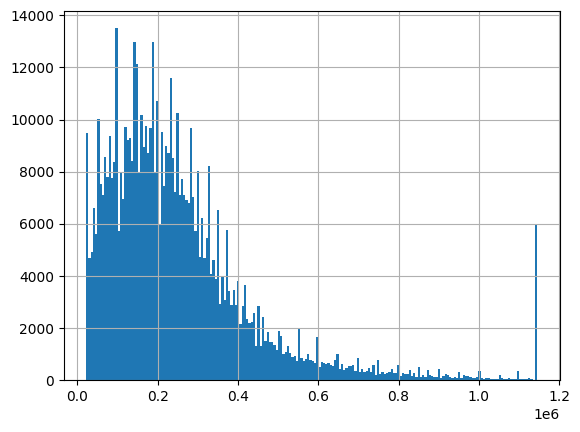

In [10]:
#show the clamped price data as a histogram
data_clamped.hist(bins=200)

<Axes: >

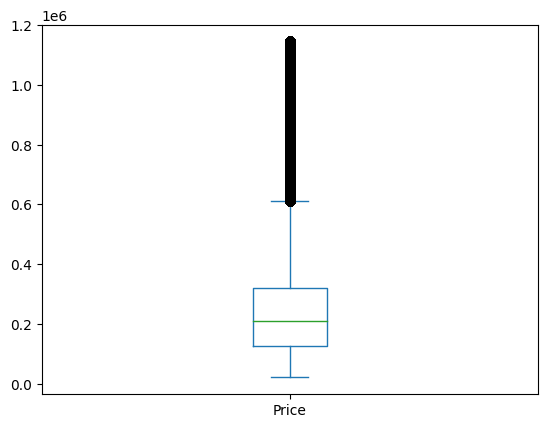

In [11]:
#show the clamped price data as a boxplot
data_clamped.plot(kind='box')

- Viewing the clamped data as a histogram, we can see that Price data is negatively skewed. From the boxplot we can still see there are outliers but we have a better understanding of the interquartile range and median compared to the maximum and minimum prices. The median price for a property appears to be around €200,000.

### Summary of data quality plan:

| Variable Names                     | Data Quality Issue            | Handling Strategy              |
|------------------------------------|-------------------------------|--------------------------------|
| DateofSale(dd/mm/yyyy)             | ----                          | ----                           |
| Address                            | ----                          | ----                           |
| Eircode                            | Missing Values                | Drop feature                   |
| County                             | ----                          | ----                           |
| Price                              | Outliers                      | Drop rows                      |
| Price                              | Irrelevant Data               | Drop rows                      |
| NotFullMarketPrice                 | ----                          | ----                           |
| VATExclusive                       | ----                          | ----                           |
| DescriptionofProperty              | ----                          | ----                           |
| PropertySizeDescription            | Missing Values                | ----                           |




<b> - Save the data quality plan to a single PDF file. </b>

In [ ]:
# saving cleaned dataframe to a csv
df.to_csv("PPR-ALL_cleaned_section2.csv")

# 3 - Exploring relationships between feature pairs

In [80]:
# load cleaned data
# file should be "PPR-ALL_cleaned_section2.csv"
df = pd.read_csv("PPR-ALL_cleaned_section3.csv", index_col=0)
df.dtypes

DateofSale                  object
Address                     object
County                      object
Price                      float64
NotFullMarketPrice          object
VATExclusive                object
DescriptionofProperty       object
PropertySizeDescription     object
dtype: object

In [67]:
# # convert feature types
# df['DateofSale'] = df['DateofSale'].astype('datetime64[ns]')
# df['County'] = df['County'].astype('category')
# df['NotFullMarketPrice'] = df['NotFullMarketPrice'].astype('category')
# df['VATExclusive'] = df['VATExclusive'].astype('category')
# df['DescriptionofProperty'] = df['DescriptionofProperty'].astype('category')
# df['PropertySizeDescription'] = df['PropertySizeDescription'].astype('category')
# df.dtypes

DateofSale                 datetime64[ns]
Address                            object
County                           category
Price                             float64
NotFullMarketPrice               category
VATExclusive                     category
DescriptionofProperty            category
PropertySizeDescription          category
dtype: object

### Choose a subset of features you find promising and plot pairwise feature interactions

<b>- Categorical vs Categorical</b>

- First I will compare all of the categorical features I find promising with the DescriptionofProperty column.

In [71]:
import matplotlib.patches as mpatches
# Function to generate Stacked Bar Charts for Categorical Columns 

def stacked_bar_chart(col):
    # will check the percentage of new vs old properties sold in the selected column by values in the column
    array = pd.unique(df[col].ravel())

    df['percent'] = 0

    for i in array:
        count = df[df[col] == i].count()['DescriptionofProperty']
        count_percentage = (1 / count) * 100
        print(i, "\t", count)
        index_list = df[df[col] == i].index.tolist()
        for ind in index_list:
            df.loc[ind, 'percent'] = count_percentage

    group = df[['percent', col, 'DescriptionofProperty']].groupby([df[col], 'DescriptionofProperty']).sum()

    my_plot = group.unstack().plot(kind='bar', stacked=True, title="Description of Property based on " + str(col) , figsize=(8,5))

    blue_patch = mpatches.Patch(color='blue', label='New Dwelling house /Apartment')
    red_patch = mpatches.Patch(color='orange', label='Second-Hand Dwelling house /Apartment')
    my_plot.legend(handles=[red_patch, blue_patch], frameon = True)

    my_plot.set_xlabel(col)
    my_plot.set_ylabel("% DescriptionofProperty")
    my_plot.set_ylim([0,100])

    df.drop("percent", axis=1, inplace = True)


Dublin 	 185607
Laois 	 9260
Meath 	 24202
Kilkenny 	 9291
Limerick 	 22024
Carlow 	 6574
Cork 	 64646
Clare 	 13571
Sligo 	 8882
Cavan 	 9064
Tipperary 	 16014
Wicklow 	 19011
Roscommon 	 8604
Wexford 	 20564
Mayo 	 14284
Donegal 	 16205
Longford 	 5151
Galway 	 29289
Offaly 	 7396
Kildare 	 31309
Waterford 	 16200
Louth 	 15990
Kerry 	 16981
Westmeath 	 11391
Monaghan 	 4669
Leitrim 	 5357


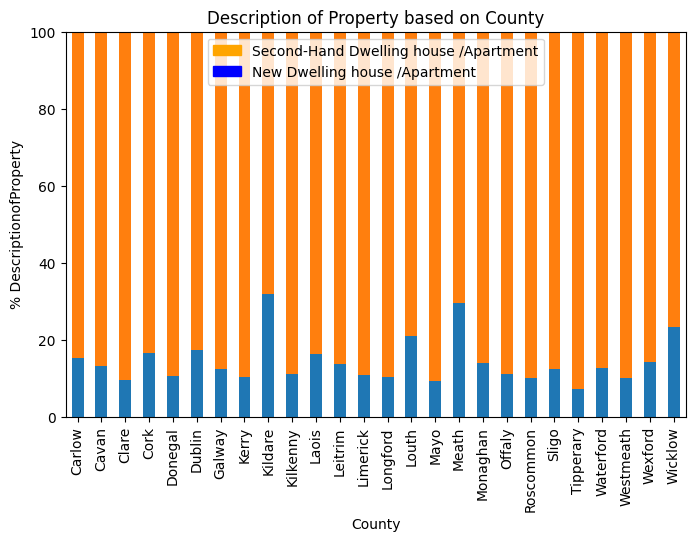

In [72]:
#check new vs old homes sold based on county
stacked_bar_chart("County")

- I suspected the highest proportion of new to old properties sold would be in either Dublin or Cork since they are the most the populous counties. This does not appear to be the case as Kildare, Meath and Wicklow had the highest amount of new homes sold compared to second hand houses, each one neighbouring Dublin.

No 	 563161
Yes 	 28375


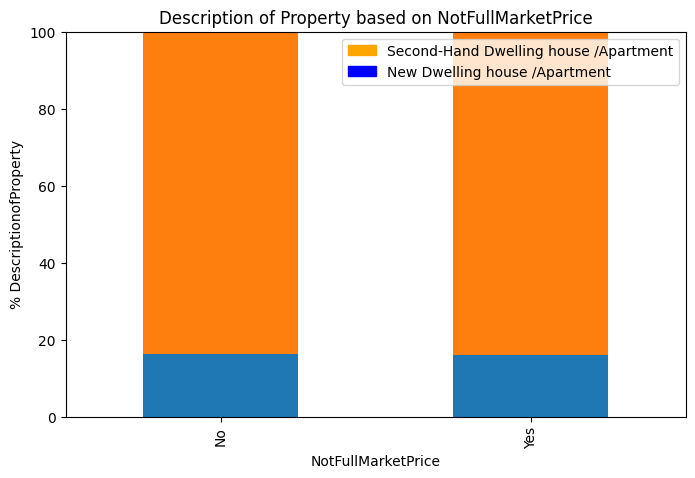

In [73]:
#check new vs old homes based on whether they are sold for full market price
stacked_bar_chart("NotFullMarketPrice")

- The number of new and second-hand properties sold for full market price is similar and so the age of the property does not appear to affect whether the seller will get full price for it.

No 	 496650
Yes 	 94886


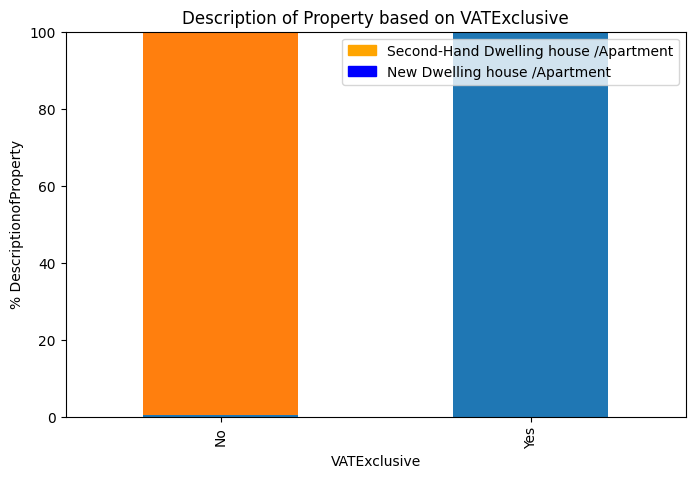

In [74]:
# check new vs old homes based on whether their prices include VAT
stacked_bar_chart("VATExclusive")

- Almost all new properties do not have VAT included in the price. 

<b>- Categorical vs Continuous

<Axes: title={'center': 'Price'}, xlabel='[DescriptionofProperty]'>

<Figure size 640x480 with 0 Axes>

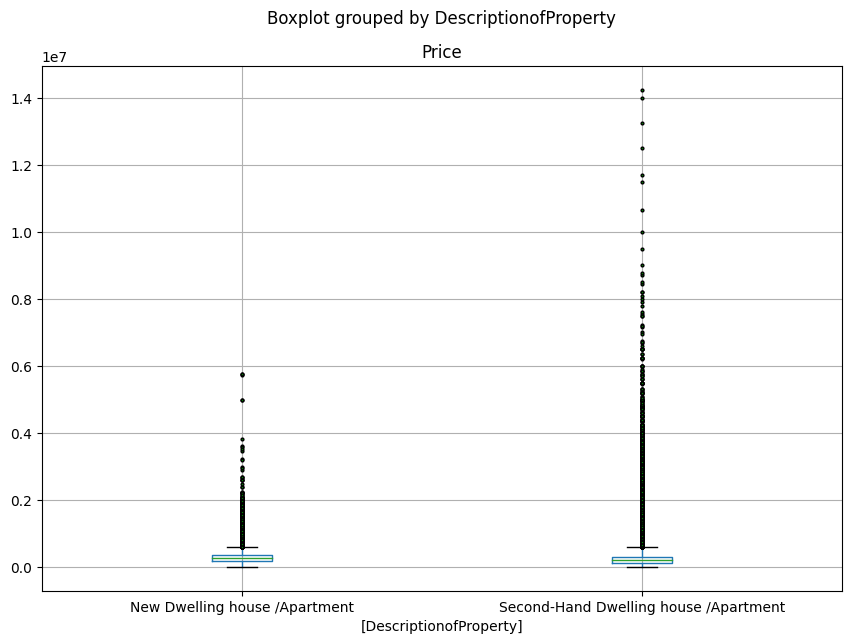

In [75]:
# code for box plot Price vs DescriptionofProperty
plt.figure()
flierprops = dict(marker='o', markerfacecolor='green', markersize=2,
                  linestyle='none')
df.boxplot(column=['Price'], by=['DescriptionofProperty'], flierprops=flierprops, figsize=(10,7))

- The box plot above shows a similar interquartile range for price, while second-hand houses appear to have a higher number of outliers over a larger range. This would suggest that price is not dependent on the age of the property, while there could be factors exclusive to second-hand houses that could cause a higher price, such as being located in desirable areas to live where new homes are not being built.

<Axes: title={'center': 'Price'}, xlabel='[PropertySizeDescription]'>

<Figure size 640x480 with 0 Axes>

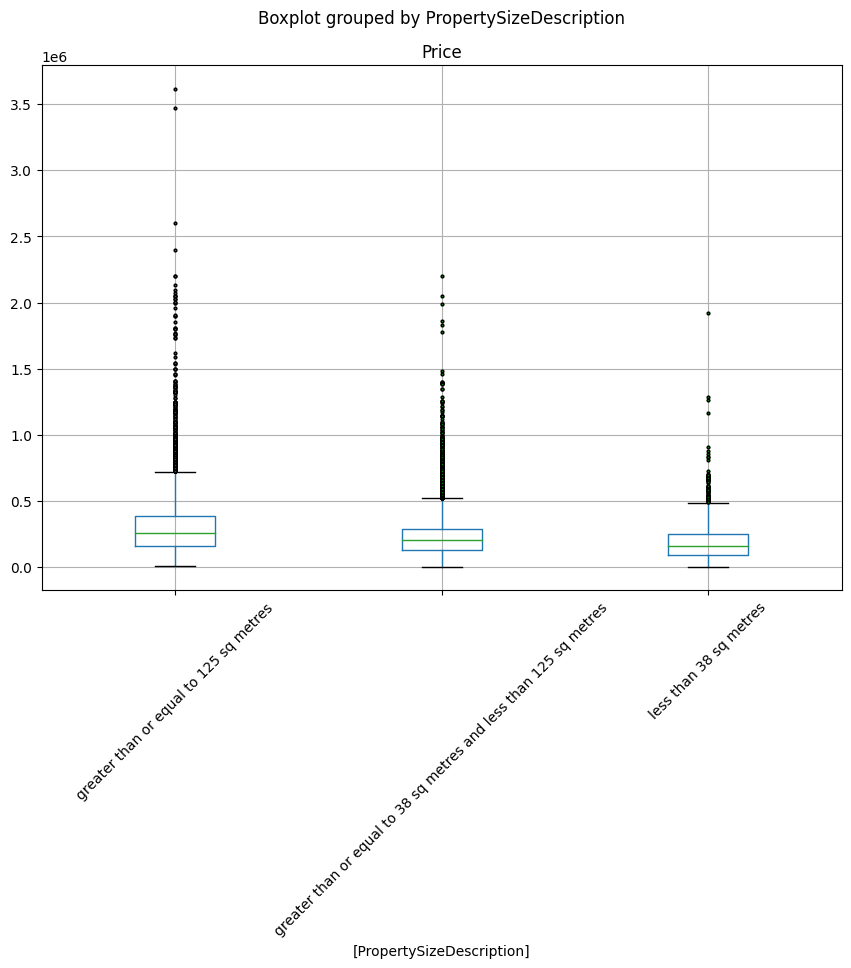

In [76]:
# code for box plot Price vs PropertySizeDescription
plt.figure()
flierprops = dict(marker='o', markerfacecolor='green', markersize=2,
                  linestyle='none')
df[df['PropertySizeDescription'] != 'other'].boxplot(column=['Price'], by=['PropertySizeDescription'], rot=45, flierprops=flierprops, figsize=(10,7))

- As expected, house size has an influence on the price, with smaller properties having a lower median price, while larger properties have the largest median price. Outliers in price may suggest competitive buying, or high demand, meaning that other factors such as location influence prices.

<Axes: title={'center': 'Price'}, xlabel='[County]'>

<Figure size 640x480 with 0 Axes>

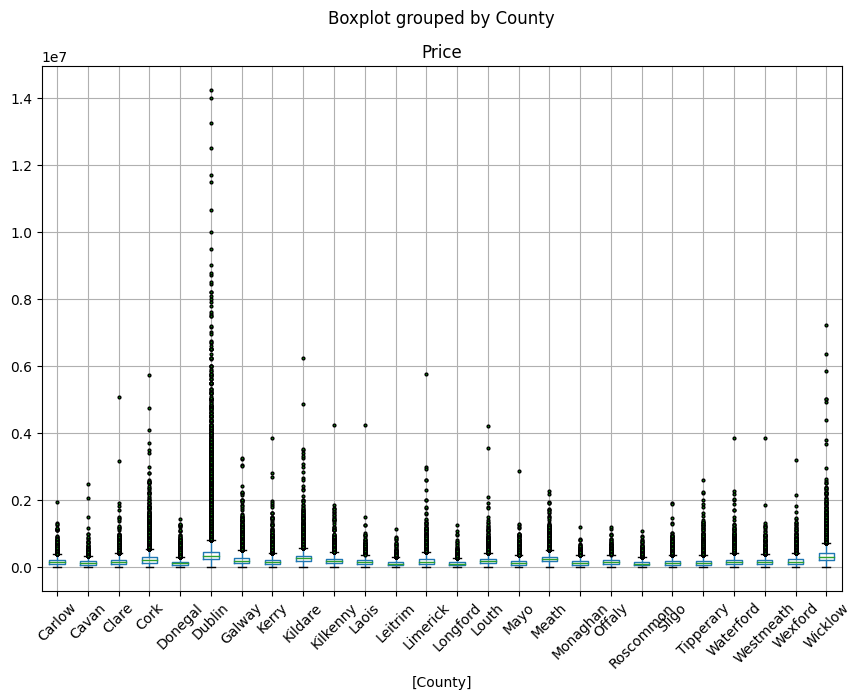

In [77]:
# code for box plot Price vs County 
plt.figure()
flierprops = dict(marker='o', markerfacecolor='green', markersize=2,
                  linestyle='none')
df.boxplot(column=['Price'], by=['County'], rot=45, flierprops=flierprops, figsize=(10,7))

- Dublin and Wicklow property prices have the largest interquartile range than other counties, and have the highest number of outliers meaning the demand for houses in each county is quite high, with a high variability in prices. It may be useful to look at average prices for each county.

Text(0.5, 0, 'County')

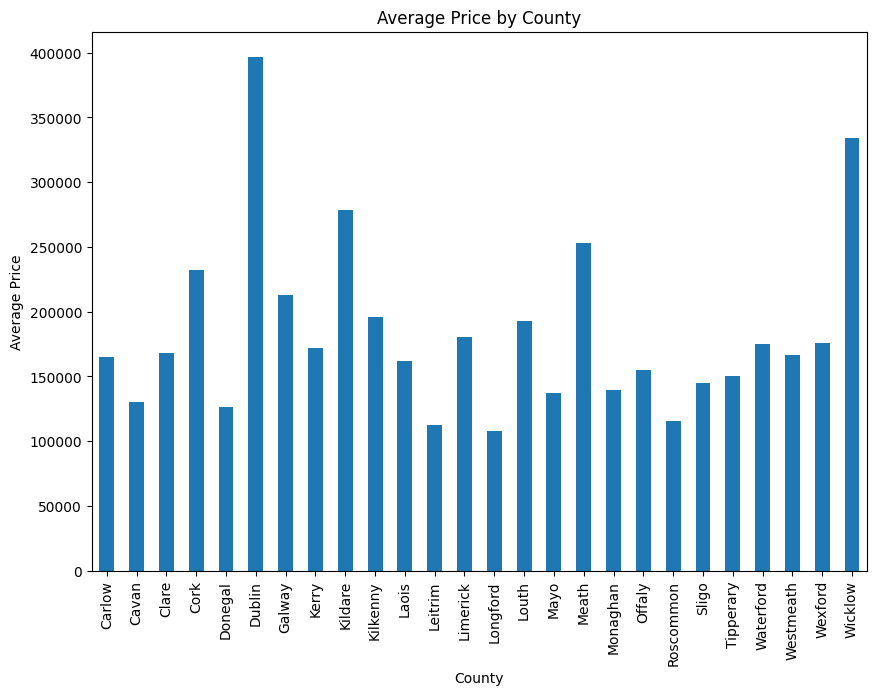

In [78]:
# bar chart of mean prices per county
plt.figure(figsize=(10,7))
df["Price"].groupby(df['County']).mean().plot(kind='bar')
plt.title("Average Price by County")
plt.ylabel("Average Price")
plt.xlabel("County")

- Here we can clearly see Dublin has the most expensive average price, with three neighbouring counties being the next highest, Wicklow, Kildare and Meath. Cork is the fourth highest, while not geographically close to Dublin, it is the second most populous county in Ireland. The average price per county seems to indicate that properties in, or close to, Dublin have the highest value.   

<b> - Discuss your findings from the plots above.

<u>Categorical vs Categorical: </u>
- Over 80% of properties sold since 2010 have been second-hand. Dublin has the highest amount of properties sold, implying that there is a high demand for Dublin properties, yet it doesn't have one of the highest percentages of new houses sold. The two counties with the rates for new properties are Kildare and Meath, which neighbour Dublin, suggesting that if people can't get housing in Dublin, they will try to live nearby.
- The age of a property does not have an effect on whether a seller will get full market price for it.
- The prices of new properties do not have VAT included in the price.

<u>Categorical vs Continuous:</u>
- There does not appear to be a relationship to the price of a property and its age.
- Property prices appear to increase with the size of the property.
- There appears to be a relationship between the price a property and its location in relation to Dublin, with surrounding counties have the next highest average prices per county after Dublin. 

# 4 - Transform, extend or combine the existing features to create a few new features

In [81]:
# load cleaned data
# file should be "PPR-ALL_cleaned_section2.csv"
df = pd.read_csv("PPR-ALL_cleaned_section3.csv", index_col=0)
df.shape

(591536, 8)

New features we will implement:
- Postal Code
- Month of Sale
- Year of Sale
- Geolocation

### Feature 1
    
- The first feature I want to create is one which shows which postal code each address was sold. This will only be possible for Dublin properties since it is the only county with mutiple postal codes. Since Dublin has the most expensive average property prices, it will be interesting to see if there is a correlation between property prices and certain areas within Dublin.

In [82]:
postal_codes = ['DUBLIN 1', 'DUBLIN 2', 'DUBLIN 3', 'DUBLIN 4', 'DUBLIN 5', 'DUBLIN 6', 'DUBLIN 6 W', 
                'DUBLIN 6W', 'DUBLIN 7', 'DUBLIN 8', 'DUBLIN 9', 'DUBLIN 10', 'DUBLIN 11', 'DUBLIN 12', 'DUBLIN 13', 
               'DUBLIN 14', 'DUBLIN 15', 'DUBLIN 16', 'DUBLIN 17', 'DUBLIN 18', 'DUBLIN 20', 'DUBLIN 22', 
               'DUBLIN 24', ' D 1', ' D 2', ' D 3', ' D 4', ' D 5', ' D 6', ' D 6 W', ' D 7', ' D 8', ' D 9', 
                ' D 10', ' D 11', ' D 12', ' D 13', ' D 14', ' D 15', ' D 16', ' D 17', ' D 18', ' D 20', 
                ' D 22', ' D 24', 'CO. DUBLIN', 'CO DUBLIN', 'COUNTY DUBLIN']
df['PostalCode'] = np.nan

for row in range(0, len(df)):
    if df.loc[row]['County'] == 'Dublin':
        address = df.loc[row]['Address'].split(',')
        for code in postal_codes:
            if (code == address[-1]) | ((code.replace(" ", "") == address[-1])):
#                 print(row, code)
                df.at[row, 'PostalCode'] = code
            elif (code in address[-1]) | ((code.replace(" ", "") in address[-1])):
                df.at[row, 'PostalCode'] = code

In [83]:
df['County'].value_counts()

County
Dublin       185607
Cork          64646
Kildare       31309
Galway        29289
Meath         24202
Limerick      22024
Wexford       20564
Wicklow       19011
Kerry         16981
Donegal       16205
Waterford     16200
Tipperary     16014
Louth         15990
Mayo          14284
Clare         13571
Westmeath     11391
Kilkenny       9291
Laois          9260
Cavan          9064
Sligo          8882
Roscommon      8604
Offaly         7396
Carlow         6574
Leitrim        5357
Longford       5151
Monaghan       4669
Name: count, dtype: int64

In [84]:
df[df['County'] == 'Dublin']['PostalCode'].isnull().sum()

96777

- We can see that we were able to determine the postal codes of just under half of Dublin properties. I will look closer at the properties that have no postal code information.

In [85]:
pd.set_option('display.max_rows', len(df))

df[(df['County'] == 'Dublin') & (df['PostalCode'].isnull())]['Address']

5                            12 SALLYMOUNT AVENUE, RANELAGH
13                                 23 ELTON PARK, SANDYCOVE
16                            29 CARYSFORT WOODS, BLACKROCK
21                         49 BALLYNAKELLY GREEN, NEWCASTLE
23                          54., BRIDES GLEN AVENUE, SWORDS
42                 THE MEWS, 11A WYCKHAM PARK ROAD, DUNDRUM
47         134 LONGBOAT QUAY NORTH, SIR JOHN ROGERSONS QUAY
50                              15 SPENCE, VILLAS, GLENGEAR
56                     3 MYRTLE SQUARE, THE COAST, BALDOYLE
61                             6 CLONASLEIGH LANE, SHANKILL
63                        66 VILLA PARK GARDENS, NAVAN ROAD
65                              87 MANGERTON RAOD, DRIMNAGH
67                            APT 1 LINDEN COURT, BLACKROCK
76                         11 TRITONVILLE COURT, SANDYMOUNT
87                  58 PALMER PARK, BALLYBODEN, RATHFARNHAM
95                      84 CASTLELAND PARK VIEW, BALBRIGGAN
97                9 COLTHURST GREEN, HUN

In [86]:
areas = {'DUBLIN 1' : ['ABBEY ST', 'AMIENS ST', 'CAPEL ST', 'DORSET ST', 'HENRY ST', 'MARY ST', 'MOUNTJOY SQ', 
                       'MARLBOROUGH ST', 'NORTH WALL', 'O\'CONNELL ST', 'PARNELL SQ', 'TALBOT ST'], 
         'DUBLIN 2' : ['DAME ST', 'MERRION SQ', 'TEMPLE BAR', 'GRAFTON ST', 'STEPHEN\'S GR', 'STEPHENS GR', 
                       'LOWER LEESON ST', 'AUNGIER ST', 'WEXFORD ST', 'CAMDEN ST'], 
         'DUBLIN 3' : ['BALLYBOUGH,', 'NORTH STRAND', 'DOLLYMOUNT', 'CLONTARF', 'EAST WALL', 'FAIRVIEW', 'MARINO', 
                       'CLONLIFFE', 'KILLESTER'], 
         'DUBLIN 4' : ['UPPER LEESON ST', 'BALLSBRIDGE', 'DONNYBROOK', 'IRISHTOWN', 'BELFIELD', 'MERRION', 'PEMBROKE',
                      'RINGSEND', 'SANDYMOUNT'],
         'DUBLIN 5' : ['ARTANE', 'COOLOCK', 'HARMONSTOWN', 'KILBARRACK', 'KILLESTER', 'RAHENY'], 
         'DUBLIN 6' : ['MILLTOWN', 'RANELAGH', 'TERENURE', 'RATHMINES', 'DARTRY', 'RATHGAR'], 
         'DUBLIN 6W' : ['HAROLD\'S CROSS', 'HAROLDS CROSS', 'HAROLDSCROSS', 'TEMPLEOGUE', 'KIMMAGE', 'TERENURE'], 
         'DUBLIN 7' : ['ARBOUR HILL', 'ASHTOWN', 'BROADSTONE', 'CABRA', 'GRANGEGORMAN', 'OXMANTOWN', 'PHIBSBOROUGH',
                      'SMITHFIELD', 'STONEYBATTER'], 
         'DUBLIN 8' : ['DOLPHIN\'S BARN', 'DOLPHINS BARN', 'INCHICORE', 'ISLANDBRIDGE', 'KILMAINHAM', 'MERCHANTS QUAY',
                      'PORTOBELLO', 'SOUTH CIRCULAR ROAD', 'SOUTH CIRCULAR RD', 'LIBERTIES', 'PHOENIX PARK'], 
         'DUBLIN 9' : ['SHANGAN', 'COULTRY', 'BEAUMOUNT', 'DONNYCARNEY', 'DRUMCONDRA', 'ELM MOUNT', 'GRIFFITH AVE', 'GLASNEVIN',
                      'SANTRY', 'WHITEHALL'], 
         'DUBLIN 10' : ['BALLYFERMOT', 'SARSFIELD ROAD', 'SARSFIELD RD', 'CHERRY ORCHARD'], 
         'DUBLIN 11' : ['SILLOGUE', 'BALBUTCHER', 'BALCURRIS', 'POPINTREE', 'SANDYHILL', 'WADELEI', 'DUBBER CROSS',
                       'FINGLAS', 'CAPPAGH', 'CREMORE', 'ADDISON', 'VIOLET HILL', 'FINGLAS ROAD', 'FINGLAS RD',
                       'KILSHANE CROSS', 'THE WARD', 'COOLQUAY'],
         'DUBLIN 12' : ['BLUEBELL', 'CRUMLIN', 'TERENURE', 'KIMMAGE', 'DRIMNAGH', 'GREENHILLS', 'PERRYSTOWN',
                       'WALKINSTOWN'], 
         'DUBLIN 13' : ['BALDOYLE', 'BAYSIDE', 'DONAGHMEDE', 'CLONGRIFFIN', 'SUTTON', 'HOWTH', 'AYRFIELD'], 
         'DUBLIN 14' : ['CHURCHTOWN', 'CLONSKEAGH', 'DUNDRUM', 'GOATSTOWN', 'RATHFARNHAM', 'WINDY ARBOUR'], 
         'DUBLIN 15' : ['ASHTOWN', 'BLANCHARDSTOWN', 'CASTLEKNOCK', 'COOLMINE', 'CLONSILLA', 'CORDUFF', 'MULHUDDART',
                       'TYRRELSTOWN', 'ONGAR', 'CLONEE'], 
         'DUBLIN 16' : ['BALLINTEER', 'BALLYBODEN', 'KILMASHOGUE', 'KNOCKLYON', 'ROCKBROOK'], 
         'DUBLIN 17' : ['BALGRIFFON', 'COOLOCK', 'BELCAMP', 'DARNDALE', 'PRIORSWOOD'], 
         'DUBLIN 18' : ['CABINTEELY', 'CARRICKMINES', 'FOXROCK', 'KILTERNAN', 'SANDYFORD', 'SHANKILL', 'TICKNOCK', 
                       'BALLYEDMONDUFF', 'STEPASIDE', 'LEOPARDSTOWN'], 
         'DUBLIN 20' : ['CHAPELIZOD', 'PALMERSTOWN'], 
         'DUBLIN 22' : ['CLONDALKIN', 'LIFFEY VALLEY', 'NEWCASTLE', 'NEILSTOWN'], 
         'DUBLIN 24' : ['FIRHOUSE', 'JOBSTOWN', 'OLD BAWN', 'TALLAGHT', 'BALLYMOUNT']}

In [87]:
for code in areas:
    for c in areas[code]:
        print('***********************************')
        print(c)
        print('Number of addresses in this area with no postal code: ')
        print(df[((df['Address'].str.contains(c)) & (df['County'] == 'Dublin'))]['PostalCode'].isnull().sum())
        print('Number of postal codes with this address: ')
        print(df[((df['Address'].str.contains(c)) & (df['County'] == 'Dublin'))]['PostalCode'].value_counts())
        
        print('***********************************')

***********************************
ABBEY ST
Number of addresses in this area with no postal code: 
36
Number of postal codes with this address: 
PostalCode
DUBLIN 1      40
DUBLIN 13      1
CO. DUBLIN     1
CO DUBLIN      1
Name: count, dtype: int64
***********************************
***********************************
AMIENS ST
Number of addresses in this area with no postal code: 
6
Number of postal codes with this address: 
PostalCode
DUBLIN 1    28
Name: count, dtype: int64
***********************************
***********************************
CAPEL ST
Number of addresses in this area with no postal code: 
24
Number of postal codes with this address: 
PostalCode
DUBLIN 1    51
DUBLIN 7     5
Name: count, dtype: int64
***********************************
***********************************
DORSET ST
Number of addresses in this area with no postal code: 
44
Number of postal codes with this address: 
PostalCode
DUBLIN 1    76
DUBLIN 7    24
DUBLIN 3     1
DUBLIN 4     1
Name: count,

PostalCode
DUBLIN 4    36
DUBLIN 2     2
Name: count, dtype: int64
***********************************
***********************************
BALLSBRIDGE
Number of addresses in this area with no postal code: 
609
Number of postal codes with this address: 
PostalCode
DUBLIN 4    1106
DUBLIN 2       2
DUBLIN 1       1
Name: count, dtype: int64
***********************************
***********************************
DONNYBROOK
Number of addresses in this area with no postal code: 
369
Number of postal codes with this address: 
PostalCode
DUBLIN 4     930
DUBLIN 14      3
 D 4           1
DUBLIN 6       1
DUBLIN 1       1
Name: count, dtype: int64
***********************************
***********************************
IRISHTOWN
Number of addresses in this area with no postal code: 
58
Number of postal codes with this address: 
PostalCode
DUBLIN 4    148
Name: count, dtype: int64
***********************************
***********************************
BELFIELD
Number of addresses in this area wi

PostalCode
DUBLIN 7    110
Name: count, dtype: int64
***********************************
***********************************
ASHTOWN
Number of addresses in this area with no postal code: 
586
Number of postal codes with this address: 
PostalCode
DUBLIN 15    341
DUBLIN 7      34
DUBLIN 9       2
CO DUBLIN      1
DUBLIN 11      1
Name: count, dtype: int64
***********************************
***********************************
BROADSTONE
Number of addresses in this area with no postal code: 
22
Number of postal codes with this address: 
PostalCode
DUBLIN 7    49
Name: count, dtype: int64
***********************************
***********************************
CABRA
Number of addresses in this area with no postal code: 
312
Number of postal codes with this address: 
PostalCode
DUBLIN 7     1084
DUBLIN 6W       2
DUBLIN 5        2
DUBLIN 4        1
DUBLIN 11       1
Name: count, dtype: int64
***********************************
***********************************
GRANGEGORMAN
Number of addre

PostalCode
DUBLIN 9     503
DUBLIN 12    116
DUBLIN 14     23
DUBLIN 6W     10
DUBLIN 11      5
DUBLIN 6       2
DUBLIN 7       1
DUBLIN 3       1
DUBLIN 5       1
Name: count, dtype: int64
***********************************
***********************************
BALLYFERMOT
Number of addresses in this area with no postal code: 
412
Number of postal codes with this address: 
PostalCode
DUBLIN 10    890
DUBLIN 12      3
DUBLIN 20      2
DUBLIN 16      1
CO DUBLIN      1
Name: count, dtype: int64
***********************************
***********************************
SARSFIELD ROAD
Number of addresses in this area with no postal code: 
22
Number of postal codes with this address: 
PostalCode
DUBLIN 10    14
Name: count, dtype: int64
***********************************
***********************************
SARSFIELD RD
Number of addresses in this area with no postal code: 
18
Number of postal codes with this address: 
PostalCode
DUBLIN 10    107
DUBLIN 8      11
DUBLIN 20      1
Name: count, 

PostalCode
DUBLIN 13    143
CO DUBLIN      2
DUBLIN 5       1
Name: count, dtype: int64
***********************************
***********************************
DONAGHMEDE
Number of addresses in this area with no postal code: 
139
Number of postal codes with this address: 
PostalCode
DUBLIN 13    365
DUBLIN 5       5
DUBLIN 15      2
Name: count, dtype: int64
***********************************
***********************************
CLONGRIFFIN
Number of addresses in this area with no postal code: 
516
Number of postal codes with this address: 
PostalCode
DUBLIN 13    298
CO DUBLIN      1
DUBLIN 15      1
DUBLIN 17      1
Name: count, dtype: int64
***********************************
***********************************
SUTTON
Number of addresses in this area with no postal code: 
409
Number of postal codes with this address: 
PostalCode
DUBLIN 13        686
CO DUBLIN          6
COUNTY DUBLIN      5
DUBLIN 15          5
DUBLIN 3           3
DUBLIN 5           2
CO. DUBLIN         1
Name: cou

PostalCode
DUBLIN 18    19
DUBLIN 16    10
CO DUBLIN     1
DUBLIN 14     1
Name: count, dtype: int64
***********************************
***********************************
BALGRIFFON
Number of addresses in this area with no postal code: 
0
Number of postal codes with this address: 
Series([], Name: count, dtype: int64)
***********************************
***********************************
COOLOCK
Number of addresses in this area with no postal code: 
240
Number of postal codes with this address: 
PostalCode
DUBLIN 5     307
DUBLIN 17    231
DUBLIN 13      8
DUBLIN 9       7
DUBLIN 7       3
Name: count, dtype: int64
***********************************
***********************************
BELCAMP
Number of addresses in this area with no postal code: 
162
Number of postal codes with this address: 
PostalCode
DUBLIN 17    29
DUBLIN 13     1
Name: count, dtype: int64
***********************************
***********************************
DARNDALE
Number of addresses in this area with no p

- Here we can see that some areas can have multiple postal codes. Some of these contain the area name in the first line of the address and may be in a different area. I will investigate further and only assign postal codes to addresses in areas that have one definitive code.

In [88]:
areas = {'DUBLIN 1' : ['ABBEY ST', 'AMIENS ST', 'MOUNTJOY SQ', 
                       'MARLBOROUGH ST', 'PARNELL SQ', 'TALBOT ST'], 
         'DUBLIN 2' : ['DAME ST', 'MERRION SQ', 'GRAFTON ST', 'STEPHEN\'S GR', 'STEPHENS GR', 
                       'LOWER LEESON ST', 'CAMDEN ST'], 
         'DUBLIN 3' : ['BALLYBOUGH', 'DOLLYMOUNT', 'CLONTARF', 'EAST WALL', 'FAIRVIEW', 
                       'CLONLIFFE'], #clonliffe
         'DUBLIN 4' : ['UPPER LEESON ST', 'BALLSBRIDGE', 'DONNYBROOK', 'IRISHTOWN', 'BELFIELD', 'MERRION', 'PEMBROKE',
                      'RINGSEND', 'SANDYMOUNT'], #ringsend
         'DUBLIN 5' : ['ARTANE', 'HARMONSTOWN', 'RAHENY'], #raheny
         'DUBLIN 6' : ['RANELAGH', 'RATHMINES', 'DARTRY', 'RATHGAR'], 
         'DUBLIN 6W' : ['HAROLD\'S CROSS', 'HAROLDS CROSS'], #HAROLDS CROSS
         'DUBLIN 7' : ['ARBOUR HILL', 'BROADSTONE', 'CABRA', 'GRANGEGORMAN', 'OXMANTOWN', 'PHIBSBOROUGH',
                      'SMITHFIELD', 'STONEYBATTER'], 
         'DUBLIN 8' : ['DOLPHIN\'S BARN', 'DOLPHINS BARN', 'INCHICORE', 'ISLANDBRIDGE', 'KILMAINHAM', 
                      'PORTOBELLO', 'SOUTH CIRCULAR ROAD', 'SOUTH CIRCULAR RD', 'LIBERTIES'], 
         'DUBLIN 9' : ['BEAUMOUNT', 'DRUMCONDRA', 'ELM MOUNT', 'GRIFFITH AVE',
                      'SANTRY', 'WHITEHALL'], 
         'DUBLIN 10' : ['BALLYFERMOT', 'SARSFIELD ROAD', 'SARSFIELD RD', 'CHERRY ORCHARD'], 
         'DUBLIN 11' : ['SILLOGUE', 'BALBUTCHER', 'SANDYHILL', 'DUBBER CROSS',
                       'FINGLAS', 'CAPPAGH', 'CREMORE', 'ADDISON', 'VIOLET HILL', 'FINGLAS ROAD', 'FINGLAS RD',
                       'COOLQUAY'],
         'DUBLIN 12' : ['BLUEBELL', 'CRUMLIN', 'DRIMNAGH', 'GREENHILLS', 'PERRYSTOWN',
                       'WALKINSTOWN'], 
         'DUBLIN 13' : ['BALDOYLE', 'BAYSIDE', 'DONAGHMEDE', 'CLONGRIFFIN', 'SUTTON', 'HOWTH', 'AYRFIELD'], 
         'DUBLIN 14' : ['CHURCHTOWN', 'CLONSKEAGH', 'GOATSTOWN', 'WINDY ARBOUR'], 
         'DUBLIN 15' : ['ASHTOWN', 'BLANCHARDSTOWN', 'CASTLEKNOCK', 'COOLMINE', 'CLONSILLA', 'CORDUFF', 'MULHUDDART',
                       'TYRRELSTOWN', 'ONGAR', 'CLONEE'], 
         'DUBLIN 16' : ['BALLINTEER', 'BALLYBODEN', 'KNOCKLYON'], 
         'DUBLIN 17' : ['BELCAMP', 'DARNDALE', 'PRIORSWOOD'], 
         'DUBLIN 18' : ['CABINTEELY', 'CARRICKMINES', 'FOXROCK', 'KILTERNAN', 'SHANKILL', 'TICKNOCK', 
                       'BALLYEDMONDUFF', 'STEPASIDE', 'LEOPARDSTOWN'], 
         'DUBLIN 20' : ['CHAPELIZOD', 'PALMERSTOWN'], 
         'DUBLIN 22' : ['CLONDALKIN', 'NEILSTOWN'], 
         'DUBLIN 24' : ['FIRHOUSE', 'JOBSTOWN', 'OLD BAWN', 'TALLAGHT', 'BALLYMOUNT']}

In [89]:
key_list = list(areas.keys())
val_list = list(areas.values())

for row in range(0, len(df)):
    if (df['County'][row] == 'Dublin') & (pd.isnull(df['PostalCode'][row])):
        address = df['Address'][row].split(',')
#         print(address)

        for count, values in enumerate(val_list):
            for count2, place in enumerate(values): 
                    if (address[-1].strip(' ') == place):
                        position = val_list.index(values)
                        df.at[row, 'PostalCode'] = key_list[position]

                    elif (address[-2].strip(' ') == place):
                        position = val_list.index(values)
                        df.at[row, 'PostalCode'] = key_list[position]

df[df['County'] == 'Dublin']['PostalCode'].isnull().sum()

71914

In [90]:
df['PostalCode'].unique()

array(['CO. DUBLIN', nan, 'DUBLIN 14', 'DUBLIN 6', 'DUBLIN 3',
       'DUBLIN 15', 'DUBLIN 4', 'COUNTY DUBLIN', 'DUBLIN 11', 'DUBLIN 24',
       'DUBLIN 13', 'DUBLIN 18', 'DUBLIN 12', 'DUBLIN 16', 'DUBLIN 22',
       'DUBLIN 9', 'DUBLIN 1', 'DUBLIN 7', 'DUBLIN 17', 'DUBLIN 10',
       'DUBLIN 6 W', 'CO DUBLIN', 'DUBLIN 5', 'DUBLIN 8', 'DUBLIN 6W',
       'DUBLIN 20', ' D 15', ' D 16', 'DUBLIN 2', ' D 24', ' D 7',
       ' D 18', ' D 13', ' D 4', ' D 8', ' D 9', ' D 6 W', ' D 5', ' D 2',
       ' D 14', ' D 12'], dtype=object)

In [91]:
df = df.replace({'PostalCode': {' D 1' :  'DUBLIN 1',
                                ' D 2' : 'DUBLIN 2',
                                ' D 3' : 'DUBLIN 3',
                                ' D 4' : 'DUBLIN 4',
                                ' D 5' : 'DUBLIN 5',
                                ' D 6' : 'DUBLIN 6',
                                ' D 6W' : 'DUBLIN 6W',
                                ' D 6 W' : 'DUBLIN 6W',
                                'DUBLIN 6 W' : 'DUBLIN 6W',
                                ' D 7' : 'DUBLIN 7',
                                ' D 8' : 'DUBLIN 8',
                                ' D 9' : 'DUBLIN 9',
                                ' D 10' : 'DUBLIN 10',
                                ' D 11' : 'DUBLIN 11',
                                ' D 12' : 'DUBLIN 12',
                                ' D 13' : 'DUBLIN 13',
                                ' D 14' : 'DUBLIN 14',
                                ' D 15' : 'DUBLIN 15',
                                ' D 16' : 'DUBLIN 16',
                                ' D 17' : 'DUBLIN 17',
                                ' D 18' : 'DUBLIN 18',
                                ' D 20' : 'DUBLIN 20',
                                ' D 22' : 'DUBLIN 22',
                                ' D 24' : 'DUBLIN 24',
                                'CO DUBLIN' : 'COUNTY DUBLIN',
                                'CO. DUBLIN' : 'COUNTY DUBLIN'
                             }})
df[df['County'] == 'Dublin']['PostalCode'].isnull().sum()
# df['PostalCode'].unique()

71914

In [92]:
df['PostalCode'].unique()

array(['COUNTY DUBLIN', nan, 'DUBLIN 14', 'DUBLIN 6', 'DUBLIN 3',
       'DUBLIN 15', 'DUBLIN 4', 'DUBLIN 11', 'DUBLIN 24', 'DUBLIN 13',
       'DUBLIN 18', 'DUBLIN 12', 'DUBLIN 16', 'DUBLIN 22', 'DUBLIN 9',
       'DUBLIN 1', 'DUBLIN 7', 'DUBLIN 17', 'DUBLIN 10', 'DUBLIN 6W',
       'DUBLIN 5', 'DUBLIN 8', 'DUBLIN 20', 'DUBLIN 2'], dtype=object)

<b> - Number of Sales per Dublin Postal Code </b>

Text(0.5, 0, 'Dublin Postal Code')

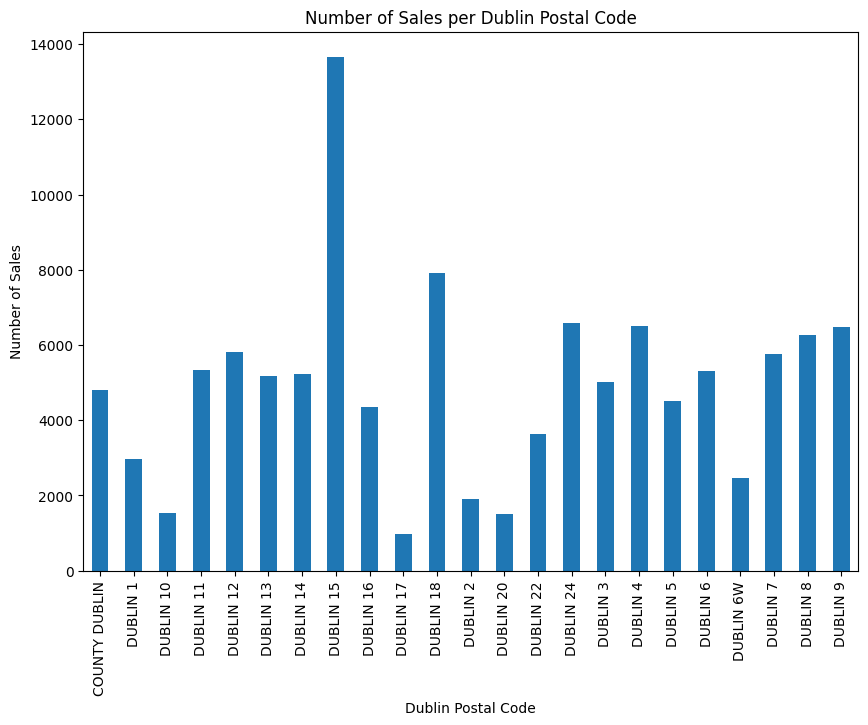

In [96]:
# Plot bar chart for Number of Sales in each Dublin area
plt.figure(figsize=(10,7))
df["Price"].groupby(df['PostalCode']).count().plot(kind='bar')
plt.title("Number of Sales per Dublin Postal Code")
plt.ylabel("Number of Sales")
plt.xlabel("Dublin Postal Code")

<b> - DescriptionofProperty per Dublin Postal Code </b>

COUNTY DUBLIN 	 4803
nan 	 0
DUBLIN 14 	 5218


/var/folders/bn/6x11zktd6n14vfwyb0jymgt00000gp/T/ipykernel_31017/406172032.py:12: RuntimeWarning: divide by zero encountered in long_scalars
  count_percentage = (1 / count) * 100


DUBLIN 6 	 5302
DUBLIN 3 	 5030
DUBLIN 15 	 13646
DUBLIN 4 	 6496
DUBLIN 11 	 5340
DUBLIN 24 	 6576
DUBLIN 13 	 5169
DUBLIN 18 	 7924
DUBLIN 12 	 5822
DUBLIN 16 	 4363
DUBLIN 22 	 3623
DUBLIN 9 	 6473
DUBLIN 1 	 2971
DUBLIN 7 	 5765
DUBLIN 17 	 988
DUBLIN 10 	 1530
DUBLIN 6W 	 2457
DUBLIN 5 	 4523
DUBLIN 8 	 6260
DUBLIN 20 	 1517
DUBLIN 2 	 1897


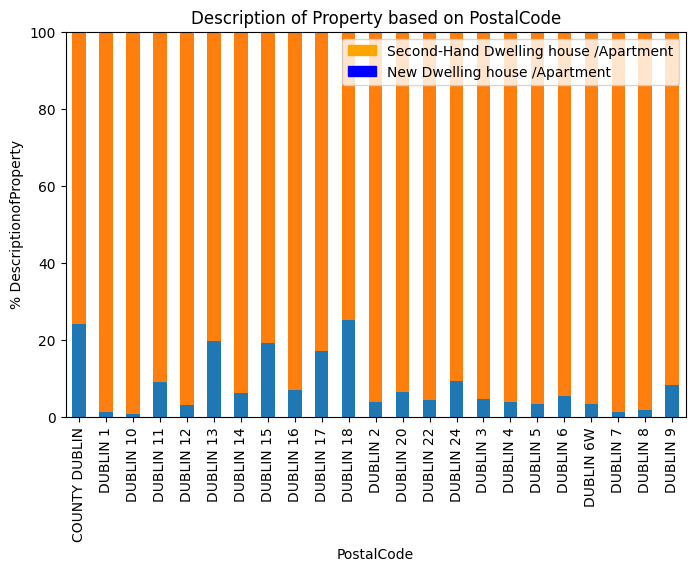

In [93]:
# check new vs old homes sold in Dublin based on postal code
stacked_bar_chart("PostalCode")

- Dublin 15 appears to be a newly desirable area to live as it has the highest number of properties sold and the fourth highest rate of new properties sold in Dublin.
- Here we can see Dublin 18 and County Dublin have the largest proportions of new houses sold compared to second hand houses. These areas are further out from the city centre than most other postal code areas which may indicate it is easier to build new properties further outside the city center. 


<Axes: title={'center': 'Price'}, xlabel='[PostalCode]'>

<Figure size 640x480 with 0 Axes>

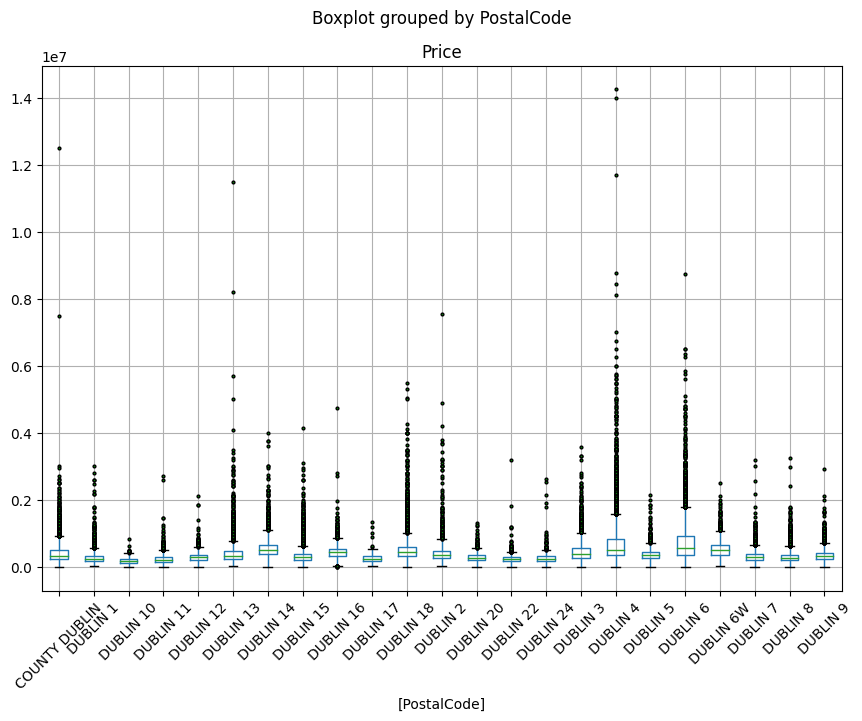

In [97]:
# code for box plot grouped by postal code
plt.figure()
flierprops = dict(marker='o', markerfacecolor='green', markersize=2,
                  linestyle='none')
df.boxplot(column=['Price'], by=['PostalCode'], rot=45, flierprops=flierprops, figsize=(10,7))

- Dublin 4 appears to have the largest range of prices for Dublin properties, showing a high variability in price.   High outliers seem to suggest a high demand with buyers more than willing to pay a high price. I will look at the average price per Dublin area to get a better understanding of Dublin property prices.


<b> - Average Price per Dublin Postal Code </b>

Text(0.5, 0, 'Dublin Area')

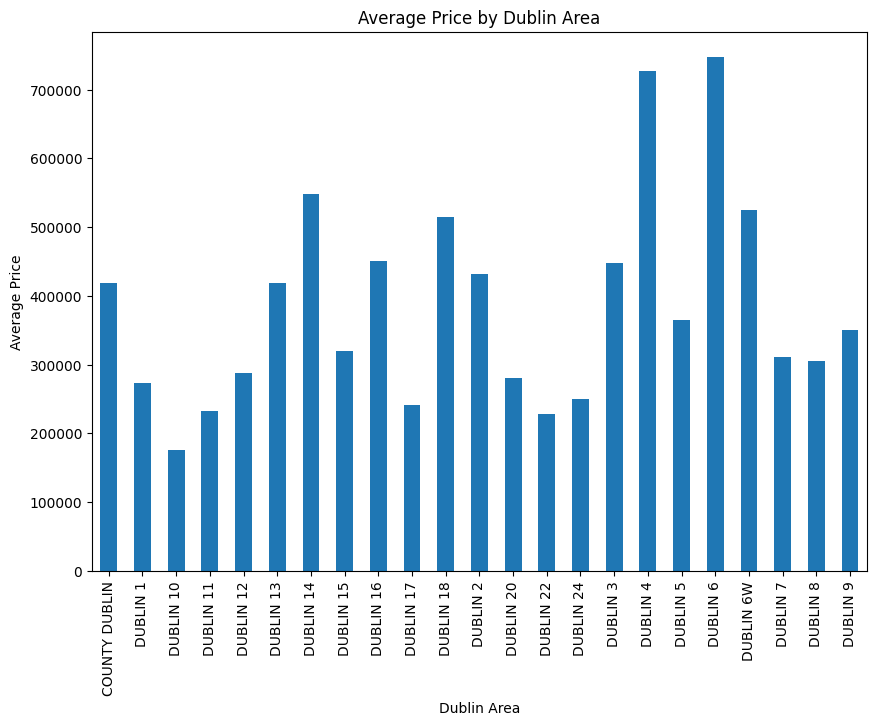

In [98]:
# bar chart for Average Price per Dublin Postal Code
plt.figure(figsize=(10,7))
df["Price"].groupby(df['PostalCode']).mean().plot(kind='bar')
plt.title("Average Price by Dublin Area")
plt.ylabel("Average Price")
plt.xlabel("Dublin Area")

- Here we can see Dublin 6 properties have the highest average Price, followed by Dublin 4, Dublin 14 and Dublin 6W.   Interestingly, these are all areas south of the River Liffey. The highest prices in the northside are located in Dublin 3, which has the 7th highest average price per area code.

### Feature 2 
    
- The second feature I want to create is one which examines the month each address was sold. It will be interesting to see if sales peak at a certain time of year. 

In [100]:
#create a new column listing the month of each sale
df['MonthofSale'] = pd.DatetimeIndex(df['DateofSale']).month

In [101]:
#check the column has been added by checking first 5 rows
df.head(5)

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription,PostalCode,MonthofSale
0,2010-01-01,"5 BRAEMOR DRIVE, CHURCHTOWN, CO.DUBLIN",Dublin,343000.0,No,No,Second-Hand Dwelling house /Apartment,other,COUNTY DUBLIN,1
1,2010-01-03,"134 ASHEWOOD WALK, SUMMERHILL LANE, PORTLAOISE",Laois,185000.0,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...,NaN,1
2,2010-01-04,"1 MEADOW AVENUE, DUNDRUM, DUBLIN 14",Dublin,438500.0,No,No,Second-Hand Dwelling house /Apartment,other,DUBLIN 14,1
3,2010-01-04,"1 THE HAVEN, MORNINGTON",Meath,400000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,1
4,2010-01-04,"11 MELVILLE HEIGHTS, KILKENNY",Kilkenny,160000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,1


Text(0.5, 1.0, 'Property Sales by month')

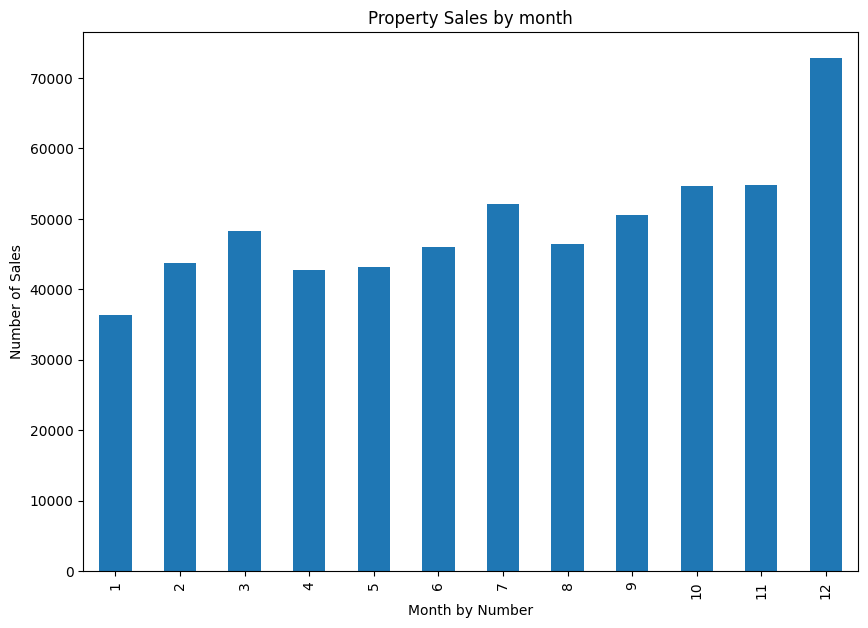

In [102]:
# plot the number of sales per month to look for a trend
plt.figure(figsize=(10,7))
df['MonthofSale'].value_counts().sort_index(ascending=True).plot(kind='bar')
plt.ylabel('Number of Sales')
plt.xlabel('Month by Number')
plt.title('Property Sales by month')

- It appears the amount of properties sold per month trends upwards throughout the year with total properties sold peaking in December.

### Feature 3 
    
- The third feature I want to create is one which examines the year each address was sold. I would like to see whether house prices have changed from year to year. 

In [103]:
# create a new column with the year of sale
df['YearofSale'] = pd.DatetimeIndex(df['DateofSale']).year

In [104]:
# check the column has been added
df.head(5)

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription,PostalCode,MonthofSale,YearofSale
0,2010-01-01,"5 BRAEMOR DRIVE, CHURCHTOWN, CO.DUBLIN",Dublin,343000.0,No,No,Second-Hand Dwelling house /Apartment,other,COUNTY DUBLIN,1,2010
1,2010-01-03,"134 ASHEWOOD WALK, SUMMERHILL LANE, PORTLAOISE",Laois,185000.0,No,Yes,New Dwelling house /Apartment,greater than or equal to 38 sq metres and less...,NaN,1,2010
2,2010-01-04,"1 MEADOW AVENUE, DUNDRUM, DUBLIN 14",Dublin,438500.0,No,No,Second-Hand Dwelling house /Apartment,other,DUBLIN 14,1,2010
3,2010-01-04,"1 THE HAVEN, MORNINGTON",Meath,400000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,1,2010
4,2010-01-04,"11 MELVILLE HEIGHTS, KILKENNY",Kilkenny,160000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,1,2010


Text(0.5, 0, 'Year of Sale')

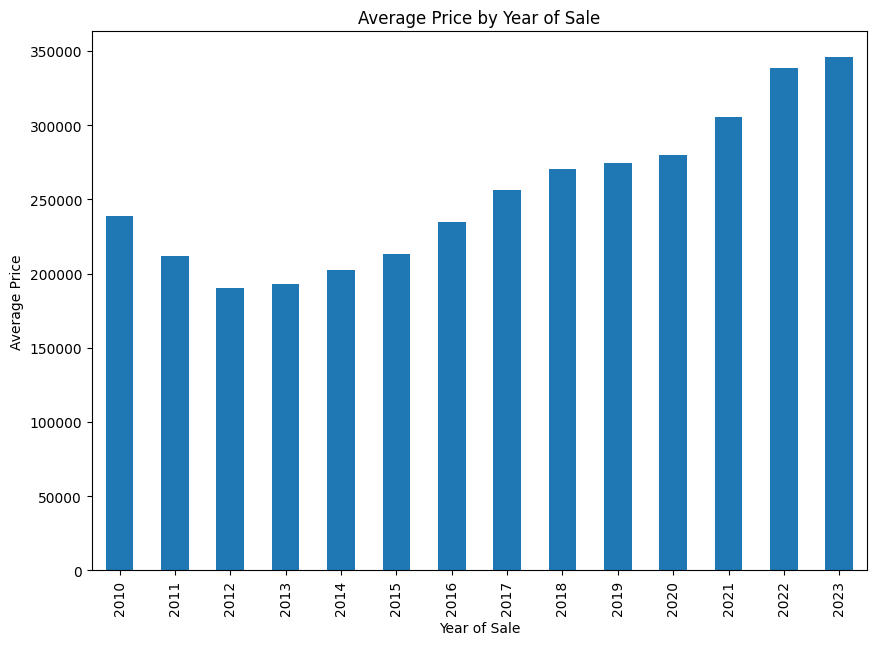

In [105]:
# plot the mean price of properties sold per year to look for a trend
plt.figure(figsize=(10,7))
df["Price"].groupby(df['YearofSale']).mean().plot(kind='bar')
plt.title("Average Price by Year of Sale")
plt.ylabel("Average Price")
plt.xlabel("Year of Sale")

- We can see that the average property price in Ireland has been increasing since 2012.   Next I would like to check the proportion of new houses to second-hand houses sold each year.

2010 	 20820
2011 	 18320
2012 	 25223
2013 	 29835
2014 	 43169
2015 	 48782
2016 	 49518
2017 	 54544
2018 	 56978
2019 	 58491
2020 	 48944
2021 	 58930
2022 	 61826
2023 	 16156


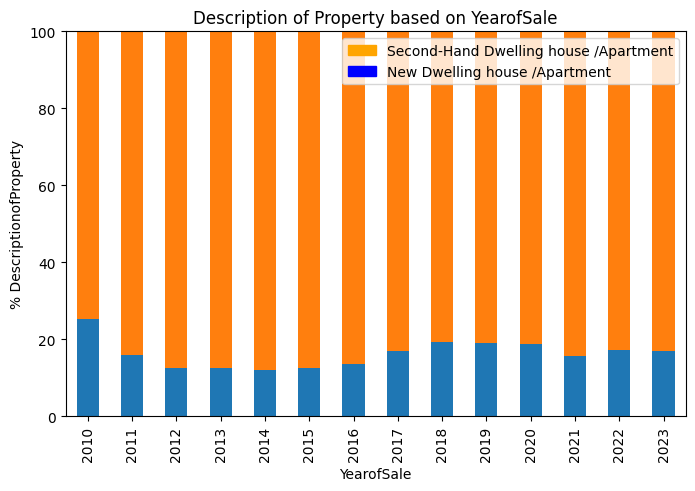

In [106]:
#check proportion of new vs old homes sold in Dublin each year
stacked_bar_chart("YearofSale")

- There does not seem to be much correlation between the rise of property prices and new houses sold. My thinking was that rising property prices might be a result from a lack of new houses. This does not appear to be the case. 

In [107]:
# saving cleaned dataframe to a csv
df.to_csv("PPR-ALL_cleaned_3newFeatures.csv")

In [3]:
# load cleaned data
df = pd.read_csv("PPR-ALL_cleaned_3newFeatures.csv", index_col=0)
df.shape

(591536, 11)

### Feature 4 
    
- The fourth feature I want to create is the geolocation of each address in Dublin. I think it is useful to only look at Dublin data since it is the county with the highest property prices and the county we have the most data on. We saw that South Dublin properties appear to have a higher average price and adding the geolocation of each address to the data allows for a more detailed view of how this price is affected by its location. For this I wll add 2 columns for latitude and longitude.

In [4]:
#import relevent packages
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter
from pprint import pprint
import requests
import json

#Creating an instance of Nominatim Class
geolocator = Nominatim(user_agent='my_request')
 
#applying the rate limiter wrapper
geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1)

#create two new columns for latitude and longitude
df['Lat'] = np.nan
df['Lon'] = np.nan

df.tail(5)

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription,PostalCode,MonthofSale,YearofSale,Lat,Lon
591531,2023-05-05,"MISTLETOE COTTAGE, GREENCLOYNE, YOUGHAL",Cork,300000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,5,2023,NaN,NaN
591532,2023-05-05,"PARK RD, SWINFORD, MAYO",Mayo,190000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,5,2023,NaN,NaN
591533,2023-05-05,"SPRING COTTAGE, SHALLON, THE WARD",Dublin,740000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,5,2023,NaN,NaN
591534,2023-05-05,"THE ORCHARD, GARRYHILL, CARLOW",Carlow,375000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,5,2023,NaN,NaN
591535,2023-05-05,"TULLYCROSS MOYDRUM, ATHLONE, WESTMEATH",Westmeath,381000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,5,2023,NaN,NaN


In [5]:
#iterate through each row, find geolocation of address if the county is Dublin
for row in range(0, len(df)):
    if df['County'][row] == 'Dublin':
        if pd.isnull(df.at[row,'Lat']):
            addr = df.at[row, 'Address']
            try:
                location = geolocator.geocode(addr).raw
                df.at[row, 'Lat'] = location.get('lat')
                df.at[row, 'Lon'] = location.get('lon')
                print('Row No. ' + str(row) + ' success')
                df.to_csv("PPR-ALL_cleaned_section4.csv")
            except:
                df.at[row, 'Lat'] = 'other'
                df.at[row, 'Lon'] = 'other'
                print('Row No. ' + str(row) + ' failed')
    else:
        df.at[row, 'Lat'] = 'other'
        df.at[row, 'Lon'] = 'other'

    
        
df.tail(5)
#check rows with county as Dublin
# df[df['County'] == 'Dublin']

Row No. 0 success
Row No. 2 success
Row No. 5 failed
Row No. 11 success
Row No. 12 success
Row No. 13 success
Row No. 16 success
Row No. 17 failed
Row No. 19 success
Row No. 21 failed
Row No. 22 success
Row No. 23 success
Row No. 27 success
Row No. 42 failed
Row No. 47 failed
Row No. 50 failed
Row No. 56 failed
Row No. 58 success
Row No. 61 failed
Row No. 63 failed
Row No. 65 failed
Row No. 66 failed
Row No. 67 success
Row No. 76 success
Row No. 79 success
Row No. 84 success
Row No. 87 failed
Row No. 95 success
Row No. 97 failed
Row No. 115 success
Row No. 117 success
Row No. 120 failed
Row No. 122 success
Row No. 124 failed
Row No. 128 success
Row No. 133 failed
Row No. 134 success
Row No. 140 success
Row No. 141 failed
Row No. 142 success
Row No. 143 failed
Row No. 149 failed
Row No. 152 success
Row No. 153 success
Row No. 155 success
Row No. 157 failed
Row No. 158 success
Row No. 160 failed
Row No. 162 failed
Row No. 166 failed
Row No. 167 failed
Row No. 169 failed
Row No. 172 succe

Row No. 1194 failed
Row No. 1197 failed
Row No. 1199 success
Row No. 1201 success
Row No. 1205 success
Row No. 1207 failed
Row No. 1213 success
Row No. 1216 failed
Row No. 1232 success
Row No. 1234 success
Row No. 1235 success
Row No. 1237 success
Row No. 1238 success
Row No. 1239 success
Row No. 1240 failed
Row No. 1241 failed
Row No. 1244 success
Row No. 1250 success
Row No. 1251 failed
Row No. 1252 failed
Row No. 1253 success
Row No. 1255 success
Row No. 1257 success
Row No. 1260 success
Row No. 1262 failed
Row No. 1264 success
Row No. 1265 failed
Row No. 1269 failed
Row No. 1273 failed
Row No. 1276 success
Row No. 1277 failed
Row No. 1278 success
Row No. 1284 failed
Row No. 1287 failed
Row No. 1288 failed
Row No. 1289 success
Row No. 1290 failed
Row No. 1291 failed
Row No. 1292 failed
Row No. 1293 success
Row No. 1294 success
Row No. 1296 failed
Row No. 1298 failed
Row No. 1299 success
Row No. 1300 success
Row No. 1301 success
Row No. 1302 failed
Row No. 1304 success
Row No. 1306 s

Row No. 2397 failed
Row No. 2399 failed
Row No. 2400 failed
Row No. 2401 success
Row No. 2406 success
Row No. 2408 failed
Row No. 2411 failed
Row No. 2412 failed
Row No. 2413 success
Row No. 2415 success
Row No. 2418 failed
Row No. 2419 failed
Row No. 2422 failed
Row No. 2423 success
Row No. 2424 success
Row No. 2425 success
Row No. 2430 failed
Row No. 2434 success
Row No. 2436 failed
Row No. 2442 success
Row No. 2444 success
Row No. 2446 success
Row No. 2449 success
Row No. 2452 failed
Row No. 2455 success
Row No. 2456 failed
Row No. 2458 success
Row No. 2459 success
Row No. 2462 success
Row No. 2465 success
Row No. 2466 failed
Row No. 2469 failed
Row No. 2470 success
Row No. 2471 failed
Row No. 2472 failed
Row No. 2474 success
Row No. 2476 success
Row No. 2477 success
Row No. 2480 failed
Row No. 2481 failed
Row No. 2485 success
Row No. 2486 success
Row No. 2491 failed
Row No. 2493 success
Row No. 2494 failed
Row No. 2495 failed
Row No. 2496 failed
Row No. 2497 failed
Row No. 2498 fai

Row No. 3553 failed
Row No. 3554 failed
Row No. 3555 success
Row No. 3558 failed
Row No. 3559 failed
Row No. 3565 failed
Row No. 3567 failed
Row No. 3571 success
Row No. 3572 success
Row No. 3574 success
Row No. 3576 failed
Row No. 3579 failed
Row No. 3582 success
Row No. 3584 failed
Row No. 3585 failed
Row No. 3586 failed
Row No. 3588 failed
Row No. 3589 failed
Row No. 3599 failed
Row No. 3610 success
Row No. 3612 success
Row No. 3613 success
Row No. 3616 failed
Row No. 3618 failed
Row No. 3620 success
Row No. 3623 failed
Row No. 3624 success
Row No. 3625 failed
Row No. 3626 success
Row No. 3627 failed
Row No. 3629 success
Row No. 3632 failed
Row No. 3633 failed
Row No. 3634 success
Row No. 3643 failed
Row No. 3644 failed
Row No. 3653 failed
Row No. 3663 success
Row No. 3665 failed
Row No. 3667 failed
Row No. 3672 success
Row No. 3675 failed
Row No. 3676 failed
Row No. 3685 failed
Row No. 3688 success
Row No. 3689 success
Row No. 3694 failed
Row No. 3695 failed
Row No. 3701 success
Ro

Row No. 4785 success
Row No. 4788 failed
Row No. 4789 success
Row No. 4792 failed
Row No. 4794 failed
Row No. 4796 failed
Row No. 4797 success
Row No. 4799 failed
Row No. 4803 success
Row No. 4806 success
Row No. 4809 success
Row No. 4810 success
Row No. 4811 failed
Row No. 4816 success
Row No. 4819 success
Row No. 4820 failed
Row No. 4822 failed
Row No. 4823 failed
Row No. 4824 failed
Row No. 4826 failed
Row No. 4828 failed
Row No. 4830 failed
Row No. 4832 failed
Row No. 4850 failed
Row No. 4851 failed
Row No. 4854 failed
Row No. 4861 success
Row No. 4862 failed
Row No. 4865 success
Row No. 4867 success
Row No. 4871 success
Row No. 4875 failed
Row No. 4877 success
Row No. 4879 failed
Row No. 4881 success
Row No. 4882 failed
Row No. 4886 failed
Row No. 4887 success
Row No. 4892 failed
Row No. 4893 success
Row No. 4896 success
Row No. 4897 failed
Row No. 4904 failed
Row No. 4906 failed
Row No. 4908 failed
Row No. 4909 success
Row No. 4912 failed
Row No. 4914 failed
Row No. 4915 failed
R

Row No. 5936 failed
Row No. 5937 failed
Row No. 5938 failed
Row No. 5954 success
Row No. 5959 success
Row No. 5960 success
Row No. 5961 success
Row No. 5962 failed
Row No. 5964 success
Row No. 5965 success
Row No. 5967 success
Row No. 5968 failed
Row No. 5971 success
Row No. 5972 success
Row No. 5973 failed
Row No. 5976 failed
Row No. 5981 failed
Row No. 5982 success
Row No. 5984 success
Row No. 5988 failed
Row No. 5989 success
Row No. 5990 success
Row No. 5991 success
Row No. 5992 failed
Row No. 5997 success
Row No. 5998 success
Row No. 6003 failed
Row No. 6004 success
Row No. 6005 success
Row No. 6006 failed
Row No. 6007 failed
Row No. 6019 failed
Row No. 6022 failed
Row No. 6024 failed
Row No. 6032 failed
Row No. 6037 success
Row No. 6039 success
Row No. 6044 success
Row No. 6045 success
Row No. 6046 failed
Row No. 6047 success
Row No. 6048 failed
Row No. 6049 failed
Row No. 6055 failed
Row No. 6056 success
Row No. 6057 success
Row No. 6066 failed
Row No. 6072 failed
Row No. 6075 su

Row No. 7147 failed
Row No. 7150 success
Row No. 7151 failed
Row No. 7152 failed
Row No. 7153 success
Row No. 7154 failed
Row No. 7155 success
Row No. 7157 failed
Row No. 7158 failed
Row No. 7160 success
Row No. 7161 failed
Row No. 7162 failed
Row No. 7164 failed
Row No. 7166 failed
Row No. 7168 failed
Row No. 7171 success
Row No. 7174 failed
Row No. 7176 failed
Row No. 7177 success
Row No. 7178 success
Row No. 7179 failed
Row No. 7181 success
Row No. 7182 success
Row No. 7187 success
Row No. 7189 failed
Row No. 7191 success
Row No. 7198 failed
Row No. 7199 failed
Row No. 7200 failed
Row No. 7202 success
Row No. 7204 success
Row No. 7211 failed
Row No. 7212 failed
Row No. 7213 failed
Row No. 7215 failed
Row No. 7239 failed
Row No. 7240 failed
Row No. 7241 failed
Row No. 7248 failed
Row No. 7249 failed
Row No. 7251 success
Row No. 7253 success
Row No. 7255 failed
Row No. 7258 failed
Row No. 7264 failed
Row No. 7270 failed
Row No. 7273 success
Row No. 7274 failed
Row No. 7275 failed
Row 

Row No. 8254 failed
Row No. 8256 failed
Row No. 8257 success
Row No. 8259 success
Row No. 8261 success
Row No. 8262 success
Row No. 8263 failed
Row No. 8265 failed
Row No. 8266 failed
Row No. 8267 failed
Row No. 8269 failed
Row No. 8285 success
Row No. 8286 success
Row No. 8287 success
Row No. 8288 success
Row No. 8290 success
Row No. 8295 success
Row No. 8298 failed
Row No. 8299 failed
Row No. 8300 failed
Row No. 8302 failed
Row No. 8303 success
Row No. 8304 failed
Row No. 8306 failed
Row No. 8309 failed
Row No. 8310 success
Row No. 8312 failed
Row No. 8313 failed
Row No. 8315 failed
Row No. 8316 failed
Row No. 8317 success
Row No. 8319 success
Row No. 8321 failed
Row No. 8322 failed
Row No. 8325 success
Row No. 8329 success
Row No. 8330 success
Row No. 8336 success
Row No. 8338 failed
Row No. 8340 failed
Row No. 8341 success
Row No. 8343 success
Row No. 8345 failed
Row No. 8346 failed
Row No. 8347 failed
Row No. 8348 failed
Row No. 8349 failed
Row No. 8350 failed
Row No. 8351 failed


Row No. 9353 success
Row No. 9354 success
Row No. 9358 failed
Row No. 9361 success
Row No. 9364 success
Row No. 9367 success
Row No. 9370 success
Row No. 9375 failed
Row No. 9376 failed
Row No. 9395 failed
Row No. 9402 failed
Row No. 9407 failed
Row No. 9408 success
Row No. 9411 success
Row No. 9412 failed
Row No. 9413 failed
Row No. 9414 success
Row No. 9418 failed
Row No. 9420 success
Row No. 9421 failed
Row No. 9423 failed
Row No. 9424 failed
Row No. 9428 success
Row No. 9429 success
Row No. 9432 failed
Row No. 9433 failed
Row No. 9434 success
Row No. 9435 success
Row No. 9437 success
Row No. 9438 success
Row No. 9442 failed
Row No. 9445 failed
Row No. 9448 success
Row No. 9450 failed
Row No. 9451 failed
Row No. 9452 success
Row No. 9453 failed
Row No. 9456 failed
Row No. 9458 success
Row No. 9466 success
Row No. 9470 success
Row No. 9472 failed
Row No. 9475 failed
Row No. 9477 success
Row No. 9479 failed
Row No. 9481 failed
Row No. 9482 success
Row No. 9485 success
Row No. 9486 fai

Row No. 10515 success
Row No. 10521 failed
Row No. 10522 failed
Row No. 10523 success
Row No. 10524 failed
Row No. 10525 failed
Row No. 10529 success
Row No. 10531 failed
Row No. 10534 failed
Row No. 10535 failed
Row No. 10542 failed
Row No. 10545 success
Row No. 10546 success
Row No. 10548 failed
Row No. 10571 failed
Row No. 10572 success
Row No. 10579 failed
Row No. 10581 success
Row No. 10583 success
Row No. 10585 failed
Row No. 10588 failed
Row No. 10594 failed
Row No. 10597 success
Row No. 10599 failed
Row No. 10600 failed
Row No. 10605 success
Row No. 10609 failed
Row No. 10613 failed
Row No. 10615 failed
Row No. 10616 failed
Row No. 10622 success
Row No. 10623 success
Row No. 10630 failed
Row No. 10631 failed
Row No. 10632 failed
Row No. 10651 failed
Row No. 10675 failed
Row No. 10676 failed
Row No. 10677 failed
Row No. 10679 failed
Row No. 10680 failed
Row No. 10683 failed
Row No. 10688 success
Row No. 10690 failed
Row No. 10692 success
Row No. 10695 failed
Row No. 10701 failed

Row No. 11701 failed
Row No. 11703 success
Row No. 11704 success
Row No. 11705 success
Row No. 11707 failed
Row No. 11708 success
Row No. 11709 success
Row No. 11712 success
Row No. 11713 success
Row No. 11714 failed
Row No. 11716 failed
Row No. 11718 success
Row No. 11721 failed
Row No. 11722 success
Row No. 11723 failed
Row No. 11724 success
Row No. 11725 success
Row No. 11726 failed
Row No. 11727 success
Row No. 11728 success
Row No. 11729 success
Row No. 11732 failed
Row No. 11734 failed
Row No. 11735 success
Row No. 11736 failed
Row No. 11737 success
Row No. 11738 failed
Row No. 11740 success
Row No. 11742 failed
Row No. 11743 success
Row No. 11745 failed
Row No. 11747 failed
Row No. 11749 failed
Row No. 11764 success
Row No. 11774 failed
Row No. 11776 success
Row No. 11778 failed
Row No. 11779 failed
Row No. 11781 failed
Row No. 11783 success
Row No. 11784 failed
Row No. 11794 failed
Row No. 11798 success
Row No. 11799 success
Row No. 11801 success
Row No. 11805 failed
Row No. 11

Row No. 12826 failed
Row No. 12837 failed
Row No. 12866 success
Row No. 12867 failed
Row No. 12870 success
Row No. 12871 failed
Row No. 12878 success
Row No. 12881 success
Row No. 12883 success
Row No. 12891 success
Row No. 12895 success
Row No. 12897 failed
Row No. 12898 success
Row No. 12901 success
Row No. 12902 success
Row No. 12903 failed
Row No. 12904 failed
Row No. 12906 failed
Row No. 12909 success
Row No. 12912 failed
Row No. 12913 failed
Row No. 12937 failed
Row No. 12939 failed
Row No. 12942 failed
Row No. 12944 failed
Row No. 12946 failed
Row No. 12947 success
Row No. 12949 success
Row No. 12952 success
Row No. 12954 success
Row No. 12955 failed
Row No. 12958 success
Row No. 12961 failed
Row No. 12963 failed
Row No. 12964 success
Row No. 12967 failed
Row No. 12969 success
Row No. 12970 success
Row No. 12973 success
Row No. 12974 failed
Row No. 12980 success
Row No. 12982 success
Row No. 12989 success
Row No. 12990 failed
Row No. 12991 success
Row No. 12994 success
Row No. 1

Row No. 13966 success
Row No. 13968 failed
Row No. 13969 failed
Row No. 13970 success
Row No. 13975 success
Row No. 13977 failed
Row No. 13980 failed
Row No. 13982 failed
Row No. 13983 success
Row No. 13984 success
Row No. 13986 success
Row No. 13987 success
Row No. 13990 success
Row No. 13992 failed
Row No. 13993 success
Row No. 13995 success
Row No. 13996 success
Row No. 13998 success
Row No. 14000 success
Row No. 14002 failed
Row No. 14003 failed
Row No. 14004 failed
Row No. 14005 failed
Row No. 14006 failed
Row No. 14007 failed
Row No. 14008 failed
Row No. 14057 failed
Row No. 14059 success
Row No. 14060 success
Row No. 14062 failed
Row No. 14063 failed
Row No. 14064 failed
Row No. 14066 failed
Row No. 14067 success
Row No. 14068 success
Row No. 14071 success
Row No. 14076 failed
Row No. 14078 success
Row No. 14079 failed
Row No. 14080 failed
Row No. 14081 success
Row No. 14082 failed
Row No. 14083 failed
Row No. 14084 failed
Row No. 14085 success
Row No. 14086 failed
Row No. 14087

Row No. 15060 success
Row No. 15061 failed
Row No. 15062 failed
Row No. 15066 success
Row No. 15068 failed
Row No. 15071 failed
Row No. 15072 success
Row No. 15075 failed
Row No. 15077 success
Row No. 15079 success
Row No. 15080 success
Row No. 15082 success
Row No. 15085 success
Row No. 15087 failed
Row No. 15088 failed
Row No. 15093 failed
Row No. 15102 failed
Row No. 15115 failed
Row No. 15117 success
Row No. 15118 success
Row No. 15121 success
Row No. 15124 failed
Row No. 15127 success
Row No. 15129 failed
Row No. 15132 success
Row No. 15135 success
Row No. 15137 success
Row No. 15138 failed
Row No. 15141 success
Row No. 15142 failed
Row No. 15145 success
Row No. 15146 failed
Row No. 15147 success
Row No. 15149 success
Row No. 15155 failed
Row No. 15157 success
Row No. 15160 success
Row No. 15161 success
Row No. 15162 failed
Row No. 15170 failed
Row No. 15174 success
Row No. 15176 failed
Row No. 15178 failed
Row No. 15179 success
Row No. 15180 success
Row No. 15184 success
Row No. 

Row No. 16146 failed
Row No. 16147 failed
Row No. 16150 failed
Row No. 16183 failed
Row No. 16195 failed
Row No. 16198 success
Row No. 16200 success
Row No. 16201 success
Row No. 16202 failed
Row No. 16203 failed
Row No. 16206 success
Row No. 16213 failed
Row No. 16218 failed
Row No. 16219 success
Row No. 16220 success
Row No. 16221 failed
Row No. 16222 failed
Row No. 16223 success
Row No. 16224 failed
Row No. 16227 failed
Row No. 16229 failed
Row No. 16232 success
Row No. 16233 failed
Row No. 16237 success
Row No. 16244 success
Row No. 16245 success
Row No. 16246 success
Row No. 16247 failed
Row No. 16256 failed
Row No. 16257 failed
Row No. 16270 failed
Row No. 16280 failed
Row No. 16282 failed
Row No. 16284 failed
Row No. 16286 failed
Row No. 16287 success
Row No. 16293 failed
Row No. 16298 failed
Row No. 16300 success
Row No. 16302 success
Row No. 16306 failed
Row No. 16307 success
Row No. 16313 failed
Row No. 16315 success
Row No. 16320 failed
Row No. 16326 failed
Row No. 16344 fai

Row No. 17449 failed
Row No. 17450 failed
Row No. 17451 failed
Row No. 17454 success
Row No. 17455 failed
Row No. 17456 failed
Row No. 17457 failed
Row No. 17458 success
Row No. 17461 failed
Row No. 17463 success
Row No. 17465 failed
Row No. 17467 success
Row No. 17468 failed
Row No. 17474 success
Row No. 17475 failed
Row No. 17477 success
Row No. 17478 failed
Row No. 17486 failed
Row No. 17488 success
Row No. 17490 failed
Row No. 17505 failed
Row No. 17513 failed
Row No. 17514 success
Row No. 17516 success
Row No. 17518 failed
Row No. 17519 success
Row No. 17520 failed
Row No. 17535 failed
Row No. 17536 success
Row No. 17540 failed
Row No. 17549 failed
Row No. 17557 failed
Row No. 17560 success
Row No. 17563 failed
Row No. 17566 failed
Row No. 17567 success
Row No. 17573 success
Row No. 17576 success
Row No. 17577 failed
Row No. 17578 success
Row No. 17582 failed
Row No. 17583 failed
Row No. 17591 success
Row No. 17592 failed
Row No. 17597 failed
Row No. 17598 failed
Row No. 17599 fai

Row No. 18826 success
Row No. 18837 failed
Row No. 18838 success
Row No. 18839 failed
Row No. 18841 success
Row No. 18842 failed
Row No. 18845 success
Row No. 18846 failed
Row No. 18852 failed
Row No. 18858 failed
Row No. 18862 failed
Row No. 18864 failed
Row No. 18865 failed
Row No. 18870 success
Row No. 18881 failed
Row No. 18918 success
Row No. 18924 failed
Row No. 18926 success
Row No. 18928 success
Row No. 18930 failed
Row No. 18931 success
Row No. 18933 success
Row No. 18934 failed
Row No. 18935 failed
Row No. 18936 failed
Row No. 18938 failed
Row No. 18939 success
Row No. 18940 failed
Row No. 18945 success
Row No. 18946 success
Row No. 18948 failed
Row No. 18949 success
Row No. 18954 success
Row No. 18986 success
Row No. 18988 failed
Row No. 18990 failed
Row No. 18998 success
Row No. 19001 failed
Row No. 19002 success
Row No. 19003 failed
Row No. 19010 success
Row No. 19014 success
Row No. 19015 success
Row No. 19025 failed
Row No. 19027 success
Row No. 19028 failed
Row No. 1903

Row No. 20132 success
Row No. 20133 failed
Row No. 20135 failed
Row No. 20138 failed
Row No. 20139 failed
Row No. 20141 success
Row No. 20142 failed
Row No. 20143 failed
Row No. 20151 failed
Row No. 20153 failed
Row No. 20176 failed
Row No. 20184 failed
Row No. 20200 success
Row No. 20202 failed
Row No. 20205 failed
Row No. 20211 failed
Row No. 20213 success
Row No. 20214 success
Row No. 20216 failed
Row No. 20218 failed
Row No. 20220 success
Row No. 20226 success
Row No. 20227 success
Row No. 20233 failed
Row No. 20235 failed
Row No. 20236 failed
Row No. 20240 success
Row No. 20244 failed
Row No. 20248 success
Row No. 20249 success
Row No. 20250 success
Row No. 20251 success
Row No. 20253 failed
Row No. 20254 failed
Row No. 20255 failed
Row No. 20258 success
Row No. 20259 failed
Row No. 20260 failed
Row No. 20262 success
Row No. 20263 success
Row No. 20264 failed
Row No. 20265 failed
Row No. 20266 failed
Row No. 20267 success
Row No. 20268 success
Row No. 20271 failed
Row No. 20272 fa

Row No. 21415 success
Row No. 21416 success
Row No. 21419 success
Row No. 21421 failed
Row No. 21424 success
Row No. 21425 failed
Row No. 21426 success
Row No. 21427 success
Row No. 21428 success
Row No. 21430 success
Row No. 21431 failed
Row No. 21433 success
Row No. 21436 success
Row No. 21437 failed
Row No. 21444 success
Row No. 21449 failed
Row No. 21455 failed
Row No. 21456 failed
Row No. 21459 failed
Row No. 21479 failed
Row No. 21480 success
Row No. 21481 success
Row No. 21482 success
Row No. 21483 success
Row No. 21485 failed
Row No. 21486 failed
Row No. 21487 success
Row No. 21492 failed
Row No. 21495 success
Row No. 21502 failed
Row No. 21503 success
Row No. 21509 success
Row No. 21511 failed
Row No. 21530 failed
Row No. 21531 failed
Row No. 21532 failed
Row No. 21534 failed
Row No. 21535 failed
Row No. 21536 failed
Row No. 21537 failed
Row No. 21538 failed
Row No. 21540 success
Row No. 21543 failed
Row No. 21545 success
Row No. 21547 failed
Row No. 21551 success
Row No. 2155

Row No. 22640 failed
Row No. 22641 success
Row No. 22644 failed
Row No. 22647 success
Row No. 22653 failed
Row No. 22670 success
Row No. 22676 success
Row No. 22680 success
Row No. 22681 success
Row No. 22682 success
Row No. 22683 failed
Row No. 22684 failed
Row No. 22690 failed
Row No. 22694 success
Row No. 22696 failed
Row No. 22698 success
Row No. 22701 success
Row No. 22702 failed
Row No. 22704 failed
Row No. 22718 failed
Row No. 22722 failed
Row No. 22723 success
Row No. 22725 success
Row No. 22727 failed
Row No. 22731 failed
Row No. 22732 failed
Row No. 22733 failed
Row No. 22735 success
Row No. 22739 success
Row No. 22741 failed
Row No. 22747 success
Row No. 22748 success
Row No. 22750 success
Row No. 22764 failed
Row No. 22766 success
Row No. 22767 success
Row No. 22768 success
Row No. 22774 success
Row No. 22776 failed
Row No. 22777 success
Row No. 22779 failed
Row No. 22782 failed
Row No. 22785 success
Row No. 22786 failed
Row No. 22790 failed
Row No. 22791 failed
Row No. 227

Row No. 23879 failed
Row No. 23885 failed
Row No. 23887 success
Row No. 23888 failed
Row No. 23889 failed
Row No. 23913 failed
Row No. 23915 success
Row No. 23920 failed
Row No. 23929 failed
Row No. 23931 success
Row No. 23933 failed
Row No. 23938 failed
Row No. 23939 failed
Row No. 23940 failed
Row No. 23954 success
Row No. 23957 success
Row No. 23958 success
Row No. 23961 success
Row No. 23962 success
Row No. 23965 success
Row No. 23967 success
Row No. 23968 success
Row No. 23969 failed
Row No. 23970 success
Row No. 23971 failed
Row No. 23973 failed
Row No. 23976 success
Row No. 23978 failed
Row No. 23979 success
Row No. 23981 success
Row No. 23982 success
Row No. 23985 failed
Row No. 23987 failed
Row No. 23988 failed
Row No. 23990 success
Row No. 23992 failed
Row No. 23996 failed
Row No. 24001 success
Row No. 24005 success
Row No. 24007 success
Row No. 24012 failed
Row No. 24013 failed
Row No. 24014 failed
Row No. 24015 failed
Row No. 24032 failed
Row No. 24034 failed
Row No. 24054 

Row No. 25173 failed
Row No. 25179 failed
Row No. 25180 success
Row No. 25183 success
Row No. 25186 failed
Row No. 25192 failed
Row No. 25193 success
Row No. 25195 failed
Row No. 25196 failed
Row No. 25197 failed
Row No. 25200 failed
Row No. 25226 success
Row No. 25229 failed
Row No. 25235 failed
Row No. 25240 success
Row No. 25242 failed
Row No. 25249 success
Row No. 25260 success
Row No. 25264 failed
Row No. 25267 success
Row No. 25269 success
Row No. 25272 success
Row No. 25276 failed
Row No. 25277 failed
Row No. 25282 success
Row No. 25285 failed
Row No. 25287 failed
Row No. 25288 success
Row No. 25297 success
Row No. 25300 failed
Row No. 25301 success
Row No. 25302 success
Row No. 25303 success
Row No. 25308 success
Row No. 25309 success
Row No. 25311 failed
Row No. 25313 failed
Row No. 25315 failed
Row No. 25319 success
Row No. 25320 success
Row No. 25323 success
Row No. 25325 success
Row No. 25328 failed
Row No. 25329 success
Row No. 25330 failed
Row No. 25331 failed
Row No. 253

Row No. 26415 failed
Row No. 26419 success
Row No. 26425 failed
Row No. 26428 success
Row No. 26429 failed
Row No. 26430 success
Row No. 26432 failed
Row No. 26436 success
Row No. 26437 failed
Row No. 26439 failed
Row No. 26440 failed
Row No. 26441 failed
Row No. 26454 failed
Row No. 26457 failed
Row No. 26458 success
Row No. 26461 success
Row No. 26462 success
Row No. 26463 success
Row No. 26464 failed
Row No. 26465 success
Row No. 26469 success
Row No. 26470 failed
Row No. 26479 failed
Row No. 26480 failed
Row No. 26482 failed
Row No. 26484 failed
Row No. 26489 failed
Row No. 26491 failed
Row No. 26492 failed
Row No. 26516 failed
Row No. 26517 success
Row No. 26525 success
Row No. 26528 failed
Row No. 26530 success
Row No. 26533 failed
Row No. 26536 failed
Row No. 26537 success
Row No. 26538 failed
Row No. 26539 success
Row No. 26540 success
Row No. 26541 success
Row No. 26547 failed
Row No. 26548 success
Row No. 26550 failed
Row No. 26551 success
Row No. 26552 failed
Row No. 26555 f

Row No. 27601 failed
Row No. 27602 success
Row No. 27604 success
Row No. 27608 failed
Row No. 27610 success
Row No. 27611 success
Row No. 27612 success
Row No. 27613 success
Row No. 27619 failed
Row No. 27627 failed
Row No. 27628 failed
Row No. 27640 failed
Row No. 27646 success
Row No. 27647 failed
Row No. 27648 success
Row No. 27649 success
Row No. 27650 failed
Row No. 27651 success
Row No. 27652 failed
Row No. 27653 success
Row No. 27655 success
Row No. 27656 success
Row No. 27657 failed
Row No. 27658 success
Row No. 27659 failed
Row No. 27661 success
Row No. 27663 success
Row No. 27667 success
Row No. 27668 failed
Row No. 27671 success
Row No. 27674 success
Row No. 27675 success
Row No. 27677 failed
Row No. 27678 failed
Row No. 27679 success
Row No. 27680 success
Row No. 27682 success
Row No. 27683 success
Row No. 27684 failed
Row No. 27686 success
Row No. 27691 success
Row No. 27693 success
Row No. 27694 failed
Row No. 27695 success
Row No. 27698 success
Row No. 27700 failed
Row N

Row No. 28870 failed
Row No. 28871 success
Row No. 28874 failed
Row No. 28875 failed
Row No. 28876 failed
Row No. 28877 success
Row No. 28882 failed
Row No. 28895 failed
Row No. 28910 success
Row No. 28913 success
Row No. 28917 success
Row No. 28919 failed
Row No. 28922 failed
Row No. 28929 failed
Row No. 28936 failed
Row No. 28937 failed
Row No. 28938 failed
Row No. 28939 success
Row No. 28940 failed
Row No. 28942 failed
Row No. 28945 success
Row No. 28946 success
Row No. 28954 failed
Row No. 28955 failed
Row No. 28958 failed
Row No. 28960 success
Row No. 28961 failed
Row No. 28962 failed
Row No. 28977 failed
Row No. 28979 failed
Row No. 28984 success
Row No. 28985 failed
Row No. 28987 failed
Row No. 28988 success
Row No. 28995 success
Row No. 28996 failed
Row No. 28999 failed
Row No. 29000 failed
Row No. 29001 success
Row No. 29003 success
Row No. 29004 success
Row No. 29005 success
Row No. 29008 failed
Row No. 29010 success
Row No. 29020 failed
Row No. 29024 failed
Row No. 29032 fai

Row No. 30077 success
Row No. 30079 success
Row No. 30082 failed
Row No. 30087 success
Row No. 30088 failed
Row No. 30089 success
Row No. 30091 failed
Row No. 30098 success
Row No. 30104 success
Row No. 30105 failed
Row No. 30106 failed
Row No. 30107 success
Row No. 30109 failed
Row No. 30123 success
Row No. 30124 success
Row No. 30126 success
Row No. 30127 failed
Row No. 30129 success
Row No. 30130 failed
Row No. 30131 failed
Row No. 30132 failed
Row No. 30133 success
Row No. 30135 failed
Row No. 30138 success
Row No. 30139 failed
Row No. 30140 success
Row No. 30142 failed
Row No. 30143 failed
Row No. 30147 success
Row No. 30148 failed
Row No. 30150 success
Row No. 30160 success
Row No. 30161 failed
Row No. 30163 success
Row No. 30165 failed
Row No. 30187 success
Row No. 30188 failed
Row No. 30191 success
Row No. 30192 success
Row No. 30195 failed
Row No. 30197 failed
Row No. 30198 success
Row No. 30199 failed
Row No. 30202 success
Row No. 30204 success
Row No. 30205 success
Row No. 3

Row No. 31159 failed
Row No. 31161 success
Row No. 31166 failed
Row No. 31167 failed
Row No. 31169 failed
Row No. 31170 success
Row No. 31173 failed
Row No. 31193 success
Row No. 31194 failed
Row No. 31195 failed
Row No. 31196 success
Row No. 31197 success
Row No. 31198 success
Row No. 31200 failed
Row No. 31201 success
Row No. 31209 success
Row No. 31210 success
Row No. 31214 success
Row No. 31216 failed
Row No. 31221 failed
Row No. 31223 failed
Row No. 31224 success
Row No. 31225 failed
Row No. 31227 failed
Row No. 31229 failed
Row No. 31230 failed
Row No. 31235 failed
Row No. 31239 success
Row No. 31240 failed
Row No. 31264 success
Row No. 31266 failed
Row No. 31267 success
Row No. 31268 success
Row No. 31270 success
Row No. 31271 failed
Row No. 31273 failed
Row No. 31277 success
Row No. 31280 success
Row No. 31281 success
Row No. 31282 success
Row No. 31284 success
Row No. 31287 success
Row No. 31288 success
Row No. 31291 failed
Row No. 31293 failed
Row No. 31294 failed
Row No. 312

Row No. 32292 failed
Row No. 32293 failed
Row No. 32294 failed
Row No. 32295 failed
Row No. 32296 failed
Row No. 32298 failed
Row No. 32299 failed
Row No. 32301 failed
Row No. 32302 failed
Row No. 32303 failed
Row No. 32307 success
Row No. 32308 failed
Row No. 32309 failed
Row No. 32311 failed
Row No. 32319 success
Row No. 32320 success
Row No. 32321 success
Row No. 32328 failed
Row No. 32331 success
Row No. 32334 success
Row No. 32336 failed
Row No. 32339 failed
Row No. 32340 failed
Row No. 32341 failed
Row No. 32342 failed
Row No. 32343 success
Row No. 32345 failed
Row No. 32346 success
Row No. 32347 success
Row No. 32356 success
Row No. 32358 success
Row No. 32359 success
Row No. 32365 success
Row No. 32373 success
Row No. 32376 success
Row No. 32379 failed
Row No. 32380 failed
Row No. 32398 failed
Row No. 32399 failed
Row No. 32402 failed
Row No. 32403 failed
Row No. 32405 success
Row No. 32406 success
Row No. 32409 success
Row No. 32412 failed
Row No. 32414 failed
Row No. 32415 su

Row No. 33407 failed
Row No. 33429 failed
Row No. 33433 success
Row No. 33434 failed
Row No. 33436 success
Row No. 33437 failed
Row No. 33438 failed
Row No. 33440 success
Row No. 33444 failed
Row No. 33446 failed
Row No. 33447 failed
Row No. 33449 success
Row No. 33451 success
Row No. 33459 success
Row No. 33461 failed
Row No. 33462 success
Row No. 33467 failed
Row No. 33471 success
Row No. 33485 failed
Row No. 33492 failed
Row No. 33493 failed
Row No. 33496 failed
Row No. 33497 failed
Row No. 33499 failed
Row No. 33503 success
Row No. 33506 success
Row No. 33509 failed
Row No. 33513 success
Row No. 33515 failed
Row No. 33517 failed
Row No. 33521 success
Row No. 33524 success
Row No. 33525 failed
Row No. 33526 failed
Row No. 33527 failed
Row No. 33540 success
Row No. 33542 success
Row No. 33546 failed
Row No. 33548 failed
Row No. 33549 failed
Row No. 33552 success
Row No. 33554 failed
Row No. 33557 failed
Row No. 33558 failed
Row No. 33561 failed
Row No. 33562 success
Row No. 33563 fai

Row No. 34605 success
Row No. 34606 success
Row No. 34607 failed
Row No. 34610 success
Row No. 34614 success
Row No. 34615 success
Row No. 34616 failed
Row No. 34617 failed
Row No. 34619 success
Row No. 34625 failed
Row No. 34628 failed
Row No. 34636 success
Row No. 34638 success
Row No. 34639 success
Row No. 34640 failed
Row No. 34643 success
Row No. 34644 failed
Row No. 34659 success
Row No. 34660 success
Row No. 34662 failed
Row No. 34663 success
Row No. 34664 failed
Row No. 34667 failed
Row No. 34671 success
Row No. 34673 success
Row No. 34676 failed
Row No. 34679 failed
Row No. 34684 failed
Row No. 34688 success
Row No. 34689 success
Row No. 34690 success
Row No. 34692 failed
Row No. 34695 failed
Row No. 34696 success
Row No. 34697 success
Row No. 34700 success
Row No. 34702 success
Row No. 34706 failed
Row No. 34712 failed
Row No. 34715 success
Row No. 34717 failed
Row No. 34719 failed
Row No. 34733 failed
Row No. 34737 failed
Row No. 34741 failed
Row No. 34743 failed
Row No. 347

Row No. 35747 success
Row No. 35755 success
Row No. 35756 success
Row No. 35759 failed
Row No. 35764 failed
Row No. 35766 failed
Row No. 35767 failed
Row No. 35789 success
Row No. 35793 success
Row No. 35794 success
Row No. 35795 failed
Row No. 35796 failed
Row No. 35797 failed
Row No. 35801 failed
Row No. 35803 failed
Row No. 35805 success
Row No. 35807 success
Row No. 35809 failed
Row No. 35811 success
Row No. 35812 failed
Row No. 35814 failed
Row No. 35819 success
Row No. 35822 success
Row No. 35823 success
Row No. 35824 failed
Row No. 35825 success
Row No. 35827 success
Row No. 35828 failed
Row No. 35829 failed
Row No. 35830 failed
Row No. 35831 failed
Row No. 35844 failed
Row No. 35849 success
Row No. 35853 success
Row No. 35854 success
Row No. 35855 success
Row No. 35863 failed
Row No. 35869 failed
Row No. 35871 failed
Row No. 35874 success
Row No. 35879 success
Row No. 35899 failed
Row No. 35903 failed
Row No. 35912 failed
Row No. 35914 failed
Row No. 35917 failed
Row No. 35919 

Row No. 37010 success
Row No. 37011 failed
Row No. 37014 success
Row No. 37016 failed
Row No. 37021 success
Row No. 37022 success
Row No. 37025 failed
Row No. 37026 success
Row No. 37027 failed
Row No. 37029 success
Row No. 37032 failed
Row No. 37034 failed
Row No. 37040 failed
Row No. 37041 success
Row No. 37043 success
Row No. 37044 success
Row No. 37049 success
Row No. 37054 failed
Row No. 37055 success
Row No. 37057 success
Row No. 37059 success
Row No. 37060 success
Row No. 37061 success
Row No. 37062 success
Row No. 37066 success
Row No. 37069 failed
Row No. 37071 success
Row No. 37072 failed
Row No. 37078 failed
Row No. 37080 failed
Row No. 37083 failed
Row No. 37085 failed
Row No. 37086 failed
Row No. 37087 success
Row No. 37090 success
Row No. 37091 failed
Row No. 37093 success
Row No. 37094 success
Row No. 37095 success
Row No. 37098 failed
Row No. 37099 failed
Row No. 37100 success
Row No. 37103 failed
Row No. 37104 failed
Row No. 37105 failed
Row No. 37106 failed
Row No. 37

Row No. 38129 failed
Row No. 38130 failed
Row No. 38131 success
Row No. 38132 failed
Row No. 38133 failed
Row No. 38136 success
Row No. 38139 success
Row No. 38140 success
Row No. 38141 success
Row No. 38142 success
Row No. 38143 success
Row No. 38145 success
Row No. 38146 success
Row No. 38147 success
Row No. 38148 success
Row No. 38149 success
Row No. 38154 success
Row No. 38155 failed
Row No. 38156 failed
Row No. 38158 failed
Row No. 38161 failed
Row No. 38163 failed
Row No. 38165 success
Row No. 38167 success
Row No. 38168 success
Row No. 38170 failed
Row No. 38172 failed
Row No. 38175 failed
Row No. 38181 failed
Row No. 38191 failed
Row No. 38196 failed
Row No. 38222 failed
Row No. 38228 success
Row No. 38229 success
Row No. 38230 failed
Row No. 38233 failed
Row No. 38234 success
Row No. 38237 success
Row No. 38239 success
Row No. 38244 failed
Row No. 38247 success
Row No. 38248 failed
Row No. 38249 failed
Row No. 38252 failed
Row No. 38253 failed
Row No. 38256 failed
Row No. 3825

Row No. 39330 success
Row No. 39336 failed
Row No. 39337 success
Row No. 39338 success
Row No. 39341 success
Row No. 39342 success
Row No. 39343 success
Row No. 39344 failed
Row No. 39345 success
Row No. 39348 failed
Row No. 39349 success
Row No. 39350 failed
Row No. 39351 failed
Row No. 39366 failed
Row No. 39368 success
Row No. 39369 success
Row No. 39372 failed
Row No. 39375 success
Row No. 39376 success
Row No. 39377 failed
Row No. 39378 success
Row No. 39379 success
Row No. 39384 success
Row No. 39386 failed
Row No. 39391 success
Row No. 39393 success
Row No. 39395 failed
Row No. 39397 success
Row No. 39398 success
Row No. 39403 success
Row No. 39404 failed
Row No. 39409 failed
Row No. 39416 failed
Row No. 39425 failed
Row No. 39426 failed
Row No. 39429 success
Row No. 39430 success
Row No. 39431 success
Row No. 39432 success
Row No. 39434 success
Row No. 39438 failed
Row No. 39440 failed
Row No. 39447 success
Row No. 39448 success
Row No. 39449 success
Row No. 39470 failed
Row No

Row No. 40386 failed
Row No. 40389 success
Row No. 40390 success
Row No. 40391 failed
Row No. 40393 failed
Row No. 40402 success
Row No. 40403 failed
Row No. 40404 success
Row No. 40406 success
Row No. 40407 success
Row No. 40408 failed
Row No. 40410 failed
Row No. 40411 failed
Row No. 40428 success
Row No. 40431 success
Row No. 40438 failed
Row No. 40439 failed
Row No. 40441 success
Row No. 40443 failed
Row No. 40444 failed
Row No. 40446 failed
Row No. 40447 failed
Row No. 40448 failed
Row No. 40450 success
Row No. 40451 success
Row No. 40454 success
Row No. 40455 success
Row No. 40457 failed
Row No. 40460 success
Row No. 40461 failed
Row No. 40462 failed
Row No. 40466 failed
Row No. 40468 success
Row No. 40471 success
Row No. 40474 success
Row No. 40480 success
Row No. 40499 failed
Row No. 40508 success
Row No. 40512 failed
Row No. 40514 success
Row No. 40516 failed
Row No. 40517 success
Row No. 40518 success
Row No. 40519 failed
Row No. 40520 success
Row No. 40522 success
Row No. 40

Row No. 41579 failed
Row No. 41582 failed
Row No. 41584 failed
Row No. 41585 failed
Row No. 41586 failed
Row No. 41614 success
Row No. 41615 success
Row No. 41618 failed
Row No. 41623 failed
Row No. 41625 failed
Row No. 41629 failed
Row No. 41633 failed
Row No. 41634 success
Row No. 41637 failed
Row No. 41640 success
Row No. 41643 failed
Row No. 41644 success
Row No. 41646 failed
Row No. 41648 failed
Row No. 41651 failed
Row No. 41655 success
Row No. 41658 success
Row No. 41659 failed
Row No. 41661 failed
Row No. 41662 failed
Row No. 41668 success
Row No. 41675 failed
Row No. 41677 failed
Row No. 41679 failed
Row No. 41680 success
Row No. 41683 success
Row No. 41687 failed
Row No. 41689 failed
Row No. 41692 success
Row No. 41705 success
Row No. 41708 failed
Row No. 41714 success
Row No. 41715 failed
Row No. 41716 failed
Row No. 41722 success
Row No. 41723 failed
Row No. 41724 failed
Row No. 41737 failed
Row No. 41740 failed
Row No. 41746 success
Row No. 41747 success
Row No. 41748 fail

Row No. 42633 success
Row No. 42635 failed
Row No. 42636 success
Row No. 42637 success
Row No. 42639 success
Row No. 42642 success
Row No. 42643 success
Row No. 42644 failed
Row No. 42649 success
Row No. 42650 failed
Row No. 42651 success
Row No. 42653 failed
Row No. 42654 success
Row No. 42655 failed
Row No. 42658 success
Row No. 42660 success
Row No. 42661 failed
Row No. 42664 success
Row No. 42666 failed
Row No. 42667 success
Row No. 42668 failed
Row No. 42672 success
Row No. 42674 failed
Row No. 42675 failed
Row No. 42676 failed
Row No. 42695 failed
Row No. 42699 failed
Row No. 42701 failed
Row No. 42717 failed
Row No. 42718 failed
Row No. 42719 success
Row No. 42722 success
Row No. 42723 success
Row No. 42727 failed
Row No. 42728 failed
Row No. 42730 success
Row No. 42735 failed
Row No. 42738 success
Row No. 42739 failed
Row No. 42741 failed
Row No. 42742 success
Row No. 42744 failed
Row No. 42748 success
Row No. 42750 failed
Row No. 42751 success
Row No. 42768 success
Row No. 427

Row No. 43844 failed
Row No. 43845 failed
Row No. 43852 success
Row No. 43856 failed
Row No. 43861 failed
Row No. 43865 success
Row No. 43867 success
Row No. 43868 success
Row No. 43870 success
Row No. 43873 success
Row No. 43880 failed
Row No. 43882 success
Row No. 43886 success
Row No. 43889 failed
Row No. 43892 failed
Row No. 43893 failed
Row No. 43898 failed
Row No. 43899 success
Row No. 43903 failed
Row No. 43905 success
Row No. 43908 failed
Row No. 43911 success
Row No. 43914 failed
Row No. 43915 success
Row No. 43917 failed
Row No. 43918 failed
Row No. 43920 failed
Row No. 43926 failed
Row No. 43931 success
Row No. 43957 success
Row No. 43958 failed
Row No. 43959 failed
Row No. 43960 success
Row No. 43969 success
Row No. 43971 success
Row No. 43973 success
Row No. 43974 success
Row No. 43975 success
Row No. 43976 failed
Row No. 43977 success
Row No. 43979 success
Row No. 43983 success
Row No. 43987 success
Row No. 43989 failed
Row No. 43991 failed
Row No. 43992 success
Row No. 4

Row No. 45037 success
Row No. 45039 failed
Row No. 45041 success
Row No. 45042 success
Row No. 45043 failed
Row No. 45046 failed
Row No. 45049 success
Row No. 45051 failed
Row No. 45053 failed
Row No. 45056 success
Row No. 45058 failed
Row No. 45063 success
Row No. 45065 failed
Row No. 45067 failed
Row No. 45068 success
Row No. 45071 success
Row No. 45077 failed
Row No. 45081 failed
Row No. 45082 failed
Row No. 45083 failed
Row No. 45084 failed
Row No. 45099 success
Row No. 45111 success
Row No. 45112 success
Row No. 45113 failed
Row No. 45115 success
Row No. 45116 success
Row No. 45118 failed
Row No. 45122 success
Row No. 45127 success
Row No. 45128 success
Row No. 45129 failed
Row No. 45131 failed
Row No. 45132 success
Row No. 45135 failed
Row No. 45136 failed
Row No. 45137 success
Row No. 45140 success
Row No. 45142 success
Row No. 45146 failed
Row No. 45147 failed
Row No. 45150 failed
Row No. 45151 success
Row No. 45153 success
Row No. 45154 success
Row No. 45155 failed
Row No. 451

Row No. 46127 failed
Row No. 46147 failed
Row No. 46149 failed
Row No. 46165 success
Row No. 46166 failed
Row No. 46167 success
Row No. 46171 failed
Row No. 46173 failed
Row No. 46177 success
Row No. 46178 failed
Row No. 46179 success
Row No. 46181 success
Row No. 46182 failed
Row No. 46184 failed
Row No. 46187 success
Row No. 46190 failed
Row No. 46193 failed
Row No. 46194 success
Row No. 46199 failed
Row No. 46203 failed
Row No. 46205 failed
Row No. 46206 failed
Row No. 46207 success
Row No. 46208 failed
Row No. 46243 success
Row No. 46245 failed
Row No. 46248 failed
Row No. 46250 failed
Row No. 46251 success
Row No. 46252 failed
Row No. 46254 failed
Row No. 46255 failed
Row No. 46259 success
Row No. 46261 success
Row No. 46262 success
Row No. 46265 failed
Row No. 46268 success
Row No. 46273 failed
Row No. 46274 success
Row No. 46275 success
Row No. 46277 failed
Row No. 46278 success
Row No. 46279 success
Row No. 46281 failed
Row No. 46282 failed
Row No. 46283 success
Row No. 46284 f

Row No. 47005 failed
Row No. 47006 failed
Row No. 47007 failed
Row No. 47008 failed
Row No. 47009 failed
Row No. 47010 failed
Row No. 47011 failed
Row No. 47012 failed
Row No. 47013 failed
Row No. 47014 failed
Row No. 47015 failed
Row No. 47016 failed
Row No. 47017 failed
Row No. 47018 failed
Row No. 47019 failed
Row No. 47020 failed
Row No. 47021 failed
Row No. 47022 failed
Row No. 47023 failed
Row No. 47024 failed
Row No. 47025 failed
Row No. 47026 failed
Row No. 47027 failed
Row No. 47028 failed
Row No. 47029 failed
Row No. 47030 failed
Row No. 47031 failed
Row No. 47032 failed
Row No. 47033 failed
Row No. 47034 failed
Row No. 47035 failed
Row No. 47036 failed
Row No. 47037 failed
Row No. 47038 failed
Row No. 47039 failed
Row No. 47040 failed
Row No. 47041 failed
Row No. 47042 failed
Row No. 47043 failed
Row No. 47044 failed
Row No. 47045 failed
Row No. 47046 failed
Row No. 47047 failed
Row No. 47049 failed
Row No. 47050 failed
Row No. 47051 failed
Row No. 47052 failed
Row No. 47053

Row No. 48074 success
Row No. 48076 failed
Row No. 48079 success
Row No. 48080 failed
Row No. 48086 success
Row No. 48087 success
Row No. 48089 success
Row No. 48090 success
Row No. 48092 success
Row No. 48093 failed
Row No. 48094 failed
Row No. 48100 failed
Row No. 48102 failed
Row No. 48112 failed
Row No. 48119 failed
Row No. 48127 failed
Row No. 48130 failed
Row No. 48133 success
Row No. 48135 success
Row No. 48136 success
Row No. 48138 failed
Row No. 48141 failed
Row No. 48142 failed
Row No. 48143 success
Row No. 48146 success
Row No. 48150 success
Row No. 48156 failed
Row No. 48162 success
Row No. 48164 failed
Row No. 48165 failed
Row No. 48166 success
Row No. 48167 success
Row No. 48168 failed
Row No. 48170 success
Row No. 48172 success
Row No. 48177 success
Row No. 48181 failed
Row No. 48182 failed
Row No. 48202 failed
Row No. 48203 failed
Row No. 48204 failed
Row No. 48205 failed
Row No. 48206 failed
Row No. 48209 failed
Row No. 48210 success
Row No. 48215 success
Row No. 48217

Row No. 49113 success
Row No. 49116 failed
Row No. 49119 failed
Row No. 49121 success
Row No. 49124 success
Row No. 49125 failed
Row No. 49129 success
Row No. 49130 success
Row No. 49133 success
Row No. 49136 success
Row No. 49137 failed
Row No. 49140 failed
Row No. 49141 success
Row No. 49145 failed
Row No. 49146 success
Row No. 49147 success
Row No. 49148 success
Row No. 49151 success
Row No. 49152 failed
Row No. 49153 success
Row No. 49154 failed
Row No. 49155 failed
Row No. 49159 success
Row No. 49161 success
Row No. 49162 failed
Row No. 49166 success
Row No. 49167 success
Row No. 49168 success
Row No. 49170 failed
Row No. 49178 success
Row No. 49179 success
Row No. 49182 success
Row No. 49188 success
Row No. 49193 failed
Row No. 49195 failed
Row No. 49198 failed
Row No. 49200 failed
Row No. 49220 failed
Row No. 49237 failed
Row No. 49239 failed
Row No. 49246 success
Row No. 49248 success
Row No. 49251 failed
Row No. 49254 failed
Row No. 49255 failed
Row No. 49257 failed
Row No. 49

Row No. 50175 success
Row No. 50179 success
Row No. 50180 failed
Row No. 50182 failed
Row No. 50184 success
Row No. 50186 failed
Row No. 50189 success
Row No. 50190 failed
Row No. 50191 failed
Row No. 50195 success
Row No. 50197 success
Row No. 50198 success
Row No. 50199 failed
Row No. 50200 failed
Row No. 50203 success
Row No. 50206 failed
Row No. 50207 failed
Row No. 50208 failed
Row No. 50209 failed
Row No. 50210 failed
Row No. 50211 failed
Row No. 50212 failed
Row No. 50213 failed
Row No. 50214 failed
Row No. 50215 failed
Row No. 50216 failed
Row No. 50217 failed
Row No. 50218 failed
Row No. 50219 failed
Row No. 50220 failed
Row No. 50239 failed
Row No. 50241 failed
Row No. 50248 success
Row No. 50250 failed
Row No. 50251 success
Row No. 50252 success
Row No. 50257 failed
Row No. 50259 failed
Row No. 50260 failed
Row No. 50261 failed
Row No. 50263 failed
Row No. 50264 failed
Row No. 50269 success
Row No. 50271 success
Row No. 50273 failed
Row No. 50274 failed
Row No. 50283 failed


Row No. 51155 failed
Row No. 51156 failed
Row No. 51161 success
Row No. 51162 success
Row No. 51163 success
Row No. 51170 failed
Row No. 51171 success
Row No. 51173 failed
Row No. 51175 failed
Row No. 51177 success
Row No. 51181 failed
Row No. 51184 failed
Row No. 51185 success
Row No. 51187 failed
Row No. 51189 success
Row No. 51191 failed
Row No. 51192 success
Row No. 51193 failed
Row No. 51194 success
Row No. 51200 success
Row No. 51203 failed
Row No. 51210 failed
Row No. 51212 failed
Row No. 51213 failed
Row No. 51215 failed
Row No. 51235 success
Row No. 51243 success
Row No. 51244 success
Row No. 51245 success
Row No. 51251 success
Row No. 51252 failed
Row No. 51254 success
Row No. 51255 success
Row No. 51256 success
Row No. 51257 success
Row No. 51261 failed
Row No. 51269 success
Row No. 51270 success
Row No. 51271 success
Row No. 51272 success
Row No. 51276 failed
Row No. 51280 success
Row No. 51282 success
Row No. 51283 failed
Row No. 51285 failed
Row No. 51286 success
Row No. 

Row No. 52176 success
Row No. 52177 failed
Row No. 52178 success
Row No. 52179 success
Row No. 52180 failed
Row No. 52181 failed
Row No. 52183 success
Row No. 52185 failed
Row No. 52191 failed
Row No. 52193 success
Row No. 52194 failed
Row No. 52196 failed
Row No. 52197 failed
Row No. 52198 failed
Row No. 52199 failed
Row No. 52216 success
Row No. 52232 failed
Row No. 52233 success
Row No. 52234 success
Row No. 52236 failed
Row No. 52241 failed
Row No. 52244 success
Row No. 52245 failed
Row No. 52246 failed
Row No. 52248 success
Row No. 52251 failed
Row No. 52252 success
Row No. 52253 success
Row No. 52254 failed
Row No. 52255 failed
Row No. 52256 success
Row No. 52257 failed
Row No. 52261 failed
Row No. 52273 failed
Row No. 52274 failed
Row No. 52276 failed
Row No. 52277 failed
Row No. 52281 success
Row No. 52301 failed
Row No. 52303 failed
Row No. 52310 failed
Row No. 52313 success
Row No. 52315 success
Row No. 52316 failed
Row No. 52325 failed
Row No. 52332 failed
Row No. 52334 succ

Row No. 53276 failed
Row No. 53277 success
Row No. 53278 failed
Row No. 53279 success
Row No. 53282 success
Row No. 53284 success
Row No. 53288 failed
Row No. 53290 success
Row No. 53292 success
Row No. 53293 failed
Row No. 53295 success
Row No. 53301 failed
Row No. 53309 failed
Row No. 53311 failed
Row No. 53327 success
Row No. 53328 failed
Row No. 53332 failed
Row No. 53333 failed
Row No. 53338 failed
Row No. 53343 success
Row No. 53346 failed
Row No. 53347 failed
Row No. 53348 failed
Row No. 53349 failed
Row No. 53350 failed
Row No. 53351 failed
Row No. 53352 failed
Row No. 53356 failed
Row No. 53357 success
Row No. 53358 success
Row No. 53359 failed
Row No. 53362 success
Row No. 53363 failed
Row No. 53364 success
Row No. 53365 success
Row No. 53366 success
Row No. 53368 success
Row No. 53371 failed
Row No. 53373 failed
Row No. 53387 failed
Row No. 53389 failed
Row No. 53390 failed
Row No. 53400 failed
Row No. 53402 success
Row No. 53404 success
Row No. 53417 success
Row No. 53424 f

Row No. 54367 failed
Row No. 54368 failed
Row No. 54370 success
Row No. 54371 failed
Row No. 54373 success
Row No. 54394 failed
Row No. 54397 success
Row No. 54400 failed
Row No. 54403 success
Row No. 54404 success
Row No. 54413 failed
Row No. 54414 success
Row No. 54415 success
Row No. 54416 failed
Row No. 54418 failed
Row No. 54419 success
Row No. 54424 success
Row No. 54425 success
Row No. 54426 success
Row No. 54427 success
Row No. 54428 success
Row No. 54429 success
Row No. 54430 failed
Row No. 54433 failed
Row No. 54435 success
Row No. 54438 failed
Row No. 54439 success
Row No. 54441 success
Row No. 54442 failed
Row No. 54444 success
Row No. 54445 success
Row No. 54447 success
Row No. 54448 success
Row No. 54449 success
Row No. 54452 failed
Row No. 54457 success
Row No. 54460 failed
Row No. 54461 failed
Row No. 54462 success
Row No. 54463 success
Row No. 54464 failed
Row No. 54467 failed
Row No. 54468 failed
Row No. 54469 failed
Row No. 54475 failed
Row No. 54481 failed
Row No. 5

Row No. 55409 failed
Row No. 55410 success
Row No. 55411 success
Row No. 55413 success
Row No. 55417 failed
Row No. 55419 failed
Row No. 55424 failed
Row No. 55426 success
Row No. 55427 failed
Row No. 55430 success
Row No. 55431 failed
Row No. 55434 success
Row No. 55439 failed
Row No. 55443 failed
Row No. 55445 failed
Row No. 55446 failed
Row No. 55447 failed
Row No. 55462 failed
Row No. 55476 failed
Row No. 55481 success
Row No. 55482 success
Row No. 55483 success
Row No. 55484 failed
Row No. 55490 success
Row No. 55491 failed
Row No. 55495 failed
Row No. 55496 failed
Row No. 55497 failed
Row No. 55499 success
Row No. 55500 failed
Row No. 55501 success
Row No. 55503 success
Row No. 55504 success
Row No. 55505 success
Row No. 55506 success
Row No. 55509 success
Row No. 55511 failed
Row No. 55512 success
Row No. 55514 failed
Row No. 55515 success
Row No. 55516 failed
Row No. 55518 failed
Row No. 55519 failed
Row No. 55521 success
Row No. 55522 failed
Row No. 55525 success
Row No. 55526

Row No. 56565 failed
Row No. 56571 success
Row No. 56572 success
Row No. 56575 failed
Row No. 56577 success
Row No. 56579 success
Row No. 56580 failed
Row No. 56582 success
Row No. 56586 failed
Row No. 56588 success
Row No. 56589 success
Row No. 56590 success
Row No. 56595 success
Row No. 56599 success
Row No. 56601 failed
Row No. 56602 success
Row No. 56603 success
Row No. 56606 failed
Row No. 56616 failed
Row No. 56617 failed
Row No. 56619 success
Row No. 56622 failed
Row No. 56624 success
Row No. 56630 failed
Row No. 56631 failed
Row No. 56634 failed
Row No. 56637 failed
Row No. 56638 failed
Row No. 56655 failed
Row No. 56659 failed
Row No. 56661 failed
Row No. 56676 failed
Row No. 56688 success
Row No. 56689 failed
Row No. 56690 failed
Row No. 56691 success
Row No. 56692 success
Row No. 56694 success
Row No. 56695 success
Row No. 56698 success
Row No. 56700 failed
Row No. 56701 success
Row No. 56702 success
Row No. 56703 success
Row No. 56704 failed
Row No. 56705 failed
Row No. 567

Row No. 57715 failed
Row No. 57718 success
Row No. 57719 success
Row No. 57720 failed
Row No. 57724 failed
Row No. 57725 failed
Row No. 57728 success
Row No. 57730 failed
Row No. 57745 failed
Row No. 57757 failed
Row No. 57772 failed
Row No. 57780 failed
Row No. 57781 failed
Row No. 57783 failed
Row No. 57787 failed
Row No. 57789 success
Row No. 57791 success
Row No. 57796 failed
Row No. 57799 success
Row No. 57800 success
Row No. 57801 failed
Row No. 57802 failed
Row No. 57808 failed
Row No. 57809 success
Row No. 57813 failed
Row No. 57817 failed
Row No. 57820 success
Row No. 57821 success
Row No. 57825 success
Row No. 57831 success
Row No. 57832 success
Row No. 57834 success
Row No. 57837 failed
Row No. 57838 success
Row No. 57841 failed
Row No. 57842 failed
Row No. 57843 success
Row No. 57844 failed
Row No. 57845 failed
Row No. 57864 failed
Row No. 57866 failed
Row No. 57868 failed
Row No. 57872 success
Row No. 57877 failed
Row No. 57878 success
Row No. 57880 success
Row No. 57882 s

Row No. 58869 success
Row No. 58872 failed
Row No. 58874 failed
Row No. 58875 failed
Row No. 58892 failed
Row No. 58912 failed
Row No. 58918 failed
Row No. 58926 failed
Row No. 58933 success
Row No. 58935 failed
Row No. 58939 failed
Row No. 58943 failed
Row No. 58945 success
Row No. 58946 success
Row No. 58947 failed
Row No. 58948 success
Row No. 58950 failed
Row No. 58951 success
Row No. 58954 success
Row No. 58956 failed
Row No. 58959 success
Row No. 58960 failed
Row No. 58962 failed
Row No. 58963 failed
Row No. 58967 success
Row No. 58968 success
Row No. 58971 success
Row No. 58972 failed
Row No. 58975 success
Row No. 58980 success
Row No. 58983 failed
Row No. 58985 failed
Row No. 58987 success
Row No. 58988 success
Row No. 58991 success
Row No. 59001 success
Row No. 59006 failed
Row No. 59008 failed
Row No. 59010 failed
Row No. 59019 failed
Row No. 59043 failed
Row No. 59044 failed
Row No. 59049 failed
Row No. 59052 success
Row No. 59055 success
Row No. 59057 failed
Row No. 59060 s

Row No. 60165 success
Row No. 60167 failed
Row No. 60168 failed
Row No. 60169 failed
Row No. 60170 failed
Row No. 60171 failed
Row No. 60176 failed
Row No. 60182 success
Row No. 60183 success
Row No. 60187 success
Row No. 60192 failed
Row No. 60193 failed
Row No. 60200 failed
Row No. 60201 success
Row No. 60209 success
Row No. 60211 success
Row No. 60216 failed
Row No. 60217 failed
Row No. 60220 failed
Row No. 60281 failed
Row No. 60283 success
Row No. 60284 success
Row No. 60286 failed
Row No. 60287 failed
Row No. 60290 failed
Row No. 60291 success
Row No. 60292 success
Row No. 60293 failed
Row No. 60294 failed
Row No. 60295 success
Row No. 60296 success
Row No. 60297 success
Row No. 60298 success
Row No. 60299 failed
Row No. 60300 success
Row No. 60302 failed
Row No. 60304 success
Row No. 60307 success
Row No. 60308 failed
Row No. 60309 success
Row No. 60311 failed
Row No. 60313 failed
Row No. 60315 success
Row No. 60317 success
Row No. 60319 success
Row No. 60320 failed
Row No. 6032

Row No. 61271 failed
Row No. 61278 failed
Row No. 61284 success
Row No. 61285 success
Row No. 61287 success
Row No. 61288 success
Row No. 61290 success
Row No. 61296 success
Row No. 61299 failed
Row No. 61300 success
Row No. 61301 success
Row No. 61303 success
Row No. 61309 failed
Row No. 61310 success
Row No. 61311 failed
Row No. 61313 failed
Row No. 61315 success
Row No. 61316 failed
Row No. 61317 success
Row No. 61318 failed
Row No. 61325 success
Row No. 61328 failed
Row No. 61330 failed
Row No. 61332 failed
Row No. 61334 success
Row No. 61335 success
Row No. 61338 failed
Row No. 61339 success
Row No. 61341 success
Row No. 61342 success
Row No. 61343 success
Row No. 61345 success
Row No. 61346 success
Row No. 61347 success
Row No. 61348 failed
Row No. 61350 failed
Row No. 61354 success
Row No. 61355 success
Row No. 61358 failed
Row No. 61375 failed
Row No. 61381 failed
Row No. 61384 failed
Row No. 61385 failed
Row No. 61387 failed
Row No. 61388 failed
Row No. 61389 failed
Row No. 61

Row No. 62141 success
Row No. 62145 failed
Row No. 62147 failed
Row No. 62151 failed
Row No. 62152 success
Row No. 62153 success
Row No. 62154 success
Row No. 62157 success
Row No. 62161 success
Row No. 62162 failed
Row No. 62163 success
Row No. 62164 success
Row No. 62167 success
Row No. 62170 failed
Row No. 62179 failed
Row No. 62183 failed
Row No. 62185 failed
Row No. 62186 failed
Row No. 62201 failed
Row No. 62208 failed
Row No. 62215 failed
Row No. 62223 success
Row No. 62226 success
Row No. 62228 failed
Row No. 62233 failed
Row No. 62234 failed
Row No. 62235 success
Row No. 62237 success
Row No. 62238 success
Row No. 62240 failed
Row No. 62241 success
Row No. 62246 failed
Row No. 62247 failed
Row No. 62252 success
Row No. 62253 success
Row No. 62255 success
Row No. 62257 failed
Row No. 62260 success
Row No. 62262 failed
Row No. 62263 success
Row No. 62264 success
Row No. 62265 success
Row No. 62267 failed
Row No. 62268 success
Row No. 62269 failed
Row No. 62272 failed
Row No. 622

Row No. 63099 failed
Row No. 63100 failed
Row No. 63101 failed
Row No. 63102 success
Row No. 63103 failed
Row No. 63108 success
Row No. 63109 success
Row No. 63110 failed
Row No. 63114 failed
Row No. 63117 success
Row No. 63118 success
Row No. 63119 failed
Row No. 63120 failed
Row No. 63124 success
Row No. 63131 success
Row No. 63132 success
Row No. 63134 failed
Row No. 63137 success
Row No. 63139 success
Row No. 63140 failed
Row No. 63141 success
Row No. 63143 success
Row No. 63146 failed
Row No. 63147 failed
Row No. 63148 success
Row No. 63149 failed
Row No. 63152 failed
Row No. 63153 success
Row No. 63154 failed
Row No. 63155 failed
Row No. 63156 success
Row No. 63159 failed
Row No. 63162 failed
Row No. 63164 success
Row No. 63165 failed
Row No. 63167 success
Row No. 63168 success
Row No. 63169 failed
Row No. 63170 success
Row No. 63172 failed
Row No. 63173 success
Row No. 63179 failed
Row No. 63180 failed
Row No. 63182 failed
Row No. 63187 failed
Row No. 63189 failed
Row No. 63196 

Row No. 64249 failed
Row No. 64257 failed
Row No. 64259 failed
Row No. 64260 success
Row No. 64265 failed
Row No. 64266 success
Row No. 64268 success
Row No. 64269 failed
Row No. 64271 success
Row No. 64273 success
Row No. 64275 failed
Row No. 64277 success
Row No. 64278 failed
Row No. 64279 failed
Row No. 64280 failed
Row No. 64281 failed
Row No. 64282 failed
Row No. 64283 failed
Row No. 64293 failed
Row No. 64294 failed
Row No. 64300 failed
Row No. 64307 failed
Row No. 64309 failed
Row No. 64315 failed
Row No. 64316 failed
Row No. 64317 success
Row No. 64321 success
Row No. 64323 success
Row No. 64328 failed
Row No. 64333 success
Row No. 64335 failed
Row No. 64342 failed
Row No. 64356 failed
Row No. 64365 failed
Row No. 64367 success
Row No. 64369 success
Row No. 64372 failed
Row No. 64374 success
Row No. 64375 failed
Row No. 64376 failed
Row No. 64377 success
Row No. 64382 success
Row No. 64384 failed
Row No. 64419 failed
Row No. 64424 success
Row No. 64429 success
Row No. 64433 suc

Row No. 65483 failed
Row No. 65495 failed
Row No. 65496 failed
Row No. 65502 success
Row No. 65508 success
Row No. 65510 success
Row No. 65511 failed
Row No. 65515 failed
Row No. 65517 success
Row No. 65522 failed
Row No. 65527 success
Row No. 65528 success
Row No. 65529 success
Row No. 65531 success
Row No. 65532 failed
Row No. 65533 failed
Row No. 65534 failed
Row No. 65539 failed
Row No. 65542 failed
Row No. 65543 success
Row No. 65545 success
Row No. 65554 success
Row No. 65555 failed
Row No. 65557 success
Row No. 65559 failed
Row No. 65562 failed
Row No. 65564 success
Row No. 65567 success
Row No. 65572 failed
Row No. 65573 failed
Row No. 65574 failed
Row No. 65575 failed
Row No. 65583 failed
Row No. 65588 success
Row No. 65611 failed
Row No. 65612 failed
Row No. 65617 failed
Row No. 65619 success
Row No. 65623 failed
Row No. 65624 success
Row No. 65626 failed
Row No. 65629 success
Row No. 65633 success
Row No. 65636 failed
Row No. 65638 success
Row No. 65640 success
Row No. 65643

Row No. 66658 failed
Row No. 66662 failed
Row No. 66664 success
Row No. 66665 success
Row No. 66667 failed
Row No. 66668 success
Row No. 66669 success
Row No. 66673 failed
Row No. 66674 success
Row No. 66675 failed
Row No. 66676 success
Row No. 66677 success
Row No. 66679 success
Row No. 66680 success
Row No. 66682 failed
Row No. 66686 success
Row No. 66687 success
Row No. 66688 success
Row No. 66689 success
Row No. 66690 failed
Row No. 66699 success
Row No. 66700 success
Row No. 66701 success
Row No. 66703 success
Row No. 66705 success
Row No. 66706 success
Row No. 66713 success
Row No. 66718 success
Row No. 66719 failed
Row No. 66724 success
Row No. 66726 failed
Row No. 66729 failed
Row No. 66738 success
Row No. 66745 failed
Row No. 66748 failed
Row No. 66750 failed
Row No. 66767 failed
Row No. 66768 failed
Row No. 66769 success
Row No. 66771 failed
Row No. 66772 success
Row No. 66778 success
Row No. 66780 failed
Row No. 66783 success
Row No. 66789 success
Row No. 66792 failed
Row No

Row No. 67904 success
Row No. 67905 failed
Row No. 67906 success
Row No. 67908 failed
Row No. 67910 failed
Row No. 67911 success
Row No. 67913 failed
Row No. 67914 success
Row No. 67915 failed
Row No. 67922 failed
Row No. 67923 failed
Row No. 67924 failed
Row No. 67926 failed
Row No. 67927 failed
Row No. 67929 failed
Row No. 67939 failed
Row No. 67966 failed
Row No. 67968 success
Row No. 67969 failed
Row No. 67970 success
Row No. 67978 success
Row No. 67979 success
Row No. 67985 failed
Row No. 67987 failed
Row No. 67988 success
Row No. 68000 success
Row No. 68008 success
Row No. 68011 success
Row No. 68012 failed
Row No. 68015 failed
Row No. 68017 failed
Row No. 68019 failed
Row No. 68021 failed
Row No. 68023 success
Row No. 68024 failed
Row No. 68027 failed
Row No. 68028 failed
Row No. 68029 failed
Row No. 68032 failed
Row No. 68034 failed
Row No. 68036 failed
Row No. 68058 failed
Row No. 68059 success
Row No. 68060 failed
Row No. 68061 success
Row No. 68062 success
Row No. 68067 fail

Row No. 69049 success
Row No. 69051 success
Row No. 69055 success
Row No. 69056 success
Row No. 69059 success
Row No. 69061 success
Row No. 69063 success
Row No. 69064 failed
Row No. 69067 failed
Row No. 69069 failed
Row No. 69071 success
Row No. 69072 success
Row No. 69073 failed
Row No. 69076 success
Row No. 69077 failed
Row No. 69081 success
Row No. 69082 success
Row No. 69085 failed
Row No. 69088 failed
Row No. 69089 success
Row No. 69090 failed
Row No. 69099 success
Row No. 69103 success
Row No. 69104 failed
Row No. 69110 success
Row No. 69111 success
Row No. 69112 failed
Row No. 69115 failed
Row No. 69117 success
Row No. 69118 success
Row No. 69119 success
Row No. 69120 success
Row No. 69121 success
Row No. 69124 success
Row No. 69126 success
Row No. 69127 success
Row No. 69128 success
Row No. 69129 success
Row No. 69130 success
Row No. 69133 success
Row No. 69135 success
Row No. 69137 failed
Row No. 69139 success
Row No. 69142 success
Row No. 69143 failed
Row No. 69147 failed
Ro

Row No. 70182 failed
Row No. 70183 failed
Row No. 70185 failed
Row No. 70188 failed
Row No. 70190 failed
Row No. 70191 failed
Row No. 70192 failed
Row No. 70194 success
Row No. 70196 failed
Row No. 70197 failed
Row No. 70200 failed
Row No. 70201 failed
Row No. 70202 success
Row No. 70203 success
Row No. 70204 failed
Row No. 70205 success
Row No. 70207 success
Row No. 70210 success
Row No. 70211 failed
Row No. 70213 failed
Row No. 70214 success
Row No. 70215 failed
Row No. 70218 success
Row No. 70220 failed
Row No. 70224 failed
Row No. 70227 success
Row No. 70229 success
Row No. 70231 failed
Row No. 70232 failed
Row No. 70233 failed
Row No. 70234 failed
Row No. 70235 failed
Row No. 70237 failed
Row No. 70264 failed
Row No. 70267 failed
Row No. 70270 failed
Row No. 70271 failed
Row No. 70279 success
Row No. 70281 failed
Row No. 70282 success
Row No. 70283 success
Row No. 70285 success
Row No. 70287 success
Row No. 70288 success
Row No. 70294 failed
Row No. 70298 failed
Row No. 70300 succ

Row No. 71298 success
Row No. 71299 success
Row No. 71303 failed
Row No. 71311 failed
Row No. 71312 failed
Row No. 71315 failed
Row No. 71317 failed
Row No. 71318 success
Row No. 71322 failed
Row No. 71324 failed
Row No. 71325 success
Row No. 71326 success
Row No. 71328 success
Row No. 71329 failed
Row No. 71331 failed
Row No. 71332 success
Row No. 71335 success
Row No. 71338 success
Row No. 71341 success
Row No. 71345 failed
Row No. 71346 failed
Row No. 71354 failed
Row No. 71361 failed
Row No. 71368 failed
Row No. 71385 failed
Row No. 71393 failed
Row No. 71398 success
Row No. 71399 failed
Row No. 71400 failed
Row No. 71401 failed
Row No. 71402 success
Row No. 71403 failed
Row No. 71406 failed
Row No. 71407 failed
Row No. 71410 success
Row No. 71413 success
Row No. 71415 failed
Row No. 71426 success
Row No. 71429 success
Row No. 71435 failed
Row No. 71436 success
Row No. 71451 failed
Row No. 71464 failed
Row No. 71467 failed
Row No. 71468 failed
Row No. 71470 success
Row No. 71471 su

Row No. 72451 success
Row No. 72458 failed
Row No. 72460 success
Row No. 72461 success
Row No. 72464 failed
Row No. 72468 failed
Row No. 72470 failed
Row No. 72478 failed
Row No. 72481 success
Row No. 72485 success
Row No. 72486 failed
Row No. 72493 failed
Row No. 72494 failed
Row No. 72512 success
Row No. 72524 success
Row No. 72527 failed
Row No. 72529 failed
Row No. 72532 success
Row No. 72533 failed
Row No. 72534 success
Row No. 72538 success
Row No. 72539 failed
Row No. 72542 failed
Row No. 72548 failed
Row No. 72551 success
Row No. 72553 failed
Row No. 72554 failed
Row No. 72558 success
Row No. 72561 success
Row No. 72568 success
Row No. 72570 failed
Row No. 72572 failed
Row No. 72573 success
Row No. 72574 success
Row No. 72575 failed
Row No. 72577 success
Row No. 72579 success
Row No. 72585 failed
Row No. 72588 success
Row No. 72590 failed
Row No. 72591 failed
Row No. 72592 failed
Row No. 72594 failed
Row No. 72602 failed
Row No. 72603 failed
Row No. 72604 success
Row No. 72606 

Row No. 73725 success
Row No. 73726 success
Row No. 73727 failed
Row No. 73733 success
Row No. 73735 success
Row No. 73737 success
Row No. 73739 success
Row No. 73740 success
Row No. 73741 success
Row No. 73742 success
Row No. 73743 failed
Row No. 73745 success
Row No. 73747 failed
Row No. 73748 success
Row No. 73749 failed
Row No. 73750 success
Row No. 73751 failed
Row No. 73754 success
Row No. 73757 failed
Row No. 73758 success
Row No. 73760 success
Row No. 73762 success
Row No. 73766 success
Row No. 73768 failed
Row No. 73769 failed
Row No. 73774 failed
Row No. 73776 failed
Row No. 73777 failed
Row No. 73778 failed
Row No. 73783 failed
Row No. 73790 failed
Row No. 73805 failed
Row No. 73806 success
Row No. 73807 failed
Row No. 73809 success
Row No. 73810 success
Row No. 73813 success
Row No. 73815 success
Row No. 73820 failed
Row No. 73821 success
Row No. 73823 failed
Row No. 73825 failed
Row No. 73826 failed
Row No. 73830 success
Row No. 73831 success
Row No. 73833 failed
Row No. 7

Row No. 74831 failed
Row No. 74833 success
Row No. 74835 success
Row No. 74839 failed
Row No. 74840 failed
Row No. 74844 success
Row No. 74847 success
Row No. 74852 failed
Row No. 74853 failed
Row No. 74857 failed
Row No. 74858 failed
Row No. 74895 failed
Row No. 74902 success
Row No. 74903 success
Row No. 74906 success
Row No. 74907 failed
Row No. 74912 success
Row No. 74913 failed
Row No. 74915 failed
Row No. 74916 success
Row No. 74920 failed
Row No. 74929 success
Row No. 74930 success
Row No. 74931 failed
Row No. 74935 failed
Row No. 74938 success
Row No. 74940 failed
Row No. 74942 failed
Row No. 74944 failed
Row No. 74946 failed
Row No. 74948 success
Row No. 74953 success
Row No. 74954 success
Row No. 74957 failed
Row No. 74960 success
Row No. 74961 success
Row No. 74963 success
Row No. 74964 success
Row No. 74970 success
Row No. 74971 failed
Row No. 74972 failed
Row No. 74973 failed
Row No. 74975 failed
Row No. 74979 failed
Row No. 74980 failed
Row No. 74992 failed
Row No. 75001 

Row No. 75960 success
Row No. 75961 success
Row No. 75963 failed
Row No. 75964 success
Row No. 75967 failed
Row No. 75970 failed
Row No. 75971 failed
Row No. 75974 failed
Row No. 75976 success
Row No. 75977 failed
Row No. 75979 failed
Row No. 75981 success
Row No. 75982 success
Row No. 75989 failed
Row No. 75990 failed
Row No. 75991 failed
Row No. 75992 failed
Row No. 76036 failed
Row No. 76038 failed
Row No. 76050 success
Row No. 76054 success
Row No. 76060 failed
Row No. 76062 failed
Row No. 76066 success
Row No. 76067 success
Row No. 76068 success
Row No. 76072 failed
Row No. 76075 failed
Row No. 76076 failed
Row No. 76080 success
Row No. 76081 success
Row No. 76082 failed
Row No. 76084 success
Row No. 76086 failed
Row No. 76087 failed
Row No. 76090 failed
Row No. 76094 failed
Row No. 76096 failed
Row No. 76098 success
Row No. 76102 success
Row No. 76108 success
Row No. 76109 failed
Row No. 76110 failed
Row No. 76124 failed
Row No. 76134 failed
Row No. 76135 success
Row No. 76148 su

Row No. 77155 success
Row No. 77161 success
Row No. 77164 success
Row No. 77168 failed
Row No. 77170 failed
Row No. 77171 failed
Row No. 77172 success
Row No. 77174 failed
Row No. 77176 success
Row No. 77177 failed
Row No. 77178 success
Row No. 77179 success
Row No. 77181 failed
Row No. 77183 failed
Row No. 77184 success
Row No. 77185 failed
Row No. 77186 success
Row No. 77187 success
Row No. 77191 failed
Row No. 77194 failed
Row No. 77195 success
Row No. 77196 failed
Row No. 77200 failed
Row No. 77201 success
Row No. 77202 success
Row No. 77203 success
Row No. 77207 success
Row No. 77210 failed
Row No. 77211 failed
Row No. 77212 failed
Row No. 77213 failed
Row No. 77215 failed
Row No. 77216 failed
Row No. 77217 success
Row No. 77230 failed
Row No. 77258 failed
Row No. 77259 success
Row No. 77260 failed
Row No. 77268 success
Row No. 77270 failed
Row No. 77271 failed
Row No. 77273 success
Row No. 77275 success
Row No. 77276 failed
Row No. 77280 failed
Row No. 77281 success
Row No. 77283

Row No. 78314 success
Row No. 78315 success
Row No. 78316 success
Row No. 78321 success
Row No. 78325 success
Row No. 78327 success
Row No. 78328 success
Row No. 78330 failed
Row No. 78331 success
Row No. 78335 failed
Row No. 78337 failed
Row No. 78338 failed
Row No. 78341 success
Row No. 78343 success
Row No. 78344 failed
Row No. 78345 success
Row No. 78350 failed
Row No. 78351 failed
Row No. 78356 success
Row No. 78358 failed
Row No. 78365 failed
Row No. 78366 success
Row No. 78367 failed
Row No. 78371 success
Row No. 78372 success
Row No. 78374 success
Row No. 78375 failed
Row No. 78382 success
Row No. 78383 failed
Row No. 78384 success
Row No. 78385 success
Row No. 78393 failed
Row No. 78394 success
Row No. 78395 success
Row No. 78397 failed
Row No. 78401 failed
Row No. 78403 failed
Row No. 78408 failed
Row No. 78435 failed
Row No. 78447 failed
Row No. 78452 success
Row No. 78453 success
Row No. 78455 failed
Row No. 78456 failed
Row No. 78457 failed
Row No. 78459 failed
Row No. 784

Row No. 79259 success
Row No. 79262 failed
Row No. 79268 failed
Row No. 79283 failed
Row No. 79285 success
Row No. 79288 failed
Row No. 79294 success
Row No. 79297 failed
Row No. 79299 failed
Row No. 79301 success
Row No. 79303 success
Row No. 79304 failed
Row No. 79307 success
Row No. 79309 failed
Row No. 79310 failed
Row No. 79311 success
Row No. 79312 success
Row No. 79315 success
Row No. 79317 success
Row No. 79319 failed
Row No. 79323 failed
Row No. 79325 success
Row No. 79328 success
Row No. 79329 success
Row No. 79331 failed
Row No. 79332 success
Row No. 79333 success
Row No. 79335 success
Row No. 79338 failed
Row No. 79339 success
Row No. 79341 failed
Row No. 79345 failed
Row No. 79346 success
Row No. 79348 failed
Row No. 79353 failed
Row No. 79354 failed
Row No. 79356 failed
Row No. 79357 failed
Row No. 79360 failed
Row No. 79378 failed
Row No. 79380 failed
Row No. 79384 failed
Row No. 79385 success
Row No. 79389 success
Row No. 79390 failed
Row No. 79391 success
Row No. 79393

Row No. 80421 success
Row No. 80423 failed
Row No. 80424 failed
Row No. 80429 success
Row No. 80430 failed
Row No. 80432 success
Row No. 80433 failed
Row No. 80439 success
Row No. 80441 success
Row No. 80443 success
Row No. 80444 success
Row No. 80445 success
Row No. 80446 failed
Row No. 80447 failed
Row No. 80448 failed
Row No. 80449 failed
Row No. 80450 failed
Row No. 80451 failed
Row No. 80480 failed
Row No. 80481 success
Row No. 80482 failed
Row No. 80483 success
Row No. 80486 failed
Row No. 80492 success
Row No. 80493 failed
Row No. 80494 failed
Row No. 80495 success
Row No. 80496 success
Row No. 80497 failed
Row No. 80498 success
Row No. 80499 success
Row No. 80502 failed
Row No. 80503 success
Row No. 80504 success
Row No. 80508 success
Row No. 80509 failed
Row No. 80511 success
Row No. 80516 failed
Row No. 80518 success
Row No. 80519 success
Row No. 80524 success
Row No. 80526 success
Row No. 80529 success
Row No. 80530 success
Row No. 80531 failed
Row No. 80533 success
Row No. 

Row No. 81403 failed
Row No. 81404 failed
Row No. 81405 failed
Row No. 81406 failed
Row No. 81407 failed
Row No. 81408 failed
Row No. 81409 failed
Row No. 81410 failed
Row No. 81411 failed
Row No. 81412 failed
Row No. 81413 failed
Row No. 81414 failed
Row No. 81415 failed
Row No. 81416 failed
Row No. 81417 failed
Row No. 81418 failed
Row No. 81419 failed
Row No. 81420 failed
Row No. 81421 failed
Row No. 81422 failed
Row No. 81423 failed
Row No. 81424 failed
Row No. 81425 failed
Row No. 81426 failed
Row No. 81427 failed
Row No. 81428 failed
Row No. 81429 failed
Row No. 81430 failed
Row No. 81431 failed
Row No. 81432 failed
Row No. 81433 failed
Row No. 81434 failed
Row No. 81435 failed
Row No. 81442 failed
Row No. 81474 failed
Row No. 81479 failed
Row No. 81483 success
Row No. 81489 failed
Row No. 81492 failed
Row No. 81494 success
Row No. 81496 success
Row No. 81499 success
Row No. 81502 failed
Row No. 81503 success
Row No. 81504 failed
Row No. 81505 success
Row No. 81506 success
Row No

Row No. 82396 failed
Row No. 82397 success
Row No. 82398 failed
Row No. 82401 failed
Row No. 82403 failed
Row No. 82405 failed
Row No. 82407 failed
Row No. 82409 failed
Row No. 82410 success
Row No. 82411 failed
Row No. 82416 success
Row No. 82417 failed
Row No. 82418 failed
Row No. 82419 failed
Row No. 82420 success
Row No. 82422 failed
Row No. 82423 success
Row No. 82424 failed
Row No. 82425 failed
Row No. 82426 failed
Row No. 82440 failed
Row No. 82461 failed
Row No. 82462 failed
Row No. 82463 failed
Row No. 82464 success
Row No. 82465 success
Row No. 82469 success
Row No. 82472 success
Row No. 82474 failed
Row No. 82476 failed
Row No. 82479 success
Row No. 82480 failed
Row No. 82481 failed
Row No. 82483 success
Row No. 82487 success
Row No. 82493 failed
Row No. 82497 success
Row No. 82499 success
Row No. 82503 failed
Row No. 82504 failed
Row No. 82505 failed
Row No. 82512 success
Row No. 82513 success
Row No. 82515 success
Row No. 82518 failed
Row No. 82520 failed
Row No. 82523 suc

Row No. 83521 failed
Row No. 83522 failed
Row No. 83523 success
Row No. 83525 success
Row No. 83527 failed
Row No. 83529 failed
Row No. 83530 success
Row No. 83531 success
Row No. 83532 failed
Row No. 83534 success
Row No. 83536 failed
Row No. 83538 failed
Row No. 83539 failed
Row No. 83540 failed
Row No. 83544 success
Row No. 83545 success
Row No. 83546 success
Row No. 83549 success
Row No. 83552 success
Row No. 83553 failed
Row No. 83554 success
Row No. 83556 success
Row No. 83558 success
Row No. 83562 failed
Row No. 83565 failed
Row No. 83567 failed
Row No. 83568 failed
Row No. 83569 failed
Row No. 83587 failed
Row No. 83591 failed
Row No. 83592 failed
Row No. 83594 success
Row No. 83595 failed
Row No. 83596 success
Row No. 83598 failed
Row No. 83599 failed
Row No. 83600 success
Row No. 83601 failed
Row No. 83602 success
Row No. 83603 failed
Row No. 83604 failed
Row No. 83606 failed
Row No. 83607 failed
Row No. 83609 success
Row No. 83612 success
Row No. 83613 failed
Row No. 83614 s

Row No. 84590 failed
Row No. 84591 failed
Row No. 84592 failed
Row No. 84594 success
Row No. 84595 failed
Row No. 84596 success
Row No. 84598 success
Row No. 84601 success
Row No. 84604 failed
Row No. 84605 failed
Row No. 84610 success
Row No. 84612 success
Row No. 84613 failed
Row No. 84614 success
Row No. 84617 success
Row No. 84618 success
Row No. 84619 failed
Row No. 84620 failed
Row No. 84621 failed
Row No. 84623 failed
Row No. 84624 failed
Row No. 84625 success
Row No. 84626 failed
Row No. 84648 failed
Row No. 84653 failed
Row No. 84664 failed
Row No. 84672 success
Row No. 84677 failed
Row No. 84678 success
Row No. 84679 failed
Row No. 84681 success
Row No. 84683 success
Row No. 84685 success
Row No. 84689 failed
Row No. 84691 failed
Row No. 84692 success
Row No. 84694 success
Row No. 84698 success
Row No. 84700 failed
Row No. 84702 failed
Row No. 84703 failed
Row No. 84704 success
Row No. 84705 failed
Row No. 84706 failed
Row No. 84709 success
Row No. 84711 failed
Row No. 84713 

Row No. 85709 failed
Row No. 85713 failed
Row No. 85715 failed
Row No. 85718 success
Row No. 85720 failed
Row No. 85728 failed
Row No. 85730 failed
Row No. 85731 success
Row No. 85733 success
Row No. 85734 success
Row No. 85737 success
Row No. 85741 success
Row No. 85742 success
Row No. 85743 success
Row No. 85747 success
Row No. 85749 failed
Row No. 85752 success
Row No. 85755 failed
Row No. 85756 success
Row No. 85757 success
Row No. 85760 failed
Row No. 85761 success
Row No. 85767 failed
Row No. 85768 failed
Row No. 85770 success
Row No. 85773 failed
Row No. 85774 failed
Row No. 85776 failed
Row No. 85780 failed
Row No. 85832 failed
Row No. 85840 failed
Row No. 85842 failed
Row No. 85847 success
Row No. 85849 failed
Row No. 85850 success
Row No. 85851 success
Row No. 85854 success
Row No. 85858 success
Row No. 85859 success
Row No. 85864 failed
Row No. 85866 success
Row No. 85868 success
Row No. 85869 failed
Row No. 85871 success
Row No. 85872 success
Row No. 85874 failed
Row No. 85

Row No. 86814 failed
Row No. 86816 failed
Row No. 86817 failed
Row No. 86819 failed
Row No. 86820 failed
Row No. 86822 failed
Row No. 86828 failed
Row No. 86854 failed
Row No. 86863 success
Row No. 86864 success
Row No. 86866 success
Row No. 86868 failed
Row No. 86870 success
Row No. 86871 success
Row No. 86872 success
Row No. 86873 failed
Row No. 86874 success
Row No. 86876 failed
Row No. 86878 success
Row No. 86879 failed
Row No. 86880 failed
Row No. 86881 failed
Row No. 86882 success
Row No. 86886 failed
Row No. 86890 failed
Row No. 86895 success
Row No. 86898 failed
Row No. 86901 success
Row No. 86902 failed
Row No. 86904 failed
Row No. 86906 failed
Row No. 86907 failed
Row No. 86911 failed
Row No. 86914 failed
Row No. 86920 failed
Row No. 86921 success
Row No. 86926 success
Row No. 86927 failed
Row No. 86928 success
Row No. 86929 failed
Row No. 86930 success
Row No. 86931 success
Row No. 86932 failed
Row No. 86933 failed
Row No. 86934 failed
Row No. 86937 success
Row No. 86938 suc

Row No. 87868 failed
Row No. 87870 failed
Row No. 87871 failed
Row No. 87873 failed
Row No. 87874 failed
Row No. 87875 failed
Row No. 87876 success
Row No. 87880 success
Row No. 87882 success
Row No. 87885 failed
Row No. 87887 success
Row No. 87891 success
Row No. 87894 success
Row No. 87895 failed
Row No. 87896 success
Row No. 87898 success
Row No. 87900 failed
Row No. 87902 failed
Row No. 87904 failed
Row No. 87906 failed
Row No. 87907 failed
Row No. 87908 failed
Row No. 87909 failed
Row No. 87914 failed
Row No. 87916 failed
Row No. 87931 failed
Row No. 87942 failed
Row No. 87950 failed
Row No. 87960 failed
Row No. 87961 failed
Row No. 87967 failed
Row No. 87973 failed
Row No. 87978 failed
Row No. 87982 failed
Row No. 87986 failed
Row No. 87991 failed
Row No. 87994 failed
Row No. 87995 failed
Row No. 87996 failed
Row No. 87997 failed
Row No. 87998 success
Row No. 87999 success
Row No. 88001 success
Row No. 88003 success
Row No. 88004 failed
Row No. 88009 failed
Row No. 88011 success


Row No. 89013 success
Row No. 89014 failed
Row No. 89017 success
Row No. 89018 success
Row No. 89019 success
Row No. 89023 failed
Row No. 89024 success
Row No. 89027 success
Row No. 89028 success
Row No. 89029 success
Row No. 89030 failed
Row No. 89031 failed
Row No. 89035 failed
Row No. 89043 failed
Row No. 89044 failed
Row No. 89046 failed
Row No. 89047 success
Row No. 89051 failed
Row No. 89055 failed
Row No. 89057 failed
Row No. 89058 success
Row No. 89059 failed
Row No. 89064 failed
Row No. 89065 failed
Row No. 89067 failed
Row No. 89069 failed
Row No. 89073 success
Row No. 89082 success
Row No. 89083 success
Row No. 89084 success
Row No. 89086 success
Row No. 89091 failed
Row No. 89093 failed
Row No. 89094 failed
Row No. 89095 success
Row No. 89097 failed
Row No. 89101 failed
Row No. 89103 failed
Row No. 89104 failed
Row No. 89105 failed
Row No. 89106 failed
Row No. 89107 failed
Row No. 89112 failed
Row No. 89114 failed
Row No. 89129 failed
Row No. 89131 failed
Row No. 89150 fail

Row No. 90126 success
Row No. 90128 success
Row No. 90129 success
Row No. 90130 success
Row No. 90134 failed
Row No. 90135 success
Row No. 90137 success
Row No. 90139 success
Row No. 90142 failed
Row No. 90143 failed
Row No. 90147 failed
Row No. 90148 failed
Row No. 90158 failed
Row No. 90167 failed
Row No. 90175 failed
Row No. 90181 failed
Row No. 90199 failed
Row No. 90204 failed
Row No. 90206 failed
Row No. 90208 failed
Row No. 90210 success
Row No. 90212 failed
Row No. 90213 failed
Row No. 90224 failed
Row No. 90229 failed
Row No. 90233 success
Row No. 90236 failed
Row No. 90237 success
Row No. 90239 failed
Row No. 90240 success
Row No. 90241 success
Row No. 90242 success
Row No. 90244 failed
Row No. 90247 failed
Row No. 90248 failed
Row No. 90252 success
Row No. 90254 failed
Row No. 90255 success
Row No. 90261 success
Row No. 90270 success
Row No. 90276 success
Row No. 90279 success
Row No. 90280 failed
Row No. 90281 success
Row No. 90284 success
Row No. 90285 success
Row No. 9028

Row No. 91184 success
Row No. 91188 success
Row No. 91189 success
Row No. 91191 failed
Row No. 91194 failed
Row No. 91195 success
Row No. 91200 failed
Row No. 91202 failed
Row No. 91203 failed
Row No. 91205 failed
Row No. 91206 failed
Row No. 91209 failed
Row No. 91213 failed
Row No. 91214 failed
Row No. 91220 failed
Row No. 91222 success
Row No. 91225 success
Row No. 91226 failed
Row No. 91227 failed
Row No. 91228 success
Row No. 91229 failed
Row No. 91235 success
Row No. 91237 failed
Row No. 91238 failed
Row No. 91240 success
Row No. 91242 failed
Row No. 91243 success
Row No. 91244 failed
Row No. 91245 success
Row No. 91246 failed
Row No. 91247 failed
Row No. 91250 failed
Row No. 91253 failed
Row No. 91254 success
Row No. 91257 success
Row No. 91259 failed
Row No. 91261 failed
Row No. 91262 success
Row No. 91264 failed
Row No. 91266 failed
Row No. 91269 success
Row No. 91273 failed
Row No. 91274 failed
Row No. 91279 failed
Row No. 91280 failed
Row No. 91282 success
Row No. 91283 fail

Row No. 92193 success
Row No. 92195 failed
Row No. 92200 failed
Row No. 92201 success
Row No. 92202 failed
Row No. 92203 success
Row No. 92206 success
Row No. 92207 success
Row No. 92209 success
Row No. 92211 success
Row No. 92213 success
Row No. 92214 failed
Row No. 92220 success
Row No. 92231 failed
Row No. 92233 success
Row No. 92234 failed
Row No. 92235 failed
Row No. 92239 failed
Row No. 92240 failed
Row No. 92244 failed
Row No. 92248 failed
Row No. 92250 failed
Row No. 92251 failed
Row No. 92252 failed
Row No. 92260 success
Row No. 92263 failed
Row No. 92265 failed
Row No. 92266 success
Row No. 92270 success
Row No. 92271 failed
Row No. 92272 failed
Row No. 92273 failed
Row No. 92276 failed
Row No. 92278 failed
Row No. 92279 failed
Row No. 92282 failed
Row No. 92283 success
Row No. 92285 success
Row No. 92286 success
Row No. 92290 success
Row No. 92293 failed
Row No. 92297 failed
Row No. 92308 success
Row No. 92310 success
Row No. 92311 failed
Row No. 92312 failed
Row No. 92314 f

Row No. 93180 success
Row No. 93182 failed
Row No. 93184 success
Row No. 93188 success
Row No. 93190 success
Row No. 93192 failed
Row No. 93194 failed
Row No. 93197 failed
Row No. 93200 failed
Row No. 93203 failed
Row No. 93205 failed
Row No. 93207 failed
Row No. 93208 failed
Row No. 93209 success
Row No. 93210 failed
Row No. 93215 success
Row No. 93216 failed
Row No. 93218 failed
Row No. 93219 success
Row No. 93220 failed
Row No. 93221 failed
Row No. 93223 failed
Row No. 93224 failed
Row No. 93225 failed
Row No. 93227 failed
Row No. 93228 failed
Row No. 93231 failed
Row No. 93232 success
Row No. 93234 failed
Row No. 93235 failed
Row No. 93241 failed
Row No. 93243 failed
Row No. 93245 success
Row No. 93246 failed
Row No. 93247 failed
Row No. 93248 failed
Row No. 93250 failed
Row No. 93252 success
Row No. 93255 failed
Row No. 93256 failed
Row No. 93259 failed
Row No. 93261 success
Row No. 93263 failed
Row No. 93267 success
Row No. 93268 success
Row No. 93271 failed
Row No. 93272 failed


Row No. 94409 success
Row No. 94410 failed
Row No. 94411 failed
Row No. 94414 failed
Row No. 94422 failed
Row No. 94429 success
Row No. 94431 success
Row No. 94438 failed
Row No. 94439 failed
Row No. 94440 success
Row No. 94447 failed
Row No. 94454 success
Row No. 94455 failed
Row No. 94457 failed
Row No. 94460 success
Row No. 94461 success
Row No. 94463 failed
Row No. 94464 failed
Row No. 94465 failed
Row No. 94468 failed
Row No. 94469 success
Row No. 94472 success
Row No. 94473 failed
Row No. 94474 failed
Row No. 94478 failed
Row No. 94480 failed
Row No. 94485 failed
Row No. 94486 failed
Row No. 94497 failed
Row No. 94501 failed
Row No. 94503 failed
Row No. 94506 failed
Row No. 94507 success
Row No. 94509 failed
Row No. 94510 failed
Row No. 94511 failed
Row No. 94513 failed
Row No. 94514 success
Row No. 94523 failed
Row No. 94525 failed
Row No. 94526 success
Row No. 94529 failed
Row No. 94532 failed
Row No. 94534 failed
Row No. 94535 success
Row No. 94536 failed
Row No. 94538 failed


Row No. 95540 failed
Row No. 95542 success
Row No. 95543 success
Row No. 95547 failed
Row No. 95565 failed
Row No. 95574 failed
Row No. 95578 failed
Row No. 95581 success
Row No. 95585 failed
Row No. 95587 success
Row No. 95590 failed
Row No. 95594 success
Row No. 95596 failed
Row No. 95600 failed
Row No. 95601 failed
Row No. 95602 failed
Row No. 95603 success
Row No. 95604 failed
Row No. 95607 success
Row No. 95609 failed
Row No. 95611 success
Row No. 95616 success
Row No. 95617 success
Row No. 95618 success
Row No. 95620 failed
Row No. 95624 success
Row No. 95626 failed
Row No. 95633 success
Row No. 95634 failed
Row No. 95635 failed
Row No. 95642 failed
Row No. 95666 success
Row No. 95669 failed
Row No. 95671 success
Row No. 95676 success
Row No. 95680 failed
Row No. 95683 failed
Row No. 95692 success
Row No. 95693 failed
Row No. 95694 success
Row No. 95695 success
Row No. 95696 failed
Row No. 95698 failed
Row No. 95701 failed
Row No. 95703 success
Row No. 95704 failed
Row No. 95707 

Row No. 96718 failed
Row No. 96719 failed
Row No. 96720 failed
Row No. 96721 failed
Row No. 96722 failed
Row No. 96723 failed
Row No. 96724 failed
Row No. 96725 failed
Row No. 96745 failed
Row No. 96747 failed
Row No. 96755 success
Row No. 96756 failed
Row No. 96758 success
Row No. 96759 failed
Row No. 96761 failed
Row No. 96762 success
Row No. 96764 success
Row No. 96765 success
Row No. 96766 failed
Row No. 96772 success
Row No. 96773 success
Row No. 96776 success
Row No. 96780 failed
Row No. 96781 failed
Row No. 96783 failed
Row No. 96784 failed
Row No. 96786 success
Row No. 96790 failed
Row No. 96791 failed
Row No. 96793 success
Row No. 96794 failed
Row No. 96798 success
Row No. 96799 failed
Row No. 96801 failed
Row No. 96802 failed
Row No. 96803 success
Row No. 96809 success
Row No. 96812 failed
Row No. 96813 failed
Row No. 96837 success
Row No. 96839 failed
Row No. 96842 success
Row No. 96848 success
Row No. 96851 failed
Row No. 96852 failed
Row No. 96854 success
Row No. 96857 suc

Row No. 97877 success
Row No. 97879 failed
Row No. 97882 failed
Row No. 97886 failed
Row No. 97889 failed
Row No. 97890 success
Row No. 97893 failed
Row No. 97894 failed
Row No. 97896 failed
Row No. 97897 failed
Row No. 97911 failed
Row No. 97934 failed
Row No. 97935 success
Row No. 97937 failed
Row No. 97940 success
Row No. 97941 failed
Row No. 97942 failed
Row No. 97946 failed
Row No. 97947 failed
Row No. 97949 failed
Row No. 97951 failed
Row No. 97954 success
Row No. 97958 success
Row No. 97962 failed
Row No. 97963 failed
Row No. 97965 success
Row No. 97966 success
Row No. 97967 failed
Row No. 97968 failed
Row No. 97969 failed
Row No. 97970 failed
Row No. 97974 success
Row No. 97975 failed
Row No. 97978 failed
Row No. 97981 success
Row No. 97984 success
Row No. 97989 success
Row No. 97990 success
Row No. 97992 failed
Row No. 97994 failed
Row No. 97995 success
Row No. 97999 success
Row No. 98000 success
Row No. 98001 failed
Row No. 98002 failed
Row No. 98003 failed
Row No. 98007 succ

Row No. 99172 failed
Row No. 99191 failed
Row No. 99195 failed
Row No. 99201 failed
Row No. 99202 failed
Row No. 99203 success
Row No. 99204 success
Row No. 99207 failed
Row No. 99210 failed
Row No. 99213 failed
Row No. 99217 success
Row No. 99220 success
Row No. 99222 failed
Row No. 99223 success
Row No. 99224 failed
Row No. 99226 success
Row No. 99227 failed
Row No. 99228 failed
Row No. 99229 failed
Row No. 99230 failed
Row No. 99234 success
Row No. 99235 failed
Row No. 99236 failed
Row No. 99238 failed
Row No. 99239 success
Row No. 99240 success
Row No. 99241 failed
Row No. 99243 failed
Row No. 99244 success
Row No. 99245 success
Row No. 99248 success
Row No. 99249 failed
Row No. 99254 failed
Row No. 99255 success
Row No. 99256 success
Row No. 99257 failed
Row No. 99258 failed
Row No. 99261 failed
Row No. 99263 failed
Row No. 99264 failed
Row No. 99265 success
Row No. 99266 failed
Row No. 99267 success
Row No. 99268 failed
Row No. 99269 failed
Row No. 99298 failed
Row No. 99299 fail

Row No. 100332 success
Row No. 100333 failed
Row No. 100334 success
Row No. 100335 failed
Row No. 100337 success
Row No. 100339 failed
Row No. 100343 failed
Row No. 100346 failed
Row No. 100348 failed
Row No. 100352 failed
Row No. 100354 failed
Row No. 100355 success
Row No. 100356 success
Row No. 100362 failed
Row No. 100364 failed
Row No. 100369 failed
Row No. 100372 failed
Row No. 100377 failed
Row No. 100378 failed
Row No. 100380 failed
Row No. 100381 success
Row No. 100382 failed
Row No. 100383 success
Row No. 100384 failed
Row No. 100399 failed
Row No. 100402 failed
Row No. 100405 failed
Row No. 100426 success
Row No. 100434 failed
Row No. 100437 success
Row No. 100441 success
Row No. 100445 failed
Row No. 100446 failed
Row No. 100448 failed
Row No. 100449 failed
Row No. 100452 success
Row No. 100453 success
Row No. 100455 failed
Row No. 100456 failed
Row No. 100458 success
Row No. 100460 failed
Row No. 100468 failed
Row No. 100470 failed
Row No. 100474 failed
Row No. 100476 succ

Row No. 101548 success
Row No. 101549 failed
Row No. 101554 failed
Row No. 101560 failed
Row No. 101561 success
Row No. 101562 failed
Row No. 101564 failed
Row No. 101567 failed
Row No. 101568 failed
Row No. 101569 failed
Row No. 101570 failed
Row No. 101572 failed
Row No. 101576 failed
Row No. 101577 success
Row No. 101583 success
Row No. 101584 success
Row No. 101594 failed
Row No. 101595 failed
Row No. 101596 failed
Row No. 101597 failed
Row No. 101599 failed
Row No. 101600 failed
Row No. 101627 success
Row No. 101629 failed
Row No. 101631 failed
Row No. 101634 failed
Row No. 101637 failed
Row No. 101638 failed
Row No. 101642 failed
Row No. 101647 failed
Row No. 101648 failed
Row No. 101652 success
Row No. 101653 failed
Row No. 101656 failed
Row No. 101658 failed
Row No. 101659 failed
Row No. 101660 failed
Row No. 101664 success
Row No. 101669 success
Row No. 101671 success
Row No. 101673 failed
Row No. 101676 failed
Row No. 101678 success
Row No. 101680 failed
Row No. 101682 failed

Row No. 102831 success
Row No. 102836 success
Row No. 102841 failed
Row No. 102845 success
Row No. 102852 success
Row No. 102876 failed
Row No. 102887 failed
Row No. 102888 failed
Row No. 102908 success
Row No. 102910 success
Row No. 102911 failed
Row No. 102913 success
Row No. 102916 failed
Row No. 102917 failed
Row No. 102918 success
Row No. 102919 success
Row No. 102921 failed
Row No. 102923 success
Row No. 102924 failed
Row No. 102925 failed
Row No. 102926 success
Row No. 102927 success
Row No. 102929 failed
Row No. 102930 success
Row No. 102931 success
Row No. 102933 failed
Row No. 102935 failed
Row No. 102936 success
Row No. 102937 failed
Row No. 102940 failed
Row No. 102942 failed
Row No. 102945 failed
Row No. 102946 success
Row No. 102947 success
Row No. 102952 failed
Row No. 102954 success
Row No. 102958 success
Row No. 102963 failed
Row No. 102964 failed
Row No. 102967 success
Row No. 102971 failed
Row No. 102972 failed
Row No. 102973 success
Row No. 102975 failed
Row No. 102

Row No. 104051 success
Row No. 104052 success
Row No. 104053 success
Row No. 104055 success
Row No. 104056 success
Row No. 104058 failed
Row No. 104064 failed
Row No. 104068 failed
Row No. 104069 success
Row No. 104070 failed
Row No. 104075 success
Row No. 104079 success
Row No. 104086 failed
Row No. 104087 failed
Row No. 104094 failed
Row No. 104114 failed
Row No. 104117 failed
Row No. 104124 success
Row No. 104126 success
Row No. 104128 success
Row No. 104129 success
Row No. 104131 success
Row No. 104140 failed
Row No. 104143 failed
Row No. 104149 success
Row No. 104154 failed
Row No. 104159 success
Row No. 104167 failed
Row No. 104169 failed
Row No. 104172 success
Row No. 104174 failed
Row No. 104175 failed
Row No. 104176 success
Row No. 104183 success
Row No. 104184 failed
Row No. 104185 success
Row No. 104186 failed
Row No. 104187 failed
Row No. 104189 success
Row No. 104192 failed
Row No. 104194 success
Row No. 104195 success
Row No. 104197 failed
Row No. 104201 success
Row No. 1

Row No. 105227 failed
Row No. 105228 failed
Row No. 105229 failed
Row No. 105230 failed
Row No. 105231 failed
Row No. 105232 failed
Row No. 105233 failed
Row No. 105234 failed
Row No. 105235 failed
Row No. 105236 failed
Row No. 105237 failed
Row No. 105238 failed
Row No. 105246 success
Row No. 105250 failed
Row No. 105267 failed
Row No. 105269 failed
Row No. 105281 success
Row No. 105282 failed
Row No. 105283 success
Row No. 105285 success
Row No. 105288 success
Row No. 105289 failed
Row No. 105292 failed
Row No. 105294 success
Row No. 105299 failed
Row No. 105300 failed
Row No. 105307 failed
Row No. 105308 failed
Row No. 105316 failed
Row No. 105317 success
Row No. 105320 success
Row No. 105325 success
Row No. 105328 success
Row No. 105331 success
Row No. 105332 success
Row No. 105334 success
Row No. 105336 failed
Row No. 105344 success
Row No. 105346 failed
Row No. 105348 success
Row No. 105350 success
Row No. 105352 success
Row No. 105356 success
Row No. 105357 success
Row No. 10536

Row No. 106448 failed
Row No. 106466 failed
Row No. 106481 success
Row No. 106483 success
Row No. 106484 failed
Row No. 106486 failed
Row No. 106488 failed
Row No. 106489 failed
Row No. 106496 failed
Row No. 106497 failed
Row No. 106501 failed
Row No. 106504 success
Row No. 106506 success
Row No. 106508 failed
Row No. 106510 success
Row No. 106513 failed
Row No. 106518 success
Row No. 106519 success
Row No. 106523 failed
Row No. 106524 failed
Row No. 106526 failed
Row No. 106529 success
Row No. 106531 success
Row No. 106532 failed
Row No. 106533 failed
Row No. 106534 failed
Row No. 106539 failed
Row No. 106540 success
Row No. 106543 failed
Row No. 106548 failed
Row No. 106550 failed
Row No. 106551 success
Row No. 106553 failed
Row No. 106556 failed
Row No. 106557 success
Row No. 106561 failed
Row No. 106562 success
Row No. 106563 failed
Row No. 106565 failed
Row No. 106567 failed
Row No. 106569 success
Row No. 106570 failed
Row No. 106571 success
Row No. 106577 success
Row No. 106579 s

Row No. 107689 success
Row No. 107690 failed
Row No. 107691 success
Row No. 107692 failed
Row No. 107693 success
Row No. 107694 failed
Row No. 107695 success
Row No. 107696 failed
Row No. 107702 success
Row No. 107706 success
Row No. 107708 success
Row No. 107709 failed
Row No. 107711 failed
Row No. 107712 success
Row No. 107714 failed
Row No. 107715 failed
Row No. 107716 success
Row No. 107717 failed
Row No. 107718 failed
Row No. 107745 failed
Row No. 107750 failed
Row No. 107761 success
Row No. 107762 failed
Row No. 107763 failed
Row No. 107764 success
Row No. 107767 failed
Row No. 107772 success
Row No. 107773 success
Row No. 107775 failed
Row No. 107777 failed
Row No. 107778 failed
Row No. 107780 failed
Row No. 107781 success
Row No. 107783 failed
Row No. 107785 failed
Row No. 107786 failed
Row No. 107787 success
Row No. 107788 success
Row No. 107794 success
Row No. 107795 failed
Row No. 107799 failed
Row No. 107800 success
Row No. 107801 failed
Row No. 107803 failed
Row No. 107805

Row No. 108819 success
Row No. 108824 failed
Row No. 108825 failed
Row No. 108828 failed
Row No. 108835 failed
Row No. 108837 failed
Row No. 108840 failed
Row No. 108842 success
Row No. 108850 success
Row No. 108852 failed
Row No. 108865 success
Row No. 108869 success
Row No. 108871 success
Row No. 108875 success
Row No. 108877 failed
Row No. 108879 failed
Row No. 108880 success
Row No. 108881 success
Row No. 108882 success
Row No. 108883 success
Row No. 108887 success
Row No. 108892 failed
Row No. 108925 failed
Row No. 108930 success
Row No. 108933 failed
Row No. 108957 failed
Row No. 108961 failed
Row No. 108963 success
Row No. 108967 failed
Row No. 108971 failed
Row No. 108972 success
Row No. 108974 failed
Row No. 108975 success
Row No. 108976 success
Row No. 108978 failed
Row No. 108982 failed
Row No. 108983 failed
Row No. 108985 failed
Row No. 108986 failed
Row No. 108987 success
Row No. 108990 success
Row No. 108991 failed
Row No. 108992 failed
Row No. 108994 failed
Row No. 10899

Row No. 109601 success
Row No. 109604 failed
Row No. 109607 failed
Row No. 109610 failed
Row No. 109611 success
Row No. 109612 success
Row No. 109616 failed
Row No. 109618 success
Row No. 109621 failed
Row No. 109636 failed
Row No. 109649 failed
Row No. 109654 failed
Row No. 109674 failed
Row No. 109681 failed
Row No. 109683 failed
Row No. 109693 success
Row No. 109698 success
Row No. 109703 failed
Row No. 109705 failed
Row No. 109712 success
Row No. 109715 success
Row No. 109720 success
Row No. 109721 success
Row No. 109722 success
Row No. 109724 failed
Row No. 109726 success
Row No. 109734 failed
Row No. 109736 success
Row No. 109737 success
Row No. 109740 success
Row No. 109741 failed
Row No. 109747 failed
Row No. 109749 failed
Row No. 109754 failed
Row No. 109758 failed
Row No. 109759 failed
Row No. 109764 success
Row No. 109766 failed
Row No. 109767 failed
Row No. 109772 failed
Row No. 109775 success
Row No. 109776 failed
Row No. 109777 failed
Row No. 109779 failed
Row No. 109780 

Row No. 110764 failed
Row No. 110806 success
Row No. 110813 failed
Row No. 110816 success
Row No. 110825 success
Row No. 110832 failed
Row No. 110834 success
Row No. 110835 failed
Row No. 110840 failed
Row No. 110843 success
Row No. 110844 failed
Row No. 110853 failed
Row No. 110856 success
Row No. 110857 success
Row No. 110861 success
Row No. 110864 success
Row No. 110872 failed
Row No. 110877 failed
Row No. 110882 failed
Row No. 110883 failed
Row No. 110887 success
Row No. 110892 failed
Row No. 110894 failed
Row No. 110895 failed
Row No. 110896 failed
Row No. 110897 failed
Row No. 110900 failed
Row No. 110901 failed
Row No. 110907 success
Row No. 110913 failed
Row No. 110917 failed
Row No. 110930 failed
Row No. 110951 failed
Row No. 110953 failed
Row No. 110954 failed
Row No. 110958 success
Row No. 110960 failed
Row No. 110971 failed
Row No. 110976 failed
Row No. 110982 success
Row No. 110983 failed
Row No. 110989 failed
Row No. 110990 failed
Row No. 110991 failed
Row No. 110993 fail

Row No. 111893 failed
Row No. 111895 success
Row No. 111902 failed
Row No. 111907 success
Row No. 111914 failed
Row No. 111917 success
Row No. 111921 failed
Row No. 111924 failed
Row No. 111927 failed
Row No. 111929 success
Row No. 111930 failed
Row No. 111931 failed
Row No. 111933 success
Row No. 111934 failed
Row No. 111935 success
Row No. 111937 failed
Row No. 111940 failed
Row No. 111945 success
Row No. 111948 failed
Row No. 111951 success
Row No. 111955 success
Row No. 111956 success
Row No. 111957 failed
Row No. 111959 failed
Row No. 111962 failed
Row No. 111964 failed
Row No. 111967 success
Row No. 111970 success
Row No. 111973 failed
Row No. 111974 failed
Row No. 111975 success
Row No. 111978 success
Row No. 111981 success
Row No. 111983 failed
Row No. 111984 success
Row No. 111986 failed
Row No. 111987 success
Row No. 111988 success
Row No. 111991 success
Row No. 111992 success
Row No. 111993 failed
Row No. 111994 success
Row No. 111996 failed
Row No. 111998 failed
Row No. 112

Row No. 112975 failed
Row No. 112976 failed
Row No. 112977 failed
Row No. 112981 failed
Row No. 112982 failed
Row No. 112997 failed
Row No. 113013 failed
Row No. 113015 success
Row No. 113016 failed
Row No. 113017 success
Row No. 113019 failed
Row No. 113020 success
Row No. 113023 failed
Row No. 113026 success
Row No. 113027 success
Row No. 113040 failed
Row No. 113044 success
Row No. 113045 failed
Row No. 113046 success
Row No. 113048 success
Row No. 113051 success
Row No. 113052 failed
Row No. 113053 failed
Row No. 113054 failed
Row No. 113057 success
Row No. 113059 success
Row No. 113062 failed
Row No. 113063 failed
Row No. 113067 success
Row No. 113070 failed
Row No. 113072 failed
Row No. 113073 failed
Row No. 113076 success
Row No. 113079 failed
Row No. 113082 failed
Row No. 113085 failed
Row No. 113086 failed
Row No. 113087 success
Row No. 113090 failed
Row No. 113091 success
Row No. 113096 success
Row No. 113097 success
Row No. 113098 failed
Row No. 113099 failed
Row No. 113101 

Row No. 114138 success
Row No. 114141 success
Row No. 114142 success
Row No. 114144 failed
Row No. 114148 success
Row No. 114149 failed
Row No. 114150 success
Row No. 114153 failed
Row No. 114155 failed
Row No. 114173 failed
Row No. 114209 failed
Row No. 114210 success
Row No. 114212 success
Row No. 114213 success
Row No. 114214 failed
Row No. 114215 failed
Row No. 114217 success
Row No. 114219 failed
Row No. 114222 failed
Row No. 114223 failed
Row No. 114224 success
Row No. 114229 success
Row No. 114231 failed
Row No. 114235 success
Row No. 114237 success
Row No. 114240 success
Row No. 114241 failed
Row No. 114244 success
Row No. 114245 failed
Row No. 114247 failed
Row No. 114251 success
Row No. 114254 failed
Row No. 114256 success
Row No. 114257 success
Row No. 114259 failed
Row No. 114261 success
Row No. 114263 success
Row No. 114266 failed
Row No. 114269 failed
Row No. 114270 failed
Row No. 114271 failed
Row No. 114274 failed
Row No. 114277 success
Row No. 114279 failed
Row No. 114

Row No. 115225 failed
Row No. 115226 failed
Row No. 115227 failed
Row No. 115228 failed
Row No. 115234 success
Row No. 115256 failed
Row No. 115272 success
Row No. 115278 failed
Row No. 115279 success
Row No. 115280 success
Row No. 115284 failed
Row No. 115285 failed
Row No. 115288 failed
Row No. 115294 failed
Row No. 115297 failed
Row No. 115298 failed
Row No. 115300 failed
Row No. 115301 success
Row No. 115302 failed
Row No. 115303 failed
Row No. 115305 failed
Row No. 115306 failed
Row No. 115308 failed
Row No. 115309 success
Row No. 115312 success
Row No. 115316 failed
Row No. 115317 failed
Row No. 115324 failed
Row No. 115326 success
Row No. 115328 success
Row No. 115331 failed
Row No. 115333 success
Row No. 115335 success
Row No. 115339 failed
Row No. 115345 failed
Row No. 115347 failed
Row No. 115348 failed
Row No. 115349 failed
Row No. 115354 success
Row No. 115355 failed
Row No. 115362 failed
Row No. 115363 failed
Row No. 115385 failed
Row No. 115386 failed
Row No. 115392 faile

Row No. 116377 failed
Row No. 116379 success
Row No. 116380 success
Row No. 116381 failed
Row No. 116383 failed
Row No. 116385 success
Row No. 116390 failed
Row No. 116391 failed
Row No. 116392 failed
Row No. 116394 success
Row No. 116397 failed
Row No. 116404 failed
Row No. 116405 success
Row No. 116408 success
Row No. 116415 success
Row No. 116418 failed
Row No. 116423 failed
Row No. 116427 failed
Row No. 116430 failed
Row No. 116432 success
Row No. 116435 success
Row No. 116436 failed
Row No. 116439 failed
Row No. 116441 success
Row No. 116442 failed
Row No. 116445 failed
Row No. 116446 success
Row No. 116449 failed
Row No. 116450 success
Row No. 116458 failed
Row No. 116459 failed
Row No. 116460 failed
Row No. 116461 failed
Row No. 116484 failed
Row No. 116486 failed
Row No. 116493 failed
Row No. 116497 failed
Row No. 116500 success
Row No. 116505 success
Row No. 116507 failed
Row No. 116508 success
Row No. 116509 failed
Row No. 116510 success
Row No. 116511 success
Row No. 116513 

Row No. 117549 failed
Row No. 117551 success
Row No. 117556 success
Row No. 117557 failed
Row No. 117569 failed
Row No. 117570 failed
Row No. 117574 success
Row No. 117575 failed
Row No. 117578 failed
Row No. 117584 success
Row No. 117585 success
Row No. 117586 failed
Row No. 117587 failed
Row No. 117589 failed
Row No. 117590 success
Row No. 117591 failed
Row No. 117593 success
Row No. 117594 success
Row No. 117595 success
Row No. 117599 success
Row No. 117605 success
Row No. 117608 failed
Row No. 117610 failed
Row No. 117615 success
Row No. 117617 success
Row No. 117618 failed
Row No. 117619 failed
Row No. 117621 success
Row No. 117628 failed
Row No. 117632 failed
Row No. 117633 success
Row No. 117635 failed
Row No. 117639 failed
Row No. 117640 success
Row No. 117646 failed
Row No. 117647 failed
Row No. 117648 success
Row No. 117649 failed
Row No. 117650 failed
Row No. 117652 failed
Row No. 117667 failed
Row No. 117668 failed
Row No. 117669 success
Row No. 117670 failed
Row No. 117672

Row No. 118637 failed
Row No. 118642 failed
Row No. 118650 failed
Row No. 118676 failed
Row No. 118679 success
Row No. 118682 failed
Row No. 118697 failed
Row No. 118703 failed
Row No. 118708 failed
Row No. 118709 failed
Row No. 118710 success
Row No. 118712 failed
Row No. 118721 failed
Row No. 118727 success
Row No. 118729 success
Row No. 118731 success
Row No. 118738 failed
Row No. 118741 failed
Row No. 118744 failed
Row No. 118745 failed
Row No. 118747 success
Row No. 118749 success
Row No. 118750 success
Row No. 118757 failed
Row No. 118758 failed
Row No. 118759 success
Row No. 118761 success
Row No. 118763 failed
Row No. 118765 failed
Row No. 118769 failed
Row No. 118776 failed
Row No. 118778 success
Row No. 118779 success
Row No. 118780 failed
Row No. 118784 success
Row No. 118787 success
Row No. 118788 failed
Row No. 118790 failed
Row No. 118791 success
Row No. 118792 success
Row No. 118795 failed
Row No. 118796 success
Row No. 118797 failed
Row No. 118802 failed
Row No. 118803 

Row No. 119722 failed
Row No. 119724 failed
Row No. 119725 success
Row No. 119727 failed
Row No. 119731 success
Row No. 119732 failed
Row No. 119736 failed
Row No. 119742 success
Row No. 119743 failed
Row No. 119744 success
Row No. 119745 failed
Row No. 119746 success
Row No. 119747 failed
Row No. 119748 success
Row No. 119749 failed
Row No. 119751 success
Row No. 119752 success
Row No. 119753 success
Row No. 119754 success
Row No. 119755 failed
Row No. 119757 success
Row No. 119758 failed
Row No. 119759 failed
Row No. 119762 failed
Row No. 119765 failed
Row No. 119767 failed
Row No. 119771 success
Row No. 119772 failed
Row No. 119773 success
Row No. 119774 failed
Row No. 119775 success
Row No. 119782 failed
Row No. 119784 failed
Row No. 119786 failed
Row No. 119788 failed
Row No. 119792 failed
Row No. 119793 success
Row No. 119798 success
Row No. 119801 failed
Row No. 119802 success
Row No. 119804 success
Row No. 119807 success
Row No. 119812 failed
Row No. 119813 failed
Row No. 11981

Row No. 120758 failed
Row No. 120760 success
Row No. 120763 success
Row No. 120764 success
Row No. 120770 failed
Row No. 120771 failed
Row No. 120777 success
Row No. 120781 success
Row No. 120791 failed
Row No. 120794 success
Row No. 120801 failed
Row No. 120805 failed
Row No. 120810 failed
Row No. 120811 failed
Row No. 120813 success
Row No. 120815 failed
Row No. 120816 failed
Row No. 120817 failed
Row No. 120818 failed
Row No. 120819 failed
Row No. 120820 failed
Row No. 120821 failed
Row No. 120827 failed
Row No. 120845 failed
Row No. 120850 failed
Row No. 120854 failed
Row No. 120856 failed
Row No. 120857 success
Row No. 120858 failed
Row No. 120861 failed
Row No. 120862 success
Row No. 120864 success
Row No. 120865 failed
Row No. 120869 failed
Row No. 120870 success
Row No. 120876 failed
Row No. 120878 success
Row No. 120880 failed
Row No. 120881 success
Row No. 120883 success
Row No. 120886 failed
Row No. 120887 failed
Row No. 120889 success
Row No. 120890 success
Row No. 120892 s

Row No. 121935 success
Row No. 121941 success
Row No. 121943 failed
Row No. 121946 success
Row No. 121947 failed
Row No. 121949 failed
Row No. 121950 failed
Row No. 121951 failed
Row No. 121952 failed
Row No. 121956 success
Row No. 121958 failed
Row No. 121959 success
Row No. 121962 failed
Row No. 121970 success
Row No. 121971 failed
Row No. 121976 failed
Row No. 121978 failed
Row No. 121981 failed
Row No. 121982 success
Row No. 121983 failed
Row No. 121984 failed
Row No. 121986 failed
Row No. 121987 success
Row No. 121988 failed
Row No. 121992 failed
Row No. 121993 success
Row No. 121994 success
Row No. 121996 failed
Row No. 121997 success
Row No. 121998 failed
Row No. 122000 failed
Row No. 122007 failed
Row No. 122016 failed
Row No. 122017 failed
Row No. 122019 failed
Row No. 122024 success
Row No. 122026 success
Row No. 122030 success
Row No. 122032 failed
Row No. 122037 failed
Row No. 122038 failed
Row No. 122040 failed
Row No. 122042 failed
Row No. 122043 failed
Row No. 122044 suc

Row No. 122518 failed
Row No. 122519 failed
Row No. 122520 failed
Row No. 122521 failed
Row No. 122522 failed
Row No. 122523 failed
Row No. 122524 failed
Row No. 122525 failed
Row No. 122526 failed
Row No. 122527 failed
Row No. 122528 failed
Row No. 122529 failed
Row No. 122530 failed
Row No. 122531 failed
Row No. 122532 failed
Row No. 122533 failed
Row No. 122534 failed
Row No. 122535 failed
Row No. 122536 failed
Row No. 122537 failed
Row No. 122538 failed
Row No. 122539 failed
Row No. 122540 failed
Row No. 122541 failed
Row No. 122542 failed
Row No. 122543 failed
Row No. 122544 failed
Row No. 122545 failed
Row No. 122546 failed
Row No. 122547 failed
Row No. 122548 failed
Row No. 122549 failed
Row No. 122550 failed
Row No. 122551 failed
Row No. 122552 failed
Row No. 122553 failed
Row No. 122554 failed
Row No. 122555 failed
Row No. 122556 failed
Row No. 122557 failed
Row No. 122558 failed
Row No. 122559 failed
Row No. 122560 failed
Row No. 122561 failed
Row No. 122562 failed
Row No. 12

Row No. 123289 success
Row No. 123291 failed
Row No. 123296 failed
Row No. 123298 failed
Row No. 123299 failed
Row No. 123301 success
Row No. 123304 failed
Row No. 123305 failed
Row No. 123309 success
Row No. 123310 success
Row No. 123311 success
Row No. 123312 success
Row No. 123315 failed
Row No. 123318 failed
Row No. 123319 failed
Row No. 123320 failed
Row No. 123321 failed
Row No. 123349 failed
Row No. 123362 failed
Row No. 123380 failed
Row No. 123385 success
Row No. 123389 failed
Row No. 123391 failed
Row No. 123392 success
Row No. 123395 failed
Row No. 123396 failed
Row No. 123399 success
Row No. 123405 failed
Row No. 123406 success
Row No. 123407 failed
Row No. 123408 success
Row No. 123409 success
Row No. 123410 success
Row No. 123415 failed
Row No. 123416 success
Row No. 123426 success
Row No. 123427 failed
Row No. 123430 failed
Row No. 123432 failed
Row No. 123433 failed
Row No. 123435 success
Row No. 123438 success
Row No. 123440 failed
Row No. 123441 success
Row No. 123443

Row No. 124661 failed
Row No. 124664 success
Row No. 124667 failed
Row No. 124672 failed
Row No. 124675 failed
Row No. 124676 success
Row No. 124677 failed
Row No. 124680 success
Row No. 124681 success
Row No. 124686 success
Row No. 124687 failed
Row No. 124688 success
Row No. 124689 success
Row No. 124690 failed
Row No. 124692 failed
Row No. 124694 success
Row No. 124700 success
Row No. 124701 success
Row No. 124702 success
Row No. 124705 failed
Row No. 124707 success
Row No. 124708 success
Row No. 124710 failed
Row No. 124711 failed
Row No. 124712 failed
Row No. 124713 failed
Row No. 124714 failed
Row No. 124715 failed
Row No. 124716 failed
Row No. 124717 failed
Row No. 124718 failed
Row No. 124721 failed
Row No. 124722 failed
Row No. 124767 failed
Row No. 124768 success
Row No. 124770 success
Row No. 124774 failed
Row No. 124777 failed
Row No. 124781 success
Row No. 124783 success
Row No. 124787 success
Row No. 124789 failed
Row No. 124791 success
Row No. 124792 failed
Row No. 12479

Row No. 125858 failed
Row No. 125860 failed
Row No. 125863 failed
Row No. 125866 success
Row No. 125868 failed
Row No. 125877 failed
Row No. 125879 failed
Row No. 125881 failed
Row No. 125889 failed
Row No. 125890 failed
Row No. 125891 success
Row No. 125893 failed
Row No. 125899 success
Row No. 125902 success
Row No. 125903 success
Row No. 125905 failed
Row No. 125910 success
Row No. 125911 success
Row No. 125914 failed
Row No. 125915 failed
Row No. 125916 failed
Row No. 125917 failed
Row No. 125921 failed
Row No. 125923 success
Row No. 125924 success
Row No. 125925 success
Row No. 125931 failed
Row No. 125934 success
Row No. 125935 success
Row No. 125938 failed
Row No. 125940 failed
Row No. 125941 success
Row No. 125942 failed
Row No. 125943 failed
Row No. 125945 success
Row No. 125949 failed
Row No. 125954 failed
Row No. 125955 success
Row No. 125958 success
Row No. 125960 failed
Row No. 125961 success
Row No. 125962 failed
Row No. 125963 success
Row No. 125965 success
Row No. 12597

Row No. 127115 failed
Row No. 127121 success
Row No. 127124 success
Row No. 127125 failed
Row No. 127132 failed
Row No. 127138 failed
Row No. 127158 failed
Row No. 127164 failed
Row No. 127165 success
Row No. 127168 failed
Row No. 127169 failed
Row No. 127172 failed
Row No. 127174 failed
Row No. 127176 failed
Row No. 127178 success
Row No. 127179 failed
Row No. 127181 failed
Row No. 127182 failed
Row No. 127183 success
Row No. 127184 success
Row No. 127185 failed
Row No. 127188 failed
Row No. 127193 failed
Row No. 127195 failed
Row No. 127199 failed
Row No. 127203 success
Row No. 127207 success
Row No. 127208 failed
Row No. 127210 failed
Row No. 127212 failed
Row No. 127213 failed
Row No. 127214 failed
Row No. 127217 failed
Row No. 127218 failed
Row No. 127219 failed
Row No. 127220 success
Row No. 127221 success
Row No. 127223 success
Row No. 127224 failed
Row No. 127228 failed
Row No. 127231 success
Row No. 127232 failed
Row No. 127235 failed
Row No. 127236 failed
Row No. 127237 faile

Row No. 128168 success
Row No. 128169 failed
Row No. 128172 failed
Row No. 128175 failed
Row No. 128176 failed
Row No. 128204 failed
Row No. 128209 failed
Row No. 128213 failed
Row No. 128214 failed
Row No. 128216 failed
Row No. 128217 failed
Row No. 128219 failed
Row No. 128221 failed
Row No. 128224 success
Row No. 128225 failed
Row No. 128226 failed
Row No. 128228 success
Row No. 128230 success
Row No. 128233 failed
Row No. 128237 failed
Row No. 128244 failed
Row No. 128249 success
Row No. 128250 success
Row No. 128255 success
Row No. 128258 success
Row No. 128259 failed
Row No. 128263 success
Row No. 128265 failed
Row No. 128266 failed
Row No. 128272 failed
Row No. 128281 failed
Row No. 128282 failed
Row No. 128283 success
Row No. 128286 failed
Row No. 128297 failed
Row No. 128299 failed
Row No. 128306 failed
Row No. 128307 success
Row No. 128308 success
Row No. 128312 failed
Row No. 128316 success
Row No. 128317 success
Row No. 128319 failed
Row No. 128324 failed
Row No. 128325 fai

Row No. 129409 failed
Row No. 129413 success
Row No. 129414 failed
Row No. 129415 failed
Row No. 129416 failed
Row No. 129419 success
Row No. 129422 success
Row No. 129424 success
Row No. 129425 failed
Row No. 129433 failed
Row No. 129435 failed
Row No. 129436 failed
Row No. 129437 failed
Row No. 129439 failed
Row No. 129440 failed
Row No. 129441 failed
Row No. 129444 failed
Row No. 129456 failed
Row No. 129459 success
Row No. 129476 failed
Row No. 129487 failed
Row No. 129498 failed
Row No. 129507 failed
Row No. 129512 failed
Row No. 129514 failed
Row No. 129516 failed
Row No. 129520 failed
Row No. 129522 success
Row No. 129527 success
Row No. 129532 failed
Row No. 129534 success
Row No. 129537 success
Row No. 129539 failed
Row No. 129541 success
Row No. 129549 failed
Row No. 129550 failed
Row No. 129553 failed
Row No. 129556 failed
Row No. 129557 success
Row No. 129561 success
Row No. 129564 failed
Row No. 129565 failed
Row No. 129567 failed
Row No. 129568 failed
Row No. 129571 succe

Row No. 130581 success
Row No. 130582 success
Row No. 130584 failed
Row No. 130587 failed
Row No. 130590 failed
Row No. 130594 success
Row No. 130596 failed
Row No. 130597 failed
Row No. 130598 failed
Row No. 130599 failed
Row No. 130600 failed
Row No. 130611 failed
Row No. 130622 failed
Row No. 130629 failed
Row No. 130655 failed
Row No. 130667 success
Row No. 130668 failed
Row No. 130671 success
Row No. 130673 success
Row No. 130678 failed
Row No. 130679 failed
Row No. 130682 failed
Row No. 130684 success
Row No. 130689 failed
Row No. 130691 failed
Row No. 130693 failed
Row No. 130700 failed
Row No. 130702 success
Row No. 130704 failed
Row No. 130706 failed
Row No. 130707 success
Row No. 130710 failed
Row No. 130711 success
Row No. 130714 failed
Row No. 130715 success
Row No. 130716 failed
Row No. 130719 failed
Row No. 130721 failed
Row No. 130722 failed
Row No. 130725 success
Row No. 130728 failed
Row No. 130731 failed
Row No. 130732 failed
Row No. 130735 failed
Row No. 130736 succe

Row No. 131617 failed
Row No. 131619 failed
Row No. 131622 failed
Row No. 131625 failed
Row No. 131626 failed
Row No. 131629 failed
Row No. 131630 failed
Row No. 131631 failed
Row No. 131632 failed
Row No. 131634 failed
Row No. 131635 failed
Row No. 131637 failed
Row No. 131662 failed
Row No. 131679 failed
Row No. 131683 success
Row No. 131693 failed
Row No. 131695 failed
Row No. 131697 success
Row No. 131700 failed
Row No. 131703 failed
Row No. 131704 failed
Row No. 131707 failed
Row No. 131709 failed
Row No. 131711 failed
Row No. 131713 success
Row No. 131716 failed
Row No. 131717 failed
Row No. 131718 failed
Row No. 131726 failed
Row No. 131727 success
Row No. 131730 failed
Row No. 131734 failed
Row No. 131735 failed
Row No. 131739 success
Row No. 131743 failed
Row No. 131744 success
Row No. 131745 success
Row No. 131746 failed
Row No. 131747 success
Row No. 131748 failed
Row No. 131749 success
Row No. 131751 failed
Row No. 131754 failed
Row No. 131756 failed
Row No. 131758 failed
R

Row No. 132701 failed
Row No. 132702 failed
Row No. 132703 success
Row No. 132704 success
Row No. 132710 failed
Row No. 132715 failed
Row No. 132720 failed
Row No. 132723 failed
Row No. 132725 failed
Row No. 132728 failed
Row No. 132729 failed
Row No. 132737 failed
Row No. 132747 failed
Row No. 132799 failed
Row No. 132802 success
Row No. 132806 failed
Row No. 132808 success
Row No. 132811 success
Row No. 132813 success
Row No. 132816 success
Row No. 132818 success
Row No. 132820 success
Row No. 132821 success
Row No. 132823 success
Row No. 132824 success
Row No. 132825 success
Row No. 132827 success
Row No. 132828 success
Row No. 132830 failed
Row No. 132831 failed
Row No. 132835 failed
Row No. 132836 failed
Row No. 132838 success
Row No. 132839 success
Row No. 132840 success
Row No. 132841 success
Row No. 132845 success
Row No. 132850 success
Row No. 132851 success
Row No. 132854 success
Row No. 132855 success
Row No. 132858 success
Row No. 132862 failed
Row No. 132864 failed
Row No.

Row No. 133965 failed
Row No. 133966 failed
Row No. 133968 failed
Row No. 133972 failed
Row No. 133975 success
Row No. 133977 failed
Row No. 133978 failed
Row No. 133985 failed
Row No. 133986 success
Row No. 133990 success
Row No. 133991 failed
Row No. 133992 success
Row No. 133994 failed
Row No. 134003 failed
Row No. 134004 success
Row No. 134014 failed
Row No. 134015 failed
Row No. 134017 failed
Row No. 134018 failed
Row No. 134019 failed
Row No. 134028 failed
Row No. 134031 failed
Row No. 134032 failed
Row No. 134033 failed
Row No. 134035 failed
Row No. 134036 failed
Row No. 134042 failed
Row No. 134043 failed
Row No. 134060 failed
Row No. 134066 failed
Row No. 134067 failed
Row No. 134078 failed
Row No. 134088 failed
Row No. 134092 failed
Row No. 134103 failed
Row No. 134110 failed
Row No. 134135 failed
Row No. 134152 failed
Row No. 134156 failed
Row No. 134158 failed
Row No. 134160 failed
Row No. 134161 success
Row No. 134164 failed
Row No. 134165 failed
Row No. 134169 failed
Row 

Row No. 135182 success
Row No. 135185 failed
Row No. 135196 failed
Row No. 135200 failed
Row No. 135203 success
Row No. 135210 failed
Row No. 135211 failed
Row No. 135216 failed
Row No. 135220 success
Row No. 135222 success
Row No. 135225 failed
Row No. 135232 success
Row No. 135236 failed
Row No. 135237 failed
Row No. 135238 success
Row No. 135239 success
Row No. 135240 failed
Row No. 135241 failed
Row No. 135242 failed
Row No. 135251 success
Row No. 135252 failed
Row No. 135255 failed
Row No. 135261 failed
Row No. 135265 failed
Row No. 135266 success
Row No. 135269 success
Row No. 135270 failed
Row No. 135274 success
Row No. 135278 success
Row No. 135283 failed
Row No. 135285 failed
Row No. 135286 success
Row No. 135292 success
Row No. 135295 failed
Row No. 135300 failed
Row No. 135306 success
Row No. 135311 success
Row No. 135316 failed
Row No. 135319 success
Row No. 135320 failed
Row No. 135322 failed
Row No. 135324 failed
Row No. 135331 success
Row No. 135333 success
Row No. 13533

Row No. 136436 failed
Row No. 136454 success
Row No. 136491 success
Row No. 136509 failed
Row No. 136516 failed
Row No. 136570 failed
Row No. 136573 failed
Row No. 136582 failed
Row No. 136610 failed
Row No. 136633 failed
Row No. 136649 failed
Row No. 136660 failed
Row No. 136661 failed
Row No. 136663 failed
Row No. 136674 failed
Row No. 136676 success
Row No. 136682 failed
Row No. 136683 failed
Row No. 136684 success
Row No. 136687 success
Row No. 136688 failed
Row No. 136692 failed
Row No. 136694 failed
Row No. 136695 failed
Row No. 136698 failed
Row No. 136700 success
Row No. 136702 success
Row No. 136703 success
Row No. 136707 failed
Row No. 136710 failed
Row No. 136713 failed
Row No. 136716 failed
Row No. 136719 failed
Row No. 136721 failed
Row No. 136724 failed
Row No. 136731 failed
Row No. 136733 failed
Row No. 136734 success
Row No. 136736 failed
Row No. 136738 success
Row No. 136742 success
Row No. 136743 failed
Row No. 136746 success
Row No. 136750 success
Row No. 136751 fail

Row No. 137971 failed
Row No. 137974 failed
Row No. 137976 failed
Row No. 137977 failed
Row No. 137979 failed
Row No. 137982 failed
Row No. 137983 failed
Row No. 137987 success
Row No. 137989 failed
Row No. 137991 failed
Row No. 137993 failed
Row No. 137996 failed
Row No. 137999 failed
Row No. 138000 failed
Row No. 138001 failed
Row No. 138005 success
Row No. 138009 failed
Row No. 138016 failed
Row No. 138018 failed
Row No. 138022 success
Row No. 138023 success
Row No. 138024 success
Row No. 138030 failed
Row No. 138033 success
Row No. 138035 success
Row No. 138036 failed
Row No. 138042 success
Row No. 138044 failed
Row No. 138046 success
Row No. 138051 failed
Row No. 138074 failed
Row No. 138087 success
Row No. 138090 failed
Row No. 138093 failed
Row No. 138094 success
Row No. 138097 success
Row No. 138100 success
Row No. 138107 failed
Row No. 138109 success
Row No. 138125 success
Row No. 138129 failed
Row No. 138132 success
Row No. 138134 success
Row No. 138139 success
Row No. 138141

Row No. 139112 success
Row No. 139113 failed
Row No. 139114 failed
Row No. 139118 success
Row No. 139119 success
Row No. 139131 failed
Row No. 139132 failed
Row No. 139133 success
Row No. 139134 failed
Row No. 139135 failed
Row No. 139137 success
Row No. 139138 failed
Row No. 139140 failed
Row No. 139143 success
Row No. 139147 success
Row No. 139150 success
Row No. 139157 failed
Row No. 139159 success
Row No. 139163 failed
Row No. 139164 success
Row No. 139167 failed
Row No. 139168 failed
Row No. 139171 failed
Row No. 139176 failed
Row No. 139177 failed
Row No. 139192 failed
Row No. 139199 failed
Row No. 139204 failed
Row No. 139211 failed
Row No. 139212 failed
Row No. 139221 failed
Row No. 139224 success
Row No. 139225 success
Row No. 139232 failed
Row No. 139233 failed
Row No. 139234 success
Row No. 139235 success
Row No. 139239 failed
Row No. 139240 failed
Row No. 139241 success
Row No. 139242 success
Row No. 139243 success
Row No. 139244 failed
Row No. 139246 failed
Row No. 139251 

Row No. 139939 failed
Row No. 139940 failed
Row No. 139941 failed
Row No. 139942 failed
Row No. 139943 failed
Row No. 139944 failed
Row No. 139945 failed
Row No. 139946 failed
Row No. 139947 failed
Row No. 139948 failed
Row No. 139950 failed
Row No. 139951 failed
Row No. 139952 failed
Row No. 139953 failed
Row No. 139954 failed
Row No. 139955 failed
Row No. 139956 failed
Row No. 139957 failed
Row No. 139958 failed
Row No. 139960 failed
Row No. 139961 failed
Row No. 139962 success
Row No. 139963 failed
Row No. 139964 failed
Row No. 139966 failed
Row No. 139967 failed
Row No. 139968 failed
Row No. 139969 failed
Row No. 139970 failed
Row No. 139971 success
Row No. 139974 failed
Row No. 139975 failed
Row No. 139977 success
Row No. 139981 failed
Row No. 139982 failed
Row No. 139984 failed
Row No. 139986 failed
Row No. 139988 failed
Row No. 139989 failed
Row No. 139991 failed
Row No. 139992 failed
Row No. 139993 success
Row No. 139994 failed
Row No. 139996 failed
Row No. 139998 failed
Row No

Row No. 140831 failed
Row No. 140834 success
Row No. 140835 failed
Row No. 140840 failed
Row No. 140841 failed
Row No. 140852 failed
Row No. 140877 success
Row No. 140881 failed
Row No. 140883 failed
Row No. 140885 success
Row No. 140887 failed
Row No. 140889 success
Row No. 140890 failed
Row No. 140891 failed
Row No. 140893 failed
Row No. 140897 success
Row No. 140898 success
Row No. 140899 success
Row No. 140905 failed
Row No. 140906 failed
Row No. 140908 success
Row No. 140919 failed
Row No. 140921 success
Row No. 140922 failed
Row No. 140929 success
Row No. 140930 success
Row No. 140932 failed
Row No. 140933 failed
Row No. 140936 success
Row No. 140938 failed
Row No. 140941 success
Row No. 140944 success
Row No. 140951 success
Row No. 140953 success
Row No. 140960 failed
Row No. 140961 failed
Row No. 140962 success
Row No. 140966 failed
Row No. 140970 failed
Row No. 140971 failed
Row No. 140973 failed
Row No. 140974 failed
Row No. 140981 failed
Row No. 140982 failed
Row No. 140994 

Row No. 141955 success
Row No. 141957 failed
Row No. 141959 failed
Row No. 141962 failed
Row No. 141969 success
Row No. 141970 failed
Row No. 141971 success
Row No. 141974 success
Row No. 141977 failed
Row No. 141978 success
Row No. 141979 failed
Row No. 141983 failed
Row No. 141984 success
Row No. 141985 failed
Row No. 141987 success
Row No. 141991 success
Row No. 141994 failed
Row No. 141995 success
Row No. 141998 failed
Row No. 142000 success
Row No. 142001 success
Row No. 142002 failed
Row No. 142003 failed
Row No. 142005 failed
Row No. 142006 failed
Row No. 142009 failed
Row No. 142010 failed
Row No. 142020 success
Row No. 142033 success
Row No. 142037 failed
Row No. 142040 failed
Row No. 142041 success
Row No. 142042 failed
Row No. 142048 success
Row No. 142049 success
Row No. 142053 failed
Row No. 142056 failed
Row No. 142057 failed
Row No. 142058 success
Row No. 142059 failed
Row No. 142063 success
Row No. 142066 failed
Row No. 142070 success
Row No. 142075 success
Row No. 1420

Row No. 143000 success
Row No. 143001 failed
Row No. 143003 success
Row No. 143006 failed
Row No. 143007 failed
Row No. 143008 failed
Row No. 143009 failed
Row No. 143032 failed
Row No. 143042 success
Row No. 143043 failed
Row No. 143046 failed
Row No. 143048 failed
Row No. 143050 failed
Row No. 143052 failed
Row No. 143053 failed
Row No. 143057 failed
Row No. 143058 failed
Row No. 143059 failed
Row No. 143060 failed
Row No. 143061 success
Row No. 143067 failed
Row No. 143075 failed
Row No. 143076 failed
Row No. 143079 failed
Row No. 143082 failed
Row No. 143087 success
Row No. 143089 failed
Row No. 143094 failed
Row No. 143095 failed
Row No. 143098 success
Row No. 143101 success
Row No. 143105 failed
Row No. 143108 failed
Row No. 143113 success
Row No. 143117 failed
Row No. 143118 failed
Row No. 143119 failed
Row No. 143120 success
Row No. 143123 success
Row No. 143126 failed
Row No. 143128 success
Row No. 143130 failed
Row No. 143132 failed
Row No. 143135 failed
Row No. 143142 succes

Row No. 144241 failed
Row No. 144243 failed
Row No. 144245 failed
Row No. 144248 failed
Row No. 144250 failed
Row No. 144252 failed
Row No. 144253 failed
Row No. 144254 failed
Row No. 144259 failed
Row No. 144262 failed
Row No. 144264 failed
Row No. 144265 failed
Row No. 144271 failed
Row No. 144284 failed
Row No. 144286 failed
Row No. 144287 failed
Row No. 144307 failed
Row No. 144309 failed
Row No. 144321 failed
Row No. 144359 failed
Row No. 144360 success
Row No. 144361 failed
Row No. 144371 failed
Row No. 144374 failed
Row No. 144375 failed
Row No. 144377 success
Row No. 144378 failed
Row No. 144380 failed
Row No. 144382 failed
Row No. 144388 failed
Row No. 144390 success
Row No. 144396 failed
Row No. 144398 failed
Row No. 144400 success
Row No. 144405 success
Row No. 144406 failed
Row No. 144408 success
Row No. 144409 failed
Row No. 144412 failed
Row No. 144416 success
Row No. 144420 success
Row No. 144421 failed
Row No. 144422 success
Row No. 144423 failed
Row No. 144424 failed
R

Row No. 145580 success
Row No. 145582 failed
Row No. 145586 success
Row No. 145589 success
Row No. 145591 success
Row No. 145595 success
Row No. 145600 failed
Row No. 145604 success
Row No. 145608 success
Row No. 145609 failed
Row No. 145613 success
Row No. 145617 failed
Row No. 145620 success
Row No. 145622 failed
Row No. 145631 failed
Row No. 145633 failed
Row No. 145635 failed
Row No. 145636 success
Row No. 145637 success
Row No. 145638 success
Row No. 145640 failed
Row No. 145641 success
Row No. 145643 success
Row No. 145646 success
Row No. 145653 failed
Row No. 145654 failed
Row No. 145693 failed
Row No. 145694 failed
Row No. 145695 failed
Row No. 145698 failed
Row No. 145700 success
Row No. 145702 success
Row No. 145704 failed
Row No. 145705 failed
Row No. 145710 success
Row No. 145712 success
Row No. 145716 success
Row No. 145718 failed
Row No. 145719 success
Row No. 145720 success
Row No. 145725 failed
Row No. 145726 success
Row No. 145728 success
Row No. 145731 failed
Row No. 

Row No. 146861 success
Row No. 146864 success
Row No. 146866 success
Row No. 146869 failed
Row No. 146870 failed
Row No. 146874 success
Row No. 146875 failed
Row No. 146879 failed
Row No. 146881 failed
Row No. 146883 failed
Row No. 146884 success
Row No. 146896 failed
Row No. 146898 failed
Row No. 146903 failed
Row No. 146904 failed
Row No. 146907 success
Row No. 146917 failed
Row No. 146929 failed
Row No. 146942 failed
Row No. 146947 failed
Row No. 146949 failed
Row No. 146950 failed
Row No. 146957 failed
Row No. 146959 failed
Row No. 146960 failed
Row No. 146961 failed
Row No. 146962 success
Row No. 146967 success
Row No. 146971 failed
Row No. 146972 success
Row No. 146973 success
Row No. 146974 failed
Row No. 146976 success
Row No. 146979 success
Row No. 146980 failed
Row No. 146981 success
Row No. 146983 failed
Row No. 146989 success
Row No. 146990 failed
Row No. 146992 failed
Row No. 146994 failed
Row No. 146997 failed
Row No. 146999 failed
Row No. 147000 success
Row No. 147001 su

Row No. 148121 failed
Row No. 148122 failed
Row No. 148126 success
Row No. 148127 success
Row No. 148128 success
Row No. 148132 failed
Row No. 148133 success
Row No. 148134 success
Row No. 148137 failed
Row No. 148139 failed
Row No. 148141 success
Row No. 148143 failed
Row No. 148146 success
Row No. 148152 failed
Row No. 148155 success
Row No. 148160 success
Row No. 148161 success
Row No. 148166 failed
Row No. 148167 success
Row No. 148172 failed
Row No. 148174 failed
Row No. 148175 failed
Row No. 148190 failed
Row No. 148213 failed
Row No. 148219 failed
Row No. 148246 failed
Row No. 148248 failed
Row No. 148253 failed
Row No. 148254 success
Row No. 148255 failed
Row No. 148261 failed
Row No. 148265 failed
Row No. 148266 failed
Row No. 148277 success
Row No. 148278 failed
Row No. 148280 success
Row No. 148282 failed
Row No. 148283 success
Row No. 148285 failed
Row No. 148286 success
Row No. 148290 success
Row No. 148293 failed
Row No. 148299 success
Row No. 148300 failed
Row No. 148302

Row No. 149266 success
Row No. 149267 failed
Row No. 149272 failed
Row No. 149276 failed
Row No. 149277 failed
Row No. 149281 failed
Row No. 149283 failed
Row No. 149284 failed
Row No. 149288 success
Row No. 149289 failed
Row No. 149297 success
Row No. 149299 failed
Row No. 149306 failed
Row No. 149307 failed
Row No. 149311 failed
Row No. 149314 failed
Row No. 149316 failed
Row No. 149320 success
Row No. 149321 failed
Row No. 149326 failed
Row No. 149327 failed
Row No. 149330 failed
Row No. 149333 success
Row No. 149338 failed
Row No. 149345 failed
Row No. 149373 failed
Row No. 149391 failed
Row No. 149396 failed
Row No. 149397 failed
Row No. 149399 failed
Row No. 149401 failed
Row No. 149402 failed
Row No. 149403 failed
Row No. 149404 failed
Row No. 149408 failed
Row No. 149411 failed
Row No. 149413 failed
Row No. 149414 failed
Row No. 149417 failed
Row No. 149418 failed
Row No. 149419 failed
Row No. 149420 failed
Row No. 149422 failed
Row No. 149424 failed
Row No. 149425 success
Row 

Row No. 150265 failed
Row No. 150270 success
Row No. 150271 success
Row No. 150272 failed
Row No. 150273 failed
Row No. 150285 failed
Row No. 150289 failed
Row No. 150311 failed
Row No. 150314 failed
Row No. 150322 failed
Row No. 150325 success
Row No. 150326 failed
Row No. 150327 failed
Row No. 150331 failed
Row No. 150332 success
Row No. 150336 failed
Row No. 150337 success
Row No. 150338 success
Row No. 150339 success
Row No. 150341 failed
Row No. 150342 failed
Row No. 150343 failed
Row No. 150345 failed
Row No. 150348 success
Row No. 150354 success
Row No. 150355 failed
Row No. 150356 failed
Row No. 150360 failed
Row No. 150361 failed
Row No. 150363 success
Row No. 150364 failed
Row No. 150365 failed
Row No. 150367 failed
Row No. 150374 failed
Row No. 150375 success
Row No. 150378 success
Row No. 150381 failed
Row No. 150382 failed
Row No. 150387 success
Row No. 150391 success
Row No. 150401 success
Row No. 150402 failed
Row No. 150404 failed
Row No. 150409 success
Row No. 150411 f

Row No. 151162 failed
Row No. 151163 failed
Row No. 151164 failed
Row No. 151165 failed
Row No. 151168 failed
Row No. 151169 success
Row No. 151170 failed
Row No. 151171 failed
Row No. 151172 failed
Row No. 151173 failed
Row No. 151174 failed
Row No. 151175 failed
Row No. 151177 failed
Row No. 151178 failed
Row No. 151179 failed
Row No. 151180 failed
Row No. 151181 failed
Row No. 151182 failed
Row No. 151183 failed
Row No. 151184 failed
Row No. 151185 failed
Row No. 151186 failed
Row No. 151187 failed
Row No. 151188 failed
Row No. 151190 success
Row No. 151191 failed
Row No. 151192 failed
Row No. 151193 failed
Row No. 151194 failed
Row No. 151195 failed
Row No. 151197 failed
Row No. 151201 success
Row No. 151202 failed
Row No. 151204 failed
Row No. 151205 failed
Row No. 151207 success
Row No. 151209 failed
Row No. 151211 failed
Row No. 151212 failed
Row No. 151213 failed
Row No. 151214 success
Row No. 151217 success
Row No. 151220 failed
Row No. 151221 failed
Row No. 151222 failed
Row 

Row No. 151996 failed
Row No. 151997 failed
Row No. 152001 failed
Row No. 152002 success
Row No. 152003 success
Row No. 152005 failed
Row No. 152006 failed
Row No. 152010 failed
Row No. 152014 failed
Row No. 152016 failed
Row No. 152017 failed
Row No. 152078 failed
Row No. 152079 failed
Row No. 152081 failed
Row No. 152089 failed
Row No. 152090 failed
Row No. 152092 failed
Row No. 152093 failed
Row No. 152096 failed
Row No. 152097 success
Row No. 152106 success
Row No. 152107 failed
Row No. 152110 failed
Row No. 152111 success
Row No. 152117 failed
Row No. 152118 success
Row No. 152119 success
Row No. 152121 success
Row No. 152125 failed
Row No. 152131 success
Row No. 152132 failed
Row No. 152133 failed
Row No. 152134 failed
Row No. 152136 failed
Row No. 152137 failed
Row No. 152142 failed
Row No. 152146 failed
Row No. 152147 failed
Row No. 152149 failed
Row No. 152186 failed
Row No. 152187 failed
Row No. 152189 success
Row No. 152192 failed
Row No. 152202 success
Row No. 152205 failed

Row No. 153129 failed
Row No. 153130 failed
Row No. 153131 failed
Row No. 153163 success
Row No. 153164 failed
Row No. 153165 success
Row No. 153169 failed
Row No. 153172 success
Row No. 153173 failed
Row No. 153176 success
Row No. 153181 failed
Row No. 153182 success
Row No. 153184 failed
Row No. 153186 failed
Row No. 153188 success
Row No. 153190 failed
Row No. 153192 failed
Row No. 153194 failed
Row No. 153195 failed
Row No. 153196 failed
Row No. 153198 success
Row No. 153202 failed
Row No. 153204 failed
Row No. 153211 failed
Row No. 153214 success
Row No. 153215 success
Row No. 153216 failed
Row No. 153219 failed
Row No. 153220 success
Row No. 153221 failed
Row No. 153225 failed
Row No. 153227 failed
Row No. 153232 failed
Row No. 153235 failed
Row No. 153237 success
Row No. 153241 success
Row No. 153242 failed
Row No. 153247 success
Row No. 153248 success
Row No. 153249 failed
Row No. 153263 success
Row No. 153267 success
Row No. 153275 failed
Row No. 153291 failed
Row No. 153309 f

Row No. 154400 failed
Row No. 154403 success
Row No. 154404 failed
Row No. 154409 success
Row No. 154417 failed
Row No. 154426 success
Row No. 154428 failed
Row No. 154430 failed
Row No. 154432 success
Row No. 154433 success
Row No. 154435 success
Row No. 154436 success
Row No. 154438 failed
Row No. 154439 success
Row No. 154441 failed
Row No. 154442 failed
Row No. 154443 failed
Row No. 154446 success
Row No. 154454 failed
Row No. 154457 success
Row No. 154460 success
Row No. 154461 success
Row No. 154464 success
Row No. 154465 success
Row No. 154468 success
Row No. 154470 failed
Row No. 154472 success
Row No. 154474 failed
Row No. 154475 failed
Row No. 154477 success
Row No. 154480 success
Row No. 154481 failed
Row No. 154483 success
Row No. 154489 failed
Row No. 154490 failed
Row No. 154491 failed
Row No. 154516 failed
Row No. 154532 failed
Row No. 154534 failed
Row No. 154538 failed
Row No. 154539 failed
Row No. 154540 failed
Row No. 154546 success
Row No. 154547 failed
Row No. 1545

Row No. 155656 failed
Row No. 155657 success
Row No. 155659 success
Row No. 155661 failed
Row No. 155665 failed
Row No. 155667 success
Row No. 155670 success
Row No. 155671 failed
Row No. 155673 failed
Row No. 155675 failed
Row No. 155677 failed
Row No. 155680 failed
Row No. 155683 success
Row No. 155686 success
Row No. 155689 success
Row No. 155691 failed
Row No. 155694 failed
Row No. 155698 success
Row No. 155703 success
Row No. 155704 success
Row No. 155708 success
Row No. 155715 failed
Row No. 155716 failed
Row No. 155717 failed
Row No. 155718 failed
Row No. 155720 failed
Row No. 155721 failed
Row No. 155722 failed
Row No. 155724 failed
Row No. 155726 success
Row No. 155727 failed
Row No. 155729 success
Row No. 155730 success
Row No. 155731 failed
Row No. 155734 success
Row No. 155735 success
Row No. 155741 success
Row No. 155742 success
Row No. 155743 success
Row No. 155744 failed
Row No. 155745 failed
Row No. 155746 failed
Row No. 155748 failed
Row No. 155781 failed
Row No. 15578

Row No. 156510 failed
Row No. 156515 failed
Row No. 156517 success
Row No. 156523 failed
Row No. 156524 success
Row No. 156531 success
Row No. 156532 failed
Row No. 156536 success
Row No. 156537 success
Row No. 156545 success
Row No. 156547 success
Row No. 156548 failed
Row No. 156550 failed
Row No. 156551 success
Row No. 156554 failed
Row No. 156557 success
Row No. 156561 success
Row No. 156562 success
Row No. 156563 failed
Row No. 156564 failed
Row No. 156565 success
Row No. 156566 failed
Row No. 156568 failed
Row No. 156571 failed
Row No. 156575 failed
Row No. 156578 success
Row No. 156582 failed
Row No. 156584 success
Row No. 156585 failed
Row No. 156586 failed
Row No. 156588 success
Row No. 156589 failed
Row No. 156593 failed
Row No. 156594 failed
Row No. 156595 failed
Row No. 156596 failed
Row No. 156597 failed
Row No. 156598 failed
Row No. 156599 failed
Row No. 156600 failed
Row No. 156601 failed
Row No. 156602 failed
Row No. 156603 failed
Row No. 156604 failed
Row No. 156605 fa

Row No. 157508 failed
Row No. 157511 failed
Row No. 157514 success
Row No. 157515 success
Row No. 157518 failed
Row No. 157522 failed
Row No. 157524 success
Row No. 157525 failed
Row No. 157526 failed
Row No. 157527 failed
Row No. 157528 failed
Row No. 157568 success
Row No. 157569 failed
Row No. 157570 failed
Row No. 157572 failed
Row No. 157573 failed
Row No. 157578 failed
Row No. 157581 failed
Row No. 157582 failed
Row No. 157583 failed
Row No. 157586 failed
Row No. 157588 success
Row No. 157589 failed
Row No. 157593 failed
Row No. 157594 failed
Row No. 157596 failed
Row No. 157597 failed
Row No. 157598 failed
Row No. 157599 success
Row No. 157607 failed
Row No. 157614 success
Row No. 157616 success
Row No. 157618 failed
Row No. 157625 failed
Row No. 157628 failed
Row No. 157629 failed
Row No. 157634 success
Row No. 157640 failed
Row No. 157641 success
Row No. 157645 success
Row No. 157646 failed
Row No. 157648 success
Row No. 157650 success
Row No. 157651 failed
Row No. 157652 succ

Row No. 158660 success
Row No. 158664 success
Row No. 158666 failed
Row No. 158667 failed
Row No. 158668 failed
Row No. 158669 success
Row No. 158670 success
Row No. 158674 failed
Row No. 158675 failed
Row No. 158679 success
Row No. 158680 failed
Row No. 158686 failed
Row No. 158692 failed
Row No. 158694 success
Row No. 158696 failed
Row No. 158697 failed
Row No. 158699 failed
Row No. 158700 failed
Row No. 158702 failed
Row No. 158703 failed
Row No. 158709 failed
Row No. 158734 failed
Row No. 158748 failed
Row No. 158751 failed
Row No. 158753 success
Row No. 158756 failed
Row No. 158757 failed
Row No. 158764 success
Row No. 158767 failed
Row No. 158768 failed
Row No. 158770 success
Row No. 158772 failed
Row No. 158775 success
Row No. 158779 failed
Row No. 158783 failed
Row No. 158785 success
Row No. 158792 success
Row No. 158794 failed
Row No. 158798 failed
Row No. 158799 success
Row No. 158802 success
Row No. 158805 success
Row No. 158811 failed
Row No. 158813 success
Row No. 158815 f

Row No. 159743 failed
Row No. 159744 failed
Row No. 159751 failed
Row No. 159752 failed
Row No. 159753 failed
Row No. 159754 failed
Row No. 159771 success
Row No. 159801 failed
Row No. 159805 failed
Row No. 159809 success
Row No. 159812 success
Row No. 159816 failed
Row No. 159823 failed
Row No. 159837 failed
Row No. 159838 failed
Row No. 159840 failed
Row No. 159841 success
Row No. 159842 failed
Row No. 159843 failed
Row No. 159845 failed
Row No. 159847 success
Row No. 159848 failed
Row No. 159850 failed
Row No. 159856 failed
Row No. 159858 success
Row No. 159865 failed
Row No. 159866 failed
Row No. 159868 success
Row No. 159869 failed
Row No. 159871 failed
Row No. 159873 failed
Row No. 159880 failed
Row No. 159882 success
Row No. 159884 failed
Row No. 159885 failed
Row No. 159887 success
Row No. 159892 failed
Row No. 159893 success
Row No. 159896 success
Row No. 159898 success
Row No. 159904 success
Row No. 159905 failed
Row No. 159906 success
Row No. 159909 failed
Row No. 159914 suc

Row No. 161088 failed
Row No. 161093 failed
Row No. 161095 failed
Row No. 161096 failed
Row No. 161097 failed
Row No. 161100 failed
Row No. 161102 failed
Row No. 161104 failed
Row No. 161105 failed
Row No. 161107 failed
Row No. 161110 failed
Row No. 161111 failed
Row No. 161112 failed
Row No. 161116 failed
Row No. 161117 failed
Row No. 161119 failed
Row No. 161120 failed
Row No. 161140 failed
Row No. 161154 failed
Row No. 161160 failed
Row No. 161161 failed
Row No. 161173 failed
Row No. 161175 failed
Row No. 161176 failed
Row No. 161179 failed
Row No. 161181 failed
Row No. 161183 failed
Row No. 161184 failed
Row No. 161185 failed
Row No. 161186 failed
Row No. 161187 failed
Row No. 161191 failed
Row No. 161193 failed
Row No. 161194 failed
Row No. 161199 failed
Row No. 161200 failed
Row No. 161205 failed
Row No. 161206 failed
Row No. 161208 failed
Row No. 161213 failed
Row No. 161214 failed
Row No. 161215 failed
Row No. 161218 failed
Row No. 161220 failed
Row No. 161222 failed
Row No. 16

Row No. 162454 failed
Row No. 162455 failed
Row No. 162458 failed
Row No. 162459 failed
Row No. 162460 failed
Row No. 162468 failed
Row No. 162471 failed
Row No. 162472 failed
Row No. 162476 failed
Row No. 162477 failed
Row No. 162478 failed
Row No. 162480 failed
Row No. 162484 failed
Row No. 162485 failed
Row No. 162495 failed
Row No. 162496 failed
Row No. 162497 failed
Row No. 162499 failed
Row No. 162501 failed
Row No. 162503 failed
Row No. 162505 failed
Row No. 162509 failed
Row No. 162512 failed
Row No. 162525 failed
Row No. 162537 failed
Row No. 162540 failed
Row No. 162541 failed
Row No. 162545 failed
Row No. 162549 failed
Row No. 162551 failed
Row No. 162553 failed
Row No. 162554 failed
Row No. 162558 failed
Row No. 162559 failed
Row No. 162568 failed
Row No. 162570 failed
Row No. 162571 failed
Row No. 162572 failed
Row No. 162574 failed
Row No. 162577 failed
Row No. 162580 failed
Row No. 162583 failed
Row No. 162592 failed
Row No. 162624 failed
Row No. 162627 failed
Row No. 16

Row No. 163889 failed
Row No. 163893 failed
Row No. 163894 failed
Row No. 163895 failed
Row No. 163897 failed
Row No. 163898 failed
Row No. 163900 failed
Row No. 163901 failed
Row No. 163903 failed
Row No. 163905 failed
Row No. 163906 failed
Row No. 163907 failed
Row No. 163908 failed
Row No. 163909 failed
Row No. 163912 failed
Row No. 163914 failed
Row No. 163916 failed
Row No. 163922 failed
Row No. 163923 failed
Row No. 163925 failed
Row No. 163927 failed
Row No. 163928 failed
Row No. 163933 failed
Row No. 163937 failed
Row No. 163939 failed
Row No. 163944 failed
Row No. 163945 failed
Row No. 163946 failed
Row No. 163948 failed
Row No. 163954 failed
Row No. 163955 failed
Row No. 163956 failed
Row No. 163957 failed
Row No. 163959 failed
Row No. 163960 failed
Row No. 163961 failed
Row No. 163964 failed
Row No. 163965 failed
Row No. 163967 failed
Row No. 163968 failed
Row No. 163969 failed
Row No. 163970 failed
Row No. 163977 failed
Row No. 163980 failed
Row No. 163982 failed
Row No. 16

Row No. 165136 failed
Row No. 165137 failed
Row No. 165141 failed
Row No. 165144 failed
Row No. 165147 failed
Row No. 165148 failed
Row No. 165149 failed
Row No. 165156 failed
Row No. 165157 failed
Row No. 165164 failed
Row No. 165165 failed
Row No. 165166 failed
Row No. 165170 failed
Row No. 165172 failed
Row No. 165177 failed
Row No. 165180 failed
Row No. 165184 failed
Row No. 165186 failed
Row No. 165187 failed
Row No. 165188 failed
Row No. 165193 failed
Row No. 165201 failed
Row No. 165202 failed
Row No. 165204 failed
Row No. 165205 failed
Row No. 165209 failed
Row No. 165210 failed
Row No. 165211 failed
Row No. 165215 failed
Row No. 165217 failed
Row No. 165218 failed
Row No. 165220 failed
Row No. 165222 failed
Row No. 165226 failed
Row No. 165230 failed
Row No. 165231 failed
Row No. 165238 failed
Row No. 165240 failed
Row No. 165242 failed
Row No. 165245 failed
Row No. 165248 failed
Row No. 165249 failed
Row No. 165250 failed
Row No. 165251 failed
Row No. 165253 failed
Row No. 16

Row No. 166448 failed
Row No. 166453 failed
Row No. 166454 failed
Row No. 166456 failed
Row No. 166457 failed
Row No. 166459 failed
Row No. 166461 failed
Row No. 166462 failed
Row No. 166464 failed
Row No. 166467 failed
Row No. 166470 failed
Row No. 166473 failed
Row No. 166475 failed
Row No. 166482 failed
Row No. 166485 failed
Row No. 166486 failed
Row No. 166488 failed
Row No. 166489 failed
Row No. 166491 failed
Row No. 166492 failed
Row No. 166493 failed
Row No. 166495 failed
Row No. 166496 failed
Row No. 166500 failed
Row No. 166503 failed
Row No. 166504 failed
Row No. 166505 failed
Row No. 166506 failed
Row No. 166507 failed
Row No. 166508 failed
Row No. 166511 failed
Row No. 166512 failed
Row No. 166515 failed
Row No. 166519 failed
Row No. 166521 failed
Row No. 166523 failed
Row No. 166525 failed
Row No. 166526 failed
Row No. 166529 failed
Row No. 166534 failed
Row No. 166535 failed
Row No. 166537 failed
Row No. 166541 failed
Row No. 166542 failed
Row No. 166544 failed
Row No. 16

Row No. 167650 failed
Row No. 167652 failed
Row No. 167658 failed
Row No. 167660 failed
Row No. 167662 failed
Row No. 167663 failed
Row No. 167664 failed
Row No. 167670 failed
Row No. 167671 failed
Row No. 167672 failed
Row No. 167676 failed
Row No. 167684 failed
Row No. 167687 failed
Row No. 167688 failed
Row No. 167691 failed
Row No. 167692 failed
Row No. 167693 failed
Row No. 167695 failed
Row No. 167697 failed
Row No. 167699 failed
Row No. 167700 failed
Row No. 167702 failed
Row No. 167705 failed
Row No. 167706 failed
Row No. 167712 failed
Row No. 167714 failed
Row No. 167716 failed
Row No. 167721 failed
Row No. 167723 failed
Row No. 167724 failed
Row No. 167725 failed
Row No. 167731 failed
Row No. 167732 failed
Row No. 167735 failed
Row No. 167736 failed
Row No. 167737 failed
Row No. 167741 failed
Row No. 167742 failed
Row No. 167743 failed
Row No. 167744 failed
Row No. 167755 failed
Row No. 167758 failed
Row No. 167760 failed
Row No. 167763 failed
Row No. 167768 failed
Row No. 16

Row No. 169049 failed
Row No. 169050 failed
Row No. 169051 failed
Row No. 169052 failed
Row No. 169053 failed
Row No. 169056 failed
Row No. 169061 failed
Row No. 169065 failed
Row No. 169070 failed
Row No. 169072 failed
Row No. 169074 failed
Row No. 169075 failed
Row No. 169076 failed
Row No. 169077 failed
Row No. 169082 failed
Row No. 169083 failed
Row No. 169084 failed
Row No. 169085 failed
Row No. 169086 failed
Row No. 169088 failed
Row No. 169089 failed
Row No. 169090 failed
Row No. 169091 failed
Row No. 169092 failed
Row No. 169094 failed
Row No. 169095 failed
Row No. 169096 failed
Row No. 169097 failed
Row No. 169099 failed
Row No. 169100 failed
Row No. 169101 failed
Row No. 169106 failed
Row No. 169133 failed
Row No. 169142 failed
Row No. 169145 failed
Row No. 169146 failed
Row No. 169151 failed
Row No. 169154 failed
Row No. 169165 failed
Row No. 169168 failed
Row No. 169171 failed
Row No. 169173 failed
Row No. 169178 failed
Row No. 169183 failed
Row No. 169186 failed
Row No. 16

Row No. 170486 failed
Row No. 170489 failed
Row No. 170491 failed
Row No. 170495 failed
Row No. 170499 failed
Row No. 170503 failed
Row No. 170505 failed
Row No. 170506 failed
Row No. 170509 failed
Row No. 170515 failed
Row No. 170522 failed
Row No. 170530 failed
Row No. 170531 failed
Row No. 170540 failed
Row No. 170543 failed
Row No. 170545 failed
Row No. 170546 failed
Row No. 170551 failed
Row No. 170558 failed
Row No. 170562 failed
Row No. 170564 failed
Row No. 170568 failed
Row No. 170570 failed
Row No. 170571 failed
Row No. 170572 failed
Row No. 170582 failed
Row No. 170586 failed
Row No. 170587 failed
Row No. 170588 failed
Row No. 170589 failed
Row No. 170594 failed
Row No. 170595 failed
Row No. 170607 failed
Row No. 170629 failed
Row No. 170631 failed
Row No. 170636 failed
Row No. 170645 failed
Row No. 170647 failed
Row No. 170649 failed
Row No. 170655 failed
Row No. 170674 failed
Row No. 170682 failed
Row No. 170683 failed
Row No. 170686 failed
Row No. 170687 failed
Row No. 17

Row No. 171974 failed
Row No. 171993 failed
Row No. 171998 failed
Row No. 172002 failed
Row No. 172004 failed
Row No. 172007 failed
Row No. 172010 failed
Row No. 172012 failed
Row No. 172013 failed
Row No. 172014 failed
Row No. 172015 failed
Row No. 172016 failed
Row No. 172022 failed
Row No. 172024 failed
Row No. 172026 failed
Row No. 172030 failed
Row No. 172032 failed
Row No. 172034 failed
Row No. 172035 failed
Row No. 172036 failed
Row No. 172037 failed
Row No. 172038 failed
Row No. 172040 failed
Row No. 172049 failed
Row No. 172051 failed
Row No. 172052 failed
Row No. 172053 failed
Row No. 172055 failed
Row No. 172060 failed
Row No. 172062 failed
Row No. 172064 failed
Row No. 172065 failed
Row No. 172066 failed
Row No. 172067 failed
Row No. 172068 failed
Row No. 172069 failed
Row No. 172070 failed
Row No. 172073 failed
Row No. 172075 failed
Row No. 172079 failed
Row No. 172080 failed
Row No. 172081 failed
Row No. 172083 failed
Row No. 172084 failed
Row No. 172090 failed
Row No. 17

Row No. 173402 failed
Row No. 173405 failed
Row No. 173410 failed
Row No. 173411 failed
Row No. 173412 failed
Row No. 173418 failed
Row No. 173422 failed
Row No. 173423 failed
Row No. 173424 failed
Row No. 173428 failed
Row No. 173431 failed
Row No. 173434 failed
Row No. 173435 failed
Row No. 173437 failed
Row No. 173439 failed
Row No. 173443 failed
Row No. 173449 failed
Row No. 173453 failed
Row No. 173454 failed
Row No. 173460 failed
Row No. 173465 failed
Row No. 173466 failed
Row No. 173472 failed
Row No. 173473 failed
Row No. 173475 failed
Row No. 173476 failed
Row No. 173488 failed
Row No. 173516 failed
Row No. 173518 failed
Row No. 173519 failed
Row No. 173520 failed
Row No. 173522 failed
Row No. 173525 failed
Row No. 173526 failed
Row No. 173527 failed
Row No. 173528 failed
Row No. 173530 failed
Row No. 173531 failed
Row No. 173533 failed
Row No. 173534 failed
Row No. 173535 failed
Row No. 173536 failed
Row No. 173538 failed
Row No. 173539 failed
Row No. 173541 failed
Row No. 17

Row No. 174921 failed
Row No. 174923 failed
Row No. 174930 failed
Row No. 174934 failed
Row No. 174935 failed
Row No. 174937 failed
Row No. 174938 failed
Row No. 174940 failed
Row No. 174958 failed
Row No. 174972 failed
Row No. 174976 failed
Row No. 174989 failed
Row No. 174995 failed
Row No. 174997 failed
Row No. 175006 failed
Row No. 175010 failed
Row No. 175016 failed
Row No. 175017 failed
Row No. 175018 failed
Row No. 175019 failed
Row No. 175020 failed
Row No. 175022 failed
Row No. 175026 failed
Row No. 175028 failed
Row No. 175029 failed
Row No. 175033 failed
Row No. 175036 failed
Row No. 175037 failed
Row No. 175038 failed
Row No. 175039 failed
Row No. 175040 failed
Row No. 175041 failed
Row No. 175042 failed
Row No. 175049 failed
Row No. 175055 failed
Row No. 175057 failed
Row No. 175062 failed
Row No. 175065 failed
Row No. 175067 failed
Row No. 175070 failed
Row No. 175072 failed
Row No. 175078 failed
Row No. 175079 failed
Row No. 175080 failed
Row No. 175082 failed
Row No. 17

Row No. 176495 failed
Row No. 176496 failed
Row No. 176500 failed
Row No. 176504 failed
Row No. 176505 failed
Row No. 176508 failed
Row No. 176510 failed
Row No. 176511 failed
Row No. 176515 failed
Row No. 176522 failed
Row No. 176523 failed
Row No. 176524 failed
Row No. 176525 failed
Row No. 176526 failed
Row No. 176529 failed
Row No. 176530 failed
Row No. 176534 failed
Row No. 176537 failed
Row No. 176538 failed
Row No. 176542 failed
Row No. 176547 failed
Row No. 176552 failed
Row No. 176554 failed
Row No. 176559 failed
Row No. 176561 failed
Row No. 176569 failed
Row No. 176582 failed
Row No. 176612 failed
Row No. 176614 failed
Row No. 176626 failed
Row No. 176629 failed
Row No. 176630 failed
Row No. 176631 failed
Row No. 176639 failed
Row No. 176647 failed
Row No. 176650 failed
Row No. 176656 failed
Row No. 176658 failed
Row No. 176659 failed
Row No. 176660 failed
Row No. 176664 failed
Row No. 176667 failed
Row No. 176670 failed
Row No. 176672 failed
Row No. 176674 failed
Row No. 17

Row No. 178116 failed
Row No. 178121 failed
Row No. 178123 failed
Row No. 178125 failed
Row No. 178132 failed
Row No. 178133 failed
Row No. 178142 failed
Row No. 178143 failed
Row No. 178145 failed
Row No. 178147 failed
Row No. 178151 failed
Row No. 178153 failed
Row No. 178154 failed
Row No. 178155 failed
Row No. 178157 failed
Row No. 178162 failed
Row No. 178170 failed
Row No. 178171 failed
Row No. 178172 failed
Row No. 178177 failed
Row No. 178178 failed
Row No. 178181 failed
Row No. 178195 failed
Row No. 178198 failed
Row No. 178202 failed
Row No. 178204 failed
Row No. 178207 failed
Row No. 178209 failed
Row No. 178258 failed
Row No. 178260 failed
Row No. 178268 failed
Row No. 178270 failed
Row No. 178274 failed
Row No. 178276 failed
Row No. 178279 failed
Row No. 178281 failed
Row No. 178284 failed
Row No. 178287 failed
Row No. 178289 failed
Row No. 178293 failed
Row No. 178295 failed
Row No. 178297 failed
Row No. 178298 failed
Row No. 178299 failed
Row No. 178300 failed
Row No. 17

Row No. 179580 failed
Row No. 179582 failed
Row No. 179583 failed
Row No. 179584 failed
Row No. 179586 failed
Row No. 179587 failed
Row No. 179599 failed
Row No. 179600 failed
Row No. 179601 failed
Row No. 179603 failed
Row No. 179610 failed
Row No. 179612 failed
Row No. 179616 failed
Row No. 179618 failed
Row No. 179623 failed
Row No. 179625 failed
Row No. 179628 failed
Row No. 179629 failed
Row No. 179631 failed
Row No. 179635 failed
Row No. 179636 failed
Row No. 179638 failed
Row No. 179639 failed
Row No. 179640 failed
Row No. 179641 failed
Row No. 179642 failed
Row No. 179649 failed
Row No. 179650 failed
Row No. 179653 failed
Row No. 179658 failed
Row No. 179663 failed
Row No. 179667 failed
Row No. 179670 failed
Row No. 179672 failed
Row No. 179675 failed
Row No. 179676 failed
Row No. 179678 failed
Row No. 179681 failed
Row No. 179682 failed
Row No. 179684 failed
Row No. 179685 failed
Row No. 179687 failed
Row No. 179688 failed
Row No. 179689 failed
Row No. 179690 failed
Row No. 17

Row No. 180997 failed
Row No. 181001 failed
Row No. 181002 failed
Row No. 181003 failed
Row No. 181004 failed
Row No. 181005 failed
Row No. 181006 failed
Row No. 181007 failed
Row No. 181008 failed
Row No. 181011 failed
Row No. 181012 failed
Row No. 181014 failed
Row No. 181015 failed
Row No. 181019 failed
Row No. 181029 failed
Row No. 181031 failed
Row No. 181035 failed
Row No. 181036 failed
Row No. 181038 failed
Row No. 181040 failed
Row No. 181041 failed
Row No. 181042 failed
Row No. 181043 failed
Row No. 181044 failed
Row No. 181045 failed
Row No. 181046 failed
Row No. 181047 failed
Row No. 181048 failed
Row No. 181049 failed
Row No. 181054 failed
Row No. 181082 failed
Row No. 181083 failed
Row No. 181090 failed
Row No. 181093 failed
Row No. 181094 failed
Row No. 181096 failed
Row No. 181097 failed
Row No. 181101 failed
Row No. 181103 failed
Row No. 181104 failed
Row No. 181106 failed
Row No. 181109 failed
Row No. 181110 failed
Row No. 181112 failed
Row No. 181114 failed
Row No. 18

Row No. 182310 failed
Row No. 182315 failed
Row No. 182317 failed
Row No. 182319 failed
Row No. 182321 failed
Row No. 182324 failed
Row No. 182325 failed
Row No. 182327 failed
Row No. 182329 failed
Row No. 182332 failed
Row No. 182333 failed
Row No. 182339 failed
Row No. 182340 failed
Row No. 182342 failed
Row No. 182345 failed
Row No. 182347 failed
Row No. 182348 failed
Row No. 182349 failed
Row No. 182350 failed
Row No. 182351 failed
Row No. 182353 failed
Row No. 182354 failed
Row No. 182356 failed
Row No. 182357 failed
Row No. 182362 failed
Row No. 182363 failed
Row No. 182366 failed
Row No. 182367 failed
Row No. 182370 failed
Row No. 182372 failed
Row No. 182374 failed
Row No. 182376 failed
Row No. 182377 failed
Row No. 182379 failed
Row No. 182381 failed
Row No. 182384 failed
Row No. 182387 failed
Row No. 182398 failed
Row No. 182401 failed
Row No. 182403 failed
Row No. 182404 failed
Row No. 182405 failed
Row No. 182408 failed
Row No. 182415 failed
Row No. 182418 failed
Row No. 18

Row No. 183940 failed
Row No. 183944 failed
Row No. 183945 failed
Row No. 183946 failed
Row No. 183952 failed
Row No. 183955 failed
Row No. 183963 failed
Row No. 183964 failed
Row No. 183968 failed
Row No. 183970 failed
Row No. 183971 failed
Row No. 183972 failed
Row No. 183976 failed
Row No. 183978 failed
Row No. 183981 failed
Row No. 183986 failed
Row No. 183992 failed
Row No. 183994 failed
Row No. 183995 failed
Row No. 183997 failed
Row No. 183998 failed
Row No. 184001 failed
Row No. 184002 failed
Row No. 184004 failed
Row No. 184005 failed
Row No. 184007 failed
Row No. 184013 failed
Row No. 184014 failed
Row No. 184016 failed
Row No. 184017 failed
Row No. 184019 failed
Row No. 184021 failed
Row No. 184022 failed
Row No. 184026 failed
Row No. 184027 failed
Row No. 184030 failed
Row No. 184031 failed
Row No. 184044 failed
Row No. 184046 failed
Row No. 184053 failed
Row No. 184054 failed
Row No. 184058 failed
Row No. 184062 failed
Row No. 184064 failed
Row No. 184066 failed
Row No. 18

Row No. 185557 failed
Row No. 185560 failed
Row No. 185561 failed
Row No. 185568 failed
Row No. 185572 failed
Row No. 185574 failed
Row No. 185586 failed
Row No. 185596 failed
Row No. 185607 failed
Row No. 185613 failed
Row No. 185614 failed
Row No. 185619 failed
Row No. 185621 failed
Row No. 185623 failed
Row No. 185631 failed
Row No. 185653 failed
Row No. 185702 failed
Row No. 185741 failed
Row No. 185771 failed
Row No. 185773 failed
Row No. 185775 failed
Row No. 185776 failed
Row No. 185781 failed
Row No. 185783 failed
Row No. 185788 failed
Row No. 185791 failed
Row No. 185794 failed
Row No. 185795 failed
Row No. 185805 failed
Row No. 185809 failed
Row No. 185813 failed
Row No. 185817 failed
Row No. 185819 failed
Row No. 185825 failed
Row No. 185829 failed
Row No. 185833 failed
Row No. 185837 failed
Row No. 185840 failed
Row No. 185841 failed
Row No. 185842 failed
Row No. 185850 failed
Row No. 185851 failed
Row No. 185856 failed
Row No. 185859 failed
Row No. 185861 failed
Row No. 18

Row No. 187181 failed
Row No. 187183 failed
Row No. 187184 failed
Row No. 187186 failed
Row No. 187188 failed
Row No. 187190 failed
Row No. 187191 failed
Row No. 187192 failed
Row No. 187198 failed
Row No. 187199 failed
Row No. 187200 failed
Row No. 187220 failed
Row No. 187221 failed
Row No. 187241 failed
Row No. 187245 failed
Row No. 187246 failed
Row No. 187250 failed
Row No. 187251 failed
Row No. 187253 failed
Row No. 187256 failed
Row No. 187257 failed
Row No. 187260 failed
Row No. 187261 failed
Row No. 187262 failed
Row No. 187264 failed
Row No. 187265 failed
Row No. 187267 failed
Row No. 187274 failed
Row No. 187275 failed
Row No. 187281 failed
Row No. 187282 failed
Row No. 187283 failed
Row No. 187288 failed
Row No. 187292 failed
Row No. 187298 failed
Row No. 187300 failed
Row No. 187303 failed
Row No. 187304 failed
Row No. 187305 failed
Row No. 187307 failed
Row No. 187308 failed
Row No. 187310 failed
Row No. 187312 failed
Row No. 187317 failed
Row No. 187323 failed
Row No. 18

Row No. 188609 failed
Row No. 188610 failed
Row No. 188612 failed
Row No. 188613 failed
Row No. 188618 failed
Row No. 188619 failed
Row No. 188620 failed
Row No. 188624 failed
Row No. 188625 failed
Row No. 188626 failed
Row No. 188627 failed
Row No. 188630 failed
Row No. 188631 failed
Row No. 188634 failed
Row No. 188635 failed
Row No. 188636 failed
Row No. 188642 failed
Row No. 188643 failed
Row No. 188644 failed
Row No. 188645 failed
Row No. 188647 failed
Row No. 188657 failed
Row No. 188661 failed
Row No. 188662 failed
Row No. 188667 failed
Row No. 188674 failed
Row No. 188678 failed
Row No. 188680 failed
Row No. 188682 failed
Row No. 188683 failed
Row No. 188684 failed
Row No. 188687 failed
Row No. 188689 failed
Row No. 188690 failed
Row No. 188692 failed
Row No. 188694 failed
Row No. 188695 failed
Row No. 188699 failed
Row No. 188700 failed
Row No. 188702 failed
Row No. 188703 failed
Row No. 188704 failed
Row No. 188706 failed
Row No. 188726 failed
Row No. 188771 failed
Row No. 18

Row No. 190094 failed
Row No. 190096 failed
Row No. 190097 failed
Row No. 190098 failed
Row No. 190099 failed
Row No. 190101 failed
Row No. 190102 failed
Row No. 190104 failed
Row No. 190117 failed
Row No. 190136 failed
Row No. 190140 failed
Row No. 190142 failed
Row No. 190144 failed
Row No. 190145 failed
Row No. 190147 failed
Row No. 190151 failed
Row No. 190153 failed
Row No. 190155 failed
Row No. 190159 failed
Row No. 190163 failed
Row No. 190165 failed
Row No. 190166 failed
Row No. 190167 failed
Row No. 190170 failed
Row No. 190172 failed
Row No. 190173 failed
Row No. 190179 failed
Row No. 190182 failed
Row No. 190184 failed
Row No. 190186 failed
Row No. 190192 failed
Row No. 190193 failed
Row No. 190197 failed
Row No. 190203 failed
Row No. 190205 failed
Row No. 190206 failed
Row No. 190207 failed
Row No. 190209 failed
Row No. 190211 failed
Row No. 190212 failed
Row No. 190213 failed
Row No. 190214 failed
Row No. 190216 failed
Row No. 190217 failed
Row No. 190218 failed
Row No. 19

Row No. 191081 failed
Row No. 191083 failed
Row No. 191086 failed
Row No. 191088 failed
Row No. 191090 failed
Row No. 191091 failed
Row No. 191092 failed
Row No. 191093 failed
Row No. 191096 failed
Row No. 191098 failed
Row No. 191099 failed
Row No. 191101 failed
Row No. 191104 failed
Row No. 191105 failed
Row No. 191109 failed
Row No. 191111 failed
Row No. 191112 failed
Row No. 191113 failed
Row No. 191114 failed
Row No. 191118 failed
Row No. 191120 failed
Row No. 191124 failed
Row No. 191127 failed
Row No. 191128 failed
Row No. 191135 failed
Row No. 191142 failed
Row No. 191144 failed
Row No. 191147 failed
Row No. 191148 failed
Row No. 191164 failed
Row No. 191170 failed
Row No. 191179 failed
Row No. 191186 failed
Row No. 191187 failed
Row No. 191190 failed
Row No. 191192 failed
Row No. 191193 failed
Row No. 191194 failed
Row No. 191195 failed
Row No. 191196 failed
Row No. 191197 failed
Row No. 191200 failed
Row No. 191203 failed
Row No. 191204 failed
Row No. 191207 failed
Row No. 19

Row No. 192393 failed
Row No. 192394 failed
Row No. 192395 failed
Row No. 192396 failed
Row No. 192398 failed
Row No. 192399 failed
Row No. 192400 failed
Row No. 192401 failed
Row No. 192402 failed
Row No. 192403 failed
Row No. 192405 failed
Row No. 192406 failed
Row No. 192407 failed
Row No. 192408 failed
Row No. 192409 failed
Row No. 192410 failed
Row No. 192411 failed
Row No. 192412 failed
Row No. 192413 failed
Row No. 192414 failed
Row No. 192415 failed
Row No. 192416 failed
Row No. 192417 failed
Row No. 192418 failed
Row No. 192419 failed
Row No. 192420 failed
Row No. 192421 failed
Row No. 192422 failed
Row No. 192423 failed
Row No. 192424 failed
Row No. 192425 failed
Row No. 192426 failed
Row No. 192454 failed
Row No. 192459 failed
Row No. 192465 failed
Row No. 192466 failed
Row No. 192471 failed
Row No. 192473 failed
Row No. 192474 failed
Row No. 192476 failed
Row No. 192477 failed
Row No. 192480 failed
Row No. 192482 failed
Row No. 192484 failed
Row No. 192487 failed
Row No. 19

Row No. 193507 failed
Row No. 193510 failed
Row No. 193511 failed
Row No. 193517 failed
Row No. 193519 failed
Row No. 193520 failed
Row No. 193522 failed
Row No. 193525 failed
Row No. 193531 failed
Row No. 193533 failed
Row No. 193534 failed
Row No. 193536 failed
Row No. 193541 failed
Row No. 193545 failed
Row No. 193548 failed
Row No. 193554 failed
Row No. 193557 failed
Row No. 193558 failed
Row No. 193559 failed
Row No. 193560 failed
Row No. 193561 failed
Row No. 193562 failed
Row No. 193563 failed
Row No. 193564 failed
Row No. 193565 failed
Row No. 193566 failed
Row No. 193567 failed
Row No. 193607 failed
Row No. 193608 failed
Row No. 193612 failed
Row No. 193615 failed
Row No. 193616 failed
Row No. 193619 failed
Row No. 193626 failed
Row No. 193629 failed
Row No. 193633 failed
Row No. 193635 failed
Row No. 193638 failed
Row No. 193644 failed
Row No. 193649 failed
Row No. 193650 failed
Row No. 193654 failed
Row No. 193660 failed
Row No. 193666 failed
Row No. 193667 failed
Row No. 19

Row No. 194839 failed
Row No. 194843 failed
Row No. 194844 failed
Row No. 194847 failed
Row No. 194849 failed
Row No. 194850 failed
Row No. 194851 failed
Row No. 194871 failed
Row No. 194884 failed
Row No. 194889 failed
Row No. 194896 failed
Row No. 194897 failed
Row No. 194901 failed
Row No. 194903 failed
Row No. 194904 failed
Row No. 194907 failed
Row No. 194908 failed
Row No. 194909 failed
Row No. 194914 failed
Row No. 194915 failed
Row No. 194916 failed
Row No. 194918 failed
Row No. 194919 failed
Row No. 194922 failed
Row No. 194924 failed
Row No. 194935 failed
Row No. 194939 failed
Row No. 194941 failed
Row No. 194942 failed
Row No. 194948 failed
Row No. 194950 failed
Row No. 194951 failed
Row No. 194955 failed
Row No. 194957 failed
Row No. 194959 failed
Row No. 194964 failed
Row No. 194965 failed
Row No. 194975 failed
Row No. 194978 failed
Row No. 194982 failed
Row No. 194984 failed
Row No. 194987 failed
Row No. 194996 failed
Row No. 194998 failed
Row No. 194999 failed
Row No. 19

Row No. 196285 failed
Row No. 196289 failed
Row No. 196293 failed
Row No. 196307 failed
Row No. 196312 failed
Row No. 196313 failed
Row No. 196319 failed
Row No. 196320 failed
Row No. 196322 failed
Row No. 196327 failed
Row No. 196329 failed
Row No. 196330 failed
Row No. 196335 failed
Row No. 196337 failed
Row No. 196345 failed
Row No. 196357 failed
Row No. 196361 failed
Row No. 196386 failed
Row No. 196391 failed
Row No. 196395 failed
Row No. 196402 failed
Row No. 196407 failed
Row No. 196411 failed
Row No. 196414 failed
Row No. 196419 failed
Row No. 196426 failed
Row No. 196427 failed
Row No. 196429 failed
Row No. 196430 failed
Row No. 196431 failed
Row No. 196432 failed
Row No. 196434 failed
Row No. 196436 failed
Row No. 196437 failed
Row No. 196440 failed
Row No. 196446 failed
Row No. 196448 failed
Row No. 196450 failed
Row No. 196453 failed
Row No. 196455 failed
Row No. 196458 failed
Row No. 196459 failed
Row No. 196462 failed
Row No. 196463 failed
Row No. 196468 failed
Row No. 19

Row No. 197646 failed
Row No. 197647 failed
Row No. 197649 failed
Row No. 197653 failed
Row No. 197658 failed
Row No. 197659 failed
Row No. 197661 failed
Row No. 197663 failed
Row No. 197664 failed
Row No. 197667 failed
Row No. 197668 failed
Row No. 197670 failed
Row No. 197672 failed
Row No. 197673 failed
Row No. 197674 failed
Row No. 197678 failed
Row No. 197679 failed
Row No. 197680 failed
Row No. 197682 failed
Row No. 197686 failed
Row No. 197687 failed
Row No. 197688 failed
Row No. 197689 failed
Row No. 197690 failed
Row No. 197692 failed
Row No. 197693 failed
Row No. 197695 failed
Row No. 197696 failed
Row No. 197697 failed
Row No. 197700 failed
Row No. 197704 failed
Row No. 197705 failed
Row No. 197707 failed
Row No. 197709 failed
Row No. 197717 failed
Row No. 197721 failed
Row No. 197722 failed
Row No. 197724 failed
Row No. 197728 failed
Row No. 197729 failed
Row No. 197730 failed
Row No. 197731 failed
Row No. 197732 failed
Row No. 197760 failed
Row No. 197769 failed
Row No. 19

Row No. 199371 failed
Row No. 199373 failed
Row No. 199374 failed
Row No. 199375 failed
Row No. 199376 failed
Row No. 199380 failed
Row No. 199382 failed
Row No. 199384 failed
Row No. 199385 failed
Row No. 199386 failed
Row No. 199387 failed
Row No. 199388 failed
Row No. 199389 failed
Row No. 199390 failed
Row No. 199391 failed
Row No. 199397 failed
Row No. 199398 failed
Row No. 199400 failed
Row No. 199401 failed
Row No. 199405 failed
Row No. 199406 failed
Row No. 199409 failed
Row No. 199410 failed
Row No. 199411 failed
Row No. 199412 failed
Row No. 199414 failed
Row No. 199421 failed
Row No. 199424 failed
Row No. 199425 failed
Row No. 199426 failed
Row No. 199429 failed
Row No. 199432 failed
Row No. 199434 failed
Row No. 199435 failed
Row No. 199439 failed
Row No. 199441 failed
Row No. 199442 failed
Row No. 199443 failed
Row No. 199444 failed
Row No. 199445 failed
Row No. 199446 failed
Row No. 199448 failed
Row No. 199449 failed
Row No. 199453 failed
Row No. 199455 failed
Row No. 19

Row No. 200869 failed
Row No. 200870 failed
Row No. 200876 failed
Row No. 200878 failed
Row No. 200882 failed
Row No. 200883 failed
Row No. 200890 failed
Row No. 200891 failed
Row No. 200896 failed
Row No. 200897 failed
Row No. 200898 failed
Row No. 200899 failed
Row No. 200904 failed
Row No. 200905 failed
Row No. 200908 failed
Row No. 200910 failed
Row No. 200911 failed
Row No. 200912 failed
Row No. 200916 failed
Row No. 200920 failed
Row No. 200924 failed
Row No. 200950 failed
Row No. 200963 failed
Row No. 200964 failed
Row No. 200965 failed
Row No. 200966 failed
Row No. 200967 failed
Row No. 200968 failed
Row No. 200971 failed
Row No. 200980 failed
Row No. 200983 failed
Row No. 200984 failed
Row No. 200985 failed
Row No. 200991 failed
Row No. 200992 failed
Row No. 200993 failed
Row No. 200994 failed
Row No. 200995 failed
Row No. 201001 failed
Row No. 201006 failed
Row No. 201013 failed
Row No. 201015 failed
Row No. 201016 failed
Row No. 201018 failed
Row No. 201021 failed
Row No. 20

Row No. 202222 failed
Row No. 202224 failed
Row No. 202226 failed
Row No. 202230 failed
Row No. 202231 failed
Row No. 202236 failed
Row No. 202237 failed
Row No. 202239 failed
Row No. 202243 failed
Row No. 202244 failed
Row No. 202245 failed
Row No. 202248 failed
Row No. 202251 failed
Row No. 202254 failed
Row No. 202263 failed
Row No. 202266 failed
Row No. 202267 failed
Row No. 202268 failed
Row No. 202291 failed
Row No. 202294 failed
Row No. 202307 failed
Row No. 202313 failed
Row No. 202315 failed
Row No. 202316 failed
Row No. 202321 failed
Row No. 202323 failed
Row No. 202331 failed
Row No. 202332 failed
Row No. 202333 failed
Row No. 202334 failed
Row No. 202335 failed
Row No. 202336 failed
Row No. 202338 failed
Row No. 202340 failed
Row No. 202342 failed
Row No. 202343 failed
Row No. 202349 failed
Row No. 202356 failed
Row No. 202357 failed
Row No. 202358 failed
Row No. 202360 failed
Row No. 202361 failed
Row No. 202363 failed
Row No. 202365 failed
Row No. 202368 failed
Row No. 20

Row No. 203539 failed
Row No. 203540 failed
Row No. 203552 failed
Row No. 203553 failed
Row No. 203560 failed
Row No. 203561 failed
Row No. 203573 failed
Row No. 203575 failed
Row No. 203592 failed
Row No. 203602 failed
Row No. 203603 failed
Row No. 203604 failed
Row No. 203605 failed
Row No. 203609 failed
Row No. 203610 failed
Row No. 203613 failed
Row No. 203619 failed
Row No. 203622 failed
Row No. 203625 failed
Row No. 203638 failed
Row No. 203639 failed
Row No. 203640 failed
Row No. 203641 failed
Row No. 203642 failed
Row No. 203647 failed
Row No. 203648 failed
Row No. 203649 failed
Row No. 203654 failed
Row No. 203656 failed
Row No. 203657 failed
Row No. 203658 failed
Row No. 203660 failed
Row No. 203665 failed
Row No. 203668 failed
Row No. 203669 failed
Row No. 203677 failed
Row No. 203683 failed
Row No. 203684 failed
Row No. 203685 failed
Row No. 203686 failed
Row No. 203688 failed
Row No. 203690 failed
Row No. 203693 failed
Row No. 203694 failed
Row No. 203695 failed
Row No. 20

Row No. 204931 failed
Row No. 204932 failed
Row No. 204936 failed
Row No. 204941 failed
Row No. 204942 failed
Row No. 204947 failed
Row No. 204948 failed
Row No. 204949 failed
Row No. 204954 failed
Row No. 204956 failed
Row No. 204959 failed
Row No. 204961 failed
Row No. 204966 failed
Row No. 204971 failed
Row No. 204973 failed
Row No. 204981 failed
Row No. 204984 failed
Row No. 204990 failed
Row No. 204997 failed
Row No. 204998 failed
Row No. 205003 failed
Row No. 205005 failed
Row No. 205009 failed
Row No. 205011 failed
Row No. 205012 failed
Row No. 205016 failed
Row No. 205027 failed
Row No. 205032 failed
Row No. 205038 failed
Row No. 205042 failed
Row No. 205044 failed
Row No. 205045 failed
Row No. 205046 failed
Row No. 205084 failed
Row No. 205094 failed
Row No. 205100 failed
Row No. 205101 failed
Row No. 205103 failed
Row No. 205106 failed
Row No. 205107 failed
Row No. 205113 failed
Row No. 205114 failed
Row No. 205116 failed
Row No. 205121 failed
Row No. 205123 failed
Row No. 20

Row No. 206412 failed
Row No. 206422 failed
Row No. 206425 failed
Row No. 206426 failed
Row No. 206429 failed
Row No. 206433 failed
Row No. 206434 failed
Row No. 206435 failed
Row No. 206438 failed
Row No. 206439 failed
Row No. 206440 failed
Row No. 206441 failed
Row No. 206443 failed
Row No. 206449 failed
Row No. 206452 failed
Row No. 206459 failed
Row No. 206461 failed
Row No. 206463 failed
Row No. 206467 failed
Row No. 206471 failed
Row No. 206477 failed
Row No. 206478 failed
Row No. 206484 failed
Row No. 206485 failed
Row No. 206490 failed
Row No. 206495 failed
Row No. 206502 failed
Row No. 206504 failed
Row No. 206505 failed
Row No. 206507 failed
Row No. 206508 failed
Row No. 206509 failed
Row No. 206511 failed
Row No. 206513 failed
Row No. 206515 failed
Row No. 206516 failed
Row No. 206517 failed
Row No. 206518 failed
Row No. 206519 failed
Row No. 206520 failed
Row No. 206522 failed
Row No. 206525 failed
Row No. 206530 failed
Row No. 206533 failed
Row No. 206534 failed
Row No. 20

Row No. 207810 failed
Row No. 207812 failed
Row No. 207813 failed
Row No. 207814 failed
Row No. 207815 failed
Row No. 207819 failed
Row No. 207820 failed
Row No. 207828 failed
Row No. 207830 failed
Row No. 207834 failed
Row No. 207837 failed
Row No. 207843 failed
Row No. 207845 failed
Row No. 207846 failed
Row No. 207851 failed
Row No. 207856 failed
Row No. 207857 failed
Row No. 207863 failed
Row No. 207901 failed
Row No. 207906 failed
Row No. 207909 failed
Row No. 207917 failed
Row No. 207918 failed
Row No. 207920 failed
Row No. 207921 failed
Row No. 207922 failed
Row No. 207924 failed
Row No. 207926 failed
Row No. 207927 failed
Row No. 207930 failed
Row No. 207935 failed
Row No. 207936 failed
Row No. 207940 failed
Row No. 207941 failed
Row No. 207943 failed
Row No. 207945 failed
Row No. 207952 failed
Row No. 207957 failed
Row No. 207959 failed
Row No. 207961 failed
Row No. 207962 failed
Row No. 207963 failed
Row No. 207967 failed
Row No. 207969 failed
Row No. 207971 failed
Row No. 20

Row No. 209214 failed
Row No. 209215 failed
Row No. 209216 failed
Row No. 209220 failed
Row No. 209221 failed
Row No. 209223 failed
Row No. 209224 failed
Row No. 209228 failed
Row No. 209229 failed
Row No. 209233 failed
Row No. 209236 failed
Row No. 209237 failed
Row No. 209239 failed
Row No. 209241 failed
Row No. 209242 failed
Row No. 209244 failed
Row No. 209245 failed
Row No. 209246 failed
Row No. 209251 failed
Row No. 209252 failed
Row No. 209256 failed
Row No. 209257 failed
Row No. 209259 failed
Row No. 209260 failed
Row No. 209261 failed
Row No. 209263 failed
Row No. 209268 failed
Row No. 209269 failed
Row No. 209271 failed
Row No. 209272 failed
Row No. 209280 failed
Row No. 209283 failed
Row No. 209284 failed
Row No. 209286 failed
Row No. 209287 failed
Row No. 209289 failed
Row No. 209291 failed
Row No. 209292 failed
Row No. 209295 failed
Row No. 209296 failed
Row No. 209298 failed
Row No. 209299 failed
Row No. 209339 failed
Row No. 209341 failed
Row No. 209343 failed
Row No. 20

Row No. 210510 failed
Row No. 210515 failed
Row No. 210516 failed
Row No. 210517 failed
Row No. 210523 failed
Row No. 210524 failed
Row No. 210529 failed
Row No. 210531 failed
Row No. 210532 failed
Row No. 210534 failed
Row No. 210535 failed
Row No. 210537 failed
Row No. 210538 failed
Row No. 210539 failed
Row No. 210542 failed
Row No. 210543 failed
Row No. 210553 failed
Row No. 210554 failed
Row No. 210560 failed
Row No. 210564 failed
Row No. 210567 failed
Row No. 210571 failed
Row No. 210572 failed
Row No. 210573 failed
Row No. 210574 failed
Row No. 210583 failed
Row No. 210595 failed
Row No. 210610 failed
Row No. 210618 failed
Row No. 210629 failed
Row No. 210636 failed
Row No. 210642 failed
Row No. 210646 failed
Row No. 210647 failed
Row No. 210648 failed
Row No. 210649 failed
Row No. 210652 failed
Row No. 210658 failed
Row No. 210661 failed
Row No. 210665 failed
Row No. 210667 failed
Row No. 210671 failed
Row No. 210672 failed
Row No. 210673 failed
Row No. 210681 failed
Row No. 21

Row No. 211988 failed
Row No. 211993 failed
Row No. 211994 failed
Row No. 211996 failed
Row No. 211997 failed
Row No. 211998 failed
Row No. 212000 failed
Row No. 212006 failed
Row No. 212016 failed
Row No. 212060 failed
Row No. 212063 failed
Row No. 212064 failed
Row No. 212067 failed
Row No. 212070 failed
Row No. 212072 failed
Row No. 212074 failed
Row No. 212078 failed
Row No. 212079 failed
Row No. 212082 failed
Row No. 212083 failed
Row No. 212084 failed
Row No. 212085 failed
Row No. 212086 failed
Row No. 212089 failed
Row No. 212090 failed
Row No. 212091 failed
Row No. 212095 failed
Row No. 212096 failed
Row No. 212098 failed
Row No. 212099 failed
Row No. 212100 failed
Row No. 212102 failed
Row No. 212104 failed
Row No. 212105 failed
Row No. 212106 failed
Row No. 212107 failed
Row No. 212111 failed
Row No. 212114 failed
Row No. 212115 failed
Row No. 212117 failed
Row No. 212118 failed
Row No. 212120 failed
Row No. 212121 failed
Row No. 212122 failed
Row No. 212125 failed
Row No. 21

Row No. 213307 failed
Row No. 213308 failed
Row No. 213309 failed
Row No. 213310 failed
Row No. 213313 failed
Row No. 213316 failed
Row No. 213317 failed
Row No. 213318 failed
Row No. 213319 failed
Row No. 213323 failed
Row No. 213324 failed
Row No. 213325 failed
Row No. 213329 failed
Row No. 213333 failed
Row No. 213335 failed
Row No. 213336 failed
Row No. 213337 failed
Row No. 213339 failed
Row No. 213340 failed
Row No. 213341 failed
Row No. 213343 failed
Row No. 213344 failed
Row No. 213347 failed
Row No. 213350 failed
Row No. 213353 failed
Row No. 213354 failed
Row No. 213357 failed
Row No. 213359 failed
Row No. 213360 failed
Row No. 213361 failed
Row No. 213362 failed
Row No. 213366 failed
Row No. 213368 failed
Row No. 213369 failed
Row No. 213370 failed
Row No. 213374 failed
Row No. 213375 failed
Row No. 213381 failed
Row No. 213382 failed
Row No. 213383 failed
Row No. 213384 failed
Row No. 213387 failed
Row No. 213388 failed
Row No. 213389 failed
Row No. 213391 failed
Row No. 21

Row No. 214695 failed
Row No. 214696 failed
Row No. 214698 failed
Row No. 214701 failed
Row No. 214702 failed
Row No. 214703 failed
Row No. 214705 failed
Row No. 214707 failed
Row No. 214713 failed
Row No. 214715 failed
Row No. 214717 failed
Row No. 214719 failed
Row No. 214722 failed
Row No. 214726 failed
Row No. 214727 failed
Row No. 214728 failed
Row No. 214734 failed
Row No. 214735 failed
Row No. 214736 failed
Row No. 214737 failed
Row No. 214738 failed
Row No. 214740 failed
Row No. 214741 failed
Row No. 214744 failed
Row No. 214747 failed
Row No. 214750 failed
Row No. 214751 failed
Row No. 214752 failed
Row No. 214754 failed
Row No. 214757 failed
Row No. 214759 failed
Row No. 214764 failed
Row No. 214765 failed
Row No. 214766 failed
Row No. 214767 failed
Row No. 214768 failed
Row No. 214769 failed
Row No. 214770 failed
Row No. 214773 failed
Row No. 214780 failed
Row No. 214781 failed
Row No. 214783 failed
Row No. 214785 failed
Row No. 214786 failed
Row No. 214788 failed
Row No. 21

Row No. 215852 failed
Row No. 215855 failed
Row No. 215856 failed
Row No. 215864 failed
Row No. 215865 failed
Row No. 215915 failed
Row No. 215931 failed
Row No. 215935 failed
Row No. 215943 failed
Row No. 215945 failed
Row No. 215946 failed
Row No. 215950 failed
Row No. 215952 failed
Row No. 215954 failed
Row No. 215956 failed
Row No. 215958 failed
Row No. 215960 failed
Row No. 215965 failed
Row No. 215967 failed
Row No. 215969 failed
Row No. 215973 failed
Row No. 215979 failed
Row No. 215982 failed
Row No. 215983 failed
Row No. 215988 failed
Row No. 215989 failed
Row No. 215991 failed
Row No. 215994 failed
Row No. 215995 failed
Row No. 215997 failed
Row No. 215998 failed
Row No. 216001 failed
Row No. 216007 failed
Row No. 216009 failed
Row No. 216015 failed
Row No. 216020 failed
Row No. 216021 failed
Row No. 216024 failed
Row No. 216025 failed
Row No. 216026 failed
Row No. 216028 failed
Row No. 216032 failed
Row No. 216034 failed
Row No. 216039 failed
Row No. 216040 failed
Row No. 21

Row No. 217149 failed
Row No. 217151 failed
Row No. 217152 failed
Row No. 217154 failed
Row No. 217161 failed
Row No. 217164 failed
Row No. 217168 failed
Row No. 217169 failed
Row No. 217177 failed
Row No. 217179 failed
Row No. 217182 failed
Row No. 217183 failed
Row No. 217185 failed
Row No. 217192 failed
Row No. 217193 failed
Row No. 217197 failed
Row No. 217199 failed
Row No. 217205 failed
Row No. 217206 failed
Row No. 217207 failed
Row No. 217211 failed
Row No. 217212 failed
Row No. 217214 failed
Row No. 217215 failed
Row No. 217216 failed
Row No. 217217 failed
Row No. 217218 failed
Row No. 217222 failed
Row No. 217225 failed
Row No. 217228 failed
Row No. 217230 failed
Row No. 217232 failed
Row No. 217233 failed
Row No. 217234 failed
Row No. 217235 failed
Row No. 217236 failed
Row No. 217237 failed
Row No. 217238 failed
Row No. 217243 failed
Row No. 217269 failed
Row No. 217284 failed
Row No. 217295 failed
Row No. 217296 failed
Row No. 217300 failed
Row No. 217304 failed
Row No. 21

Row No. 218488 failed
Row No. 218490 failed
Row No. 218494 failed
Row No. 218500 failed
Row No. 218502 failed
Row No. 218503 failed
Row No. 218507 failed
Row No. 218513 failed
Row No. 218514 failed
Row No. 218515 failed
Row No. 218516 failed
Row No. 218521 failed
Row No. 218522 failed
Row No. 218524 failed
Row No. 218525 failed
Row No. 218526 failed
Row No. 218527 failed
Row No. 218528 failed
Row No. 218529 failed
Row No. 218530 failed
Row No. 218532 failed
Row No. 218534 failed
Row No. 218535 failed
Row No. 218537 failed
Row No. 218538 failed
Row No. 218541 failed
Row No. 218542 failed
Row No. 218552 failed
Row No. 218555 failed
Row No. 218558 failed
Row No. 218563 failed
Row No. 218578 failed
Row No. 218595 failed
Row No. 218605 failed
Row No. 218606 failed
Row No. 218607 failed
Row No. 218608 failed
Row No. 218610 failed
Row No. 218611 failed
Row No. 218612 failed
Row No. 218613 failed
Row No. 218616 failed
Row No. 218617 failed
Row No. 218618 failed
Row No. 218620 failed
Row No. 21

Row No. 219835 failed
Row No. 219837 failed
Row No. 219839 failed
Row No. 219840 failed
Row No. 219841 failed
Row No. 219842 failed
Row No. 219843 failed
Row No. 219844 failed
Row No. 219846 failed
Row No. 219847 failed
Row No. 219848 failed
Row No. 219850 failed
Row No. 219851 failed
Row No. 219853 failed
Row No. 219854 failed
Row No. 219855 failed
Row No. 219856 failed
Row No. 219859 failed
Row No. 219861 failed
Row No. 219862 failed
Row No. 219863 failed
Row No. 219864 failed
Row No. 219865 failed
Row No. 219867 failed
Row No. 219869 failed
Row No. 219871 failed
Row No. 219877 failed
Row No. 219881 failed
Row No. 219883 failed
Row No. 219885 failed
Row No. 219887 failed
Row No. 219888 failed
Row No. 219890 failed
Row No. 219894 failed
Row No. 219896 failed
Row No. 219898 failed
Row No. 219899 failed
Row No. 219900 failed
Row No. 219901 failed
Row No. 219902 failed
Row No. 219904 failed
Row No. 219905 failed
Row No. 219906 failed
Row No. 219907 failed
Row No. 219908 failed
Row No. 21

Row No. 221192 failed
Row No. 221193 failed
Row No. 221195 failed
Row No. 221197 failed
Row No. 221199 failed
Row No. 221205 failed
Row No. 221206 failed
Row No. 221217 failed
Row No. 221218 failed
Row No. 221223 failed
Row No. 221228 failed
Row No. 221230 failed
Row No. 221231 failed
Row No. 221232 failed
Row No. 221234 failed
Row No. 221238 failed
Row No. 221248 failed
Row No. 221251 failed
Row No. 221256 failed
Row No. 221262 failed
Row No. 221268 failed
Row No. 221269 failed
Row No. 221270 failed
Row No. 221271 failed
Row No. 221272 failed
Row No. 221291 failed
Row No. 221294 failed
Row No. 221297 failed
Row No. 221298 failed
Row No. 221300 failed
Row No. 221301 failed
Row No. 221302 failed
Row No. 221306 failed
Row No. 221312 failed
Row No. 221313 failed
Row No. 221314 failed
Row No. 221317 failed
Row No. 221321 failed
Row No. 221322 failed
Row No. 221324 failed
Row No. 221325 failed
Row No. 221328 failed
Row No. 221330 failed
Row No. 221331 failed
Row No. 221336 failed
Row No. 22

Row No. 222613 failed
Row No. 222615 failed
Row No. 222616 failed
Row No. 222617 failed
Row No. 222618 failed
Row No. 222619 failed
Row No. 222625 failed
Row No. 222626 failed
Row No. 222634 failed
Row No. 222638 failed
Row No. 222640 failed
Row No. 222644 failed
Row No. 222645 failed
Row No. 222646 failed
Row No. 222647 failed
Row No. 222649 failed
Row No. 222652 failed
Row No. 222657 failed
Row No. 222662 failed
Row No. 222665 failed
Row No. 222666 failed
Row No. 222671 failed
Row No. 222672 failed
Row No. 222675 failed
Row No. 222676 failed
Row No. 222677 failed
Row No. 222678 failed
Row No. 222679 failed
Row No. 222684 failed
Row No. 222686 failed
Row No. 222688 failed
Row No. 222692 failed
Row No. 222697 failed
Row No. 222698 failed
Row No. 222699 failed
Row No. 222700 failed
Row No. 222703 failed
Row No. 222704 failed
Row No. 222709 failed
Row No. 222717 failed
Row No. 222718 failed
Row No. 222719 failed
Row No. 222720 failed
Row No. 222722 failed
Row No. 222724 failed
Row No. 22

Row No. 224023 failed
Row No. 224027 failed
Row No. 224042 failed
Row No. 224043 failed
Row No. 224045 failed
Row No. 224087 failed
Row No. 224105 failed
Row No. 224108 failed
Row No. 224110 failed
Row No. 224115 failed
Row No. 224118 failed
Row No. 224119 failed
Row No. 224124 failed
Row No. 224125 failed
Row No. 224126 failed
Row No. 224131 failed
Row No. 224133 failed
Row No. 224135 failed
Row No. 224139 failed
Row No. 224142 failed
Row No. 224150 failed
Row No. 224151 failed
Row No. 224157 failed
Row No. 224161 failed
Row No. 224162 failed
Row No. 224163 failed
Row No. 224165 failed
Row No. 224167 failed
Row No. 224168 failed
Row No. 224174 failed
Row No. 224175 failed
Row No. 224177 failed
Row No. 224178 failed
Row No. 224189 failed
Row No. 224191 failed
Row No. 224197 failed
Row No. 224203 failed
Row No. 224205 failed
Row No. 224209 failed
Row No. 224211 failed
Row No. 224212 failed
Row No. 224213 failed
Row No. 224218 failed
Row No. 224220 failed
Row No. 224222 failed
Row No. 22

Row No. 225476 failed
Row No. 225479 failed
Row No. 225487 failed
Row No. 225489 failed
Row No. 225490 failed
Row No. 225494 failed
Row No. 225495 failed
Row No. 225496 failed
Row No. 225498 failed
Row No. 225500 failed
Row No. 225501 failed
Row No. 225502 failed
Row No. 225503 failed
Row No. 225504 failed
Row No. 225507 failed
Row No. 225510 failed
Row No. 225511 failed
Row No. 225512 failed
Row No. 225514 failed
Row No. 225515 failed
Row No. 225516 failed
Row No. 225517 failed
Row No. 225519 failed
Row No. 225524 failed
Row No. 225527 failed
Row No. 225538 failed
Row No. 225543 failed
Row No. 225547 failed
Row No. 225549 failed
Row No. 225551 failed
Row No. 225553 failed
Row No. 225554 failed
Row No. 225555 failed
Row No. 225556 failed
Row No. 225557 failed
Row No. 225560 failed
Row No. 225561 failed
Row No. 225565 failed
Row No. 225566 failed
Row No. 225567 failed
Row No. 225570 failed
Row No. 225571 failed
Row No. 225572 failed
Row No. 225575 failed
Row No. 225576 failed
Row No. 22

Row No. 226942 failed
Row No. 226943 failed
Row No. 226945 failed
Row No. 226948 failed
Row No. 226949 failed
Row No. 226950 failed
Row No. 226952 failed
Row No. 226953 failed
Row No. 226956 failed
Row No. 226958 failed
Row No. 226959 failed
Row No. 226962 failed
Row No. 226966 failed
Row No. 226967 failed
Row No. 226968 failed
Row No. 226969 failed
Row No. 226970 failed
Row No. 226972 failed
Row No. 226974 failed
Row No. 226975 failed
Row No. 226976 failed
Row No. 226977 failed
Row No. 227003 failed
Row No. 227020 failed
Row No. 227023 failed
Row No. 227027 failed
Row No. 227028 failed
Row No. 227029 failed
Row No. 227030 failed
Row No. 227035 failed
Row No. 227041 failed
Row No. 227042 failed
Row No. 227044 failed
Row No. 227054 failed
Row No. 227062 failed
Row No. 227066 failed
Row No. 227069 failed
Row No. 227071 failed
Row No. 227073 failed
Row No. 227074 failed
Row No. 227077 failed
Row No. 227078 failed
Row No. 227080 failed
Row No. 227083 failed
Row No. 227086 failed
Row No. 22

Row No. 228324 failed
Row No. 228327 failed
Row No. 228330 failed
Row No. 228331 failed
Row No. 228332 failed
Row No. 228338 failed
Row No. 228342 failed
Row No. 228351 failed
Row No. 228352 failed
Row No. 228356 failed
Row No. 228360 failed
Row No. 228361 failed
Row No. 228362 failed
Row No. 228364 failed
Row No. 228365 failed
Row No. 228367 failed
Row No. 228368 failed
Row No. 228372 failed
Row No. 228373 failed
Row No. 228377 failed
Row No. 228379 failed
Row No. 228389 failed
Row No. 228391 failed
Row No. 228402 failed
Row No. 228406 failed
Row No. 228407 failed
Row No. 228414 failed
Row No. 228421 failed
Row No. 228422 failed
Row No. 228423 failed
Row No. 228424 failed
Row No. 228429 failed
Row No. 228434 failed
Row No. 228436 failed
Row No. 228440 failed
Row No. 228441 failed
Row No. 228444 failed
Row No. 228446 failed
Row No. 228448 failed
Row No. 228450 failed
Row No. 228454 failed
Row No. 228456 failed
Row No. 228457 failed
Row No. 228458 failed
Row No. 228460 failed
Row No. 22

Row No. 229518 failed
Row No. 229522 failed
Row No. 229523 failed
Row No. 229524 failed
Row No. 229534 failed
Row No. 229536 failed
Row No. 229540 failed
Row No. 229541 failed
Row No. 229543 failed
Row No. 229544 failed
Row No. 229548 failed
Row No. 229549 failed
Row No. 229551 failed
Row No. 229556 failed
Row No. 229557 failed
Row No. 229558 failed
Row No. 229560 failed
Row No. 229561 failed
Row No. 229564 failed
Row No. 229566 failed
Row No. 229567 failed
Row No. 229571 failed
Row No. 229578 failed
Row No. 229580 failed
Row No. 229585 failed
Row No. 229594 failed
Row No. 229596 failed
Row No. 229597 failed
Row No. 229598 failed
Row No. 229602 failed
Row No. 229603 failed
Row No. 229605 failed
Row No. 229606 failed
Row No. 229608 failed
Row No. 229609 failed
Row No. 229612 failed
Row No. 229615 failed
Row No. 229619 failed
Row No. 229620 failed
Row No. 229621 failed
Row No. 229622 failed
Row No. 229626 failed
Row No. 229627 failed
Row No. 229628 failed
Row No. 229631 failed
Row No. 22

Row No. 230829 failed
Row No. 230836 failed
Row No. 230837 failed
Row No. 230839 failed
Row No. 230846 failed
Row No. 230847 failed
Row No. 230848 failed
Row No. 230849 failed
Row No. 230851 failed
Row No. 230856 failed
Row No. 230857 failed
Row No. 230858 failed
Row No. 230861 failed
Row No. 230862 failed
Row No. 230863 failed
Row No. 230864 failed
Row No. 230865 failed
Row No. 230869 failed
Row No. 230876 failed
Row No. 230877 failed
Row No. 230878 failed
Row No. 230879 failed
Row No. 230880 failed
Row No. 230885 failed
Row No. 230887 failed
Row No. 230889 failed
Row No. 230890 failed
Row No. 230891 failed
Row No. 230892 failed
Row No. 230894 failed
Row No. 230896 failed
Row No. 230900 failed
Row No. 230902 failed
Row No. 230903 failed
Row No. 230904 failed
Row No. 230905 failed
Row No. 230906 failed
Row No. 230911 failed
Row No. 230912 failed
Row No. 230913 failed
Row No. 230917 failed
Row No. 230918 failed
Row No. 230920 failed
Row No. 230922 failed
Row No. 230924 failed
Row No. 23

Row No. 232143 failed
Row No. 232144 failed
Row No. 232149 failed
Row No. 232153 failed
Row No. 232154 failed
Row No. 232155 failed
Row No. 232157 failed
Row No. 232160 failed
Row No. 232161 failed
Row No. 232164 failed
Row No. 232165 failed
Row No. 232166 failed
Row No. 232167 failed
Row No. 232177 failed
Row No. 232253 failed
Row No. 232260 failed
Row No. 232261 failed
Row No. 232263 failed
Row No. 232264 failed
Row No. 232266 failed
Row No. 232272 failed
Row No. 232277 failed
Row No. 232287 failed
Row No. 232291 failed
Row No. 232294 failed
Row No. 232297 failed
Row No. 232299 failed
Row No. 232301 failed
Row No. 232309 failed
Row No. 232310 failed
Row No. 232312 failed
Row No. 232313 failed
Row No. 232320 failed
Row No. 232326 failed
Row No. 232327 failed
Row No. 232332 failed
Row No. 232333 failed
Row No. 232336 failed
Row No. 232338 failed
Row No. 232342 failed
Row No. 232343 failed
Row No. 232344 failed
Row No. 232345 failed
Row No. 232348 failed
Row No. 232350 failed
Row No. 23

Row No. 233416 failed
Row No. 233417 failed
Row No. 233420 failed
Row No. 233421 failed
Row No. 233423 failed
Row No. 233425 failed
Row No. 233426 failed
Row No. 233427 failed
Row No. 233428 failed
Row No. 233429 failed
Row No. 233431 failed
Row No. 233432 failed
Row No. 233434 failed
Row No. 233436 failed
Row No. 233437 failed
Row No. 233438 failed
Row No. 233439 failed
Row No. 233440 failed
Row No. 233441 failed
Row No. 233442 failed
Row No. 233443 failed
Row No. 233444 failed
Row No. 233449 failed
Row No. 233451 failed
Row No. 233454 failed
Row No. 233456 failed
Row No. 233457 failed
Row No. 233458 failed
Row No. 233459 failed
Row No. 233460 failed
Row No. 233461 failed
Row No. 233462 failed
Row No. 233463 failed
Row No. 233464 failed
Row No. 233466 failed
Row No. 233471 failed
Row No. 233472 failed
Row No. 233473 failed
Row No. 233474 failed
Row No. 233475 failed
Row No. 233476 failed
Row No. 233477 failed
Row No. 233479 failed
Row No. 233481 failed
Row No. 233483 failed
Row No. 23

Row No. 234503 failed
Row No. 234504 failed
Row No. 234511 failed
Row No. 234514 failed
Row No. 234517 failed
Row No. 234519 failed
Row No. 234520 failed
Row No. 234523 failed
Row No. 234524 failed
Row No. 234526 failed
Row No. 234534 failed
Row No. 234539 failed
Row No. 234546 failed
Row No. 234547 failed
Row No. 234548 failed
Row No. 234549 failed
Row No. 234550 failed
Row No. 234551 failed
Row No. 234552 failed
Row No. 234555 failed
Row No. 234557 failed
Row No. 234560 failed
Row No. 234562 failed
Row No. 234564 failed
Row No. 234569 failed
Row No. 234570 failed
Row No. 234571 failed
Row No. 234575 failed
Row No. 234577 failed
Row No. 234582 failed
Row No. 234583 failed
Row No. 234584 failed
Row No. 234588 failed
Row No. 234589 failed
Row No. 234592 failed
Row No. 234599 failed
Row No. 234600 failed
Row No. 234601 failed
Row No. 234603 failed
Row No. 234604 failed
Row No. 234607 failed
Row No. 234609 failed
Row No. 234611 failed
Row No. 234615 failed
Row No. 234618 failed
Row No. 23

Row No. 235978 failed
Row No. 235982 failed
Row No. 235984 failed
Row No. 235992 failed
Row No. 236001 failed
Row No. 236002 failed
Row No. 236003 failed
Row No. 236004 failed
Row No. 236007 failed
Row No. 236008 failed
Row No. 236009 failed
Row No. 236014 failed
Row No. 236017 failed
Row No. 236024 failed
Row No. 236026 failed
Row No. 236027 failed
Row No. 236029 failed
Row No. 236052 failed
Row No. 236077 failed
Row No. 236089 failed
Row No. 236091 failed
Row No. 236092 failed
Row No. 236095 failed
Row No. 236097 failed
Row No. 236106 failed
Row No. 236115 failed
Row No. 236118 failed
Row No. 236120 failed
Row No. 236126 failed
Row No. 236129 failed
Row No. 236130 failed
Row No. 236131 failed
Row No. 236133 failed
Row No. 236134 failed
Row No. 236135 failed
Row No. 236137 failed
Row No. 236138 failed
Row No. 236140 failed
Row No. 236142 failed
Row No. 236143 failed
Row No. 236146 failed
Row No. 236156 failed
Row No. 236165 failed
Row No. 236178 failed
Row No. 236186 failed
Row No. 23

Row No. 237343 failed
Row No. 237346 failed
Row No. 237351 failed
Row No. 237352 failed
Row No. 237359 failed
Row No. 237362 failed
Row No. 237363 failed
Row No. 237364 failed
Row No. 237365 failed
Row No. 237368 failed
Row No. 237369 failed
Row No. 237371 failed
Row No. 237372 failed
Row No. 237377 failed
Row No. 237381 failed
Row No. 237384 failed
Row No. 237385 failed
Row No. 237386 failed
Row No. 237389 failed
Row No. 237390 failed
Row No. 237395 failed
Row No. 237399 failed
Row No. 237404 failed
Row No. 237405 failed
Row No. 237406 failed
Row No. 237409 failed
Row No. 237411 failed
Row No. 237414 failed
Row No. 237419 failed
Row No. 237420 failed
Row No. 237421 failed
Row No. 237422 failed
Row No. 237424 failed
Row No. 237425 failed
Row No. 237426 failed
Row No. 237427 failed
Row No. 237428 failed
Row No. 237431 failed
Row No. 237436 failed
Row No. 237443 failed
Row No. 237446 failed
Row No. 237447 failed
Row No. 237449 failed
Row No. 237450 failed
Row No. 237451 failed
Row No. 23

Row No. 238612 failed
Row No. 238618 failed
Row No. 238619 failed
Row No. 238626 failed
Row No. 238627 failed
Row No. 238629 failed
Row No. 238632 failed
Row No. 238639 failed
Row No. 238645 failed
Row No. 238646 failed
Row No. 238647 failed
Row No. 238651 failed
Row No. 238652 failed
Row No. 238654 failed
Row No. 238658 failed
Row No. 238660 failed
Row No. 238661 failed
Row No. 238663 failed
Row No. 238666 failed
Row No. 238674 failed
Row No. 238675 failed
Row No. 238676 failed
Row No. 238680 failed
Row No. 238681 failed
Row No. 238682 failed
Row No. 238688 failed
Row No. 238691 failed
Row No. 238696 failed
Row No. 238702 failed
Row No. 238705 failed
Row No. 238706 failed
Row No. 238713 failed
Row No. 238728 failed
Row No. 238742 failed
Row No. 238744 failed
Row No. 238749 failed
Row No. 238762 failed
Row No. 238767 failed
Row No. 238770 failed
Row No. 238771 failed
Row No. 238773 failed
Row No. 238775 failed
Row No. 238776 failed
Row No. 238777 failed
Row No. 238778 failed
Row No. 23

Row No. 239818 failed
Row No. 239852 failed
Row No. 239857 failed
Row No. 239861 failed
Row No. 239864 failed
Row No. 239865 failed
Row No. 239867 failed
Row No. 239871 failed
Row No. 239875 failed
Row No. 239877 failed
Row No. 239878 failed
Row No. 239879 failed
Row No. 239882 failed
Row No. 239884 failed
Row No. 239885 failed
Row No. 239886 failed
Row No. 239887 failed
Row No. 239890 failed
Row No. 239892 failed
Row No. 239893 failed
Row No. 239899 failed
Row No. 239901 failed
Row No. 239904 failed
Row No. 239907 failed
Row No. 239909 failed
Row No. 239910 failed
Row No. 239914 failed
Row No. 239915 failed
Row No. 239916 failed
Row No. 239917 failed
Row No. 239918 failed
Row No. 239923 failed
Row No. 239926 failed
Row No. 239928 failed
Row No. 239930 failed
Row No. 239934 failed
Row No. 239941 failed
Row No. 239944 failed
Row No. 239953 failed
Row No. 239954 failed
Row No. 239956 failed
Row No. 239957 failed
Row No. 239958 failed
Row No. 239961 failed
Row No. 239963 failed
Row No. 23

Row No. 241153 failed
Row No. 241156 failed
Row No. 241157 failed
Row No. 241159 failed
Row No. 241164 failed
Row No. 241165 failed
Row No. 241166 failed
Row No. 241168 failed
Row No. 241169 failed
Row No. 241172 failed
Row No. 241176 failed
Row No. 241177 failed
Row No. 241178 failed
Row No. 241180 failed
Row No. 241181 failed
Row No. 241185 failed
Row No. 241186 failed
Row No. 241188 failed
Row No. 241189 failed
Row No. 241190 failed
Row No. 241192 failed
Row No. 241194 failed
Row No. 241195 failed
Row No. 241196 failed
Row No. 241200 failed
Row No. 241210 failed
Row No. 241211 failed
Row No. 241212 failed
Row No. 241213 failed
Row No. 241215 failed
Row No. 241217 failed
Row No. 241218 failed
Row No. 241226 failed
Row No. 241228 failed
Row No. 241231 failed
Row No. 241232 failed
Row No. 241236 failed
Row No. 241237 failed
Row No. 241239 failed
Row No. 241241 failed
Row No. 241244 failed
Row No. 241246 failed
Row No. 241247 failed
Row No. 241250 failed
Row No. 241252 failed
Row No. 24

Row No. 242610 failed
Row No. 242613 failed
Row No. 242614 failed
Row No. 242615 failed
Row No. 242616 failed
Row No. 242618 failed
Row No. 242620 failed
Row No. 242624 failed
Row No. 242627 failed
Row No. 242632 failed
Row No. 242638 failed
Row No. 242643 failed
Row No. 242644 failed
Row No. 242646 failed
Row No. 242653 failed
Row No. 242655 failed
Row No. 242659 failed
Row No. 242660 failed
Row No. 242661 failed
Row No. 242663 failed
Row No. 242664 failed
Row No. 242665 failed
Row No. 242667 failed
Row No. 242669 failed
Row No. 242670 failed
Row No. 242671 failed
Row No. 242672 failed
Row No. 242674 failed
Row No. 242679 failed
Row No. 242693 failed
Row No. 242699 failed
Row No. 242705 failed
Row No. 242718 failed
Row No. 242720 failed
Row No. 242721 failed
Row No. 242722 failed
Row No. 242725 failed
Row No. 242726 failed
Row No. 242730 failed
Row No. 242731 failed
Row No. 242732 failed
Row No. 242734 failed
Row No. 242739 failed
Row No. 242745 failed
Row No. 242749 failed
Row No. 24

Row No. 243783 failed
Row No. 243786 failed
Row No. 243789 failed
Row No. 243791 failed
Row No. 243792 failed
Row No. 243793 failed
Row No. 243798 failed
Row No. 243799 failed
Row No. 243800 failed
Row No. 243801 failed
Row No. 243804 failed
Row No. 243805 failed
Row No. 243809 failed
Row No. 243812 failed
Row No. 243813 failed
Row No. 243822 failed
Row No. 243823 failed
Row No. 243826 failed
Row No. 243830 failed
Row No. 243831 failed
Row No. 243832 failed
Row No. 243838 failed
Row No. 243873 failed
Row No. 243879 failed
Row No. 243882 failed
Row No. 243890 failed
Row No. 243895 failed
Row No. 243897 failed
Row No. 243907 failed
Row No. 243909 failed
Row No. 243915 failed
Row No. 243918 failed
Row No. 243922 failed
Row No. 243924 failed
Row No. 243925 failed
Row No. 243928 failed
Row No. 243930 failed
Row No. 243933 failed
Row No. 243934 failed
Row No. 243941 failed
Row No. 243942 failed
Row No. 243946 failed
Row No. 243948 failed
Row No. 243949 failed
Row No. 243951 failed
Row No. 24

Row No. 245127 failed
Row No. 245160 failed
Row No. 245163 failed
Row No. 245165 failed
Row No. 245167 failed
Row No. 245172 failed
Row No. 245173 failed
Row No. 245176 failed
Row No. 245177 failed
Row No. 245181 failed
Row No. 245183 failed
Row No. 245186 failed
Row No. 245187 failed
Row No. 245189 failed
Row No. 245190 failed
Row No. 245195 failed
Row No. 245196 failed
Row No. 245201 failed
Row No. 245202 failed
Row No. 245203 failed
Row No. 245205 failed
Row No. 245206 failed
Row No. 245210 failed
Row No. 245213 failed
Row No. 245215 failed
Row No. 245217 failed
Row No. 245218 failed
Row No. 245220 failed
Row No. 245222 failed
Row No. 245226 failed
Row No. 245228 failed
Row No. 245229 failed
Row No. 245230 failed
Row No. 245232 failed
Row No. 245235 failed
Row No. 245236 failed
Row No. 245238 failed
Row No. 245241 failed
Row No. 245247 failed
Row No. 245249 failed
Row No. 245256 failed
Row No. 245257 failed
Row No. 245259 failed
Row No. 245260 failed
Row No. 245266 failed
Row No. 24

Row No. 246462 failed
Row No. 246468 failed
Row No. 246469 failed
Row No. 246471 failed
Row No. 246472 failed
Row No. 246475 failed
Row No. 246483 failed
Row No. 246486 failed
Row No. 246487 failed
Row No. 246489 failed
Row No. 246491 failed
Row No. 246493 failed
Row No. 246494 failed
Row No. 246495 failed
Row No. 246497 failed
Row No. 246500 failed
Row No. 246501 failed
Row No. 246505 failed
Row No. 246508 failed
Row No. 246509 failed
Row No. 246510 failed
Row No. 246511 failed
Row No. 246512 failed
Row No. 246514 failed
Row No. 246516 failed
Row No. 246517 failed
Row No. 246518 failed
Row No. 246523 failed
Row No. 246524 failed
Row No. 246527 failed
Row No. 246528 failed
Row No. 246529 failed
Row No. 246531 failed
Row No. 246538 failed
Row No. 246542 failed
Row No. 246545 failed
Row No. 246552 failed
Row No. 246556 failed
Row No. 246560 failed
Row No. 246561 failed
Row No. 246562 failed
Row No. 246563 failed
Row No. 246564 failed
Row No. 246568 failed
Row No. 246591 failed
Row No. 24

Row No. 247751 failed
Row No. 247753 failed
Row No. 247754 failed
Row No. 247755 failed
Row No. 247757 failed
Row No. 247758 failed
Row No. 247763 failed
Row No. 247765 failed
Row No. 247774 failed
Row No. 247776 failed
Row No. 247779 failed
Row No. 247781 failed
Row No. 247811 failed
Row No. 247830 failed
Row No. 247837 failed
Row No. 247838 failed
Row No. 247841 failed
Row No. 247842 failed
Row No. 247844 failed
Row No. 247853 failed
Row No. 247855 failed
Row No. 247859 failed
Row No. 247862 failed
Row No. 247866 failed
Row No. 247867 failed
Row No. 247872 failed
Row No. 247874 failed
Row No. 247875 failed
Row No. 247879 failed
Row No. 247880 failed
Row No. 247891 failed
Row No. 247894 failed
Row No. 247895 failed
Row No. 247900 failed
Row No. 247902 failed
Row No. 247905 failed
Row No. 247908 failed
Row No. 247917 failed
Row No. 247918 failed
Row No. 247919 failed
Row No. 247923 failed
Row No. 247927 failed
Row No. 247929 failed
Row No. 247932 failed
Row No. 247933 failed
Row No. 24

Row No. 249022 failed
Row No. 249033 failed
Row No. 249034 failed
Row No. 249037 failed
Row No. 249039 failed
Row No. 249042 failed
Row No. 249044 failed
Row No. 249045 failed
Row No. 249046 failed
Row No. 249050 failed
Row No. 249052 failed
Row No. 249054 failed
Row No. 249057 failed
Row No. 249059 failed
Row No. 249060 failed
Row No. 249065 failed
Row No. 249066 failed
Row No. 249068 failed
Row No. 249075 failed
Row No. 249080 failed
Row No. 249081 failed
Row No. 249082 failed
Row No. 249083 failed
Row No. 249091 failed
Row No. 249095 failed
Row No. 249125 failed
Row No. 249126 failed
Row No. 249130 failed
Row No. 249131 failed
Row No. 249132 failed
Row No. 249142 failed
Row No. 249143 failed
Row No. 249146 failed
Row No. 249148 failed
Row No. 249149 failed
Row No. 249151 failed
Row No. 249154 failed
Row No. 249157 failed
Row No. 249158 failed
Row No. 249159 failed
Row No. 249161 failed
Row No. 249163 failed
Row No. 249167 failed
Row No. 249173 failed
Row No. 249175 failed
Row No. 24

Row No. 250448 failed
Row No. 250450 failed
Row No. 250452 failed
Row No. 250454 failed
Row No. 250464 failed
Row No. 250466 failed
Row No. 250468 failed
Row No. 250469 failed
Row No. 250470 failed
Row No. 250471 failed
Row No. 250472 failed
Row No. 250475 failed
Row No. 250480 failed
Row No. 250481 failed
Row No. 250486 failed
Row No. 250488 failed
Row No. 250489 failed
Row No. 250490 failed
Row No. 250522 failed
Row No. 250526 failed
Row No. 250527 failed
Row No. 250532 failed
Row No. 250533 failed
Row No. 250534 failed
Row No. 250535 failed
Row No. 250538 failed
Row No. 250539 failed
Row No. 250540 failed
Row No. 250541 failed
Row No. 250543 failed
Row No. 250545 failed
Row No. 250547 failed
Row No. 250548 failed
Row No. 250550 failed
Row No. 250552 failed
Row No. 250555 failed
Row No. 250557 failed
Row No. 250560 failed
Row No. 250563 failed
Row No. 250566 failed
Row No. 250568 failed
Row No. 250572 failed
Row No. 250573 failed
Row No. 250575 failed
Row No. 250579 failed
Row No. 25

Row No. 251874 failed
Row No. 251876 failed
Row No. 251885 failed
Row No. 251887 failed
Row No. 251888 failed
Row No. 251890 failed
Row No. 251891 failed
Row No. 251893 failed
Row No. 251894 failed
Row No. 251895 failed
Row No. 251896 failed
Row No. 251900 failed
Row No. 251902 failed
Row No. 251903 failed
Row No. 251908 failed
Row No. 251909 failed
Row No. 251910 failed
Row No. 251919 failed
Row No. 251923 failed
Row No. 251925 failed
Row No. 251927 failed
Row No. 251931 failed
Row No. 251935 failed
Row No. 251938 failed
Row No. 251939 failed
Row No. 251942 failed
Row No. 251944 failed
Row No. 251947 failed
Row No. 251948 failed
Row No. 251949 failed
Row No. 251950 failed
Row No. 251952 failed
Row No. 251955 failed
Row No. 251960 failed
Row No. 251962 failed
Row No. 251964 failed
Row No. 251967 failed
Row No. 251968 failed
Row No. 251970 failed
Row No. 251974 failed
Row No. 251975 failed
Row No. 251976 failed
Row No. 251977 failed
Row No. 251982 failed
Row No. 251987 failed
Row No. 25

Row No. 253321 failed
Row No. 253323 failed
Row No. 253324 failed
Row No. 253327 failed
Row No. 253332 failed
Row No. 253333 failed
Row No. 253334 failed
Row No. 253337 failed
Row No. 253339 failed
Row No. 253340 failed
Row No. 253341 failed
Row No. 253343 failed
Row No. 253344 failed
Row No. 253345 failed
Row No. 253349 failed
Row No. 253350 failed
Row No. 253351 failed
Row No. 253355 failed
Row No. 253356 failed
Row No. 253357 failed
Row No. 253363 failed
Row No. 253364 failed
Row No. 253367 failed
Row No. 253372 failed
Row No. 253373 failed
Row No. 253374 failed
Row No. 253375 failed
Row No. 253378 failed
Row No. 253380 failed
Row No. 253387 failed
Row No. 253391 failed
Row No. 253392 failed
Row No. 253395 failed
Row No. 253398 failed
Row No. 253402 failed
Row No. 253442 failed
Row No. 253443 failed
Row No. 253448 failed
Row No. 253450 failed
Row No. 253453 failed
Row No. 253456 failed
Row No. 253462 failed
Row No. 253463 failed
Row No. 253464 failed
Row No. 253468 failed
Row No. 25

Row No. 254693 failed
Row No. 254697 failed
Row No. 254698 failed
Row No. 254699 failed
Row No. 254700 failed
Row No. 254704 failed
Row No. 254705 failed
Row No. 254709 failed
Row No. 254711 failed
Row No. 254716 failed
Row No. 254719 failed
Row No. 254723 failed
Row No. 254725 failed
Row No. 254727 failed
Row No. 254728 failed
Row No. 254729 failed
Row No. 254730 failed
Row No. 254733 failed
Row No. 254735 failed
Row No. 254736 failed
Row No. 254743 failed
Row No. 254745 failed
Row No. 254747 failed
Row No. 254750 failed
Row No. 254754 failed
Row No. 254757 failed
Row No. 254759 failed
Row No. 254770 failed
Row No. 254779 failed
Row No. 254787 failed
Row No. 254799 failed
Row No. 254802 failed
Row No. 254806 failed
Row No. 254811 failed
Row No. 254825 failed
Row No. 254826 failed
Row No. 254833 failed
Row No. 254834 failed
Row No. 254836 failed
Row No. 254837 failed
Row No. 254840 failed
Row No. 254843 failed
Row No. 254845 failed
Row No. 254852 failed
Row No. 254853 failed
Row No. 25

Row No. 256092 failed
Row No. 256096 failed
Row No. 256097 failed
Row No. 256098 failed
Row No. 256099 failed
Row No. 256100 failed
Row No. 256101 failed
Row No. 256102 failed
Row No. 256105 failed
Row No. 256117 failed
Row No. 256120 failed
Row No. 256122 failed
Row No. 256123 failed
Row No. 256124 failed
Row No. 256125 failed
Row No. 256129 failed
Row No. 256130 failed
Row No. 256132 failed
Row No. 256134 failed
Row No. 256137 failed
Row No. 256138 failed
Row No. 256140 failed
Row No. 256142 failed
Row No. 256143 failed
Row No. 256144 failed
Row No. 256145 failed
Row No. 256146 failed
Row No. 256150 failed
Row No. 256151 failed
Row No. 256152 failed
Row No. 256154 failed
Row No. 256155 failed
Row No. 256156 failed
Row No. 256158 failed
Row No. 256161 failed
Row No. 256168 failed
Row No. 256170 failed
Row No. 256171 failed
Row No. 256176 failed
Row No. 256181 failed
Row No. 256183 failed
Row No. 256186 failed
Row No. 256189 failed
Row No. 256190 failed
Row No. 256192 failed
Row No. 25

Row No. 257549 failed
Row No. 257554 failed
Row No. 257557 failed
Row No. 257558 failed
Row No. 257559 failed
Row No. 257560 failed
Row No. 257565 failed
Row No. 257568 failed
Row No. 257570 failed
Row No. 257571 failed
Row No. 257572 failed
Row No. 257574 failed
Row No. 257575 failed
Row No. 257576 failed
Row No. 257577 failed
Row No. 257578 failed
Row No. 257579 failed
Row No. 257580 failed
Row No. 257582 failed
Row No. 257585 failed
Row No. 257586 failed
Row No. 257588 failed
Row No. 257592 failed
Row No. 257605 failed
Row No. 257608 failed
Row No. 257609 failed
Row No. 257612 failed
Row No. 257613 failed
Row No. 257614 failed
Row No. 257615 failed
Row No. 257620 failed
Row No. 257621 failed
Row No. 257622 failed
Row No. 257623 failed
Row No. 257627 failed
Row No. 257638 failed
Row No. 257640 failed
Row No. 257641 failed
Row No. 257642 failed
Row No. 257645 failed
Row No. 257648 failed
Row No. 257650 failed
Row No. 257651 failed
Row No. 257652 failed
Row No. 257657 failed
Row No. 25

Row No. 258926 failed
Row No. 258927 failed
Row No. 258931 failed
Row No. 258932 failed
Row No. 258933 failed
Row No. 258934 failed
Row No. 258935 failed
Row No. 258937 failed
Row No. 258943 failed
Row No. 258947 failed
Row No. 258950 failed
Row No. 258951 failed
Row No. 258954 failed
Row No. 258958 failed
Row No. 258960 failed
Row No. 258963 failed
Row No. 258964 failed
Row No. 258965 failed
Row No. 258967 failed
Row No. 258971 failed
Row No. 258973 failed
Row No. 258975 failed
Row No. 258976 failed
Row No. 258978 failed
Row No. 258980 failed
Row No. 258983 failed
Row No. 258985 failed
Row No. 258995 failed
Row No. 258996 failed
Row No. 258997 failed
Row No. 258998 failed
Row No. 258999 failed
Row No. 259000 failed
Row No. 259001 failed
Row No. 259005 failed
Row No. 259008 failed
Row No. 259023 failed
Row No. 259024 failed
Row No. 259029 failed
Row No. 259036 failed
Row No. 259037 failed
Row No. 259038 failed
Row No. 259039 failed
Row No. 259042 failed
Row No. 259046 failed
Row No. 25

Row No. 260171 failed
Row No. 260175 failed
Row No. 260176 failed
Row No. 260183 failed
Row No. 260184 failed
Row No. 260187 failed
Row No. 260195 failed
Row No. 260197 failed
Row No. 260199 failed
Row No. 260203 failed
Row No. 260206 failed
Row No. 260211 failed
Row No. 260216 failed
Row No. 260223 failed
Row No. 260225 failed
Row No. 260227 failed
Row No. 260228 failed
Row No. 260229 failed
Row No. 260237 failed
Row No. 260239 failed
Row No. 260240 failed
Row No. 260244 failed
Row No. 260246 failed
Row No. 260253 failed
Row No. 260255 failed
Row No. 260258 failed
Row No. 260260 failed
Row No. 260261 failed
Row No. 260263 failed
Row No. 260266 failed
Row No. 260267 failed
Row No. 260282 failed
Row No. 260283 failed
Row No. 260284 failed
Row No. 260285 failed
Row No. 260286 failed
Row No. 260288 failed
Row No. 260290 failed
Row No. 260291 failed
Row No. 260294 failed
Row No. 260295 failed
Row No. 260296 failed
Row No. 260297 failed
Row No. 260298 failed
Row No. 260299 failed
Row No. 26

Row No. 261576 failed
Row No. 261577 failed
Row No. 261578 failed
Row No. 261584 failed
Row No. 261586 failed
Row No. 261591 failed
Row No. 261593 failed
Row No. 261595 failed
Row No. 261598 failed
Row No. 261600 failed
Row No. 261603 failed
Row No. 261604 failed
Row No. 261606 failed
Row No. 261609 failed
Row No. 261615 failed
Row No. 261618 failed
Row No. 261620 failed
Row No. 261622 failed
Row No. 261623 failed
Row No. 261628 failed
Row No. 261631 failed
Row No. 261632 failed
Row No. 261634 failed
Row No. 261635 failed
Row No. 261636 failed
Row No. 261644 failed
Row No. 261646 failed
Row No. 261647 failed
Row No. 261662 failed
Row No. 261666 failed
Row No. 261667 failed
Row No. 261668 failed
Row No. 261673 failed
Row No. 261674 failed
Row No. 261676 failed
Row No. 261678 failed
Row No. 261681 failed
Row No. 261683 failed
Row No. 261686 failed
Row No. 261687 failed
Row No. 261689 failed
Row No. 261691 failed
Row No. 261692 failed
Row No. 261693 failed
Row No. 261694 failed
Row No. 26

Row No. 262781 failed
Row No. 262783 failed
Row No. 262785 failed
Row No. 262786 failed
Row No. 262788 failed
Row No. 262791 failed
Row No. 262792 failed
Row No. 262795 failed
Row No. 262798 failed
Row No. 262799 failed
Row No. 262800 failed
Row No. 262801 failed
Row No. 262802 failed
Row No. 262803 failed
Row No. 262804 failed
Row No. 262805 failed
Row No. 262809 failed
Row No. 262810 failed
Row No. 262816 failed
Row No. 262818 failed
Row No. 262819 failed
Row No. 262821 failed
Row No. 262823 failed
Row No. 262833 failed
Row No. 262835 failed
Row No. 262836 failed
Row No. 262842 failed
Row No. 262844 failed
Row No. 262846 failed
Row No. 262848 failed
Row No. 262855 failed
Row No. 262863 failed
Row No. 262864 failed
Row No. 262867 failed
Row No. 262869 failed
Row No. 262872 failed
Row No. 262876 failed
Row No. 262877 failed
Row No. 262878 failed
Row No. 262883 failed
Row No. 262884 failed
Row No. 262889 failed
Row No. 262892 failed
Row No. 262898 failed
Row No. 262902 failed
Row No. 26

Row No. 264223 failed
Row No. 264224 failed
Row No. 264225 failed
Row No. 264226 failed
Row No. 264227 failed
Row No. 264229 failed
Row No. 264230 failed
Row No. 264231 failed
Row No. 264234 failed
Row No. 264235 failed
Row No. 264236 failed
Row No. 264242 failed
Row No. 264244 failed
Row No. 264246 failed
Row No. 264248 failed
Row No. 264249 failed
Row No. 264251 failed
Row No. 264252 failed
Row No. 264288 failed
Row No. 264297 failed
Row No. 264326 failed
Row No. 264327 failed
Row No. 264328 failed
Row No. 264331 failed
Row No. 264339 failed
Row No. 264344 failed
Row No. 264345 failed
Row No. 264346 failed
Row No. 264352 failed
Row No. 264353 failed
Row No. 264357 failed
Row No. 264359 failed
Row No. 264361 failed
Row No. 264362 failed
Row No. 264368 failed
Row No. 264369 failed
Row No. 264370 failed
Row No. 264375 failed
Row No. 264377 failed
Row No. 264380 failed
Row No. 264381 failed
Row No. 264383 failed
Row No. 264384 failed
Row No. 264389 failed
Row No. 264390 failed
Row No. 26

Row No. 265574 failed
Row No. 265576 failed
Row No. 265581 failed
Row No. 265583 failed
Row No. 265586 failed
Row No. 265588 failed
Row No. 265589 failed
Row No. 265591 failed
Row No. 265593 failed
Row No. 265594 failed
Row No. 265596 failed
Row No. 265599 failed
Row No. 265600 failed
Row No. 265616 failed
Row No. 265638 failed
Row No. 265641 failed
Row No. 265652 failed
Row No. 265655 failed
Row No. 265659 failed
Row No. 265660 failed
Row No. 265665 failed
Row No. 265666 failed
Row No. 265670 failed
Row No. 265671 failed
Row No. 265673 failed
Row No. 265674 failed
Row No. 265675 failed
Row No. 265680 failed
Row No. 265681 failed
Row No. 265682 failed
Row No. 265683 failed
Row No. 265684 failed
Row No. 265685 failed
Row No. 265687 failed
Row No. 265691 failed
Row No. 265692 failed
Row No. 265694 failed
Row No. 265695 failed
Row No. 265701 failed
Row No. 265703 failed
Row No. 265704 failed
Row No. 265706 failed
Row No. 265709 failed
Row No. 265710 failed
Row No. 265711 failed
Row No. 26

Row No. 266803 failed
Row No. 266807 failed
Row No. 266809 failed
Row No. 266811 failed
Row No. 266813 failed
Row No. 266815 failed
Row No. 266816 failed
Row No. 266818 failed
Row No. 266819 failed
Row No. 266820 failed
Row No. 266821 failed
Row No. 266827 failed
Row No. 266831 failed
Row No. 266833 failed
Row No. 266834 failed
Row No. 266835 failed
Row No. 266836 failed
Row No. 266846 failed
Row No. 266852 failed
Row No. 266859 failed
Row No. 266882 failed
Row No. 266885 failed
Row No. 266896 failed
Row No. 266901 failed
Row No. 266909 failed
Row No. 266910 failed
Row No. 266912 failed
Row No. 266914 failed
Row No. 266915 failed
Row No. 266921 failed
Row No. 266925 failed
Row No. 266927 failed
Row No. 266929 failed
Row No. 266932 failed
Row No. 266934 failed
Row No. 266936 failed
Row No. 266937 failed
Row No. 266938 failed
Row No. 266939 failed
Row No. 266940 failed
Row No. 266943 failed
Row No. 266945 failed
Row No. 266946 failed
Row No. 266947 failed
Row No. 266948 failed
Row No. 26

Row No. 268053 failed
Row No. 268055 failed
Row No. 268056 failed
Row No. 268060 failed
Row No. 268061 failed
Row No. 268062 failed
Row No. 268063 failed
Row No. 268066 failed
Row No. 268067 failed
Row No. 268068 failed
Row No. 268070 failed
Row No. 268075 failed
Row No. 268076 failed
Row No. 268078 failed
Row No. 268080 failed
Row No. 268083 failed
Row No. 268086 failed
Row No. 268127 failed
Row No. 268129 failed
Row No. 268132 failed
Row No. 268137 failed
Row No. 268138 failed
Row No. 268140 failed
Row No. 268141 failed
Row No. 268142 failed
Row No. 268144 failed
Row No. 268145 failed
Row No. 268146 failed
Row No. 268150 failed
Row No. 268151 failed
Row No. 268153 failed
Row No. 268154 failed
Row No. 268155 failed
Row No. 268157 failed
Row No. 268161 failed
Row No. 268167 failed
Row No. 268170 failed
Row No. 268171 failed
Row No. 268172 failed
Row No. 268176 failed
Row No. 268179 failed
Row No. 268182 failed
Row No. 268188 failed
Row No. 268190 failed
Row No. 268192 failed
Row No. 26

Row No. 269271 failed
Row No. 269273 failed
Row No. 269275 failed
Row No. 269277 failed
Row No. 269280 failed
Row No. 269282 failed
Row No. 269285 failed
Row No. 269287 failed
Row No. 269290 failed
Row No. 269291 failed
Row No. 269292 failed
Row No. 269293 failed
Row No. 269294 failed
Row No. 269295 failed
Row No. 269297 failed
Row No. 269298 failed
Row No. 269299 failed
Row No. 269300 failed
Row No. 269302 failed
Row No. 269303 failed
Row No. 269342 failed
Row No. 269345 failed
Row No. 269346 failed
Row No. 269347 failed
Row No. 269351 failed
Row No. 269354 failed
Row No. 269366 failed
Row No. 269367 failed
Row No. 269370 failed
Row No. 269376 failed
Row No. 269377 failed
Row No. 269378 failed
Row No. 269381 failed
Row No. 269384 failed
Row No. 269385 failed
Row No. 269386 failed
Row No. 269389 failed
Row No. 269390 failed
Row No. 269396 failed
Row No. 269398 failed
Row No. 269402 failed
Row No. 269404 failed
Row No. 269405 failed
Row No. 269408 failed
Row No. 269411 failed
Row No. 26

Row No. 270611 failed
Row No. 270618 failed
Row No. 270621 failed
Row No. 270622 failed
Row No. 270630 failed
Row No. 270633 failed
Row No. 270634 failed
Row No. 270635 failed
Row No. 270641 failed
Row No. 270642 failed
Row No. 270643 failed
Row No. 270644 failed
Row No. 270651 failed
Row No. 270653 failed
Row No. 270654 failed
Row No. 270655 failed
Row No. 270656 failed
Row No. 270658 failed
Row No. 270661 failed
Row No. 270662 failed
Row No. 270663 failed
Row No. 270664 failed
Row No. 270665 failed
Row No. 270669 failed
Row No. 270672 failed
Row No. 270675 failed
Row No. 270678 failed
Row No. 270679 failed
Row No. 270681 failed
Row No. 270682 failed
Row No. 270685 failed
Row No. 270691 failed
Row No. 270692 failed
Row No. 270694 failed
Row No. 270696 failed
Row No. 270701 failed
Row No. 270703 failed
Row No. 270704 failed
Row No. 270708 failed
Row No. 270710 failed
Row No. 270712 failed
Row No. 270714 failed
Row No. 270715 failed
Row No. 270719 failed
Row No. 270720 failed
Row No. 27

Row No. 271922 failed
Row No. 271927 failed
Row No. 271928 failed
Row No. 271929 failed
Row No. 271933 failed
Row No. 271937 failed
Row No. 271939 failed
Row No. 271940 failed
Row No. 271943 failed
Row No. 271947 failed
Row No. 271950 failed
Row No. 271951 failed
Row No. 271953 failed
Row No. 271954 failed
Row No. 271955 failed
Row No. 271958 failed
Row No. 271960 failed
Row No. 271961 failed
Row No. 271962 failed
Row No. 271968 failed
Row No. 271970 failed
Row No. 271971 failed
Row No. 271972 failed
Row No. 271976 failed
Row No. 271978 failed
Row No. 271979 failed
Row No. 271982 failed
Row No. 271985 failed
Row No. 271987 failed
Row No. 271989 failed
Row No. 271996 failed
Row No. 271997 failed
Row No. 271998 failed
Row No. 272000 failed
Row No. 272001 failed
Row No. 272002 failed
Row No. 272003 failed
Row No. 272004 failed
Row No. 272005 failed
Row No. 272007 failed
Row No. 272009 failed
Row No. 272010 failed
Row No. 272012 failed
Row No. 272015 failed
Row No. 272016 failed
Row No. 27

Row No. 273338 failed
Row No. 273345 failed
Row No. 273346 failed
Row No. 273348 failed
Row No. 273350 failed
Row No. 273352 failed
Row No. 273353 failed
Row No. 273359 failed
Row No. 273367 failed
Row No. 273369 failed
Row No. 273370 failed
Row No. 273373 failed
Row No. 273374 failed
Row No. 273376 failed
Row No. 273378 failed
Row No. 273387 failed
Row No. 273389 failed
Row No. 273391 failed
Row No. 273399 failed
Row No. 273400 failed
Row No. 273403 failed
Row No. 273406 failed
Row No. 273407 failed
Row No. 273410 failed
Row No. 273412 failed
Row No. 273417 failed
Row No. 273425 failed
Row No. 273426 failed
Row No. 273427 failed
Row No. 273432 failed
Row No. 273436 failed
Row No. 273437 failed
Row No. 273438 failed
Row No. 273439 failed
Row No. 273441 failed
Row No. 273442 failed
Row No. 273448 failed
Row No. 273452 failed
Row No. 273454 failed
Row No. 273461 failed
Row No. 273464 failed
Row No. 273467 failed
Row No. 273468 failed
Row No. 273469 failed
Row No. 273472 failed
Row No. 27

Row No. 274640 failed
Row No. 274643 failed
Row No. 274646 failed
Row No. 274649 failed
Row No. 274650 failed
Row No. 274651 failed
Row No. 274655 failed
Row No. 274656 failed
Row No. 274659 failed
Row No. 274679 failed
Row No. 274681 failed
Row No. 274691 failed
Row No. 274695 failed
Row No. 274702 failed
Row No. 274712 failed
Row No. 274713 failed
Row No. 274714 failed
Row No. 274734 failed
Row No. 274737 failed
Row No. 274745 failed
Row No. 274747 failed
Row No. 274753 failed
Row No. 274759 failed
Row No. 274760 failed
Row No. 274762 failed
Row No. 274765 failed
Row No. 274767 failed
Row No. 274769 failed
Row No. 274771 failed
Row No. 274774 failed
Row No. 274776 failed
Row No. 274777 failed
Row No. 274779 failed
Row No. 274786 failed
Row No. 274787 failed
Row No. 274790 failed
Row No. 274791 failed
Row No. 274795 failed
Row No. 274796 failed
Row No. 274797 failed
Row No. 274799 failed
Row No. 274800 failed
Row No. 274801 failed
Row No. 274802 failed
Row No. 274803 failed
Row No. 27

Row No. 276072 failed
Row No. 276098 failed
Row No. 276099 failed
Row No. 276100 failed
Row No. 276102 failed
Row No. 276103 failed
Row No. 276104 failed
Row No. 276105 failed
Row No. 276106 failed
Row No. 276107 failed
Row No. 276108 failed
Row No. 276109 failed
Row No. 276110 failed
Row No. 276111 failed
Row No. 276113 failed
Row No. 276114 failed
Row No. 276115 failed
Row No. 276117 failed
Row No. 276118 failed
Row No. 276119 failed
Row No. 276120 failed
Row No. 276121 failed
Row No. 276122 failed
Row No. 276123 failed
Row No. 276124 failed
Row No. 276126 failed
Row No. 276127 failed
Row No. 276129 failed
Row No. 276130 failed
Row No. 276132 failed
Row No. 276133 failed
Row No. 276134 failed
Row No. 276135 failed
Row No. 276136 failed
Row No. 276138 failed
Row No. 276140 failed
Row No. 276144 failed
Row No. 276145 failed
Row No. 276147 failed
Row No. 276148 failed
Row No. 276150 failed
Row No. 276151 failed
Row No. 276152 failed
Row No. 276153 failed
Row No. 276154 failed
Row No. 27

Row No. 277096 failed
Row No. 277136 failed
Row No. 277146 failed
Row No. 277147 failed
Row No. 277151 failed
Row No. 277153 failed
Row No. 277154 failed
Row No. 277157 failed
Row No. 277159 failed
Row No. 277161 failed
Row No. 277162 failed
Row No. 277164 failed
Row No. 277166 failed
Row No. 277167 failed
Row No. 277175 failed
Row No. 277177 failed
Row No. 277179 failed
Row No. 277180 failed
Row No. 277182 failed
Row No. 277183 failed
Row No. 277184 failed
Row No. 277187 failed
Row No. 277191 failed
Row No. 277192 failed
Row No. 277196 failed
Row No. 277197 failed
Row No. 277198 failed
Row No. 277202 failed
Row No. 277206 failed
Row No. 277212 failed
Row No. 277216 failed
Row No. 277218 failed
Row No. 277220 failed
Row No. 277221 failed
Row No. 277222 failed
Row No. 277223 failed
Row No. 277225 failed
Row No. 277226 failed
Row No. 277229 failed
Row No. 277230 failed
Row No. 277231 failed
Row No. 277232 failed
Row No. 277233 failed
Row No. 277235 failed
Row No. 277236 failed
Row No. 27

Row No. 278504 failed
Row No. 278505 failed
Row No. 278507 failed
Row No. 278513 failed
Row No. 278514 failed
Row No. 278519 failed
Row No. 278528 failed
Row No. 278535 failed
Row No. 278538 failed
Row No. 278546 failed
Row No. 278547 failed
Row No. 278551 failed
Row No. 278553 failed
Row No. 278559 failed
Row No. 278560 failed
Row No. 278562 failed
Row No. 278563 failed
Row No. 278564 failed
Row No. 278566 failed
Row No. 278576 failed
Row No. 278599 failed
Row No. 278651 failed
Row No. 278652 failed
Row No. 278655 failed
Row No. 278656 failed
Row No. 278657 failed
Row No. 278660 failed
Row No. 278661 failed
Row No. 278664 failed
Row No. 278671 failed
Row No. 278676 failed
Row No. 278677 failed
Row No. 278682 failed
Row No. 278683 failed
Row No. 278685 failed
Row No. 278686 failed
Row No. 278688 failed
Row No. 278691 failed
Row No. 278692 failed
Row No. 278693 failed
Row No. 278698 failed
Row No. 278700 failed
Row No. 278702 failed
Row No. 278703 failed
Row No. 278708 failed
Row No. 27

Row No. 279844 failed
Row No. 279845 failed
Row No. 279846 failed
Row No. 279850 failed
Row No. 279852 failed
Row No. 279854 failed
Row No. 279855 failed
Row No. 279856 failed
Row No. 279857 failed
Row No. 279864 failed
Row No. 279875 failed
Row No. 279876 failed
Row No. 279879 failed
Row No. 279884 failed
Row No. 279887 failed
Row No. 279888 failed
Row No. 279889 failed
Row No. 279892 failed
Row No. 279893 failed
Row No. 279894 failed
Row No. 279895 failed
Row No. 279896 failed
Row No. 279898 failed
Row No. 279899 failed
Row No. 279902 failed
Row No. 279904 failed
Row No. 279905 failed
Row No. 279908 failed
Row No. 279911 failed
Row No. 279919 failed
Row No. 279921 failed
Row No. 279930 failed
Row No. 279932 failed
Row No. 279935 failed
Row No. 279936 failed
Row No. 279940 failed
Row No. 279942 failed
Row No. 279944 failed
Row No. 279947 failed
Row No. 279949 failed
Row No. 279951 failed
Row No. 279952 failed
Row No. 279961 failed
Row No. 279966 failed
Row No. 279971 failed
Row No. 27

Row No. 281181 failed
Row No. 281189 failed
Row No. 281195 failed
Row No. 281196 failed
Row No. 281198 failed
Row No. 281204 failed
Row No. 281208 failed
Row No. 281216 failed
Row No. 281225 failed
Row No. 281247 failed
Row No. 281258 failed
Row No. 281259 failed
Row No. 281272 failed
Row No. 281275 failed
Row No. 281278 failed
Row No. 281281 failed
Row No. 281282 failed
Row No. 281283 failed
Row No. 281284 failed
Row No. 281286 failed
Row No. 281288 failed
Row No. 281295 failed
Row No. 281296 failed
Row No. 281300 failed
Row No. 281301 failed
Row No. 281304 failed
Row No. 281305 failed
Row No. 281307 failed
Row No. 281309 failed
Row No. 281311 failed
Row No. 281313 failed
Row No. 281314 failed
Row No. 281315 failed
Row No. 281316 failed
Row No. 281317 failed
Row No. 281322 failed
Row No. 281324 failed
Row No. 281325 failed
Row No. 281328 failed
Row No. 281332 failed
Row No. 281333 failed
Row No. 281335 failed
Row No. 281337 failed
Row No. 281340 failed
Row No. 281342 failed
Row No. 28

Row No. 282528 failed
Row No. 282534 failed
Row No. 282535 failed
Row No. 282537 failed
Row No. 282538 failed
Row No. 282540 failed
Row No. 282541 failed
Row No. 282543 failed
Row No. 282545 failed
Row No. 282550 failed
Row No. 282551 failed
Row No. 282552 failed
Row No. 282553 failed
Row No. 282555 failed
Row No. 282556 failed
Row No. 282557 failed
Row No. 282563 failed
Row No. 282571 failed
Row No. 282574 failed
Row No. 282579 failed
Row No. 282582 failed
Row No. 282587 failed
Row No. 282588 failed
Row No. 282590 failed
Row No. 282593 failed
Row No. 282595 failed
Row No. 282599 failed
Row No. 282600 failed
Row No. 282603 failed
Row No. 282604 failed
Row No. 282605 failed
Row No. 282606 failed
Row No. 282607 failed
Row No. 282609 failed
Row No. 282610 failed
Row No. 282614 failed
Row No. 282615 failed
Row No. 282617 failed
Row No. 282618 failed
Row No. 282620 failed
Row No. 282623 failed
Row No. 282624 failed
Row No. 282628 failed
Row No. 282630 failed
Row No. 282632 failed
Row No. 28

Row No. 283872 failed
Row No. 283877 failed
Row No. 283878 failed
Row No. 283879 failed
Row No. 283880 failed
Row No. 283883 failed
Row No. 283886 failed
Row No. 283887 failed
Row No. 283888 failed
Row No. 283889 failed
Row No. 283893 failed
Row No. 283894 failed
Row No. 283898 failed
Row No. 283904 failed
Row No. 283906 failed
Row No. 283910 failed
Row No. 283913 failed
Row No. 283915 failed
Row No. 283916 failed
Row No. 283917 failed
Row No. 283918 failed
Row No. 283924 failed
Row No. 283929 failed
Row No. 283931 failed
Row No. 283932 failed
Row No. 283936 failed
Row No. 283937 failed
Row No. 283940 failed
Row No. 283943 failed
Row No. 283944 failed
Row No. 283946 failed
Row No. 283947 failed
Row No. 283950 failed
Row No. 283951 failed
Row No. 283953 failed
Row No. 283964 failed
Row No. 283970 failed
Row No. 283974 failed
Row No. 283978 failed
Row No. 283979 failed
Row No. 283980 failed
Row No. 283981 failed
Row No. 283982 failed
Row No. 283984 failed
Row No. 283986 failed
Row No. 28

Row No. 285152 failed
Row No. 285158 failed
Row No. 285160 failed
Row No. 285161 failed
Row No. 285162 failed
Row No. 285165 failed
Row No. 285166 failed
Row No. 285167 failed
Row No. 285169 failed
Row No. 285170 failed
Row No. 285172 failed
Row No. 285173 failed
Row No. 285174 failed
Row No. 285175 failed
Row No. 285177 failed
Row No. 285180 failed
Row No. 285181 failed
Row No. 285184 failed
Row No. 285187 failed
Row No. 285196 failed
Row No. 285198 failed
Row No. 285200 failed
Row No. 285201 failed
Row No. 285204 failed
Row No. 285208 failed
Row No. 285209 failed
Row No. 285212 failed
Row No. 285213 failed
Row No. 285219 failed
Row No. 285222 failed
Row No. 285224 failed
Row No. 285225 failed
Row No. 285226 failed
Row No. 285227 failed
Row No. 285229 failed
Row No. 285231 failed
Row No. 285232 failed
Row No. 285234 failed
Row No. 285235 failed
Row No. 285237 failed
Row No. 285238 failed
Row No. 285242 failed
Row No. 285247 failed
Row No. 285248 failed
Row No. 285249 failed
Row No. 28

Row No. 286478 failed
Row No. 286479 failed
Row No. 286480 failed
Row No. 286481 failed
Row No. 286482 failed
Row No. 286483 failed
Row No. 286484 failed
Row No. 286485 failed
Row No. 286486 failed
Row No. 286487 failed
Row No. 286488 failed
Row No. 286489 failed
Row No. 286490 failed
Row No. 286491 failed
Row No. 286492 failed
Row No. 286493 failed
Row No. 286494 failed
Row No. 286495 failed
Row No. 286496 failed
Row No. 286497 failed
Row No. 286498 failed
Row No. 286499 failed
Row No. 286500 failed
Row No. 286502 failed
Row No. 286506 failed
Row No. 286507 failed
Row No. 286508 failed
Row No. 286510 failed
Row No. 286514 failed
Row No. 286524 failed
Row No. 286525 failed
Row No. 286529 failed
Row No. 286530 failed
Row No. 286563 failed
Row No. 286566 failed
Row No. 286585 failed
Row No. 286586 failed
Row No. 286588 failed
Row No. 286591 failed
Row No. 286592 failed
Row No. 286593 failed
Row No. 286595 failed
Row No. 286596 failed
Row No. 286601 failed
Row No. 286604 failed
Row No. 28

Row No. 287414 failed
Row No. 287415 failed
Row No. 287417 failed
Row No. 287418 failed
Row No. 287422 failed
Row No. 287424 failed
Row No. 287426 failed
Row No. 287468 failed
Row No. 287498 failed
Row No. 287511 failed
Row No. 287528 failed
Row No. 287529 failed
Row No. 287532 failed
Row No. 287544 failed
Row No. 287556 failed
Row No. 287559 failed
Row No. 287560 failed
Row No. 287565 failed
Row No. 287566 failed
Row No. 287575 failed
Row No. 287578 failed
Row No. 287579 failed
Row No. 287582 failed
Row No. 287584 failed
Row No. 287585 failed
Row No. 287588 failed
Row No. 287589 failed
Row No. 287590 failed
Row No. 287592 failed
Row No. 287595 failed
Row No. 287596 failed
Row No. 287597 failed
Row No. 287599 failed
Row No. 287601 failed
Row No. 287604 failed
Row No. 287606 failed
Row No. 287609 failed
Row No. 287610 failed
Row No. 287611 failed
Row No. 287612 failed
Row No. 287613 failed
Row No. 287615 failed
Row No. 287619 failed
Row No. 287621 failed
Row No. 287622 failed
Row No. 28

Row No. 288740 failed
Row No. 288741 failed
Row No. 288747 failed
Row No. 288750 failed
Row No. 288751 failed
Row No. 288753 failed
Row No. 288754 failed
Row No. 288759 failed
Row No. 288763 failed
Row No. 288765 failed
Row No. 288768 failed
Row No. 288773 failed
Row No. 288774 failed
Row No. 288775 failed
Row No. 288780 failed
Row No. 288788 failed
Row No. 288793 failed
Row No. 288794 failed
Row No. 288796 failed
Row No. 288809 failed
Row No. 288812 failed
Row No. 288813 failed
Row No. 288815 failed
Row No. 288816 failed
Row No. 288899 failed
Row No. 288918 failed
Row No. 288944 failed
Row No. 288967 failed
Row No. 288979 failed
Row No. 288982 failed
Row No. 288989 failed
Row No. 288990 failed
Row No. 288994 failed
Row No. 288996 failed
Row No. 288998 failed
Row No. 289002 failed
Row No. 289008 failed
Row No. 289010 failed
Row No. 289013 failed
Row No. 289019 failed
Row No. 289023 failed
Row No. 289031 failed
Row No. 289036 failed
Row No. 289038 failed
Row No. 289039 failed
Row No. 28

Row No. 290440 failed
Row No. 290442 failed
Row No. 290443 failed
Row No. 290448 failed
Row No. 290449 failed
Row No. 290455 failed
Row No. 290456 failed
Row No. 290460 failed
Row No. 290461 failed
Row No. 290464 failed
Row No. 290467 failed
Row No. 290468 failed
Row No. 290470 failed
Row No. 290473 failed
Row No. 290477 failed
Row No. 290478 failed
Row No. 290481 failed
Row No. 290482 failed
Row No. 290484 failed
Row No. 290492 failed
Row No. 290493 failed
Row No. 290496 failed
Row No. 290498 failed
Row No. 290503 failed
Row No. 290504 failed
Row No. 290505 failed
Row No. 290506 failed
Row No. 290507 failed
Row No. 290508 failed
Row No. 290540 failed
Row No. 290543 failed
Row No. 290545 failed
Row No. 290548 failed
Row No. 290549 failed
Row No. 290551 failed
Row No. 290552 failed
Row No. 290554 failed
Row No. 290555 failed
Row No. 290556 failed
Row No. 290557 failed
Row No. 290562 failed
Row No. 290564 failed
Row No. 290565 failed
Row No. 290566 failed
Row No. 290567 failed
Row No. 29

Row No. 291856 failed
Row No. 291857 failed
Row No. 291859 failed
Row No. 291860 failed
Row No. 291861 failed
Row No. 291862 failed
Row No. 291863 failed
Row No. 291866 failed
Row No. 291867 failed
Row No. 291868 failed
Row No. 291870 failed
Row No. 291871 failed
Row No. 291873 failed
Row No. 291874 failed
Row No. 291876 failed
Row No. 291877 failed
Row No. 291880 failed
Row No. 291887 failed
Row No. 291890 failed
Row No. 291895 failed
Row No. 291899 failed
Row No. 291905 failed
Row No. 291907 failed
Row No. 291909 failed
Row No. 291911 failed
Row No. 291912 failed
Row No. 291913 failed
Row No. 291915 failed
Row No. 291922 failed
Row No. 291927 failed
Row No. 291928 failed
Row No. 291929 failed
Row No. 291932 failed
Row No. 291934 failed
Row No. 291936 failed
Row No. 291941 failed
Row No. 291944 failed
Row No. 291945 failed
Row No. 291946 failed
Row No. 291949 failed
Row No. 291950 failed
Row No. 291954 failed
Row No. 291957 failed
Row No. 291959 failed
Row No. 291960 failed
Row No. 29

Row No. 293165 failed
Row No. 293170 failed
Row No. 293174 failed
Row No. 293177 failed
Row No. 293182 failed
Row No. 293194 failed
Row No. 293195 failed
Row No. 293199 failed
Row No. 293201 failed
Row No. 293202 failed
Row No. 293203 failed
Row No. 293205 failed
Row No. 293208 failed
Row No. 293209 failed
Row No. 293212 failed
Row No. 293214 failed
Row No. 293218 failed
Row No. 293219 failed
Row No. 293220 failed
Row No. 293221 failed
Row No. 293224 failed
Row No. 293226 failed
Row No. 293228 failed
Row No. 293229 failed
Row No. 293230 failed
Row No. 293232 failed
Row No. 293233 failed
Row No. 293237 failed
Row No. 293238 failed
Row No. 293240 failed
Row No. 293241 failed
Row No. 293244 failed
Row No. 293246 failed
Row No. 293247 failed
Row No. 293250 failed
Row No. 293256 failed
Row No. 293257 failed
Row No. 293258 failed
Row No. 293260 failed
Row No. 293262 failed
Row No. 293264 failed
Row No. 293265 failed
Row No. 293267 failed
Row No. 293268 failed
Row No. 293269 failed
Row No. 29

Row No. 294264 failed
Row No. 294265 failed
Row No. 294267 failed
Row No. 294269 failed
Row No. 294272 failed
Row No. 294274 failed
Row No. 294282 failed
Row No. 294283 failed
Row No. 294285 failed
Row No. 294289 failed
Row No. 294293 failed
Row No. 294294 failed
Row No. 294295 failed
Row No. 294297 failed
Row No. 294300 failed
Row No. 294302 failed
Row No. 294306 failed
Row No. 294309 failed
Row No. 294311 failed
Row No. 294314 failed
Row No. 294318 failed
Row No. 294328 failed
Row No. 294333 failed
Row No. 294335 failed
Row No. 294338 failed
Row No. 294344 failed
Row No. 294345 failed
Row No. 294348 failed
Row No. 294349 failed
Row No. 294350 failed
Row No. 294355 failed
Row No. 294361 failed
Row No. 294417 failed
Row No. 294421 failed
Row No. 294423 failed
Row No. 294425 failed
Row No. 294426 failed
Row No. 294428 failed
Row No. 294432 failed
Row No. 294435 failed
Row No. 294441 failed
Row No. 294444 failed
Row No. 294447 failed
Row No. 294448 failed
Row No. 294452 failed
Row No. 29

Row No. 295729 failed
Row No. 295734 failed
Row No. 295737 failed
Row No. 295741 failed
Row No. 295742 failed
Row No. 295746 failed
Row No. 295752 failed
Row No. 295755 failed
Row No. 295756 failed
Row No. 295757 failed
Row No. 295760 failed
Row No. 295764 failed
Row No. 295767 failed
Row No. 295768 failed
Row No. 295781 failed
Row No. 295782 failed
Row No. 295787 failed
Row No. 295791 failed
Row No. 295813 failed
Row No. 295822 failed
Row No. 295825 failed
Row No. 295827 failed
Row No. 295828 failed
Row No. 295829 failed
Row No. 295830 failed
Row No. 295833 failed
Row No. 295834 failed
Row No. 295835 failed
Row No. 295837 failed
Row No. 295840 failed
Row No. 295841 failed
Row No. 295842 failed
Row No. 295845 failed
Row No. 295849 failed
Row No. 295850 failed
Row No. 295851 failed
Row No. 295856 failed
Row No. 295857 failed
Row No. 295859 failed
Row No. 295864 failed
Row No. 295865 failed
Row No. 295866 failed
Row No. 295868 failed
Row No. 295870 failed
Row No. 295871 failed
Row No. 29

Row No. 297056 failed
Row No. 297057 failed
Row No. 297058 failed
Row No. 297067 failed
Row No. 297068 failed
Row No. 297069 failed
Row No. 297070 failed
Row No. 297072 failed
Row No. 297076 failed
Row No. 297077 failed
Row No. 297078 failed
Row No. 297079 failed
Row No. 297080 failed
Row No. 297082 failed
Row No. 297083 failed
Row No. 297084 failed
Row No. 297088 failed
Row No. 297089 failed
Row No. 297090 failed
Row No. 297095 failed
Row No. 297096 failed
Row No. 297100 failed
Row No. 297103 failed
Row No. 297104 failed
Row No. 297106 failed
Row No. 297108 failed
Row No. 297112 failed
Row No. 297113 failed
Row No. 297116 failed
Row No. 297117 failed
Row No. 297123 failed
Row No. 297126 failed
Row No. 297128 failed
Row No. 297132 failed
Row No. 297133 failed
Row No. 297137 failed
Row No. 297139 failed
Row No. 297141 failed
Row No. 297142 failed
Row No. 297143 failed
Row No. 297144 failed
Row No. 297145 failed
Row No. 297146 failed
Row No. 297148 failed
Row No. 297191 failed
Row No. 29

Row No. 298249 failed
Row No. 298250 failed
Row No. 298252 failed
Row No. 298254 failed
Row No. 298258 failed
Row No. 298259 failed
Row No. 298260 failed
Row No. 298264 failed
Row No. 298265 failed
Row No. 298267 failed
Row No. 298269 failed
Row No. 298271 failed
Row No. 298272 failed
Row No. 298273 failed
Row No. 298277 failed
Row No. 298278 failed
Row No. 298281 failed
Row No. 298284 failed
Row No. 298285 failed
Row No. 298286 failed
Row No. 298324 failed
Row No. 298325 failed
Row No. 298326 failed
Row No. 298327 failed
Row No. 298328 failed
Row No. 298330 failed
Row No. 298332 failed
Row No. 298333 failed
Row No. 298335 failed
Row No. 298336 failed
Row No. 298337 failed
Row No. 298339 failed
Row No. 298340 failed
Row No. 298342 failed
Row No. 298344 failed
Row No. 298345 failed
Row No. 298346 failed
Row No. 298347 failed
Row No. 298348 failed
Row No. 298349 failed
Row No. 298351 failed
Row No. 298353 failed
Row No. 298354 failed
Row No. 298355 failed
Row No. 298357 failed
Row No. 29

Row No. 299556 failed
Row No. 299558 failed
Row No. 299559 failed
Row No. 299561 failed
Row No. 299568 failed
Row No. 299570 failed
Row No. 299572 failed
Row No. 299573 failed
Row No. 299574 failed
Row No. 299575 failed
Row No. 299581 failed
Row No. 299582 failed
Row No. 299586 failed
Row No. 299587 failed
Row No. 299588 failed
Row No. 299589 failed
Row No. 299590 failed
Row No. 299591 failed
Row No. 299592 failed
Row No. 299595 failed
Row No. 299596 failed
Row No. 299600 failed
Row No. 299603 failed
Row No. 299606 failed
Row No. 299609 failed
Row No. 299611 failed
Row No. 299614 failed
Row No. 299620 failed
Row No. 299621 failed
Row No. 299622 failed
Row No. 299624 failed
Row No. 299626 failed
Row No. 299627 failed
Row No. 299632 failed
Row No. 299634 failed
Row No. 299645 failed
Row No. 299654 failed
Row No. 299671 failed
Row No. 299709 failed
Row No. 299717 failed
Row No. 299721 failed
Row No. 299725 failed
Row No. 299731 failed
Row No. 299733 failed
Row No. 299736 failed
Row No. 29

Row No. 300911 failed
Row No. 300917 failed
Row No. 300918 failed
Row No. 300919 failed
Row No. 300921 failed
Row No. 300923 failed
Row No. 300927 failed
Row No. 300928 failed
Row No. 300929 failed
Row No. 300932 failed
Row No. 300935 failed
Row No. 300936 failed
Row No. 300937 failed
Row No. 300940 failed
Row No. 300941 failed
Row No. 300944 failed
Row No. 300952 failed
Row No. 300953 failed
Row No. 300955 failed
Row No. 300958 failed
Row No. 300959 failed
Row No. 300964 failed
Row No. 300965 failed
Row No. 300967 failed
Row No. 300969 failed
Row No. 300976 failed
Row No. 300980 failed
Row No. 300982 failed
Row No. 300983 failed
Row No. 300985 failed
Row No. 300988 failed
Row No. 300989 failed
Row No. 300992 failed
Row No. 300994 failed
Row No. 300999 failed
Row No. 301002 failed
Row No. 301015 failed
Row No. 301045 failed
Row No. 301048 failed
Row No. 301056 failed
Row No. 301063 failed
Row No. 301064 failed
Row No. 301066 failed
Row No. 301069 failed
Row No. 301070 failed
Row No. 30

Row No. 301879 failed
Row No. 301882 failed
Row No. 301898 failed
Row No. 301899 failed
Row No. 301925 failed
Row No. 301927 failed
Row No. 301929 failed
Row No. 301930 failed
Row No. 301932 failed
Row No. 301933 failed
Row No. 301938 failed
Row No. 301939 failed
Row No. 301944 failed
Row No. 301947 failed
Row No. 301948 failed
Row No. 301949 failed
Row No. 301951 failed
Row No. 301953 failed
Row No. 301956 failed
Row No. 301958 failed
Row No. 301960 failed
Row No. 301961 failed
Row No. 301962 failed
Row No. 301963 failed
Row No. 301969 failed
Row No. 301972 failed
Row No. 301973 failed
Row No. 301976 failed
Row No. 301978 failed
Row No. 301980 failed
Row No. 301981 failed
Row No. 301983 failed
Row No. 301984 failed
Row No. 301989 failed
Row No. 301990 failed
Row No. 301992 failed
Row No. 301993 failed
Row No. 301996 failed
Row No. 301997 failed
Row No. 301998 failed
Row No. 302002 failed
Row No. 302003 failed
Row No. 302009 failed
Row No. 302011 failed
Row No. 302014 failed
Row No. 30

Row No. 303120 failed
Row No. 303124 failed
Row No. 303125 failed
Row No. 303133 failed
Row No. 303137 failed
Row No. 303138 failed
Row No. 303141 failed
Row No. 303142 failed
Row No. 303144 failed
Row No. 303146 failed
Row No. 303148 failed
Row No. 303149 failed
Row No. 303153 failed
Row No. 303155 failed
Row No. 303158 failed
Row No. 303159 failed
Row No. 303163 failed
Row No. 303164 failed
Row No. 303166 failed
Row No. 303169 failed
Row No. 303173 failed
Row No. 303181 failed
Row No. 303183 failed
Row No. 303184 failed
Row No. 303186 failed
Row No. 303187 failed
Row No. 303189 failed
Row No. 303190 failed
Row No. 303195 failed
Row No. 303198 failed
Row No. 303199 failed
Row No. 303201 failed
Row No. 303210 failed
Row No. 303214 failed
Row No. 303225 failed
Row No. 303237 failed
Row No. 303258 failed
Row No. 303265 failed
Row No. 303267 failed
Row No. 303268 failed
Row No. 303269 failed
Row No. 303271 failed
Row No. 303273 failed
Row No. 303275 failed
Row No. 303276 failed
Row No. 30

Row No. 304280 failed
Row No. 304281 failed
Row No. 304283 failed
Row No. 304289 failed
Row No. 304291 failed
Row No. 304293 failed
Row No. 304295 failed
Row No. 304296 failed
Row No. 304297 failed
Row No. 304298 failed
Row No. 304299 failed
Row No. 304301 failed
Row No. 304305 failed
Row No. 304307 failed
Row No. 304309 failed
Row No. 304313 failed
Row No. 304314 failed
Row No. 304315 failed
Row No. 304316 failed
Row No. 304317 failed
Row No. 304319 failed
Row No. 304320 failed
Row No. 304324 failed
Row No. 304326 failed
Row No. 304327 failed
Row No. 304330 failed
Row No. 304331 failed
Row No. 304332 failed
Row No. 304333 failed
Row No. 304334 failed
Row No. 304335 failed
Row No. 304337 failed
Row No. 304338 failed
Row No. 304339 failed
Row No. 304341 failed
Row No. 304345 failed
Row No. 304346 failed
Row No. 304348 failed
Row No. 304350 failed
Row No. 304352 failed
Row No. 304354 failed
Row No. 304357 failed
Row No. 304358 failed
Row No. 304362 failed
Row No. 304363 failed
Row No. 30

Row No. 305437 failed
Row No. 305438 failed
Row No. 305439 failed
Row No. 305440 failed
Row No. 305444 failed
Row No. 305448 failed
Row No. 305450 failed
Row No. 305451 failed
Row No. 305455 failed
Row No. 305458 failed
Row No. 305482 failed
Row No. 305489 failed
Row No. 305497 failed
Row No. 305500 failed
Row No. 305519 failed
Row No. 305536 failed
Row No. 305538 failed
Row No. 305549 failed
Row No. 305551 failed
Row No. 305553 failed
Row No. 305555 failed
Row No. 305557 failed
Row No. 305560 failed
Row No. 305564 failed
Row No. 305565 failed
Row No. 305567 failed
Row No. 305570 failed
Row No. 305572 failed
Row No. 305573 failed
Row No. 305574 failed
Row No. 305584 failed
Row No. 305588 failed
Row No. 305589 failed
Row No. 305591 failed
Row No. 305592 failed
Row No. 305593 failed
Row No. 305595 failed
Row No. 305596 failed
Row No. 305599 failed
Row No. 305602 failed
Row No. 305604 failed
Row No. 305605 failed
Row No. 305607 failed
Row No. 305609 failed
Row No. 305611 failed
Row No. 30

Row No. 306749 failed
Row No. 306752 failed
Row No. 306753 failed
Row No. 306756 failed
Row No. 306757 failed
Row No. 306758 failed
Row No. 306760 failed
Row No. 306761 failed
Row No. 306762 failed
Row No. 306763 failed
Row No. 306764 failed
Row No. 306770 failed
Row No. 306771 failed
Row No. 306772 failed
Row No. 306773 failed
Row No. 306774 failed
Row No. 306775 failed
Row No. 306776 failed
Row No. 306777 failed
Row No. 306780 failed
Row No. 306783 failed
Row No. 306784 failed
Row No. 306785 failed
Row No. 306789 failed
Row No. 306825 failed
Row No. 306828 failed
Row No. 306833 failed
Row No. 306834 failed
Row No. 306835 failed
Row No. 306836 failed
Row No. 306842 failed
Row No. 306846 failed
Row No. 306847 failed
Row No. 306848 failed
Row No. 306850 failed
Row No. 306852 failed
Row No. 306853 failed
Row No. 306857 failed
Row No. 306858 failed
Row No. 306860 failed
Row No. 306861 failed
Row No. 306867 failed
Row No. 306872 failed
Row No. 306873 failed
Row No. 306879 failed
Row No. 30

Row No. 308004 failed
Row No. 308005 failed
Row No. 308007 failed
Row No. 308008 failed
Row No. 308009 failed
Row No. 308012 failed
Row No. 308014 failed
Row No. 308015 failed
Row No. 308016 failed
Row No. 308017 failed
Row No. 308020 failed
Row No. 308021 failed
Row No. 308023 failed
Row No. 308026 failed
Row No. 308027 failed
Row No. 308029 failed
Row No. 308033 failed
Row No. 308034 failed
Row No. 308035 failed
Row No. 308036 failed
Row No. 308042 failed
Row No. 308044 failed
Row No. 308046 failed
Row No. 308049 failed
Row No. 308052 failed
Row No. 308054 failed
Row No. 308056 failed
Row No. 308060 failed
Row No. 308061 failed
Row No. 308062 failed
Row No. 308069 failed
Row No. 308072 failed
Row No. 308074 failed
Row No. 308080 failed
Row No. 308091 failed
Row No. 308094 failed
Row No. 308098 failed
Row No. 308099 failed
Row No. 308100 failed
Row No. 308103 failed
Row No. 308130 failed
Row No. 308156 failed
Row No. 308160 failed
Row No. 308163 failed
Row No. 308165 failed
Row No. 30

Row No. 309251 failed
Row No. 309252 failed
Row No. 309256 failed
Row No. 309257 failed
Row No. 309263 failed
Row No. 309266 failed
Row No. 309277 failed
Row No. 309279 failed
Row No. 309281 failed
Row No. 309286 failed
Row No. 309287 failed
Row No. 309289 failed
Row No. 309296 failed
Row No. 309303 failed
Row No. 309304 failed
Row No. 309305 failed
Row No. 309307 failed
Row No. 309309 failed
Row No. 309310 failed
Row No. 309311 failed
Row No. 309312 failed
Row No. 309313 failed
Row No. 309318 failed
Row No. 309321 failed
Row No. 309322 failed
Row No. 309323 failed
Row No. 309326 failed
Row No. 309332 failed
Row No. 309339 failed
Row No. 309340 failed
Row No. 309342 failed
Row No. 309343 failed
Row No. 309345 failed
Row No. 309346 failed
Row No. 309352 failed
Row No. 309355 failed
Row No. 309357 failed
Row No. 309358 failed
Row No. 309364 failed
Row No. 309365 failed
Row No. 309366 failed
Row No. 309368 failed
Row No. 309379 failed
Row No. 309382 failed
Row No. 309383 failed
Row No. 30

Row No. 310528 failed
Row No. 310529 failed
Row No. 310532 failed
Row No. 310534 failed
Row No. 310535 failed
Row No. 310541 failed
Row No. 310545 failed
Row No. 310546 failed
Row No. 310547 failed
Row No. 310550 failed
Row No. 310551 failed
Row No. 310553 failed
Row No. 310556 failed
Row No. 310557 failed
Row No. 310558 failed
Row No. 310564 failed
Row No. 310565 failed
Row No. 310566 failed
Row No. 310567 failed
Row No. 310572 failed
Row No. 310576 failed
Row No. 310583 failed
Row No. 310584 failed
Row No. 310585 failed
Row No. 310586 failed
Row No. 310590 failed
Row No. 310596 failed
Row No. 310600 failed
Row No. 310601 failed
Row No. 310602 failed
Row No. 310608 failed
Row No. 310611 failed
Row No. 310612 failed
Row No. 310613 failed
Row No. 310626 failed
Row No. 310632 failed
Row No. 310633 failed
Row No. 310635 failed
Row No. 310638 failed
Row No. 310639 failed
Row No. 310641 failed
Row No. 310643 failed
Row No. 310644 failed
Row No. 310649 failed
Row No. 310650 failed
Row No. 31

Row No. 311815 failed
Row No. 311817 failed
Row No. 311820 failed
Row No. 311824 failed
Row No. 311826 failed
Row No. 311827 failed
Row No. 311828 failed
Row No. 311829 failed
Row No. 311836 failed
Row No. 311838 failed
Row No. 311841 failed
Row No. 311844 failed
Row No. 311849 failed
Row No. 311850 failed
Row No. 311852 failed
Row No. 311853 failed
Row No. 311856 failed
Row No. 311858 failed
Row No. 311860 failed
Row No. 311863 failed
Row No. 311865 failed
Row No. 311875 failed
Row No. 311889 failed
Row No. 311908 failed
Row No. 311912 failed
Row No. 311921 failed
Row No. 311922 failed
Row No. 311924 failed
Row No. 311926 failed
Row No. 311928 failed
Row No. 311931 failed
Row No. 311932 failed
Row No. 311936 failed
Row No. 311940 failed
Row No. 311941 failed
Row No. 311943 failed
Row No. 311945 failed
Row No. 311946 failed
Row No. 311947 failed
Row No. 311949 failed
Row No. 311955 failed
Row No. 311956 failed
Row No. 311961 failed
Row No. 311964 failed
Row No. 311965 failed
Row No. 31

Row No. 313190 failed
Row No. 313197 failed
Row No. 313201 failed
Row No. 313206 failed
Row No. 313231 failed
Row No. 313239 failed
Row No. 313240 failed
Row No. 313241 failed
Row No. 313246 failed
Row No. 313248 failed
Row No. 313249 failed
Row No. 313254 failed
Row No. 313256 failed
Row No. 313259 failed
Row No. 313261 failed
Row No. 313262 failed
Row No. 313263 failed
Row No. 313264 failed
Row No. 313265 failed
Row No. 313268 failed
Row No. 313272 failed
Row No. 313273 failed
Row No. 313275 failed
Row No. 313282 failed
Row No. 313284 failed
Row No. 313285 failed
Row No. 313286 failed
Row No. 313293 failed
Row No. 313294 failed
Row No. 313298 failed
Row No. 313299 failed
Row No. 313300 failed
Row No. 313302 failed
Row No. 313304 failed
Row No. 313307 failed
Row No. 313309 failed
Row No. 313314 failed
Row No. 313315 failed
Row No. 313318 failed
Row No. 313319 failed
Row No. 313322 failed
Row No. 313323 failed
Row No. 313325 failed
Row No. 313326 failed
Row No. 313333 failed
Row No. 31

Row No. 314489 failed
Row No. 314491 failed
Row No. 314492 failed
Row No. 314497 failed
Row No. 314498 failed
Row No. 314506 failed
Row No. 314508 failed
Row No. 314512 failed
Row No. 314515 failed
Row No. 314517 failed
Row No. 314518 failed
Row No. 314521 failed
Row No. 314522 failed
Row No. 314526 failed
Row No. 314534 failed
Row No. 314535 failed
Row No. 314536 failed
Row No. 314537 failed
Row No. 314539 failed
Row No. 314540 failed
Row No. 314541 failed
Row No. 314548 failed
Row No. 314551 failed
Row No. 314552 failed
Row No. 314553 failed
Row No. 314554 failed
Row No. 314557 failed
Row No. 314558 failed
Row No. 314560 failed
Row No. 314562 failed
Row No. 314565 failed
Row No. 314566 failed
Row No. 314567 failed
Row No. 314600 failed
Row No. 314618 failed
Row No. 314619 failed
Row No. 314626 failed
Row No. 314631 failed
Row No. 314634 failed
Row No. 314636 failed
Row No. 314639 failed
Row No. 314649 failed
Row No. 314652 failed
Row No. 314653 failed
Row No. 314655 failed
Row No. 31

Row No. 315870 failed
Row No. 315872 failed
Row No. 315876 failed
Row No. 315877 failed
Row No. 315879 failed
Row No. 315880 failed
Row No. 315882 failed
Row No. 315884 failed
Row No. 315889 failed
Row No. 315890 failed
Row No. 315894 failed
Row No. 315897 failed
Row No. 315899 failed
Row No. 315908 failed
Row No. 315909 failed
Row No. 315912 failed
Row No. 315913 failed
Row No. 315916 failed
Row No. 315917 failed
Row No. 315923 failed
Row No. 315932 failed
Row No. 315933 failed
Row No. 315935 failed
Row No. 315937 failed
Row No. 315938 failed
Row No. 315941 failed
Row No. 315943 failed
Row No. 315949 failed
Row No. 315950 failed
Row No. 315951 failed
Row No. 315957 failed
Row No. 315962 failed
Row No. 315963 failed
Row No. 315964 failed
Row No. 315965 failed
Row No. 315970 failed
Row No. 315972 failed
Row No. 315973 failed
Row No. 315975 failed
Row No. 315977 failed
Row No. 315980 failed
Row No. 315986 failed
Row No. 315988 failed
Row No. 315992 failed
Row No. 315994 failed
Row No. 31

Row No. 317207 failed
Row No. 317208 failed
Row No. 317212 failed
Row No. 317214 failed
Row No. 317224 failed
Row No. 317225 failed
Row No. 317227 failed
Row No. 317228 failed
Row No. 317230 failed
Row No. 317232 failed
Row No. 317234 failed
Row No. 317235 failed
Row No. 317238 failed
Row No. 317239 failed
Row No. 317240 failed
Row No. 317247 failed
Row No. 317256 failed
Row No. 317257 failed
Row No. 317259 failed
Row No. 317260 failed
Row No. 317261 failed
Row No. 317263 failed
Row No. 317265 failed
Row No. 317266 failed
Row No. 317268 failed
Row No. 317269 failed
Row No. 317270 failed
Row No. 317271 failed
Row No. 317273 failed
Row No. 317277 failed
Row No. 317278 failed
Row No. 317280 failed
Row No. 317285 failed
Row No. 317287 failed
Row No. 317294 failed
Row No. 317297 failed
Row No. 317301 failed
Row No. 317305 failed
Row No. 317306 failed
Row No. 317308 failed
Row No. 317310 failed
Row No. 317311 failed
Row No. 317313 failed
Row No. 317315 failed
Row No. 317316 failed
Row No. 31

Row No. 318481 failed
Row No. 318482 failed
Row No. 318485 failed
Row No. 318488 failed
Row No. 318489 failed
Row No. 318490 failed
Row No. 318492 failed
Row No. 318493 failed
Row No. 318494 failed
Row No. 318495 failed
Row No. 318496 failed
Row No. 318497 failed
Row No. 318501 failed
Row No. 318503 failed
Row No. 318504 failed
Row No. 318505 failed
Row No. 318507 failed
Row No. 318509 failed
Row No. 318510 failed
Row No. 318511 failed
Row No. 318512 failed
Row No. 318519 failed
Row No. 318525 failed
Row No. 318526 failed
Row No. 318529 failed
Row No. 318531 failed
Row No. 318532 failed
Row No. 318535 failed
Row No. 318537 failed
Row No. 318538 failed
Row No. 318540 failed
Row No. 318541 failed
Row No. 318543 failed
Row No. 318544 failed
Row No. 318545 failed
Row No. 318546 failed
Row No. 318548 failed
Row No. 318551 failed
Row No. 318552 failed
Row No. 318556 failed
Row No. 318558 failed
Row No. 318559 failed
Row No. 318560 failed
Row No. 318566 failed
Row No. 318568 failed
Row No. 31

Row No. 319644 failed
Row No. 319697 failed
Row No. 319710 failed
Row No. 319714 failed
Row No. 319717 failed
Row No. 319723 failed
Row No. 319724 failed
Row No. 319733 failed
Row No. 319735 failed
Row No. 319737 failed
Row No. 319739 failed
Row No. 319740 failed
Row No. 319743 failed
Row No. 319745 failed
Row No. 319748 failed
Row No. 319752 failed
Row No. 319755 failed
Row No. 319757 failed
Row No. 319758 failed
Row No. 319759 failed
Row No. 319762 failed
Row No. 319763 failed
Row No. 319767 failed
Row No. 319770 failed
Row No. 319772 failed
Row No. 319776 failed
Row No. 319778 failed
Row No. 319782 failed
Row No. 319783 failed
Row No. 319785 failed
Row No. 319790 failed
Row No. 319795 failed
Row No. 319810 failed
Row No. 319816 failed
Row No. 319819 failed
Row No. 319820 failed
Row No. 319821 failed
Row No. 319822 failed
Row No. 319825 failed
Row No. 319826 failed
Row No. 319830 failed
Row No. 319832 failed
Row No. 319833 failed
Row No. 319835 failed
Row No. 319837 failed
Row No. 31

Row No. 321019 failed
Row No. 321030 failed
Row No. 321032 failed
Row No. 321042 failed
Row No. 321043 failed
Row No. 321045 failed
Row No. 321046 failed
Row No. 321050 failed
Row No. 321051 failed
Row No. 321053 failed
Row No. 321054 failed
Row No. 321063 failed
Row No. 321067 failed
Row No. 321071 failed
Row No. 321073 failed
Row No. 321109 failed
Row No. 321114 failed
Row No. 321115 failed
Row No. 321119 failed
Row No. 321121 failed
Row No. 321123 failed
Row No. 321124 failed
Row No. 321128 failed
Row No. 321131 failed
Row No. 321139 failed
Row No. 321140 failed
Row No. 321141 failed
Row No. 321142 failed
Row No. 321143 failed
Row No. 321144 failed
Row No. 321146 failed
Row No. 321151 failed
Row No. 321157 failed
Row No. 321161 failed
Row No. 321164 failed
Row No. 321173 failed
Row No. 321175 failed
Row No. 321177 failed
Row No. 321181 failed
Row No. 321183 failed
Row No. 321186 failed
Row No. 321190 failed
Row No. 321191 failed
Row No. 321192 failed
Row No. 321193 failed
Row No. 32

Row No. 322228 failed
Row No. 322231 failed
Row No. 322233 failed
Row No. 322234 failed
Row No. 322236 failed
Row No. 322237 failed
Row No. 322245 failed
Row No. 322247 failed
Row No. 322250 failed
Row No. 322251 failed
Row No. 322256 failed
Row No. 322261 failed
Row No. 322263 failed
Row No. 322265 failed
Row No. 322267 failed
Row No. 322269 failed
Row No. 322276 failed
Row No. 322278 failed
Row No. 322282 failed
Row No. 322286 failed
Row No. 322287 failed
Row No. 322288 failed
Row No. 322290 failed
Row No. 322294 failed
Row No. 322295 failed
Row No. 322306 failed
Row No. 322317 failed
Row No. 322319 failed
Row No. 322325 failed
Row No. 322330 failed
Row No. 322334 failed
Row No. 322336 failed
Row No. 322337 failed
Row No. 322338 failed
Row No. 322340 failed
Row No. 322347 failed
Row No. 322349 failed
Row No. 322350 failed
Row No. 322352 failed
Row No. 322354 failed
Row No. 322357 failed
Row No. 322358 failed
Row No. 322360 failed
Row No. 322363 failed
Row No. 322371 failed
Row No. 32

Row No. 323453 failed
Row No. 323454 failed
Row No. 323455 failed
Row No. 323457 failed
Row No. 323458 failed
Row No. 323459 failed
Row No. 323483 failed
Row No. 323487 failed
Row No. 323489 failed
Row No. 323512 failed
Row No. 323514 failed
Row No. 323517 failed
Row No. 323521 failed
Row No. 323524 failed
Row No. 323526 failed
Row No. 323528 failed
Row No. 323530 failed
Row No. 323531 failed
Row No. 323534 failed
Row No. 323536 failed
Row No. 323537 failed
Row No. 323538 failed
Row No. 323541 failed
Row No. 323543 failed
Row No. 323546 failed
Row No. 323548 failed
Row No. 323549 failed
Row No. 323552 failed
Row No. 323556 failed
Row No. 323557 failed
Row No. 323558 failed
Row No. 323561 failed
Row No. 323562 failed
Row No. 323569 failed
Row No. 323578 failed
Row No. 323579 failed
Row No. 323581 failed
Row No. 323586 failed
Row No. 323587 failed
Row No. 323592 failed
Row No. 323599 failed
Row No. 323601 failed
Row No. 323602 failed
Row No. 323604 failed
Row No. 323605 failed
Row No. 32

Row No. 324831 failed
Row No. 324835 failed
Row No. 324836 failed
Row No. 324837 failed
Row No. 324839 failed
Row No. 324841 failed
Row No. 324842 failed
Row No. 324845 failed
Row No. 324846 failed
Row No. 324847 failed
Row No. 324852 failed
Row No. 324853 failed
Row No. 324856 failed
Row No. 324858 failed
Row No. 324859 failed
Row No. 324860 failed
Row No. 324866 failed
Row No. 324867 failed
Row No. 324870 failed
Row No. 324876 failed
Row No. 324887 failed
Row No. 324889 failed
Row No. 324891 failed
Row No. 324900 failed
Row No. 324901 failed
Row No. 324907 failed
Row No. 324912 failed
Row No. 324913 failed
Row No. 324915 failed
Row No. 324920 failed
Row No. 324921 failed
Row No. 324927 failed
Row No. 324930 failed
Row No. 324931 failed
Row No. 324937 failed
Row No. 324939 failed
Row No. 324945 failed
Row No. 324948 failed
Row No. 324950 failed
Row No. 324952 failed
Row No. 324954 failed
Row No. 324965 failed
Row No. 324968 failed
Row No. 324974 failed
Row No. 324975 failed
Row No. 32

Row No. 326469 failed
Row No. 326473 failed
Row No. 326474 failed
Row No. 326477 failed
Row No. 326481 failed
Row No. 326482 failed
Row No. 326484 failed
Row No. 326487 failed
Row No. 326488 failed
Row No. 326490 failed
Row No. 326491 failed
Row No. 326492 failed
Row No. 326493 failed
Row No. 326494 failed
Row No. 326495 failed
Row No. 326497 failed
Row No. 326498 failed
Row No. 326499 failed
Row No. 326504 failed
Row No. 326506 failed
Row No. 326508 failed
Row No. 326510 failed
Row No. 326514 failed
Row No. 326517 failed
Row No. 326521 failed
Row No. 326522 failed
Row No. 326525 failed
Row No. 326528 failed
Row No. 326569 failed
Row No. 326573 failed
Row No. 326577 failed
Row No. 326578 failed
Row No. 326580 failed
Row No. 326584 failed
Row No. 326586 failed
Row No. 326587 failed
Row No. 326589 failed
Row No. 326593 failed
Row No. 326594 failed
Row No. 326596 failed
Row No. 326597 failed
Row No. 326602 failed
Row No. 326603 failed
Row No. 326605 failed
Row No. 326611 failed
Row No. 32

Row No. 327741 failed
Row No. 327743 failed
Row No. 327744 failed
Row No. 327746 failed
Row No. 327747 failed
Row No. 327755 failed
Row No. 327756 failed
Row No. 327760 failed
Row No. 327762 failed
Row No. 327764 failed
Row No. 327766 failed
Row No. 327767 failed
Row No. 327774 failed
Row No. 327779 failed
Row No. 327780 failed
Row No. 327781 failed
Row No. 327784 failed
Row No. 327785 failed
Row No. 327786 failed
Row No. 327787 failed
Row No. 327788 failed
Row No. 327789 failed
Row No. 327790 failed
Row No. 327791 failed
Row No. 327793 failed
Row No. 327794 failed
Row No. 327795 failed
Row No. 327797 failed
Row No. 327798 failed
Row No. 327799 failed
Row No. 327800 failed
Row No. 327801 failed
Row No. 327803 failed
Row No. 327808 failed
Row No. 327809 failed
Row No. 327811 failed
Row No. 327814 failed
Row No. 327817 failed
Row No. 327819 failed
Row No. 327820 failed
Row No. 327821 failed
Row No. 327822 failed
Row No. 327823 failed
Row No. 327824 failed
Row No. 327825 failed
Row No. 32

Row No. 328946 failed
Row No. 328948 failed
Row No. 328952 failed
Row No. 328954 failed
Row No. 328956 failed
Row No. 328957 failed
Row No. 328958 failed
Row No. 328963 failed
Row No. 328965 failed
Row No. 328966 failed
Row No. 328967 failed
Row No. 328970 failed
Row No. 328971 failed
Row No. 328972 failed
Row No. 328973 failed
Row No. 328975 failed
Row No. 329003 failed
Row No. 329021 failed
Row No. 329027 failed
Row No. 329028 failed
Row No. 329029 failed
Row No. 329030 failed
Row No. 329032 failed
Row No. 329038 failed
Row No. 329039 failed
Row No. 329040 failed
Row No. 329042 failed
Row No. 329043 failed
Row No. 329045 failed
Row No. 329046 failed
Row No. 329048 failed
Row No. 329053 failed
Row No. 329057 failed
Row No. 329058 failed
Row No. 329060 failed
Row No. 329062 failed
Row No. 329069 failed
Row No. 329070 failed
Row No. 329073 failed
Row No. 329074 failed
Row No. 329075 failed
Row No. 329078 failed
Row No. 329081 failed
Row No. 329083 failed
Row No. 329085 failed
Row No. 32

Row No. 330324 failed
Row No. 330325 failed
Row No. 330328 failed
Row No. 330332 failed
Row No. 330335 failed
Row No. 330336 failed
Row No. 330346 failed
Row No. 330347 failed
Row No. 330348 failed
Row No. 330354 failed
Row No. 330355 failed
Row No. 330356 failed
Row No. 330364 failed
Row No. 330366 failed
Row No. 330367 failed
Row No. 330368 failed
Row No. 330369 failed
Row No. 330370 failed
Row No. 330371 failed
Row No. 330372 failed
Row No. 330377 failed
Row No. 330380 failed
Row No. 330381 failed
Row No. 330382 failed
Row No. 330385 failed
Row No. 330387 failed
Row No. 330388 failed
Row No. 330391 failed
Row No. 330392 failed
Row No. 330397 failed
Row No. 330400 failed
Row No. 330401 failed
Row No. 330402 failed
Row No. 330421 failed
Row No. 330445 failed
Row No. 330448 failed
Row No. 330449 failed
Row No. 330452 failed
Row No. 330458 failed
Row No. 330461 failed
Row No. 330466 failed
Row No. 330476 failed
Row No. 330477 failed
Row No. 330483 failed
Row No. 330485 failed
Row No. 33

Row No. 331650 failed
Row No. 331652 failed
Row No. 331653 failed
Row No. 331659 failed
Row No. 331661 failed
Row No. 331663 failed
Row No. 331674 failed
Row No. 331675 failed
Row No. 331676 failed
Row No. 331677 failed
Row No. 331678 failed
Row No. 331680 failed
Row No. 331683 failed
Row No. 331684 failed
Row No. 331686 failed
Row No. 331687 failed
Row No. 331689 failed
Row No. 331694 failed
Row No. 331696 failed
Row No. 331702 failed
Row No. 331703 failed
Row No. 331706 failed
Row No. 331711 failed
Row No. 331713 failed
Row No. 331714 failed
Row No. 331715 failed
Row No. 331718 failed
Row No. 331720 failed
Row No. 331722 failed
Row No. 331725 failed
Row No. 331726 failed
Row No. 331728 failed
Row No. 331730 failed
Row No. 331731 failed
Row No. 331735 failed
Row No. 331740 failed
Row No. 331743 failed
Row No. 331745 failed
Row No. 331748 failed
Row No. 331760 failed
Row No. 331761 failed
Row No. 331765 failed
Row No. 331766 failed
Row No. 331769 failed
Row No. 331770 failed
Row No. 33

Row No. 332871 failed
Row No. 332873 failed
Row No. 332878 failed
Row No. 332879 failed
Row No. 332883 failed
Row No. 332884 failed
Row No. 332887 failed
Row No. 332890 failed
Row No. 332891 failed
Row No. 332892 failed
Row No. 332895 failed
Row No. 332896 failed
Row No. 332898 failed
Row No. 332899 failed
Row No. 332901 failed
Row No. 332912 failed
Row No. 332913 failed
Row No. 332914 failed
Row No. 332915 failed
Row No. 332916 failed
Row No. 332921 failed
Row No. 332926 failed
Row No. 332927 failed
Row No. 332928 failed
Row No. 332930 failed
Row No. 332931 failed
Row No. 332932 failed
Row No. 332933 failed
Row No. 332941 failed
Row No. 332946 failed
Row No. 332950 failed
Row No. 332951 failed
Row No. 332952 failed
Row No. 332954 failed
Row No. 332961 failed
Row No. 332963 failed
Row No. 332967 failed
Row No. 332971 failed
Row No. 332972 failed
Row No. 332973 failed
Row No. 332976 failed
Row No. 332978 failed
Row No. 332979 failed
Row No. 332980 failed
Row No. 332981 failed
Row No. 33

Row No. 334204 failed
Row No. 334208 failed
Row No. 334213 failed
Row No. 334216 failed
Row No. 334218 failed
Row No. 334219 failed
Row No. 334223 failed
Row No. 334227 failed
Row No. 334230 failed
Row No. 334236 failed
Row No. 334240 failed
Row No. 334243 failed
Row No. 334246 failed
Row No. 334249 failed
Row No. 334251 failed
Row No. 334257 failed
Row No. 334259 failed
Row No. 334260 failed
Row No. 334261 failed
Row No. 334263 failed
Row No. 334266 failed
Row No. 334269 failed
Row No. 334273 failed
Row No. 334277 failed
Row No. 334278 failed
Row No. 334280 failed
Row No. 334283 failed
Row No. 334285 failed
Row No. 334286 failed
Row No. 334287 failed
Row No. 334288 failed
Row No. 334289 failed
Row No. 334290 failed
Row No. 334292 failed
Row No. 334293 failed
Row No. 334294 failed
Row No. 334297 failed
Row No. 334300 failed
Row No. 334302 failed
Row No. 334307 failed
Row No. 334308 failed
Row No. 334310 failed
Row No. 334311 failed
Row No. 334312 failed
Row No. 334313 failed
Row No. 33

Row No. 335437 failed
Row No. 335438 failed
Row No. 335439 failed
Row No. 335441 failed
Row No. 335447 success
Row No. 335448 failed
Row No. 335451 success
Row No. 335455 success
Row No. 335457 success
Row No. 335459 failed
Row No. 335460 failed
Row No. 335461 failed
Row No. 335462 failed
Row No. 335464 failed
Row No. 335465 failed
Row No. 335467 failed
Row No. 335476 success
Row No. 335479 failed
Row No. 335480 success
Row No. 335481 failed
Row No. 335483 failed
Row No. 335486 failed
Row No. 335489 failed
Row No. 335490 failed
Row No. 335492 failed
Row No. 335494 failed
Row No. 335496 failed
Row No. 335497 failed
Row No. 335520 failed
Row No. 335536 failed
Row No. 335539 failed
Row No. 335548 failed
Row No. 335554 failed
Row No. 335555 failed
Row No. 335559 failed
Row No. 335561 success
Row No. 335562 failed
Row No. 335564 failed
Row No. 335565 failed
Row No. 335567 success
Row No. 335569 success
Row No. 335571 success
Row No. 335577 success
Row No. 335580 failed
Row No. 335581 failed

Row No. 336581 failed
Row No. 336589 success
Row No. 336592 success
Row No. 336593 success
Row No. 336595 failed
Row No. 336601 failed
Row No. 336604 failed
Row No. 336605 failed
Row No. 336606 failed
Row No. 336607 success
Row No. 336609 failed
Row No. 336617 failed
Row No. 336618 failed
Row No. 336623 failed
Row No. 336631 failed
Row No. 336634 failed
Row No. 336646 failed
Row No. 336662 success
Row No. 336712 failed
Row No. 336713 failed
Row No. 336717 failed
Row No. 336718 success
Row No. 336719 failed
Row No. 336724 failed
Row No. 336726 success
Row No. 336727 failed
Row No. 336732 failed
Row No. 336733 success
Row No. 336735 failed
Row No. 336739 success
Row No. 336743 failed
Row No. 336745 success
Row No. 336750 success
Row No. 336754 success
Row No. 336756 failed
Row No. 336757 success
Row No. 336758 success
Row No. 336759 failed
Row No. 336760 failed
Row No. 336762 failed
Row No. 336766 failed
Row No. 336771 failed
Row No. 336789 failed
Row No. 336790 failed
Row No. 336791 fai

Row No. 337782 success
Row No. 337786 failed
Row No. 337788 success
Row No. 337790 success
Row No. 337797 failed
Row No. 337799 failed
Row No. 337801 failed
Row No. 337806 failed
Row No. 337809 failed
Row No. 337810 failed
Row No. 337866 failed
Row No. 337880 failed
Row No. 337901 success
Row No. 337902 failed
Row No. 337903 success
Row No. 337906 success
Row No. 337912 failed
Row No. 337913 success
Row No. 337915 failed
Row No. 337920 success
Row No. 337923 failed
Row No. 337924 failed
Row No. 337925 success
Row No. 337928 success
Row No. 337934 failed
Row No. 337936 success
Row No. 337937 failed
Row No. 337947 failed
Row No. 337953 failed
Row No. 337954 success
Row No. 337956 success
Row No. 337959 failed
Row No. 337960 success
Row No. 337961 success
Row No. 337966 success
Row No. 337968 success
Row No. 337969 failed
Row No. 337970 failed
Row No. 337973 success
Row No. 337974 success
Row No. 337976 failed
Row No. 337979 failed
Row No. 337980 success
Row No. 337981 success
Row No. 337

Row No. 338899 failed
Row No. 338901 success
Row No. 338911 failed
Row No. 338912 failed
Row No. 338917 success
Row No. 338919 failed
Row No. 338920 failed
Row No. 338921 success
Row No. 338923 success
Row No. 338925 failed
Row No. 338926 success
Row No. 338927 failed
Row No. 338928 success
Row No. 338932 success
Row No. 338933 failed
Row No. 338943 success
Row No. 338946 failed
Row No. 338950 success
Row No. 338951 success
Row No. 338952 success
Row No. 338953 failed
Row No. 338957 failed
Row No. 338963 success
Row No. 338964 success
Row No. 338967 success
Row No. 338968 failed
Row No. 338972 failed
Row No. 338973 failed
Row No. 338975 failed
Row No. 338978 failed
Row No. 338980 success
Row No. 338981 success
Row No. 338982 success
Row No. 338985 success
Row No. 338986 failed
Row No. 338988 success
Row No. 338989 failed
Row No. 338991 success
Row No. 338993 failed
Row No. 338994 failed
Row No. 339002 success
Row No. 339003 failed
Row No. 339005 success
Row No. 339006 failed
Row No. 33

Row No. 340051 failed
Row No. 340055 failed
Row No. 340059 failed
Row No. 340060 failed
Row No. 340063 failed
Row No. 340074 success
Row No. 340075 failed
Row No. 340077 failed
Row No. 340081 failed
Row No. 340082 success
Row No. 340083 success
Row No. 340084 success
Row No. 340085 success
Row No. 340087 success
Row No. 340088 failed
Row No. 340089 success
Row No. 340090 failed
Row No. 340092 failed
Row No. 340094 success
Row No. 340095 failed
Row No. 340096 success
Row No. 340098 failed
Row No. 340099 success
Row No. 340100 failed
Row No. 340103 success
Row No. 340106 success
Row No. 340107 failed
Row No. 340109 success
Row No. 340111 failed
Row No. 340112 failed
Row No. 340114 failed
Row No. 340115 failed
Row No. 340117 success
Row No. 340118 failed
Row No. 340121 success
Row No. 340122 failed
Row No. 340123 failed
Row No. 340124 failed
Row No. 340125 failed
Row No. 340126 failed
Row No. 340127 failed
Row No. 340133 failed
Row No. 340134 failed
Row No. 340135 success
Row No. 340138 f

Row No. 341276 failed
Row No. 341280 success
Row No. 341281 failed
Row No. 341282 failed
Row No. 341286 failed
Row No. 341290 success
Row No. 341291 failed
Row No. 341296 failed
Row No. 341305 failed
Row No. 341306 failed
Row No. 341309 failed
Row No. 341311 failed
Row No. 341312 failed
Row No. 341346 failed
Row No. 341356 failed
Row No. 341359 failed
Row No. 341364 failed
Row No. 341373 success
Row No. 341375 failed
Row No. 341376 success
Row No. 341378 failed
Row No. 341388 failed
Row No. 341389 success
Row No. 341390 failed
Row No. 341396 failed
Row No. 341398 failed
Row No. 341399 success
Row No. 341403 failed
Row No. 341410 failed
Row No. 341412 success
Row No. 341413 failed
Row No. 341414 success
Row No. 341419 failed
Row No. 341422 success
Row No. 341423 success
Row No. 341426 success
Row No. 341437 failed
Row No. 341438 failed
Row No. 341439 success
Row No. 341440 failed
Row No. 341441 failed
Row No. 341442 failed
Row No. 341447 failed
Row No. 341450 failed
Row No. 341452 succe

Row No. 342702 failed
Row No. 342706 failed
Row No. 342707 success
Row No. 342708 failed
Row No. 342709 success
Row No. 342712 failed
Row No. 342715 success
Row No. 342721 failed
Row No. 342722 failed
Row No. 342726 failed
Row No. 342727 failed
Row No. 342729 success
Row No. 342732 failed
Row No. 342743 failed
Row No. 342746 failed
Row No. 342747 failed
Row No. 342748 failed
Row No. 342749 failed
Row No. 342754 failed
Row No. 342757 failed
Row No. 342764 failed
Row No. 342765 failed
Row No. 342768 failed
Row No. 342769 failed
Row No. 342770 failed
Row No. 342771 failed
Row No. 342773 failed
Row No. 342775 failed
Row No. 342776 failed
Row No. 342777 failed
Row No. 342780 failed
Row No. 342782 failed
Row No. 342783 success
Row No. 342784 failed
Row No. 342789 failed
Row No. 342790 failed
Row No. 342791 failed
Row No. 342794 failed
Row No. 342795 failed
Row No. 342796 failed
Row No. 342797 failed
Row No. 342800 failed
Row No. 342801 failed
Row No. 342802 failed
Row No. 342803 failed
Row N

Row No. 343737 success
Row No. 343738 failed
Row No. 343742 success
Row No. 343743 failed
Row No. 343744 success
Row No. 343745 failed
Row No. 343746 success
Row No. 343748 success
Row No. 343751 failed
Row No. 343752 failed
Row No. 343753 failed
Row No. 343754 failed
Row No. 343755 failed
Row No. 343756 success
Row No. 343759 success
Row No. 343761 success
Row No. 343765 failed
Row No. 343770 failed
Row No. 343773 success
Row No. 343779 failed
Row No. 343781 success
Row No. 343789 success
Row No. 343791 failed
Row No. 343793 failed
Row No. 343795 failed
Row No. 343802 failed
Row No. 343812 success
Row No. 343813 failed
Row No. 343816 failed
Row No. 343817 failed
Row No. 343819 success
Row No. 343822 success
Row No. 343825 success
Row No. 343826 failed
Row No. 343830 failed
Row No. 343831 success
Row No. 343833 success
Row No. 343834 failed
Row No. 343848 success
Row No. 343850 success
Row No. 343853 success
Row No. 343856 failed
Row No. 343860 success
Row No. 343862 success
Row No. 34

Row No. 344839 failed
Row No. 344841 failed
Row No. 344842 failed
Row No. 344845 failed
Row No. 344851 failed
Row No. 344855 failed
Row No. 344856 failed
Row No. 344858 failed
Row No. 344859 failed
Row No. 344860 failed
Row No. 344868 failed
Row No. 344879 failed
Row No. 344880 failed
Row No. 344881 failed
Row No. 344887 failed
Row No. 344888 failed
Row No. 344889 failed
Row No. 344891 failed
Row No. 344892 failed
Row No. 344893 failed
Row No. 344894 failed
Row No. 344895 failed
Row No. 344896 failed
Row No. 344897 failed
Row No. 344898 failed
Row No. 344899 failed
Row No. 344900 failed
Row No. 344901 failed
Row No. 344902 failed
Row No. 344903 failed
Row No. 344904 failed
Row No. 344905 failed
Row No. 344906 failed
Row No. 344907 failed
Row No. 344908 failed
Row No. 344909 failed
Row No. 344910 failed
Row No. 344911 failed
Row No. 344912 failed
Row No. 344913 failed
Row No. 344914 failed
Row No. 344915 failed
Row No. 344916 failed
Row No. 344917 failed
Row No. 344918 failed
Row No. 34

Row No. 345989 success
Row No. 345991 success
Row No. 345994 failed
Row No. 345995 failed
Row No. 345996 failed
Row No. 345999 failed
Row No. 346001 success
Row No. 346002 failed
Row No. 346004 failed
Row No. 346009 success
Row No. 346011 success
Row No. 346012 success
Row No. 346013 failed
Row No. 346015 failed
Row No. 346019 success
Row No. 346025 success
Row No. 346028 failed
Row No. 346030 success
Row No. 346033 failed
Row No. 346040 failed
Row No. 346043 success
Row No. 346044 failed
Row No. 346046 failed
Row No. 346050 success
Row No. 346052 success
Row No. 346055 success
Row No. 346058 failed
Row No. 346059 failed
Row No. 346060 success
Row No. 346062 failed
Row No. 346065 failed
Row No. 346066 failed
Row No. 346068 failed
Row No. 346069 success
Row No. 346075 failed
Row No. 346079 failed
Row No. 346082 failed
Row No. 346093 failed
Row No. 346098 success
Row No. 346099 success
Row No. 346100 failed
Row No. 346101 success
Row No. 346108 failed
Row No. 346109 success
Row No. 34611

Row No. 347486 success
Row No. 347487 success
Row No. 347503 failed
Row No. 347508 failed
Row No. 347524 failed
Row No. 347527 failed
Row No. 347528 success
Row No. 347529 failed
Row No. 347532 failed
Row No. 347536 failed
Row No. 347543 success
Row No. 347544 success
Row No. 347547 failed
Row No. 347548 success
Row No. 347550 failed
Row No. 347552 failed
Row No. 347554 failed
Row No. 347558 failed
Row No. 347566 failed
Row No. 347567 failed
Row No. 347570 failed
Row No. 347571 failed
Row No. 347573 failed
Row No. 347576 success
Row No. 347577 failed
Row No. 347606 success
Row No. 347607 success
Row No. 347610 success
Row No. 347612 failed
Row No. 347614 failed
Row No. 347616 failed
Row No. 347620 failed
Row No. 347621 failed
Row No. 347622 failed
Row No. 347623 success
Row No. 347624 success
Row No. 347626 failed
Row No. 347630 success
Row No. 347633 failed
Row No. 347635 success
Row No. 347640 failed
Row No. 347641 failed
Row No. 347644 failed
Row No. 347645 failed
Row No. 347650 fai

Row No. 348667 failed
Row No. 348671 success
Row No. 348672 failed
Row No. 348673 failed
Row No. 348675 failed
Row No. 348677 failed
Row No. 348678 failed
Row No. 348679 success
Row No. 348682 success
Row No. 348686 failed
Row No. 348688 failed
Row No. 348689 failed
Row No. 348693 success
Row No. 348694 success
Row No. 348695 failed
Row No. 348697 success
Row No. 348701 success
Row No. 348706 success
Row No. 348709 success
Row No. 348710 success
Row No. 348712 success
Row No. 348713 failed
Row No. 348719 success
Row No. 348720 failed
Row No. 348723 failed
Row No. 348731 failed
Row No. 348733 success
Row No. 348734 success
Row No. 348735 success
Row No. 348737 failed
Row No. 348738 failed
Row No. 348740 failed
Row No. 348744 failed
Row No. 348745 failed
Row No. 348748 failed
Row No. 348750 success
Row No. 348755 failed
Row No. 348763 success
Row No. 348769 failed
Row No. 348770 success
Row No. 348771 failed
Row No. 348773 failed
Row No. 348774 success
Row No. 348775 failed
Row No. 34877

Row No. 349678 failed
Row No. 349681 success
Row No. 349682 success
Row No. 349687 failed
Row No. 349690 failed
Row No. 349691 failed
Row No. 349696 failed
Row No. 349730 failed
Row No. 349740 failed
Row No. 349745 failed
Row No. 349748 success
Row No. 349750 failed
Row No. 349754 failed
Row No. 349759 failed
Row No. 349764 success
Row No. 349766 success
Row No. 349767 failed
Row No. 349768 success
Row No. 349769 success
Row No. 349773 failed
Row No. 349775 failed
Row No. 349778 failed
Row No. 349780 failed
Row No. 349782 success
Row No. 349785 success
Row No. 349786 success
Row No. 349788 failed
Row No. 349793 failed
Row No. 349794 failed
Row No. 349803 failed
Row No. 349804 success
Row No. 349806 failed
Row No. 349810 success
Row No. 349811 failed
Row No. 349812 failed
Row No. 349816 failed
Row No. 349817 failed
Row No. 349818 success
Row No. 349819 failed
Row No. 349820 success
Row No. 349823 failed
Row No. 349827 success
Row No. 349832 success
Row No. 349839 failed
Row No. 349840 f

Row No. 350848 failed
Row No. 350849 failed
Row No. 350850 failed
Row No. 350851 failed
Row No. 350852 failed
Row No. 350853 failed
Row No. 350854 failed
Row No. 350855 failed
Row No. 350856 failed
Row No. 350857 failed
Row No. 350858 failed
Row No. 350859 failed
Row No. 350860 failed
Row No. 350861 failed
Row No. 350862 failed
Row No. 350863 failed
Row No. 350868 failed
Row No. 350887 success
Row No. 350912 success
Row No. 350915 failed
Row No. 350923 success
Row No. 350924 failed
Row No. 350925 failed
Row No. 350930 success
Row No. 350933 failed
Row No. 350934 failed
Row No. 350935 failed
Row No. 350936 success
Row No. 350937 success
Row No. 350939 failed
Row No. 350941 failed
Row No. 350944 failed
Row No. 350945 success
Row No. 350946 failed
Row No. 350949 success
Row No. 350964 failed
Row No. 350971 failed
Row No. 350975 failed
Row No. 350977 failed
Row No. 350978 failed
Row No. 350979 success
Row No. 350985 success
Row No. 350988 failed
Row No. 350991 failed
Row No. 350992 failed


Row No. 352019 success
Row No. 352023 failed
Row No. 352025 success
Row No. 352026 failed
Row No. 352027 failed
Row No. 352029 failed
Row No. 352030 failed
Row No. 352031 failed
Row No. 352032 success
Row No. 352039 success
Row No. 352040 failed
Row No. 352043 failed
Row No. 352044 failed
Row No. 352052 failed
Row No. 352053 failed
Row No. 352054 failed
Row No. 352056 failed
Row No. 352064 failed
Row No. 352067 failed
Row No. 352078 failed
Row No. 352091 failed
Row No. 352101 success
Row No. 352102 failed
Row No. 352103 success
Row No. 352105 failed
Row No. 352107 success
Row No. 352108 failed
Row No. 352109 success
Row No. 352112 failed
Row No. 352115 failed
Row No. 352117 failed
Row No. 352125 failed
Row No. 352126 failed
Row No. 352128 failed
Row No. 352130 failed
Row No. 352135 failed
Row No. 352136 failed
Row No. 352138 failed
Row No. 352139 failed
Row No. 352144 success
Row No. 352146 failed
Row No. 352147 failed
Row No. 352148 failed
Row No. 352149 failed
Row No. 352150 failed
R

Row No. 353089 failed
Row No. 353090 success
Row No. 353092 failed
Row No. 353093 success
Row No. 353094 failed
Row No. 353096 success
Row No. 353098 failed
Row No. 353099 success
Row No. 353103 failed
Row No. 353108 success
Row No. 353119 failed
Row No. 353120 success
Row No. 353121 failed
Row No. 353126 success
Row No. 353127 failed
Row No. 353128 failed
Row No. 353135 failed
Row No. 353136 success
Row No. 353137 failed
Row No. 353141 failed
Row No. 353145 success
Row No. 353146 failed
Row No. 353147 failed
Row No. 353152 failed
Row No. 353160 success
Row No. 353173 success
Row No. 353180 failed
Row No. 353181 failed
Row No. 353184 failed
Row No. 353185 failed
Row No. 353188 failed
Row No. 353189 failed
Row No. 353215 failed
Row No. 353236 failed
Row No. 353239 success
Row No. 353244 failed
Row No. 353245 success
Row No. 353247 failed
Row No. 353251 success
Row No. 353255 failed
Row No. 353256 failed
Row No. 353258 success
Row No. 353259 success
Row No. 353260 success
Row No. 353263 

Row No. 354162 failed
Row No. 354164 failed
Row No. 354165 failed
Row No. 354167 success
Row No. 354169 failed
Row No. 354175 success
Row No. 354183 failed
Row No. 354185 failed
Row No. 354187 failed
Row No. 354189 failed
Row No. 354191 failed
Row No. 354195 failed
Row No. 354196 success
Row No. 354197 success
Row No. 354199 success
Row No. 354202 failed
Row No. 354203 failed
Row No. 354206 success
Row No. 354209 success
Row No. 354210 success
Row No. 354211 failed
Row No. 354216 failed
Row No. 354217 failed
Row No. 354220 failed
Row No. 354222 success
Row No. 354223 failed
Row No. 354225 failed
Row No. 354228 failed
Row No. 354233 failed
Row No. 354235 failed
Row No. 354238 success
Row No. 354240 success
Row No. 354241 failed
Row No. 354242 success
Row No. 354245 failed
Row No. 354246 success
Row No. 354247 success
Row No. 354249 success
Row No. 354269 failed
Row No. 354270 failed
Row No. 354281 failed
Row No. 354284 failed
Row No. 354285 failed
Row No. 354287 failed
Row No. 354318 fa

Row No. 355347 failed
Row No. 355349 failed
Row No. 355377 success
Row No. 355378 failed
Row No. 355381 failed
Row No. 355382 failed
Row No. 355384 success
Row No. 355387 failed
Row No. 355390 success
Row No. 355391 failed
Row No. 355397 failed
Row No. 355400 failed
Row No. 355401 failed
Row No. 355402 failed
Row No. 355405 failed
Row No. 355406 failed
Row No. 355409 success
Row No. 355410 failed
Row No. 355412 failed
Row No. 355413 failed
Row No. 355416 success
Row No. 355419 success
Row No. 355420 failed
Row No. 355421 success
Row No. 355423 failed
Row No. 355427 success
Row No. 355432 failed
Row No. 355433 failed
Row No. 355434 failed
Row No. 355435 success
Row No. 355436 success
Row No. 355438 success
Row No. 355440 failed
Row No. 355442 failed
Row No. 355443 failed
Row No. 355445 failed
Row No. 355446 success
Row No. 355453 success
Row No. 355454 success
Row No. 355457 failed
Row No. 355461 success
Row No. 355466 failed
Row No. 355467 failed
Row No. 355468 success
Row No. 355471 f

Row No. 356535 failed
Row No. 356538 failed
Row No. 356540 failed
Row No. 356545 success
Row No. 356564 failed
Row No. 356585 failed
Row No. 356586 success
Row No. 356589 failed
Row No. 356591 failed
Row No. 356595 success
Row No. 356597 success
Row No. 356599 success
Row No. 356609 failed
Row No. 356613 failed
Row No. 356614 success
Row No. 356615 failed
Row No. 356616 failed
Row No. 356623 success
Row No. 356626 success
Row No. 356627 failed
Row No. 356631 success
Row No. 356633 failed
Row No. 356634 failed
Row No. 356643 failed
Row No. 356650 failed
Row No. 356651 failed
Row No. 356653 failed
Row No. 356654 failed
Row No. 356655 failed
Row No. 356657 failed
Row No. 356659 failed
Row No. 356660 success
Row No. 356663 success
Row No. 356665 success
Row No. 356666 failed
Row No. 356668 failed
Row No. 356671 failed
Row No. 356682 failed
Row No. 356683 success
Row No. 356685 failed
Row No. 356689 failed
Row No. 356694 success
Row No. 356695 failed
Row No. 356698 success
Row No. 356699 fa

Row No. 357828 failed
Row No. 357831 failed
Row No. 357832 failed
Row No. 357835 success
Row No. 357836 success
Row No. 357837 failed
Row No. 357839 failed
Row No. 357841 failed
Row No. 357843 failed
Row No. 357845 failed
Row No. 357847 failed
Row No. 357848 failed
Row No. 357849 success
Row No. 357851 success
Row No. 357853 success
Row No. 357864 success
Row No. 357866 failed
Row No. 357870 failed
Row No. 357871 failed
Row No. 357872 success
Row No. 357873 success
Row No. 357875 failed
Row No. 357876 failed
Row No. 357879 success
Row No. 357880 failed
Row No. 357881 success
Row No. 357883 success
Row No. 357885 failed
Row No. 357890 success
Row No. 357892 failed
Row No. 357893 failed
Row No. 357896 failed
Row No. 357898 failed
Row No. 357899 failed
Row No. 357903 failed
Row No. 357939 failed
Row No. 357943 success
Row No. 357945 failed
Row No. 357947 failed
Row No. 357948 failed
Row No. 357954 failed
Row No. 357960 failed
Row No. 357963 success
Row No. 357966 success
Row No. 357967 fa

Row No. 358968 success
Row No. 358971 success
Row No. 358973 success
Row No. 358974 success
Row No. 358982 failed
Row No. 358987 failed
Row No. 358990 failed
Row No. 358994 failed
Row No. 358995 failed
Row No. 358996 success
Row No. 358999 success
Row No. 359004 success
Row No. 359005 success
Row No. 359006 failed
Row No. 359007 failed
Row No. 359010 success
Row No. 359018 success
Row No. 359019 failed
Row No. 359021 success
Row No. 359024 success
Row No. 359025 failed
Row No. 359027 success
Row No. 359030 success
Row No. 359031 success
Row No. 359034 failed
Row No. 359037 failed
Row No. 359038 success
Row No. 359043 success
Row No. 359044 failed
Row No. 359047 failed
Row No. 359050 failed
Row No. 359052 failed
Row No. 359056 failed
Row No. 359060 failed
Row No. 359062 failed
Row No. 359064 failed
Row No. 359065 failed
Row No. 359096 failed
Row No. 359108 failed
Row No. 359109 success
Row No. 359112 failed
Row No. 359114 failed
Row No. 359117 success
Row No. 359119 failed
Row No. 35912

Row No. 360217 failed
Row No. 360220 failed
Row No. 360223 success
Row No. 360224 failed
Row No. 360225 success
Row No. 360228 failed
Row No. 360236 failed
Row No. 360237 success
Row No. 360238 failed
Row No. 360241 success
Row No. 360243 failed
Row No. 360249 failed
Row No. 360252 success
Row No. 360255 success
Row No. 360256 success
Row No. 360262 failed
Row No. 360263 failed
Row No. 360264 failed
Row No. 360266 failed
Row No. 360267 failed
Row No. 360278 failed
Row No. 360298 failed
Row No. 360309 failed
Row No. 360310 failed
Row No. 360313 failed
Row No. 360314 failed
Row No. 360318 failed
Row No. 360319 failed
Row No. 360320 success
Row No. 360322 failed
Row No. 360323 failed
Row No. 360325 success
Row No. 360326 failed
Row No. 360327 failed
Row No. 360328 success
Row No. 360332 failed
Row No. 360333 failed
Row No. 360334 failed
Row No. 360336 failed
Row No. 360337 failed
Row No. 360345 success
Row No. 360347 success
Row No. 360351 failed
Row No. 360353 failed
Row No. 360359 faile

Row No. 361557 failed
Row No. 361564 success
Row No. 361566 failed
Row No. 361567 success
Row No. 361568 failed
Row No. 361570 success
Row No. 361573 success
Row No. 361575 success
Row No. 361576 success
Row No. 361577 failed
Row No. 361578 success
Row No. 361581 success
Row No. 361585 success
Row No. 361586 success
Row No. 361588 failed
Row No. 361589 failed
Row No. 361591 success
Row No. 361596 success
Row No. 361597 failed
Row No. 361598 success
Row No. 361599 success
Row No. 361600 success
Row No. 361602 success
Row No. 361605 failed
Row No. 361606 failed
Row No. 361607 failed
Row No. 361608 failed
Row No. 361609 success
Row No. 361611 failed
Row No. 361612 failed
Row No. 361658 success
Row No. 361659 failed
Row No. 361662 success
Row No. 361663 failed
Row No. 361665 success
Row No. 361671 success
Row No. 361674 failed
Row No. 361675 failed
Row No. 361679 success
Row No. 361689 success
Row No. 361690 failed
Row No. 361693 success
Row No. 361697 success
Row No. 361698 failed
Row No.

Row No. 362716 success
Row No. 362718 failed
Row No. 362719 failed
Row No. 362720 failed
Row No. 362725 failed
Row No. 362729 failed
Row No. 362730 failed
Row No. 362731 failed
Row No. 362733 failed
Row No. 362734 success
Row No. 362735 failed
Row No. 362736 success
Row No. 362738 failed
Row No. 362740 success
Row No. 362741 failed
Row No. 362745 success
Row No. 362746 failed
Row No. 362747 success
Row No. 362748 failed
Row No. 362749 success
Row No. 362752 failed
Row No. 362759 failed
Row No. 362761 success
Row No. 362762 success
Row No. 362764 failed
Row No. 362765 success
Row No. 362767 success
Row No. 362770 failed
Row No. 362776 success
Row No. 362778 failed
Row No. 362783 failed
Row No. 362784 success
Row No. 362789 success
Row No. 362793 failed
Row No. 362794 success
Row No. 362795 failed
Row No. 362796 failed
Row No. 362799 success
Row No. 362800 failed
Row No. 362804 failed
Row No. 362805 failed
Row No. 362806 failed
Row No. 362808 failed
Row No. 362809 success
Row No. 362811 

Row No. 363836 failed
Row No. 363837 success
Row No. 363838 failed
Row No. 363842 success
Row No. 363844 failed
Row No. 363848 success
Row No. 363850 failed
Row No. 363856 failed
Row No. 363857 failed
Row No. 363863 failed
Row No. 363864 failed
Row No. 363866 success
Row No. 363867 failed
Row No. 363873 success
Row No. 363875 failed
Row No. 363876 failed
Row No. 363878 failed
Row No. 363879 success
Row No. 363880 failed
Row No. 363881 success
Row No. 363882 success
Row No. 363889 success
Row No. 363891 success
Row No. 363893 failed
Row No. 363896 failed
Row No. 363899 failed
Row No. 363902 failed
Row No. 363903 failed
Row No. 363904 success
Row No. 363906 success
Row No. 363909 success
Row No. 363910 success
Row No. 363912 failed
Row No. 363914 failed
Row No. 363915 success
Row No. 363916 success
Row No. 363923 success
Row No. 363925 success
Row No. 363926 failed
Row No. 363927 failed
Row No. 363929 success
Row No. 363936 failed
Row No. 363939 failed
Row No. 363940 success
Row No. 3639

Row No. 365034 success
Row No. 365035 failed
Row No. 365037 failed
Row No. 365039 failed
Row No. 365040 failed
Row No. 365041 success
Row No. 365044 failed
Row No. 365045 failed
Row No. 365046 failed
Row No. 365047 failed
Row No. 365048 failed
Row No. 365049 failed
Row No. 365050 failed
Row No. 365051 failed
Row No. 365052 failed
Row No. 365053 failed
Row No. 365054 success
Row No. 365056 success
Row No. 365059 failed
Row No. 365061 failed
Row No. 365063 failed
Row No. 365103 failed
Row No. 365104 failed
Row No. 365108 failed
Row No. 365116 success
Row No. 365120 success
Row No. 365125 success
Row No. 365129 success
Row No. 365134 success
Row No. 365137 success
Row No. 365139 failed
Row No. 365141 success
Row No. 365143 failed
Row No. 365156 success
Row No. 365157 failed
Row No. 365159 failed
Row No. 365164 success
Row No. 365165 success
Row No. 365167 failed
Row No. 365168 failed
Row No. 365179 failed
Row No. 365180 success
Row No. 365182 failed
Row No. 365183 success
Row No. 365189 f

Row No. 366170 failed
Row No. 366172 failed
Row No. 366173 failed
Row No. 366174 success
Row No. 366175 failed
Row No. 366178 success
Row No. 366179 success
Row No. 366182 success
Row No. 366183 success
Row No. 366187 failed
Row No. 366188 success
Row No. 366189 failed
Row No. 366190 failed
Row No. 366191 failed
Row No. 366193 success
Row No. 366197 success
Row No. 366198 success
Row No. 366199 success
Row No. 366200 failed
Row No. 366201 failed
Row No. 366202 failed
Row No. 366204 failed
Row No. 366205 failed
Row No. 366206 failed
Row No. 366207 failed
Row No. 366209 success
Row No. 366210 failed
Row No. 366211 failed
Row No. 366215 failed
Row No. 366225 failed
Row No. 366226 failed
Row No. 366228 failed
Row No. 366231 failed
Row No. 366233 failed
Row No. 366235 failed
Row No. 366237 success
Row No. 366238 failed
Row No. 366250 failed
Row No. 366251 failed
Row No. 366253 failed
Row No. 366254 failed
Row No. 366255 failed
Row No. 366257 failed
Row No. 366259 success
Row No. 366261 fail

Row No. 367311 failed
Row No. 367314 success
Row No. 367315 failed
Row No. 367317 failed
Row No. 367318 failed
Row No. 367321 success
Row No. 367323 success
Row No. 367324 failed
Row No. 367327 failed
Row No. 367329 failed
Row No. 367330 failed
Row No. 367333 failed
Row No. 367335 failed
Row No. 367341 failed
Row No. 367342 failed
Row No. 367343 success
Row No. 367344 success
Row No. 367357 failed
Row No. 367359 failed
Row No. 367362 failed
Row No. 367364 failed
Row No. 367366 failed
Row No. 367367 failed
Row No. 367368 failed
Row No. 367370 failed
Row No. 367371 failed
Row No. 367373 failed
Row No. 367394 failed
Row No. 367406 failed
Row No. 367415 failed
Row No. 367421 failed
Row No. 367429 failed
Row No. 367430 failed
Row No. 367432 failed
Row No. 367433 failed
Row No. 367434 success
Row No. 367438 success
Row No. 367441 failed
Row No. 367442 failed
Row No. 367444 failed
Row No. 367445 success
Row No. 367449 success
Row No. 367450 success
Row No. 367454 failed
Row No. 367459 success

Row No. 368474 failed
Row No. 368478 success
Row No. 368481 failed
Row No. 368482 success
Row No. 368483 failed
Row No. 368486 success
Row No. 368487 failed
Row No. 368489 failed
Row No. 368493 success
Row No. 368494 success
Row No. 368496 failed
Row No. 368497 success
Row No. 368501 success
Row No. 368503 failed
Row No. 368512 failed
Row No. 368515 failed
Row No. 368519 failed
Row No. 368522 failed
Row No. 368526 failed
Row No. 368527 failed
Row No. 368528 success
Row No. 368529 failed
Row No. 368532 failed
Row No. 368534 success
Row No. 368536 failed
Row No. 368539 failed
Row No. 368541 failed
Row No. 368542 success
Row No. 368544 failed
Row No. 368550 success
Row No. 368552 success
Row No. 368556 failed
Row No. 368562 success
Row No. 368564 success
Row No. 368569 success
Row No. 368571 success
Row No. 368573 success
Row No. 368575 failed
Row No. 368577 failed
Row No. 368578 failed
Row No. 368582 failed
Row No. 368583 failed
Row No. 368585 success
Row No. 368587 success
Row No. 36859

Row No. 369717 failed
Row No. 369727 success
Row No. 369728 failed
Row No. 369730 success
Row No. 369731 failed
Row No. 369733 success
Row No. 369735 success
Row No. 369740 failed
Row No. 369742 failed
Row No. 369745 failed
Row No. 369746 success
Row No. 369748 success
Row No. 369750 success
Row No. 369751 failed
Row No. 369763 failed
Row No. 369768 success
Row No. 369771 failed
Row No. 369774 failed
Row No. 369776 success
Row No. 369779 failed
Row No. 369780 success
Row No. 369781 failed
Row No. 369782 success
Row No. 369785 success
Row No. 369787 success
Row No. 369791 failed
Row No. 369793 failed
Row No. 369795 failed
Row No. 369808 failed
Row No. 369810 failed
Row No. 369811 failed
Row No. 369812 failed
Row No. 369814 success
Row No. 369815 failed
Row No. 369817 failed
Row No. 369820 success
Row No. 369821 success
Row No. 369822 failed
Row No. 369823 failed
Row No. 369825 failed
Row No. 369827 failed
Row No. 369828 failed
Row No. 369829 failed
Row No. 369830 failed
Row No. 369831 f

Row No. 370705 success
Row No. 370707 failed
Row No. 370711 failed
Row No. 370712 success
Row No. 370713 success
Row No. 370714 success
Row No. 370716 failed
Row No. 370721 success
Row No. 370723 failed
Row No. 370725 failed
Row No. 370726 success
Row No. 370729 failed
Row No. 370731 failed
Row No. 370734 success
Row No. 370735 failed
Row No. 370736 failed
Row No. 370737 failed
Row No. 370743 success
Row No. 370746 success
Row No. 370751 success
Row No. 370753 failed
Row No. 370754 failed
Row No. 370755 failed
Row No. 370764 failed
Row No. 370768 failed
Row No. 370770 failed
Row No. 370771 failed
Row No. 370812 failed
Row No. 370816 failed
Row No. 370820 success
Row No. 370822 failed
Row No. 370824 success
Row No. 370826 success
Row No. 370829 failed
Row No. 370830 success
Row No. 370833 failed
Row No. 370835 success
Row No. 370836 failed
Row No. 370837 failed
Row No. 370842 failed
Row No. 370847 failed
Row No. 370848 success
Row No. 370852 failed
Row No. 370853 failed
Row No. 370856 f

Row No. 371844 failed
Row No. 371845 failed
Row No. 371846 success
Row No. 371850 failed
Row No. 371851 failed
Row No. 371853 success
Row No. 371858 failed
Row No. 371859 failed
Row No. 371863 success
Row No. 371865 success
Row No. 371866 failed
Row No. 371872 success
Row No. 371879 success
Row No. 371880 failed
Row No. 371881 failed
Row No. 371882 success
Row No. 371883 success
Row No. 371885 failed
Row No. 371887 success
Row No. 371890 failed
Row No. 371893 success
Row No. 371894 failed
Row No. 371896 failed
Row No. 371898 success
Row No. 371899 failed
Row No. 371902 success
Row No. 371910 success
Row No. 371914 failed
Row No. 371915 success
Row No. 371916 failed
Row No. 371917 failed
Row No. 371919 failed
Row No. 371925 failed
Row No. 371928 failed
Row No. 371948 failed
Row No. 371949 failed
Row No. 371956 failed
Row No. 371968 success
Row No. 371969 failed
Row No. 371971 success
Row No. 371981 failed
Row No. 371982 failed
Row No. 371984 success
Row No. 371988 success
Row No. 371992

Row No. 373025 failed
Row No. 373037 success
Row No. 373039 success
Row No. 373040 failed
Row No. 373042 success
Row No. 373045 success
Row No. 373046 success
Row No. 373056 success
Row No. 373057 failed
Row No. 373060 failed
Row No. 373063 failed
Row No. 373064 success
Row No. 373074 success
Row No. 373075 success
Row No. 373094 success
Row No. 373095 failed
Row No. 373096 failed
Row No. 373098 failed
Row No. 373108 failed
Row No. 373143 failed
Row No. 373145 failed
Row No. 373147 failed
Row No. 373148 success
Row No. 373154 failed
Row No. 373159 failed
Row No. 373164 failed
Row No. 373166 success
Row No. 373167 success
Row No. 373170 failed
Row No. 373174 failed
Row No. 373175 failed
Row No. 373176 failed
Row No. 373181 failed
Row No. 373182 success
Row No. 373183 success
Row No. 373184 failed
Row No. 373190 failed
Row No. 373191 success
Row No. 373192 success
Row No. 373193 failed
Row No. 373194 failed
Row No. 373199 failed
Row No. 373201 success
Row No. 373203 success
Row No. 37320

Row No. 374281 success
Row No. 374282 success
Row No. 374284 failed
Row No. 374286 failed
Row No. 374287 failed
Row No. 374288 failed
Row No. 374289 failed
Row No. 374290 success
Row No. 374296 failed
Row No. 374297 failed
Row No. 374301 success
Row No. 374303 success
Row No. 374304 success
Row No. 374309 failed
Row No. 374312 success
Row No. 374315 success
Row No. 374320 failed
Row No. 374323 failed
Row No. 374326 success
Row No. 374327 failed
Row No. 374328 success
Row No. 374329 failed
Row No. 374330 failed
Row No. 374332 success
Row No. 374333 failed
Row No. 374334 failed
Row No. 374335 success
Row No. 374341 success
Row No. 374342 success
Row No. 374343 failed
Row No. 374344 failed
Row No. 374345 success
Row No. 374347 failed
Row No. 374353 success
Row No. 374355 failed
Row No. 374361 success
Row No. 374362 failed
Row No. 374363 success
Row No. 374370 failed
Row No. 374372 failed
Row No. 374374 failed
Row No. 374375 success
Row No. 374376 failed
Row No. 374380 failed
Row No. 37438

Row No. 375347 failed
Row No. 375349 failed
Row No. 375351 failed
Row No. 375353 failed
Row No. 375355 failed
Row No. 375357 failed
Row No. 375358 failed
Row No. 375361 success
Row No. 375364 failed
Row No. 375366 failed
Row No. 375374 failed
Row No. 375403 failed
Row No. 375413 failed
Row No. 375415 success
Row No. 375420 failed
Row No. 375429 success
Row No. 375432 success
Row No. 375437 success
Row No. 375438 success
Row No. 375440 success
Row No. 375441 failed
Row No. 375442 failed
Row No. 375444 failed
Row No. 375445 success
Row No. 375446 failed
Row No. 375447 success
Row No. 375449 success
Row No. 375451 success
Row No. 375458 success
Row No. 375460 failed
Row No. 375462 failed
Row No. 375463 failed
Row No. 375473 success
Row No. 375474 failed
Row No. 375477 success
Row No. 375490 failed
Row No. 375492 failed
Row No. 375494 success
Row No. 375505 success
Row No. 375507 failed
Row No. 375508 success
Row No. 375511 failed
Row No. 375516 failed
Row No. 375526 failed
Row No. 375527 

Row No. 376628 failed
Row No. 376631 failed
Row No. 376632 success
Row No. 376633 success
Row No. 376635 success
Row No. 376636 failed
Row No. 376640 failed
Row No. 376641 failed
Row No. 376642 failed
Row No. 376645 failed
Row No. 376646 failed
Row No. 376649 failed
Row No. 376650 success
Row No. 376652 success
Row No. 376658 success
Row No. 376665 failed
Row No. 376670 failed
Row No. 376671 failed
Row No. 376674 failed
Row No. 376675 success
Row No. 376676 failed
Row No. 376678 failed
Row No. 376679 failed
Row No. 376680 success
Row No. 376681 failed
Row No. 376687 success
Row No. 376690 failed
Row No. 376691 success
Row No. 376698 success
Row No. 376699 success
Row No. 376700 failed
Row No. 376702 failed
Row No. 376710 failed
Row No. 376711 failed
Row No. 376712 failed
Row No. 376715 success
Row No. 376718 success
Row No. 376720 success
Row No. 376723 failed
Row No. 376726 success
Row No. 376735 failed
Row No. 376736 failed
Row No. 376741 failed
Row No. 376742 failed
Row No. 376747 f

Row No. 377876 failed
Row No. 377882 failed
Row No. 377884 failed
Row No. 377885 failed
Row No. 377889 failed
Row No. 377890 success
Row No. 377892 failed
Row No. 377893 success
Row No. 377894 failed
Row No. 377896 failed
Row No. 377901 success
Row No. 377902 failed
Row No. 377903 success
Row No. 377904 success
Row No. 377905 success
Row No. 377908 failed
Row No. 377909 failed
Row No. 377911 success
Row No. 377915 failed
Row No. 377916 success
Row No. 377918 failed
Row No. 377919 success
Row No. 377921 failed
Row No. 377923 failed
Row No. 377925 success
Row No. 377926 failed
Row No. 377927 success
Row No. 377928 failed
Row No. 377934 failed
Row No. 377938 success
Row No. 377940 failed
Row No. 377942 failed
Row No. 377947 failed
Row No. 377948 failed
Row No. 377949 failed
Row No. 377950 success
Row No. 377952 failed
Row No. 377954 success
Row No. 377955 failed
Row No. 377956 failed
Row No. 377959 failed
Row No. 377961 success
Row No. 377963 failed
Row No. 377965 failed
Row No. 377968 su

Row No. 379074 failed
Row No. 379076 success
Row No. 379080 success
Row No. 379084 success
Row No. 379085 failed
Row No. 379086 success
Row No. 379088 success
Row No. 379091 success
Row No. 379095 success
Row No. 379096 success
Row No. 379099 failed
Row No. 379101 success
Row No. 379105 failed
Row No. 379106 success
Row No. 379107 success
Row No. 379109 failed
Row No. 379112 success
Row No. 379113 failed
Row No. 379118 failed
Row No. 379120 success
Row No. 379122 failed
Row No. 379126 success
Row No. 379127 failed
Row No. 379129 failed
Row No. 379130 failed
Row No. 379144 failed
Row No. 379153 failed
Row No. 379154 failed
Row No. 379159 success
Row No. 379166 success
Row No. 379170 failed
Row No. 379171 success
Row No. 379174 failed
Row No. 379178 failed
Row No. 379179 failed
Row No. 379182 failed
Row No. 379187 failed
Row No. 379189 success
Row No. 379191 failed
Row No. 379192 failed
Row No. 379199 success
Row No. 379200 failed
Row No. 379201 failed
Row No. 379204 failed
Row No. 37920

Row No. 380137 success
Row No. 380138 failed
Row No. 380139 success
Row No. 380140 success
Row No. 380142 success
Row No. 380144 failed
Row No. 380147 failed
Row No. 380149 success
Row No. 380151 success
Row No. 380152 failed
Row No. 380153 failed
Row No. 380154 failed
Row No. 380161 failed
Row No. 380163 success
Row No. 380165 success
Row No. 380166 failed
Row No. 380174 success
Row No. 380175 failed
Row No. 380178 success
Row No. 380181 failed
Row No. 380182 success
Row No. 380183 success
Row No. 380191 success
Row No. 380192 success
Row No. 380195 failed
Row No. 380202 success
Row No. 380204 success
Row No. 380206 failed
Row No. 380208 success
Row No. 380210 failed
Row No. 380213 success
Row No. 380217 failed
Row No. 380219 failed
Row No. 380220 failed
Row No. 380221 failed
Row No. 380222 failed
Row No. 380227 success
Row No. 380228 failed
Row No. 380229 success
Row No. 380232 failed
Row No. 380234 success
Row No. 380235 success
Row No. 380239 failed
Row No. 380244 failed
Row No. 38

Row No. 381229 failed
Row No. 381248 failed
Row No. 381267 failed
Row No. 381269 failed
Row No. 381272 failed
Row No. 381282 failed
Row No. 381289 success
Row No. 381290 success
Row No. 381292 failed
Row No. 381297 failed
Row No. 381298 failed
Row No. 381300 failed
Row No. 381308 success
Row No. 381319 success
Row No. 381321 failed
Row No. 381323 failed
Row No. 381325 success
Row No. 381327 failed
Row No. 381328 failed
Row No. 381329 success
Row No. 381336 failed
Row No. 381337 failed
Row No. 381338 failed
Row No. 381342 success
Row No. 381345 success
Row No. 381346 failed
Row No. 381347 success
Row No. 381350 failed
Row No. 381351 failed
Row No. 381353 success
Row No. 381355 failed
Row No. 381356 failed
Row No. 381359 success
Row No. 381361 success
Row No. 381362 failed
Row No. 381364 failed
Row No. 381365 success
Row No. 381366 success
Row No. 381383 success
Row No. 381385 failed
Row No. 381389 failed
Row No. 381392 failed
Row No. 381393 failed
Row No. 381399 success
Row No. 381401 f

Row No. 382509 failed
Row No. 382510 failed
Row No. 382513 success
Row No. 382519 failed
Row No. 382520 success
Row No. 382526 failed
Row No. 382529 failed
Row No. 382532 failed
Row No. 382534 success
Row No. 382535 failed
Row No. 382536 failed
Row No. 382539 failed
Row No. 382541 failed
Row No. 382546 success
Row No. 382547 failed
Row No. 382553 success
Row No. 382554 success
Row No. 382555 success
Row No. 382557 success
Row No. 382560 failed
Row No. 382561 failed
Row No. 382564 failed
Row No. 382565 success
Row No. 382567 success
Row No. 382569 failed
Row No. 382570 success
Row No. 382571 failed
Row No. 382572 failed
Row No. 382573 success
Row No. 382574 success
Row No. 382575 failed
Row No. 382576 failed
Row No. 382577 failed
Row No. 382581 failed
Row No. 382584 success
Row No. 382589 success
Row No. 382591 success
Row No. 382592 failed
Row No. 382594 failed
Row No. 382595 failed
Row No. 382600 failed
Row No. 382604 failed
Row No. 382605 success
Row No. 382606 failed
Row No. 382610 

Row No. 383698 success
Row No. 383704 failed
Row No. 383707 success
Row No. 383708 failed
Row No. 383709 failed
Row No. 383710 failed
Row No. 383711 failed
Row No. 383714 failed
Row No. 383715 failed
Row No. 383717 success
Row No. 383719 success
Row No. 383723 failed
Row No. 383724 failed
Row No. 383725 failed
Row No. 383727 failed
Row No. 383730 success
Row No. 383736 success
Row No. 383737 failed
Row No. 383740 success
Row No. 383746 failed
Row No. 383747 failed
Row No. 383748 failed
Row No. 383749 failed
Row No. 383750 failed
Row No. 383751 failed
Row No. 383752 failed
Row No. 383753 failed
Row No. 383754 failed
Row No. 383756 failed
Row No. 383757 failed
Row No. 383784 failed
Row No. 383785 failed
Row No. 383789 failed
Row No. 383803 failed
Row No. 383811 failed
Row No. 383812 success
Row No. 383813 success
Row No. 383818 failed
Row No. 383819 success
Row No. 383820 failed
Row No. 383825 failed
Row No. 383828 failed
Row No. 383829 failed
Row No. 383830 failed
Row No. 383833 failed


Row No. 384871 failed
Row No. 384875 failed
Row No. 384878 failed
Row No. 384879 failed
Row No. 384880 success
Row No. 384882 failed
Row No. 384893 failed
Row No. 384899 failed
Row No. 384900 failed
Row No. 384902 success
Row No. 384906 failed
Row No. 384908 failed
Row No. 384911 failed
Row No. 384912 failed
Row No. 384913 failed
Row No. 384914 success
Row No. 384917 failed
Row No. 384921 failed
Row No. 384922 failed
Row No. 384926 success
Row No. 384928 success
Row No. 384930 failed
Row No. 384935 failed
Row No. 384941 failed
Row No. 384942 failed
Row No. 384943 success
Row No. 384944 success
Row No. 384945 failed
Row No. 384946 success
Row No. 384950 success
Row No. 384951 success
Row No. 384953 failed
Row No. 384957 failed
Row No. 384958 success
Row No. 384960 failed
Row No. 384967 failed
Row No. 384974 failed
Row No. 384977 failed
Row No. 384978 failed
Row No. 384983 failed
Row No. 385019 success
Row No. 385020 failed
Row No. 385022 failed
Row No. 385026 success
Row No. 385028 fail

Row No. 385964 failed
Row No. 385971 failed
Row No. 385972 failed
Row No. 385976 failed
Row No. 385978 failed
Row No. 385979 failed
Row No. 385980 failed
Row No. 385981 failed
Row No. 385982 failed
Row No. 385985 failed
Row No. 386001 failed
Row No. 386026 failed
Row No. 386030 failed
Row No. 386031 success
Row No. 386032 failed
Row No. 386034 failed
Row No. 386040 success
Row No. 386042 success
Row No. 386043 failed
Row No. 386046 failed
Row No. 386048 success
Row No. 386050 failed
Row No. 386053 success
Row No. 386060 failed
Row No. 386068 success
Row No. 386069 failed
Row No. 386070 success
Row No. 386071 success
Row No. 386080 success
Row No. 386082 failed
Row No. 386085 success
Row No. 386086 success
Row No. 386091 success
Row No. 386094 success
Row No. 386096 success
Row No. 386101 failed
Row No. 386102 success
Row No. 386103 failed
Row No. 386104 failed
Row No. 386105 failed
Row No. 386110 failed
Row No. 386116 failed
Row No. 386117 success
Row No. 386119 failed
Row No. 386122 f

Row No. 387200 success
Row No. 387202 failed
Row No. 387203 failed
Row No. 387207 success
Row No. 387209 failed
Row No. 387210 success
Row No. 387212 failed
Row No. 387216 failed
Row No. 387219 failed
Row No. 387220 success
Row No. 387222 failed
Row No. 387224 success
Row No. 387226 failed
Row No. 387228 failed
Row No. 387231 success
Row No. 387232 success
Row No. 387234 failed
Row No. 387235 success
Row No. 387238 success
Row No. 387239 failed
Row No. 387240 failed
Row No. 387241 failed
Row No. 387246 success
Row No. 387247 failed
Row No. 387249 failed
Row No. 387250 failed
Row No. 387256 failed
Row No. 387261 success
Row No. 387262 success
Row No. 387267 failed
Row No. 387270 success
Row No. 387274 success
Row No. 387275 failed
Row No. 387277 failed
Row No. 387282 failed
Row No. 387297 failed
Row No. 387298 success
Row No. 387299 failed
Row No. 387304 success
Row No. 387305 failed
Row No. 387307 failed
Row No. 387310 success
Row No. 387313 success
Row No. 387314 failed
Row No. 387316

Row No. 388409 failed
Row No. 388410 failed
Row No. 388431 failed
Row No. 388491 failed
Row No. 388493 failed
Row No. 388495 failed
Row No. 388496 failed
Row No. 388499 failed
Row No. 388500 success
Row No. 388504 success
Row No. 388507 success
Row No. 388508 failed
Row No. 388509 success
Row No. 388511 failed
Row No. 388512 failed
Row No. 388513 failed
Row No. 388515 success
Row No. 388524 success
Row No. 388528 failed
Row No. 388529 success
Row No. 388530 success
Row No. 388534 success
Row No. 388538 failed
Row No. 388541 failed
Row No. 388544 failed
Row No. 388546 failed
Row No. 388549 failed
Row No. 388551 success
Row No. 388552 success
Row No. 388556 success
Row No. 388558 failed
Row No. 388559 success
Row No. 388560 failed
Row No. 388562 success
Row No. 388569 success
Row No. 388576 failed
Row No. 388578 success
Row No. 388581 success
Row No. 388582 failed
Row No. 388583 success
Row No. 388584 success
Row No. 388585 failed
Row No. 388586 failed
Row No. 388588 failed
Row No. 38858

Row No. 389597 failed
Row No. 389598 failed
Row No. 389599 success
Row No. 389602 success
Row No. 389604 success
Row No. 389609 failed
Row No. 389613 failed
Row No. 389614 failed
Row No. 389615 success
Row No. 389618 failed
Row No. 389628 failed
Row No. 389652 failed
Row No. 389657 failed
Row No. 389662 success
Row No. 389664 failed
Row No. 389665 success
Row No. 389674 success
Row No. 389676 success
Row No. 389682 failed
Row No. 389686 success
Row No. 389688 failed
Row No. 389715 failed
Row No. 389730 failed
Row No. 389737 success
Row No. 389738 failed
Row No. 389741 success
Row No. 389744 failed
Row No. 389745 success
Row No. 389747 success
Row No. 389748 success
Row No. 389750 success
Row No. 389751 failed
Row No. 389753 success
Row No. 389754 failed
Row No. 389755 success
Row No. 389756 success
Row No. 389759 success
Row No. 389760 success
Row No. 389761 failed
Row No. 389762 failed
Row No. 389766 failed
Row No. 389775 failed
Row No. 389778 failed
Row No. 389782 failed
Row No. 3897

Row No. 390777 success
Row No. 390779 failed
Row No. 390782 failed
Row No. 390790 success
Row No. 390791 success
Row No. 390794 success
Row No. 390795 failed
Row No. 390799 failed
Row No. 390801 failed
Row No. 390803 failed
Row No. 390806 failed
Row No. 390808 failed
Row No. 390809 failed
Row No. 390831 failed
Row No. 390832 failed
Row No. 390833 failed
Row No. 390841 failed
Row No. 390856 failed
Row No. 390863 success
Row No. 390869 success
Row No. 390873 failed
Row No. 390875 success
Row No. 390876 success
Row No. 390877 failed
Row No. 390881 success
Row No. 390893 success
Row No. 390894 failed
Row No. 390896 success
Row No. 390904 failed
Row No. 390905 failed
Row No. 390909 failed
Row No. 390913 failed
Row No. 390915 failed
Row No. 390923 success
Row No. 390924 failed
Row No. 390925 success
Row No. 390926 success
Row No. 390928 failed
Row No. 390933 failed
Row No. 390938 failed
Row No. 390941 failed
Row No. 390942 success
Row No. 390945 success
Row No. 390947 success
Row No. 390952 

Row No. 391988 failed
Row No. 391989 failed
Row No. 391990 failed
Row No. 392003 failed
Row No. 392016 failed
Row No. 392040 failed
Row No. 392041 failed
Row No. 392043 failed
Row No. 392045 failed
Row No. 392051 success
Row No. 392056 failed
Row No. 392057 success
Row No. 392058 failed
Row No. 392060 failed
Row No. 392062 success
Row No. 392064 failed
Row No. 392068 success
Row No. 392070 success
Row No. 392081 failed
Row No. 392084 failed
Row No. 392086 failed
Row No. 392090 failed
Row No. 392092 success
Row No. 392096 failed
Row No. 392099 failed
Row No. 392100 success
Row No. 392101 success
Row No. 392102 failed
Row No. 392103 success
Row No. 392105 failed
Row No. 392111 failed
Row No. 392112 failed
Row No. 392115 failed
Row No. 392116 failed
Row No. 392119 success
Row No. 392120 success
Row No. 392122 failed
Row No. 392126 failed
Row No. 392129 failed
Row No. 392138 success
Row No. 392142 success
Row No. 392143 success
Row No. 392146 failed
Row No. 392147 success
Row No. 392148 su

Row No. 393226 success
Row No. 393229 failed
Row No. 393230 success
Row No. 393233 success
Row No. 393237 failed
Row No. 393239 failed
Row No. 393240 failed
Row No. 393241 success
Row No. 393242 failed
Row No. 393246 success
Row No. 393247 success
Row No. 393250 failed
Row No. 393252 failed
Row No. 393255 failed
Row No. 393258 success
Row No. 393259 failed
Row No. 393260 failed
Row No. 393262 failed
Row No. 393264 success
Row No. 393265 failed
Row No. 393267 success
Row No. 393268 failed
Row No. 393269 success
Row No. 393272 failed
Row No. 393274 failed
Row No. 393277 success
Row No. 393278 failed
Row No. 393280 failed
Row No. 393318 failed
Row No. 393328 failed
Row No. 393333 failed
Row No. 393334 failed
Row No. 393337 failed
Row No. 393339 failed
Row No. 393340 success
Row No. 393346 success
Row No. 393347 success
Row No. 393351 success
Row No. 393352 failed
Row No. 393356 success
Row No. 393357 success
Row No. 393359 failed
Row No. 393361 failed
Row No. 393365 failed
Row No. 393366 

Row No. 394475 success
Row No. 394480 success
Row No. 394483 failed
Row No. 394485 failed
Row No. 394490 failed
Row No. 394491 failed
Row No. 394498 failed
Row No. 394499 failed
Row No. 394504 success
Row No. 394506 failed
Row No. 394512 failed
Row No. 394517 failed
Row No. 394521 success
Row No. 394522 failed
Row No. 394528 failed
Row No. 394529 failed
Row No. 394533 failed
Row No. 394535 failed
Row No. 394536 failed
Row No. 394537 failed
Row No. 394542 success
Row No. 394547 success
Row No. 394550 failed
Row No. 394552 failed
Row No. 394553 failed
Row No. 394554 failed
Row No. 394555 failed
Row No. 394600 failed
Row No. 394602 failed
Row No. 394603 success
Row No. 394607 success
Row No. 394610 failed
Row No. 394612 failed
Row No. 394613 failed
Row No. 394614 failed
Row No. 394615 failed
Row No. 394630 success
Row No. 394634 success
Row No. 394636 success
Row No. 394641 success
Row No. 394642 failed
Row No. 394643 success
Row No. 394644 failed
Row No. 394645 success
Row No. 394651 fai

Row No. 395681 failed
Row No. 395693 failed
Row No. 395704 failed
Row No. 395707 success
Row No. 395708 success
Row No. 395713 failed
Row No. 395715 success
Row No. 395717 success
Row No. 395718 failed
Row No. 395720 success
Row No. 395723 success
Row No. 395724 success
Row No. 395728 success
Row No. 395729 failed
Row No. 395733 success
Row No. 395736 success
Row No. 395737 failed
Row No. 395743 failed
Row No. 395744 failed
Row No. 395745 success
Row No. 395749 success
Row No. 395750 success
Row No. 395752 success
Row No. 395758 failed
Row No. 395761 failed
Row No. 395764 failed
Row No. 395766 success
Row No. 395772 failed
Row No. 395775 success
Row No. 395776 success
Row No. 395777 success
Row No. 395786 success
Row No. 395789 failed
Row No. 395790 success
Row No. 395792 failed
Row No. 395794 success
Row No. 395795 success
Row No. 395796 success
Row No. 395797 failed
Row No. 395798 success
Row No. 395800 failed
Row No. 395801 failed
Row No. 395802 success
Row No. 395805 failed
Row No.

Row No. 396629 failed
Row No. 396631 success
Row No. 396636 success
Row No. 396637 success
Row No. 396639 success
Row No. 396644 success
Row No. 396651 success
Row No. 396653 success
Row No. 396654 success
Row No. 396660 failed
Row No. 396661 failed
Row No. 396662 failed
Row No. 396663 failed
Row No. 396664 failed
Row No. 396665 failed
Row No. 396666 failed
Row No. 396676 failed
Row No. 396702 failed
Row No. 396707 failed
Row No. 396711 failed
Row No. 396713 failed
Row No. 396714 failed
Row No. 396716 failed
Row No. 396719 success
Row No. 396720 failed
Row No. 396724 failed
Row No. 396725 failed
Row No. 396727 success
Row No. 396729 failed
Row No. 396730 failed
Row No. 396734 failed
Row No. 396736 success
Row No. 396738 failed
Row No. 396739 failed
Row No. 396742 failed
Row No. 396746 failed
Row No. 396748 success
Row No. 396753 failed
Row No. 396754 success
Row No. 396756 failed
Row No. 396757 failed
Row No. 396758 success
Row No. 396759 success
Row No. 396760 failed
Row No. 396763 su

Row No. 397801 failed
Row No. 397814 success
Row No. 397830 failed
Row No. 397840 failed
Row No. 397842 success
Row No. 397843 failed
Row No. 397844 failed
Row No. 397845 failed
Row No. 397847 failed
Row No. 397849 success
Row No. 397852 success
Row No. 397853 success
Row No. 397859 failed
Row No. 397861 failed
Row No. 397893 failed
Row No. 397905 success
Row No. 397928 failed
Row No. 397930 failed
Row No. 397932 failed
Row No. 397939 success
Row No. 397941 success
Row No. 397944 success
Row No. 397950 failed
Row No. 397962 success
Row No. 397964 failed
Row No. 397965 failed
Row No. 397971 failed
Row No. 397972 success
Row No. 397976 failed
Row No. 397977 failed
Row No. 397978 success
Row No. 397979 success
Row No. 397984 failed
Row No. 397985 failed
Row No. 397988 failed
Row No. 397989 failed
Row No. 397992 success
Row No. 397993 success
Row No. 397996 success
Row No. 398000 failed
Row No. 398001 failed
Row No. 398006 success
Row No. 398007 success
Row No. 398011 success
Row No. 39801

Row No. 399026 failed
Row No. 399029 success
Row No. 399030 success
Row No. 399033 failed
Row No. 399037 failed
Row No. 399038 failed
Row No. 399040 failed
Row No. 399041 success
Row No. 399044 failed
Row No. 399048 success
Row No. 399050 success
Row No. 399052 failed
Row No. 399053 failed
Row No. 399056 failed
Row No. 399062 failed
Row No. 399065 failed
Row No. 399069 failed
Row No. 399077 success
Row No. 399078 failed
Row No. 399079 failed
Row No. 399080 success
Row No. 399081 failed
Row No. 399090 success
Row No. 399091 failed
Row No. 399092 success
Row No. 399093 failed
Row No. 399095 success
Row No. 399103 success
Row No. 399111 failed
Row No. 399112 success
Row No. 399115 failed
Row No. 399118 success
Row No. 399121 success
Row No. 399123 failed
Row No. 399125 failed
Row No. 399129 failed
Row No. 399131 success
Row No. 399133 success
Row No. 399135 failed
Row No. 399136 failed
Row No. 399137 failed
Row No. 399139 failed
Row No. 399156 failed
Row No. 399183 failed
Row No. 399197 f

Row No. 400266 success
Row No. 400267 failed
Row No. 400270 failed
Row No. 400272 success
Row No. 400273 success
Row No. 400274 failed
Row No. 400276 success
Row No. 400278 success
Row No. 400280 failed
Row No. 400284 failed
Row No. 400285 failed
Row No. 400291 success
Row No. 400294 success
Row No. 400296 failed
Row No. 400298 success
Row No. 400301 success
Row No. 400316 failed
Row No. 400324 failed
Row No. 400325 success
Row No. 400326 failed
Row No. 400327 success
Row No. 400328 failed
Row No. 400329 success
Row No. 400330 failed
Row No. 400332 failed
Row No. 400334 failed
Row No. 400335 success
Row No. 400339 success
Row No. 400342 success
Row No. 400345 success
Row No. 400346 failed
Row No. 400351 failed
Row No. 400352 failed
Row No. 400355 failed
Row No. 400357 success
Row No. 400361 failed
Row No. 400364 failed
Row No. 400366 success
Row No. 400368 success
Row No. 400373 success
Row No. 400377 success
Row No. 400386 failed
Row No. 400388 failed
Row No. 400390 failed
Row No. 400

Row No. 401553 failed
Row No. 401557 success
Row No. 401559 failed
Row No. 401560 failed
Row No. 401563 failed
Row No. 401566 failed
Row No. 401567 failed
Row No. 401570 failed
Row No. 401572 failed
Row No. 401573 success
Row No. 401574 success
Row No. 401575 failed
Row No. 401576 success
Row No. 401577 failed
Row No. 401578 failed
Row No. 401580 success
Row No. 401583 failed
Row No. 401584 success
Row No. 401586 failed
Row No. 401587 failed
Row No. 401588 failed
Row No. 401592 failed
Row No. 401593 failed
Row No. 401595 success
Row No. 401596 failed
Row No. 401602 failed
Row No. 401604 failed
Row No. 401605 failed
Row No. 401606 failed
Row No. 401607 failed
Row No. 401608 failed
Row No. 401610 success
Row No. 401612 failed
Row No. 401613 failed
Row No. 401616 failed
Row No. 401617 failed
Row No. 401618 failed
Row No. 401621 failed
Row No. 401622 failed
Row No. 401623 failed
Row No. 401628 failed
Row No. 401629 failed
Row No. 401630 failed
Row No. 401631 failed
Row No. 401632 failed
Ro

Row No. 402651 success
Row No. 402655 failed
Row No. 402658 failed
Row No. 402665 success
Row No. 402668 failed
Row No. 402669 failed
Row No. 402674 failed
Row No. 402680 failed
Row No. 402690 failed
Row No. 402691 failed
Row No. 402694 failed
Row No. 402702 failed
Row No. 402726 failed
Row No. 402746 failed
Row No. 402758 failed
Row No. 402776 failed
Row No. 402778 failed
Row No. 402779 failed
Row No. 402783 failed
Row No. 402788 failed
Row No. 402793 success
Row No. 402794 failed
Row No. 402795 failed
Row No. 402796 failed
Row No. 402799 failed
Row No. 402801 success
Row No. 402803 failed
Row No. 402807 failed
Row No. 402808 failed
Row No. 402809 success
Row No. 402811 success
Row No. 402813 failed
Row No. 402820 failed
Row No. 402822 failed
Row No. 402824 failed
Row No. 402825 failed
Row No. 402826 success
Row No. 402827 success
Row No. 402830 failed
Row No. 402832 success
Row No. 402833 failed
Row No. 402835 success
Row No. 402839 failed
Row No. 402842 failed
Row No. 402844 success

Row No. 404112 failed
Row No. 404113 failed
Row No. 404116 failed
Row No. 404117 failed
Row No. 404123 failed
Row No. 404125 failed
Row No. 404129 failed
Row No. 404130 failed
Row No. 404131 failed
Row No. 404134 failed
Row No. 404135 failed
Row No. 404136 failed
Row No. 404139 failed
Row No. 404146 failed
Row No. 404147 failed
Row No. 404149 failed
Row No. 404151 failed
Row No. 404152 failed
Row No. 404154 failed
Row No. 404155 failed
Row No. 404157 failed
Row No. 404158 failed
Row No. 404161 failed
Row No. 404162 failed
Row No. 404171 failed
Row No. 404172 failed
Row No. 404174 failed
Row No. 404177 failed
Row No. 404178 failed
Row No. 404179 failed
Row No. 404183 failed
Row No. 404185 failed
Row No. 404187 failed
Row No. 404188 failed
Row No. 404189 failed
Row No. 404190 failed
Row No. 404196 failed
Row No. 404197 failed
Row No. 404202 failed
Row No. 404203 failed
Row No. 404205 failed
Row No. 404207 failed
Row No. 404213 failed
Row No. 404214 failed
Row No. 404215 failed
Row No. 40

Row No. 405634 failed
Row No. 405640 failed
Row No. 405641 failed
Row No. 405654 failed
Row No. 405655 failed
Row No. 405664 failed
Row No. 405670 failed
Row No. 405674 failed
Row No. 405677 failed
Row No. 405688 failed
Row No. 405689 failed
Row No. 405695 failed
Row No. 405698 failed
Row No. 405705 failed
Row No. 405706 failed
Row No. 405711 failed
Row No. 405716 failed
Row No. 405717 failed
Row No. 405719 failed
Row No. 405729 failed
Row No. 405732 failed
Row No. 405738 failed
Row No. 405740 failed
Row No. 405743 failed
Row No. 405744 failed
Row No. 405745 failed
Row No. 405747 failed
Row No. 405749 failed
Row No. 405760 failed
Row No. 405762 failed
Row No. 405764 failed
Row No. 405767 failed
Row No. 405783 failed
Row No. 405788 failed
Row No. 405791 failed
Row No. 405794 failed
Row No. 405799 failed
Row No. 405804 failed
Row No. 405813 failed
Row No. 405820 failed
Row No. 405821 failed
Row No. 405828 failed
Row No. 405831 failed
Row No. 405832 failed
Row No. 405834 failed
Row No. 40

Row No. 407024 failed
Row No. 407030 failed
Row No. 407031 failed
Row No. 407032 failed
Row No. 407035 failed
Row No. 407036 failed
Row No. 407042 failed
Row No. 407044 failed
Row No. 407048 failed
Row No. 407057 failed
Row No. 407065 failed
Row No. 407066 failed
Row No. 407067 failed
Row No. 407068 failed
Row No. 407069 failed
Row No. 407071 failed
Row No. 407074 failed
Row No. 407075 failed
Row No. 407076 failed
Row No. 407081 failed
Row No. 407083 failed
Row No. 407084 failed
Row No. 407094 failed
Row No. 407097 failed
Row No. 407098 failed
Row No. 407099 failed
Row No. 407100 failed
Row No. 407101 failed
Row No. 407104 failed
Row No. 407105 failed
Row No. 407109 failed
Row No. 407110 failed
Row No. 407113 failed
Row No. 407115 failed
Row No. 407118 failed
Row No. 407119 failed
Row No. 407125 failed
Row No. 407126 failed
Row No. 407127 failed
Row No. 407129 failed
Row No. 407131 failed
Row No. 407132 failed
Row No. 407133 failed
Row No. 407136 failed
Row No. 407137 failed
Row No. 40

Row No. 408267 failed
Row No. 408269 failed
Row No. 408324 failed
Row No. 408331 failed
Row No. 408337 failed
Row No. 408339 failed
Row No. 408344 failed
Row No. 408346 failed
Row No. 408351 failed
Row No. 408356 failed
Row No. 408364 failed
Row No. 408366 failed
Row No. 408380 failed
Row No. 408381 failed
Row No. 408382 failed
Row No. 408383 failed
Row No. 408384 failed
Row No. 408389 failed
Row No. 408391 failed
Row No. 408395 failed
Row No. 408397 failed
Row No. 408399 failed
Row No. 408400 failed
Row No. 408404 failed
Row No. 408407 failed
Row No. 408408 failed
Row No. 408409 failed
Row No. 408411 failed
Row No. 408413 failed
Row No. 408416 failed
Row No. 408418 failed
Row No. 408423 failed
Row No. 408424 failed
Row No. 408443 failed
Row No. 408460 failed
Row No. 408467 failed
Row No. 408469 failed
Row No. 408472 failed
Row No. 408473 failed
Row No. 408474 failed
Row No. 408475 failed
Row No. 408477 failed
Row No. 408479 failed
Row No. 408481 failed
Row No. 408483 failed
Row No. 40

Row No. 409661 failed
Row No. 409662 failed
Row No. 409663 failed
Row No. 409664 failed
Row No. 409666 failed
Row No. 409667 failed
Row No. 409671 failed
Row No. 409672 failed
Row No. 409675 failed
Row No. 409676 failed
Row No. 409677 failed
Row No. 409679 failed
Row No. 409682 failed
Row No. 409683 failed
Row No. 409684 failed
Row No. 409685 failed
Row No. 409690 failed
Row No. 409695 failed
Row No. 409698 failed
Row No. 409704 failed
Row No. 409709 failed
Row No. 409711 failed
Row No. 409712 failed
Row No. 409713 failed
Row No. 409714 failed
Row No. 409717 failed
Row No. 409720 failed
Row No. 409726 failed
Row No. 409727 failed
Row No. 409728 failed
Row No. 409729 failed
Row No. 409731 failed
Row No. 409732 failed
Row No. 409741 failed
Row No. 409743 failed
Row No. 409745 failed
Row No. 409761 failed
Row No. 409764 failed
Row No. 409770 failed
Row No. 409771 failed
Row No. 409773 failed
Row No. 409774 failed
Row No. 409775 failed
Row No. 409776 failed
Row No. 409792 failed
Row No. 40

Row No. 410828 failed
Row No. 410829 failed
Row No. 410830 failed
Row No. 410832 failed
Row No. 410833 failed
Row No. 410834 failed
Row No. 410836 failed
Row No. 410837 failed
Row No. 410838 failed
Row No. 410839 failed
Row No. 410841 failed
Row No. 410844 failed
Row No. 410846 failed
Row No. 410847 failed
Row No. 410848 failed
Row No. 410850 failed
Row No. 410854 failed
Row No. 410856 failed
Row No. 410859 failed
Row No. 410861 failed
Row No. 410862 failed
Row No. 410863 failed
Row No. 410867 failed
Row No. 410870 failed
Row No. 410877 failed
Row No. 410881 failed
Row No. 410890 failed
Row No. 410891 failed
Row No. 410893 failed
Row No. 410895 failed
Row No. 410896 failed
Row No. 410961 failed
Row No. 410974 failed
Row No. 410975 failed
Row No. 410979 failed
Row No. 410982 failed
Row No. 410986 failed
Row No. 410988 failed
Row No. 410989 failed
Row No. 410990 failed
Row No. 410991 failed
Row No. 410995 failed
Row No. 410998 failed
Row No. 411003 failed
Row No. 411004 failed
Row No. 41

Row No. 412438 failed
Row No. 412439 failed
Row No. 412446 failed
Row No. 412449 failed
Row No. 412450 failed
Row No. 412454 failed
Row No. 412455 failed
Row No. 412456 failed
Row No. 412463 failed
Row No. 412465 failed
Row No. 412466 failed
Row No. 412468 failed
Row No. 412472 failed
Row No. 412473 failed
Row No. 412474 failed
Row No. 412475 failed
Row No. 412476 failed
Row No. 412478 failed
Row No. 412479 failed
Row No. 412480 failed
Row No. 412481 failed
Row No. 412482 failed
Row No. 412485 failed
Row No. 412486 failed
Row No. 412487 failed
Row No. 412488 failed
Row No. 412489 failed
Row No. 412490 failed
Row No. 412491 failed
Row No. 412522 failed
Row No. 412533 failed
Row No. 412535 failed
Row No. 412544 failed
Row No. 412546 failed
Row No. 412549 failed
Row No. 412550 failed
Row No. 412553 failed
Row No. 412555 failed
Row No. 412556 failed
Row No. 412559 failed
Row No. 412560 failed
Row No. 412562 failed
Row No. 412563 failed
Row No. 412565 failed
Row No. 412567 failed
Row No. 41

Row No. 413599 failed
Row No. 413600 failed
Row No. 413603 failed
Row No. 413606 failed
Row No. 413607 failed
Row No. 413608 failed
Row No. 413617 failed
Row No. 413626 failed
Row No. 413628 failed
Row No. 413629 failed
Row No. 413632 failed
Row No. 413634 failed
Row No. 413639 failed
Row No. 413640 failed
Row No. 413645 failed
Row No. 413647 failed
Row No. 413650 failed
Row No. 413651 failed
Row No. 413654 failed
Row No. 413655 failed
Row No. 413657 failed
Row No. 413659 failed
Row No. 413660 failed
Row No. 413662 failed
Row No. 413664 failed
Row No. 413665 failed
Row No. 413669 failed
Row No. 413673 failed
Row No. 413674 failed
Row No. 413675 failed
Row No. 413679 failed
Row No. 413682 failed
Row No. 413683 failed
Row No. 413684 failed
Row No. 413695 failed
Row No. 413697 failed
Row No. 413699 failed
Row No. 413702 failed
Row No. 413703 failed
Row No. 413705 failed
Row No. 413709 failed
Row No. 413710 failed
Row No. 413711 failed
Row No. 413713 failed
Row No. 413714 failed
Row No. 41

Row No. 414913 failed
Row No. 414918 failed
Row No. 414919 failed
Row No. 414923 failed
Row No. 414926 failed
Row No. 414929 failed
Row No. 414930 failed
Row No. 414931 failed
Row No. 414932 failed
Row No. 414936 failed
Row No. 414937 failed
Row No. 414938 failed
Row No. 414939 failed
Row No. 414941 failed
Row No. 414942 failed
Row No. 414943 failed
Row No. 414944 failed
Row No. 414948 failed
Row No. 414949 failed
Row No. 414951 failed
Row No. 414953 failed
Row No. 414958 failed
Row No. 414960 failed
Row No. 414963 failed
Row No. 414965 failed
Row No. 414966 failed
Row No. 414972 failed
Row No. 414974 failed
Row No. 414976 failed
Row No. 414977 failed
Row No. 414978 failed
Row No. 414988 failed
Row No. 415006 failed
Row No. 415027 failed
Row No. 415035 failed
Row No. 415036 failed
Row No. 415042 failed
Row No. 415045 failed
Row No. 415051 failed
Row No. 415053 failed
Row No. 415054 failed
Row No. 415055 failed
Row No. 415057 failed
Row No. 415061 failed
Row No. 415065 failed
Row No. 41

Row No. 416374 failed
Row No. 416378 failed
Row No. 416379 failed
Row No. 416380 failed
Row No. 416381 failed
Row No. 416388 failed
Row No. 416389 failed
Row No. 416390 failed
Row No. 416394 failed
Row No. 416397 failed
Row No. 416400 failed
Row No. 416401 failed
Row No. 416403 failed
Row No. 416405 failed
Row No. 416406 failed
Row No. 416412 failed
Row No. 416416 failed
Row No. 416417 failed
Row No. 416418 failed
Row No. 416419 failed
Row No. 416420 failed
Row No. 416422 failed
Row No. 416423 failed
Row No. 416428 failed
Row No. 416430 failed
Row No. 416431 failed
Row No. 416436 failed
Row No. 416437 failed
Row No. 416439 failed
Row No. 416443 failed
Row No. 416445 failed
Row No. 416446 failed
Row No. 416447 failed
Row No. 416448 failed
Row No. 416452 failed
Row No. 416455 failed
Row No. 416457 failed
Row No. 416458 failed
Row No. 416460 failed
Row No. 416461 failed
Row No. 416463 failed
Row No. 416468 failed
Row No. 416476 failed
Row No. 416483 failed
Row No. 416485 failed
Row No. 41

Row No. 417600 failed
Row No. 417601 failed
Row No. 417603 failed
Row No. 417608 failed
Row No. 417610 failed
Row No. 417612 failed
Row No. 417613 failed
Row No. 417614 failed
Row No. 417616 failed
Row No. 417620 failed
Row No. 417623 failed
Row No. 417624 failed
Row No. 417627 failed
Row No. 417628 failed
Row No. 417629 failed
Row No. 417630 failed
Row No. 417632 failed
Row No. 417634 failed
Row No. 417637 failed
Row No. 417641 failed
Row No. 417643 failed
Row No. 417647 failed
Row No. 417650 failed
Row No. 417656 failed
Row No. 417664 failed
Row No. 417667 failed
Row No. 417668 failed
Row No. 417669 failed
Row No. 417672 failed
Row No. 417675 failed
Row No. 417682 failed
Row No. 417691 failed
Row No. 417692 failed
Row No. 417693 failed
Row No. 417694 failed
Row No. 417698 failed
Row No. 417702 failed
Row No. 417728 failed
Row No. 417737 failed
Row No. 417739 failed
Row No. 417748 failed
Row No. 417751 failed
Row No. 417754 failed
Row No. 417756 failed
Row No. 417757 failed
Row No. 41

Row No. 419063 failed
Row No. 419067 failed
Row No. 419070 failed
Row No. 419074 failed
Row No. 419076 failed
Row No. 419078 failed
Row No. 419079 failed
Row No. 419080 failed
Row No. 419081 failed
Row No. 419101 failed
Row No. 419102 failed
Row No. 419105 failed
Row No. 419108 failed
Row No. 419113 failed
Row No. 419114 failed
Row No. 419117 failed
Row No. 419119 failed
Row No. 419122 failed
Row No. 419123 failed
Row No. 419129 failed
Row No. 419135 failed
Row No. 419137 failed
Row No. 419140 failed
Row No. 419141 failed
Row No. 419143 failed
Row No. 419147 failed
Row No. 419152 failed
Row No. 419154 failed
Row No. 419161 failed
Row No. 419163 failed
Row No. 419189 failed
Row No. 419193 failed
Row No. 419195 failed
Row No. 419198 failed
Row No. 419203 failed
Row No. 419212 failed
Row No. 419213 failed
Row No. 419216 failed
Row No. 419217 failed
Row No. 419218 failed
Row No. 419219 failed
Row No. 419220 failed
Row No. 419225 failed
Row No. 419226 failed
Row No. 419227 failed
Row No. 41

Row No. 420759 failed
Row No. 420770 failed
Row No. 420772 failed
Row No. 420774 failed
Row No. 420779 failed
Row No. 420782 failed
Row No. 420787 failed
Row No. 420788 failed
Row No. 420790 failed
Row No. 420792 failed
Row No. 420793 failed
Row No. 420794 failed
Row No. 420795 failed
Row No. 420798 failed
Row No. 420802 failed
Row No. 420807 failed
Row No. 420811 failed
Row No. 420812 failed
Row No. 420813 failed
Row No. 420815 failed
Row No. 420816 failed
Row No. 420819 failed
Row No. 420824 failed
Row No. 420826 failed
Row No. 420828 failed
Row No. 420832 failed
Row No. 420837 failed
Row No. 420839 failed
Row No. 420840 failed
Row No. 420841 failed
Row No. 420842 failed
Row No. 420845 failed
Row No. 420846 failed
Row No. 420848 failed
Row No. 420872 failed
Row No. 420877 failed
Row No. 420878 failed
Row No. 420879 failed
Row No. 420888 failed
Row No. 420889 failed
Row No. 420890 failed
Row No. 420893 failed
Row No. 420894 failed
Row No. 420897 failed
Row No. 420898 failed
Row No. 42

Row No. 422235 failed
Row No. 422237 failed
Row No. 422238 failed
Row No. 422241 failed
Row No. 422245 failed
Row No. 422246 failed
Row No. 422247 failed
Row No. 422249 failed
Row No. 422251 failed
Row No. 422258 failed
Row No. 422261 failed
Row No. 422262 failed
Row No. 422263 failed
Row No. 422264 failed
Row No. 422265 failed
Row No. 422266 failed
Row No. 422267 failed
Row No. 422268 failed
Row No. 422269 failed
Row No. 422271 failed
Row No. 422272 failed
Row No. 422273 failed
Row No. 422274 failed
Row No. 422280 failed
Row No. 422284 failed
Row No. 422291 failed
Row No. 422293 failed
Row No. 422295 failed
Row No. 422297 failed
Row No. 422304 failed
Row No. 422305 failed
Row No. 422309 failed
Row No. 422310 failed
Row No. 422311 failed
Row No. 422314 failed
Row No. 422319 failed
Row No. 422320 failed
Row No. 422322 failed
Row No. 422326 failed
Row No. 422332 failed
Row No. 422334 failed
Row No. 422335 failed
Row No. 422336 failed
Row No. 422339 failed
Row No. 422340 failed
Row No. 42

Row No. 423531 failed
Row No. 423535 failed
Row No. 423537 failed
Row No. 423542 failed
Row No. 423547 failed
Row No. 423550 failed
Row No. 423556 failed
Row No. 423563 failed
Row No. 423564 failed
Row No. 423565 failed
Row No. 423568 failed
Row No. 423570 failed
Row No. 423571 failed
Row No. 423574 failed
Row No. 423579 failed
Row No. 423581 failed
Row No. 423589 failed
Row No. 423590 failed
Row No. 423595 failed
Row No. 423597 failed
Row No. 423598 failed
Row No. 423601 failed
Row No. 423605 failed
Row No. 423607 failed
Row No. 423608 failed
Row No. 423609 failed
Row No. 423686 failed
Row No. 423687 failed
Row No. 423689 failed
Row No. 423694 failed
Row No. 423701 failed
Row No. 423704 failed
Row No. 423707 failed
Row No. 423708 failed
Row No. 423709 failed
Row No. 423710 failed
Row No. 423716 failed
Row No. 423719 failed
Row No. 423727 failed
Row No. 423730 failed
Row No. 423731 failed
Row No. 423732 failed
Row No. 423733 failed
Row No. 423738 failed
Row No. 423748 failed
Row No. 42

Row No. 424979 failed
Row No. 424980 failed
Row No. 424981 failed
Row No. 424983 failed
Row No. 424984 failed
Row No. 424989 failed
Row No. 424991 failed
Row No. 424994 failed
Row No. 425000 failed
Row No. 425001 failed
Row No. 425003 failed
Row No. 425004 failed
Row No. 425010 failed
Row No. 425011 failed
Row No. 425014 failed
Row No. 425015 failed
Row No. 425016 failed
Row No. 425019 failed
Row No. 425023 failed
Row No. 425027 failed
Row No. 425029 failed
Row No. 425032 failed
Row No. 425034 failed
Row No. 425040 failed
Row No. 425046 failed
Row No. 425048 failed
Row No. 425051 failed
Row No. 425055 failed
Row No. 425056 failed
Row No. 425058 failed
Row No. 425060 failed
Row No. 425067 failed
Row No. 425069 failed
Row No. 425070 failed
Row No. 425075 failed
Row No. 425078 failed
Row No. 425080 failed
Row No. 425081 failed
Row No. 425083 failed
Row No. 425084 failed
Row No. 425085 failed
Row No. 425096 failed
Row No. 425101 failed
Row No. 425102 failed
Row No. 425104 failed
Row No. 42

Row No. 426386 failed
Row No. 426387 failed
Row No. 426389 failed
Row No. 426390 failed
Row No. 426391 failed
Row No. 426393 failed
Row No. 426395 failed
Row No. 426399 failed
Row No. 426400 failed
Row No. 426401 failed
Row No. 426402 failed
Row No. 426403 failed
Row No. 426406 failed
Row No. 426408 failed
Row No. 426412 failed
Row No. 426413 failed
Row No. 426418 failed
Row No. 426420 failed
Row No. 426422 failed
Row No. 426427 failed
Row No. 426428 failed
Row No. 426430 failed
Row No. 426431 failed
Row No. 426434 failed
Row No. 426435 failed
Row No. 426436 failed
Row No. 426438 failed
Row No. 426439 failed
Row No. 426441 failed
Row No. 426442 failed
Row No. 426444 failed
Row No. 426446 failed
Row No. 426450 failed
Row No. 426451 failed
Row No. 426453 failed
Row No. 426454 failed
Row No. 426455 failed
Row No. 426457 failed
Row No. 426461 failed
Row No. 426462 failed
Row No. 426464 failed
Row No. 426465 failed
Row No. 426467 failed
Row No. 426471 failed
Row No. 426472 failed
Row No. 42

Row No. 427767 failed
Row No. 427771 failed
Row No. 427772 failed
Row No. 427775 failed
Row No. 427779 failed
Row No. 427781 failed
Row No. 427784 failed
Row No. 427788 failed
Row No. 427791 failed
Row No. 427796 failed
Row No. 427797 failed
Row No. 427798 failed
Row No. 427799 failed
Row No. 427801 failed
Row No. 427802 failed
Row No. 427804 failed
Row No. 427806 failed
Row No. 427809 failed
Row No. 427810 failed
Row No. 427814 failed
Row No. 427816 failed
Row No. 427819 failed
Row No. 427820 failed
Row No. 427822 failed
Row No. 427824 failed
Row No. 427826 failed
Row No. 427832 failed
Row No. 427835 failed
Row No. 427836 failed
Row No. 427837 failed
Row No. 427838 failed
Row No. 427839 failed
Row No. 427840 failed
Row No. 427841 failed
Row No. 427842 failed
Row No. 427844 failed
Row No. 427846 failed
Row No. 427873 failed
Row No. 427879 failed
Row No. 427893 failed
Row No. 427894 failed
Row No. 427895 failed
Row No. 427897 failed
Row No. 427899 failed
Row No. 427900 failed
Row No. 42

Row No. 429232 failed
Row No. 429233 failed
Row No. 429235 failed
Row No. 429237 failed
Row No. 429238 failed
Row No. 429241 failed
Row No. 429242 failed
Row No. 429243 failed
Row No. 429246 failed
Row No. 429247 failed
Row No. 429250 failed
Row No. 429253 failed
Row No. 429257 failed
Row No. 429261 failed
Row No. 429262 failed
Row No. 429271 failed
Row No. 429275 failed
Row No. 429276 failed
Row No. 429277 failed
Row No. 429283 failed
Row No. 429285 failed
Row No. 429290 failed
Row No. 429291 failed
Row No. 429294 failed
Row No. 429296 failed
Row No. 429297 failed
Row No. 429298 failed
Row No. 429300 failed
Row No. 429301 failed
Row No. 429306 failed
Row No. 429308 failed
Row No. 429313 failed
Row No. 429314 failed
Row No. 429321 failed
Row No. 429322 failed
Row No. 429331 failed
Row No. 429344 failed
Row No. 429346 failed
Row No. 429351 failed
Row No. 429353 failed
Row No. 429356 failed
Row No. 429357 failed
Row No. 429358 failed
Row No. 429360 failed
Row No. 429361 failed
Row No. 42

Row No. 430723 failed
Row No. 430728 failed
Row No. 430737 failed
Row No. 430738 failed
Row No. 430742 failed
Row No. 430743 failed
Row No. 430746 failed
Row No. 430747 failed
Row No. 430749 failed
Row No. 430750 failed
Row No. 430756 failed
Row No. 430759 failed
Row No. 430761 failed
Row No. 430763 failed
Row No. 430764 failed
Row No. 430766 failed
Row No. 430767 failed
Row No. 430770 failed
Row No. 430771 failed
Row No. 430776 failed
Row No. 430777 failed
Row No. 430778 failed
Row No. 430780 failed
Row No. 430783 failed
Row No. 430785 failed
Row No. 430786 failed
Row No. 430788 failed
Row No. 430790 failed
Row No. 430793 failed
Row No. 430795 failed
Row No. 430796 failed
Row No. 430799 failed
Row No. 430809 failed
Row No. 430813 failed
Row No. 430822 failed
Row No. 430835 failed
Row No. 430841 failed
Row No. 430842 failed
Row No. 430853 failed
Row No. 430856 failed
Row No. 430865 failed
Row No. 430868 failed
Row No. 430869 failed
Row No. 430870 failed
Row No. 430881 failed
Row No. 43

Row No. 432337 failed
Row No. 432338 failed
Row No. 432339 failed
Row No. 432340 failed
Row No. 432341 failed
Row No. 432347 failed
Row No. 432349 failed
Row No. 432350 failed
Row No. 432354 failed
Row No. 432358 failed
Row No. 432359 failed
Row No. 432361 failed
Row No. 432365 failed
Row No. 432366 failed
Row No. 432370 failed
Row No. 432402 failed
Row No. 432431 failed
Row No. 432438 failed
Row No. 432439 failed
Row No. 432440 failed
Row No. 432441 failed
Row No. 432443 failed
Row No. 432447 failed
Row No. 432450 failed
Row No. 432454 failed
Row No. 432459 failed
Row No. 432466 failed
Row No. 432467 failed
Row No. 432470 failed
Row No. 432471 failed
Row No. 432480 failed
Row No. 432481 failed
Row No. 432485 failed
Row No. 432489 failed
Row No. 432491 failed
Row No. 432493 failed
Row No. 432498 failed
Row No. 432499 failed
Row No. 432500 failed
Row No. 432507 failed
Row No. 432511 failed
Row No. 432516 failed
Row No. 432517 failed
Row No. 432518 failed
Row No. 432526 failed
Row No. 43

Row No. 433818 failed
Row No. 433828 failed
Row No. 433831 failed
Row No. 433834 failed
Row No. 433837 failed
Row No. 433838 failed
Row No. 433841 failed
Row No. 433842 failed
Row No. 433848 failed
Row No. 433849 failed
Row No. 433850 failed
Row No. 433852 failed
Row No. 433858 failed
Row No. 433859 failed
Row No. 433861 failed
Row No. 433867 failed
Row No. 433895 failed
Row No. 433896 failed
Row No. 433898 failed
Row No. 433901 failed
Row No. 433904 failed
Row No. 433907 failed
Row No. 433911 failed
Row No. 433913 failed
Row No. 433915 failed
Row No. 433920 failed
Row No. 433921 failed
Row No. 433924 failed
Row No. 433925 failed
Row No. 433931 failed
Row No. 433932 failed
Row No. 433934 failed
Row No. 433936 failed
Row No. 433939 failed
Row No. 433940 failed
Row No. 433942 failed
Row No. 433946 failed
Row No. 433948 failed
Row No. 433950 failed
Row No. 433952 failed
Row No. 433954 failed
Row No. 433958 failed
Row No. 433959 failed
Row No. 433961 failed
Row No. 433962 failed
Row No. 43

Row No. 435264 failed
Row No. 435268 failed
Row No. 435270 failed
Row No. 435272 failed
Row No. 435273 failed
Row No. 435276 failed
Row No. 435281 failed
Row No. 435282 failed
Row No. 435285 failed
Row No. 435291 failed
Row No. 435292 failed
Row No. 435294 failed
Row No. 435299 failed
Row No. 435300 failed
Row No. 435312 failed
Row No. 435314 failed
Row No. 435321 failed
Row No. 435322 failed
Row No. 435324 failed
Row No. 435330 failed
Row No. 435332 failed
Row No. 435340 failed
Row No. 435345 failed
Row No. 435349 failed
Row No. 435361 failed
Row No. 435363 failed
Row No. 435365 failed
Row No. 435366 failed
Row No. 435370 failed
Row No. 435388 failed
Row No. 435412 failed
Row No. 435415 failed
Row No. 435428 failed
Row No. 435429 failed
Row No. 435431 failed
Row No. 435434 failed
Row No. 435435 failed
Row No. 435436 failed
Row No. 435437 failed
Row No. 435439 failed
Row No. 435440 failed
Row No. 435443 failed
Row No. 435444 failed
Row No. 435445 failed
Row No. 435459 failed
Row No. 43

Row No. 436762 failed
Row No. 436764 failed
Row No. 436768 failed
Row No. 436769 failed
Row No. 436771 failed
Row No. 436773 failed
Row No. 436774 failed
Row No. 436776 failed
Row No. 436778 failed
Row No. 436781 failed
Row No. 436782 failed
Row No. 436783 failed
Row No. 436784 failed
Row No. 436786 failed
Row No. 436787 failed
Row No. 436788 failed
Row No. 436792 failed
Row No. 436796 failed
Row No. 436800 failed
Row No. 436805 failed
Row No. 436808 failed
Row No. 436809 failed
Row No. 436811 failed
Row No. 436812 failed
Row No. 436816 failed
Row No. 436818 failed
Row No. 436823 failed
Row No. 436824 failed
Row No. 436825 failed
Row No. 436826 failed
Row No. 436827 failed
Row No. 436828 failed
Row No. 436831 failed
Row No. 436832 failed
Row No. 436835 failed
Row No. 436836 failed
Row No. 436840 failed
Row No. 436842 failed
Row No. 436845 failed
Row No. 436847 failed
Row No. 436848 failed
Row No. 436852 failed
Row No. 436853 failed
Row No. 436854 failed
Row No. 436856 failed
Row No. 43

Row No. 438226 failed
Row No. 438228 failed
Row No. 438232 failed
Row No. 438239 failed
Row No. 438278 failed
Row No. 438291 failed
Row No. 438293 failed
Row No. 438298 failed
Row No. 438300 failed
Row No. 438302 failed
Row No. 438303 failed
Row No. 438304 failed
Row No. 438305 failed
Row No. 438306 failed
Row No. 438310 failed
Row No. 438315 failed
Row No. 438317 failed
Row No. 438320 failed
Row No. 438325 failed
Row No. 438326 failed
Row No. 438327 failed
Row No. 438341 failed
Row No. 438345 failed
Row No. 438346 failed
Row No. 438348 failed
Row No. 438349 failed
Row No. 438352 failed
Row No. 438354 failed
Row No. 438361 failed
Row No. 438362 failed
Row No. 438364 failed
Row No. 438365 failed
Row No. 438367 failed
Row No. 438369 failed
Row No. 438376 failed
Row No. 438378 failed
Row No. 438381 failed
Row No. 438386 failed
Row No. 438388 failed
Row No. 438389 failed
Row No. 438390 failed
Row No. 438391 failed
Row No. 438393 failed
Row No. 438396 failed
Row No. 438397 failed
Row No. 43

Row No. 439694 failed
Row No. 439695 failed
Row No. 439696 failed
Row No. 439698 failed
Row No. 439699 failed
Row No. 439700 failed
Row No. 439702 failed
Row No. 439705 failed
Row No. 439706 failed
Row No. 439708 failed
Row No. 439711 failed
Row No. 439712 failed
Row No. 439718 failed
Row No. 439719 failed
Row No. 439721 failed
Row No. 439724 failed
Row No. 439729 failed
Row No. 439730 failed
Row No. 439733 failed
Row No. 439738 failed
Row No. 439752 failed
Row No. 439754 failed
Row No. 439755 failed
Row No. 439756 failed
Row No. 439758 failed
Row No. 439763 failed
Row No. 439764 failed
Row No. 439769 failed
Row No. 439772 failed
Row No. 439773 failed
Row No. 439774 failed
Row No. 439779 failed
Row No. 439813 failed
Row No. 439826 failed
Row No. 439827 failed
Row No. 439829 failed
Row No. 439832 failed
Row No. 439834 failed
Row No. 439837 failed
Row No. 439842 failed
Row No. 439845 failed
Row No. 439852 failed
Row No. 439854 failed
Row No. 439861 failed
Row No. 439866 failed
Row No. 43

Row No. 441262 failed
Row No. 441270 failed
Row No. 441274 failed
Row No. 441277 failed
Row No. 441278 failed
Row No. 441279 failed
Row No. 441281 failed
Row No. 441282 failed
Row No. 441283 failed
Row No. 441288 failed
Row No. 441295 failed
Row No. 441297 failed
Row No. 441299 failed
Row No. 441306 failed
Row No. 441308 failed
Row No. 441310 failed
Row No. 441311 failed
Row No. 441313 failed
Row No. 441316 failed
Row No. 441317 failed
Row No. 441318 failed
Row No. 441324 failed
Row No. 441325 failed
Row No. 441326 failed
Row No. 441327 failed
Row No. 441328 failed
Row No. 441329 failed
Row No. 441330 failed
Row No. 441331 failed
Row No. 441332 failed
Row No. 441334 failed
Row No. 441335 failed
Row No. 441336 failed
Row No. 441337 failed
Row No. 441338 failed
Row No. 441340 failed
Row No. 441344 failed
Row No. 441345 failed
Row No. 441346 failed
Row No. 441348 failed
Row No. 441349 failed
Row No. 441350 failed
Row No. 441351 failed
Row No. 441352 failed
Row No. 441353 failed
Row No. 44

Row No. 442747 failed
Row No. 442749 failed
Row No. 442759 failed
Row No. 442767 failed
Row No. 442769 failed
Row No. 442772 failed
Row No. 442775 failed
Row No. 442776 failed
Row No. 442780 failed
Row No. 442781 failed
Row No. 442783 failed
Row No. 442786 failed
Row No. 442787 failed
Row No. 442789 failed
Row No. 442792 failed
Row No. 442794 failed
Row No. 442798 failed
Row No. 442801 failed
Row No. 442802 failed
Row No. 442803 failed
Row No. 442804 failed
Row No. 442807 failed
Row No. 442812 failed
Row No. 442815 failed
Row No. 442816 failed
Row No. 442818 failed
Row No. 442820 failed
Row No. 442822 failed
Row No. 442827 failed
Row No. 442828 failed
Row No. 442834 failed
Row No. 442835 failed
Row No. 442836 failed
Row No. 442837 failed
Row No. 442838 failed
Row No. 442839 failed
Row No. 442840 failed
Row No. 442845 failed
Row No. 442846 failed
Row No. 442848 failed
Row No. 442849 failed
Row No. 442850 failed
Row No. 442853 failed
Row No. 442854 failed
Row No. 442856 failed
Row No. 44

Row No. 444077 failed
Row No. 444078 failed
Row No. 444080 failed
Row No. 444095 failed
Row No. 444097 failed
Row No. 444099 failed
Row No. 444104 failed
Row No. 444105 failed
Row No. 444108 failed
Row No. 444113 failed
Row No. 444115 failed
Row No. 444117 failed
Row No. 444118 failed
Row No. 444119 failed
Row No. 444121 failed
Row No. 444122 failed
Row No. 444126 failed
Row No. 444127 failed
Row No. 444133 failed
Row No. 444146 failed
Row No. 444148 failed
Row No. 444151 failed
Row No. 444152 failed
Row No. 444154 failed
Row No. 444158 failed
Row No. 444159 failed
Row No. 444164 failed
Row No. 444166 failed
Row No. 444167 failed
Row No. 444171 failed
Row No. 444173 failed
Row No. 444174 failed
Row No. 444179 failed
Row No. 444192 failed
Row No. 444194 failed
Row No. 444197 failed
Row No. 444198 failed
Row No. 444203 failed
Row No. 444206 failed
Row No. 444208 failed
Row No. 444210 failed
Row No. 444212 failed
Row No. 444215 failed
Row No. 444216 failed
Row No. 444248 failed
Row No. 44

Row No. 445657 failed
Row No. 445660 failed
Row No. 445665 failed
Row No. 445666 failed
Row No. 445667 failed
Row No. 445673 failed
Row No. 445674 failed
Row No. 445678 failed
Row No. 445681 failed
Row No. 445683 failed
Row No. 445685 failed
Row No. 445704 failed
Row No. 445742 failed
Row No. 445745 failed
Row No. 445747 failed
Row No. 445748 failed
Row No. 445749 failed
Row No. 445759 failed
Row No. 445762 failed
Row No. 445771 failed
Row No. 445772 failed
Row No. 445775 failed
Row No. 445777 failed
Row No. 445783 failed
Row No. 445785 failed
Row No. 445789 failed
Row No. 445790 failed
Row No. 445791 failed
Row No. 445793 failed
Row No. 445796 failed
Row No. 445797 failed
Row No. 445800 failed
Row No. 445805 failed
Row No. 445809 failed
Row No. 445811 failed
Row No. 445813 failed
Row No. 445814 failed
Row No. 445819 failed
Row No. 445821 failed
Row No. 445824 failed
Row No. 445825 failed
Row No. 445827 failed
Row No. 445828 failed
Row No. 445832 failed
Row No. 445833 failed
Row No. 44

Row No. 447265 failed
Row No. 447270 failed
Row No. 447271 failed
Row No. 447274 failed
Row No. 447280 failed
Row No. 447285 failed
Row No. 447286 failed
Row No. 447287 failed
Row No. 447288 failed
Row No. 447291 failed
Row No. 447293 failed
Row No. 447296 failed
Row No. 447298 failed
Row No. 447301 failed
Row No. 447302 failed
Row No. 447307 failed
Row No. 447309 failed
Row No. 447318 failed
Row No. 447320 failed
Row No. 447321 failed
Row No. 447323 failed
Row No. 447325 failed
Row No. 447327 failed
Row No. 447333 failed
Row No. 447334 failed
Row No. 447335 failed
Row No. 447336 failed
Row No. 447337 failed
Row No. 447338 failed
Row No. 447345 failed
Row No. 447350 failed
Row No. 447353 failed
Row No. 447358 failed
Row No. 447359 failed
Row No. 447360 failed
Row No. 447362 failed
Row No. 447365 failed
Row No. 447366 failed
Row No. 447375 failed
Row No. 447381 failed
Row No. 447383 failed
Row No. 447399 failed
Row No. 447401 failed
Row No. 447406 failed
Row No. 447409 failed
Row No. 44

Row No. 448824 failed
Row No. 448825 failed
Row No. 448828 failed
Row No. 448829 failed
Row No. 448832 failed
Row No. 448833 failed
Row No. 448837 failed
Row No. 448842 failed
Row No. 448844 failed
Row No. 448846 failed
Row No. 448849 failed
Row No. 448850 failed
Row No. 448852 failed
Row No. 448854 failed
Row No. 448856 failed
Row No. 448857 failed
Row No. 448858 failed
Row No. 448861 failed
Row No. 448862 failed
Row No. 448867 failed
Row No. 448868 failed
Row No. 448870 failed
Row No. 448873 failed
Row No. 448874 failed
Row No. 448875 failed
Row No. 448881 failed
Row No. 448883 failed
Row No. 448884 failed
Row No. 448887 failed
Row No. 448896 failed
Row No. 448898 failed
Row No. 448899 failed
Row No. 448907 failed
Row No. 448908 failed
Row No. 448916 failed
Row No. 448917 failed
Row No. 448920 failed
Row No. 448925 failed
Row No. 448927 failed
Row No. 448928 failed
Row No. 448929 failed
Row No. 448930 failed
Row No. 448934 failed
Row No. 448937 failed
Row No. 448938 failed
Row No. 44

Row No. 450182 failed
Row No. 450183 failed
Row No. 450184 failed
Row No. 450185 failed
Row No. 450186 failed
Row No. 450187 failed
Row No. 450188 failed
Row No. 450189 failed
Row No. 450190 failed
Row No. 450191 failed
Row No. 450192 failed
Row No. 450193 failed
Row No. 450194 failed
Row No. 450195 failed
Row No. 450196 failed
Row No. 450197 failed
Row No. 450198 failed
Row No. 450199 failed
Row No. 450200 failed
Row No. 450201 failed
Row No. 450202 failed
Row No. 450203 failed
Row No. 450204 failed
Row No. 450205 failed
Row No. 450206 failed
Row No. 450207 failed
Row No. 450208 failed
Row No. 450209 failed
Row No. 450212 failed
Row No. 450213 failed
Row No. 450215 failed
Row No. 450216 failed
Row No. 450217 failed
Row No. 450220 failed
Row No. 450255 failed
Row No. 450270 failed
Row No. 450271 failed
Row No. 450272 failed
Row No. 450273 failed
Row No. 450274 failed
Row No. 450330 failed
Row No. 450331 failed
Row No. 450339 failed
Row No. 450341 failed
Row No. 450345 failed
Row No. 45

Row No. 451642 failed
Row No. 451646 failed
Row No. 451648 failed
Row No. 451655 failed
Row No. 451657 failed
Row No. 451659 failed
Row No. 451660 failed
Row No. 451662 failed
Row No. 451663 failed
Row No. 451672 failed
Row No. 451673 failed
Row No. 451675 failed
Row No. 451676 failed
Row No. 451685 failed
Row No. 451690 failed
Row No. 451693 failed
Row No. 451696 failed
Row No. 451697 failed
Row No. 451704 failed
Row No. 451708 failed
Row No. 451715 failed
Row No. 451717 failed
Row No. 451720 failed
Row No. 451721 failed
Row No. 451722 failed
Row No. 451728 failed
Row No. 451729 failed
Row No. 451732 failed
Row No. 451733 failed
Row No. 451734 failed
Row No. 451737 failed
Row No. 451741 failed
Row No. 451743 failed
Row No. 451744 failed
Row No. 451748 failed
Row No. 451751 failed
Row No. 451754 failed
Row No. 451756 failed
Row No. 451759 failed
Row No. 451760 failed
Row No. 451764 failed
Row No. 451765 failed
Row No. 451771 failed
Row No. 451774 failed
Row No. 451775 failed
Row No. 45

Row No. 453085 failed
Row No. 453091 failed
Row No. 453092 failed
Row No. 453099 failed
Row No. 453101 failed
Row No. 453103 failed
Row No. 453104 failed
Row No. 453105 failed
Row No. 453106 failed
Row No. 453109 failed
Row No. 453110 failed
Row No. 453112 failed
Row No. 453118 failed
Row No. 453121 failed
Row No. 453125 failed
Row No. 453129 failed
Row No. 453131 failed
Row No. 453132 failed
Row No. 453136 failed
Row No. 453137 failed
Row No. 453138 failed
Row No. 453140 failed
Row No. 453142 failed
Row No. 453144 failed
Row No. 453147 failed
Row No. 453148 failed
Row No. 453151 failed
Row No. 453154 failed
Row No. 453155 failed
Row No. 453163 failed
Row No. 453166 failed
Row No. 453179 failed
Row No. 453182 failed
Row No. 453186 failed
Row No. 453187 failed
Row No. 453189 failed
Row No. 453191 failed
Row No. 453199 failed
Row No. 453200 failed
Row No. 453202 failed
Row No. 453203 failed
Row No. 453205 failed
Row No. 453207 failed
Row No. 453208 failed
Row No. 453209 failed
Row No. 45

Row No. 454468 failed
Row No. 454473 failed
Row No. 454475 failed
Row No. 454480 failed
Row No. 454482 failed
Row No. 454484 failed
Row No. 454485 failed
Row No. 454491 failed
Row No. 454497 failed
Row No. 454499 failed
Row No. 454500 failed
Row No. 454502 failed
Row No. 454503 failed
Row No. 454510 failed
Row No. 454511 failed
Row No. 454512 failed
Row No. 454513 failed
Row No. 454516 failed
Row No. 454522 failed
Row No. 454523 failed
Row No. 454571 failed
Row No. 454576 failed
Row No. 454582 failed
Row No. 454587 failed
Row No. 454591 failed
Row No. 454596 failed
Row No. 454599 failed
Row No. 454604 failed
Row No. 454607 failed
Row No. 454608 failed
Row No. 454613 failed
Row No. 454616 failed
Row No. 454618 failed
Row No. 454619 failed
Row No. 454621 failed
Row No. 454624 failed
Row No. 454625 failed
Row No. 454626 failed
Row No. 454633 failed
Row No. 454637 failed
Row No. 454648 failed
Row No. 454651 failed
Row No. 454654 failed
Row No. 454661 failed
Row No. 454667 failed
Row No. 45

Row No. 456026 failed
Row No. 456030 failed
Row No. 456031 failed
Row No. 456032 failed
Row No. 456034 failed
Row No. 456037 failed
Row No. 456041 failed
Row No. 456043 failed
Row No. 456077 failed
Row No. 456080 failed
Row No. 456081 failed
Row No. 456082 failed
Row No. 456084 failed
Row No. 456086 failed
Row No. 456087 failed
Row No. 456088 failed
Row No. 456089 failed
Row No. 456090 failed
Row No. 456091 failed
Row No. 456096 failed
Row No. 456097 failed
Row No. 456100 failed
Row No. 456101 failed
Row No. 456103 failed
Row No. 456105 failed
Row No. 456108 failed
Row No. 456111 failed
Row No. 456112 failed
Row No. 456113 failed
Row No. 456115 failed
Row No. 456118 failed
Row No. 456122 failed
Row No. 456124 failed
Row No. 456125 failed
Row No. 456126 failed
Row No. 456128 failed
Row No. 456129 failed
Row No. 456135 failed
Row No. 456136 failed
Row No. 456138 failed
Row No. 456143 failed
Row No. 456144 failed
Row No. 456151 failed
Row No. 456153 failed
Row No. 456160 failed
Row No. 45

Row No. 457325 failed
Row No. 457326 failed
Row No. 457329 failed
Row No. 457330 failed
Row No. 457331 failed
Row No. 457334 failed
Row No. 457338 failed
Row No. 457342 failed
Row No. 457345 failed
Row No. 457346 failed
Row No. 457347 failed
Row No. 457351 failed
Row No. 457353 failed
Row No. 457354 failed
Row No. 457355 failed
Row No. 457356 failed
Row No. 457357 failed
Row No. 457362 failed
Row No. 457363 failed
Row No. 457364 failed
Row No. 457365 failed
Row No. 457366 failed
Row No. 457368 failed
Row No. 457371 failed
Row No. 457372 failed
Row No. 457373 failed
Row No. 457376 failed
Row No. 457378 failed
Row No. 457379 failed
Row No. 457380 failed
Row No. 457382 failed
Row No. 457384 failed
Row No. 457387 failed
Row No. 457403 failed
Row No. 457405 failed
Row No. 457423 failed
Row No. 457429 failed
Row No. 457432 failed
Row No. 457433 failed
Row No. 457439 failed
Row No. 457440 failed
Row No. 457444 failed
Row No. 457446 failed
Row No. 457448 failed
Row No. 457449 failed
Row No. 45

Row No. 458674 failed
Row No. 458680 failed
Row No. 458683 failed
Row No. 458687 failed
Row No. 458688 failed
Row No. 458690 failed
Row No. 458691 failed
Row No. 458692 failed
Row No. 458695 failed
Row No. 458696 failed
Row No. 458697 failed
Row No. 458706 failed
Row No. 458718 failed
Row No. 458724 failed
Row No. 458725 failed
Row No. 458727 failed
Row No. 458730 failed
Row No. 458731 failed
Row No. 458735 failed
Row No. 458736 failed
Row No. 458737 failed
Row No. 458742 failed
Row No. 458748 failed
Row No. 458749 failed
Row No. 458750 failed
Row No. 458751 failed
Row No. 458752 failed
Row No. 458753 failed
Row No. 458755 failed
Row No. 458759 failed
Row No. 458762 failed
Row No. 458763 failed
Row No. 458764 failed
Row No. 458767 failed
Row No. 458769 failed
Row No. 458770 failed
Row No. 458772 failed
Row No. 458776 failed
Row No. 458781 failed
Row No. 458782 failed
Row No. 458783 failed
Row No. 458786 failed
Row No. 458791 failed
Row No. 458796 failed
Row No. 458797 failed
Row No. 45

Row No. 460032 failed
Row No. 460037 failed
Row No. 460039 failed
Row No. 460041 failed
Row No. 460042 failed
Row No. 460094 failed
Row No. 460096 failed
Row No. 460097 failed
Row No. 460098 failed
Row No. 460100 failed
Row No. 460101 failed
Row No. 460102 failed
Row No. 460103 failed
Row No. 460109 failed
Row No. 460110 failed
Row No. 460127 failed
Row No. 460128 failed
Row No. 460130 failed
Row No. 460132 failed
Row No. 460133 failed
Row No. 460136 failed
Row No. 460137 failed
Row No. 460146 failed
Row No. 460149 failed
Row No. 460150 failed
Row No. 460153 failed
Row No. 460158 failed
Row No. 460164 failed
Row No. 460168 failed
Row No. 460176 failed
Row No. 460177 failed
Row No. 460179 failed
Row No. 460180 failed
Row No. 460181 failed
Row No. 460184 failed
Row No. 460188 failed
Row No. 460190 failed
Row No. 460193 failed
Row No. 460202 failed
Row No. 460203 failed
Row No. 460204 failed
Row No. 460206 failed
Row No. 460207 failed
Row No. 460209 failed
Row No. 460210 failed
Row No. 46

Row No. 461656 failed
Row No. 461657 failed
Row No. 461659 failed
Row No. 461660 failed
Row No. 461663 failed
Row No. 461664 failed
Row No. 461667 failed
Row No. 461670 failed
Row No. 461676 failed
Row No. 461678 failed
Row No. 461679 failed
Row No. 461684 failed
Row No. 461688 failed
Row No. 461695 failed
Row No. 461697 failed
Row No. 461699 failed
Row No. 461736 failed
Row No. 461748 failed
Row No. 461750 failed
Row No. 461752 failed
Row No. 461753 failed
Row No. 461756 failed
Row No. 461768 failed
Row No. 461769 failed
Row No. 461773 failed
Row No. 461785 failed
Row No. 461786 failed
Row No. 461793 failed
Row No. 461798 failed
Row No. 461807 failed
Row No. 461812 failed
Row No. 461814 failed
Row No. 461817 failed
Row No. 461819 failed
Row No. 461822 failed
Row No. 461823 failed
Row No. 461825 failed
Row No. 461827 failed
Row No. 461828 failed
Row No. 461829 failed
Row No. 461831 failed
Row No. 461832 failed
Row No. 461833 failed
Row No. 461834 failed
Row No. 461835 failed
Row No. 46

Row No. 463080 failed
Row No. 463085 failed
Row No. 463086 failed
Row No. 463087 failed
Row No. 463088 failed
Row No. 463089 failed
Row No. 463091 failed
Row No. 463093 failed
Row No. 463096 failed
Row No. 463103 failed
Row No. 463106 failed
Row No. 463108 failed
Row No. 463109 failed
Row No. 463112 failed
Row No. 463121 failed
Row No. 463127 failed
Row No. 463138 failed
Row No. 463140 failed
Row No. 463143 failed
Row No. 463144 failed
Row No. 463146 failed
Row No. 463147 failed
Row No. 463149 failed
Row No. 463152 failed
Row No. 463153 failed
Row No. 463154 failed
Row No. 463155 failed
Row No. 463157 failed
Row No. 463159 failed
Row No. 463161 failed
Row No. 463167 failed
Row No. 463172 failed
Row No. 463173 failed
Row No. 463174 failed
Row No. 463175 failed
Row No. 463177 failed
Row No. 463181 failed
Row No. 463184 failed
Row No. 463185 failed
Row No. 463188 failed
Row No. 463203 failed
Row No. 463220 failed
Row No. 463233 failed
Row No. 463258 failed
Row No. 463259 failed
Row No. 46

Row No. 464371 failed
Row No. 464372 failed
Row No. 464374 failed
Row No. 464376 failed
Row No. 464377 failed
Row No. 464379 failed
Row No. 464380 failed
Row No. 464382 failed
Row No. 464383 failed
Row No. 464386 failed
Row No. 464388 failed
Row No. 464392 failed
Row No. 464394 failed
Row No. 464396 failed
Row No. 464397 failed
Row No. 464400 failed
Row No. 464403 failed
Row No. 464407 failed
Row No. 464410 failed
Row No. 464411 failed
Row No. 464412 failed
Row No. 464415 failed
Row No. 464416 failed
Row No. 464417 failed
Row No. 464431 failed
Row No. 464432 failed
Row No. 464434 failed
Row No. 464445 failed
Row No. 464446 failed
Row No. 464447 failed
Row No. 464448 failed
Row No. 464452 failed
Row No. 464457 failed
Row No. 464458 failed
Row No. 464468 failed
Row No. 464469 failed
Row No. 464470 failed
Row No. 464471 failed
Row No. 464472 failed
Row No. 464473 failed
Row No. 464474 failed
Row No. 464475 failed
Row No. 464476 failed
Row No. 464480 failed
Row No. 464526 failed
Row No. 46

Row No. 465946 failed
Row No. 465948 failed
Row No. 465954 failed
Row No. 465958 failed
Row No. 465962 failed
Row No. 465963 failed
Row No. 465964 failed
Row No. 465969 failed
Row No. 465973 failed
Row No. 465974 failed
Row No. 465975 failed
Row No. 465976 failed
Row No. 465977 failed
Row No. 466003 failed
Row No. 466007 failed
Row No. 466009 failed
Row No. 466013 failed
Row No. 466027 failed
Row No. 466029 failed
Row No. 466030 failed
Row No. 466031 failed
Row No. 466032 failed
Row No. 466039 failed
Row No. 466043 failed
Row No. 466046 failed
Row No. 466053 failed
Row No. 466056 failed
Row No. 466059 failed
Row No. 466064 failed
Row No. 466071 failed
Row No. 466073 failed
Row No. 466074 failed
Row No. 466080 failed
Row No. 466081 failed
Row No. 466084 failed
Row No. 466085 failed
Row No. 466089 failed
Row No. 466090 failed
Row No. 466092 failed
Row No. 466093 failed
Row No. 466095 failed
Row No. 466097 failed
Row No. 466098 failed
Row No. 466103 failed
Row No. 466104 failed
Row No. 46

Row No. 467758 failed
Row No. 467759 failed
Row No. 467762 failed
Row No. 467763 failed
Row No. 467764 failed
Row No. 467766 failed
Row No. 467767 failed
Row No. 467770 failed
Row No. 467771 failed
Row No. 467775 failed
Row No. 467780 failed
Row No. 467782 failed
Row No. 467784 failed
Row No. 467785 failed
Row No. 467786 failed
Row No. 467788 failed
Row No. 467789 failed
Row No. 467791 failed
Row No. 467792 failed
Row No. 467793 failed
Row No. 467794 failed
Row No. 467795 failed
Row No. 467799 failed
Row No. 467800 failed
Row No. 467807 failed
Row No. 467808 failed
Row No. 467812 failed
Row No. 467813 failed
Row No. 467815 failed
Row No. 467817 failed
Row No. 467820 failed
Row No. 467821 failed
Row No. 467841 failed
Row No. 467845 failed
Row No. 467848 failed
Row No. 467852 failed
Row No. 467855 failed
Row No. 467859 failed
Row No. 467869 failed
Row No. 467870 failed
Row No. 467874 failed
Row No. 467877 failed
Row No. 467881 failed
Row No. 467885 failed
Row No. 467887 failed
Row No. 46

Row No. 469304 failed
Row No. 469308 failed
Row No. 469311 failed
Row No. 469312 failed
Row No. 469317 failed
Row No. 469320 failed
Row No. 469321 failed
Row No. 469325 failed
Row No. 469334 failed
Row No. 469339 failed
Row No. 469341 failed
Row No. 469342 failed
Row No. 469343 failed
Row No. 469344 failed
Row No. 469352 failed
Row No. 469353 failed
Row No. 469360 failed
Row No. 469361 failed
Row No. 469362 failed
Row No. 469365 failed
Row No. 469366 failed
Row No. 469373 failed
Row No. 469382 failed
Row No. 469414 failed
Row No. 469432 failed
Row No. 469436 failed
Row No. 469439 failed
Row No. 469444 failed
Row No. 469447 failed
Row No. 469448 failed
Row No. 469452 failed
Row No. 469454 failed
Row No. 469457 failed
Row No. 469462 failed
Row No. 469464 failed
Row No. 469465 failed
Row No. 469466 failed
Row No. 469472 failed
Row No. 469473 failed
Row No. 469475 failed
Row No. 469477 failed
Row No. 469483 failed
Row No. 469486 failed
Row No. 469489 failed
Row No. 469491 failed
Row No. 46

Row No. 470857 failed
Row No. 470858 failed
Row No. 470860 failed
Row No. 470863 failed
Row No. 470866 failed
Row No. 470871 failed
Row No. 470875 failed
Row No. 470877 failed
Row No. 470880 failed
Row No. 470890 failed
Row No. 470891 failed
Row No. 470894 failed
Row No. 470895 failed
Row No. 470906 failed
Row No. 470912 failed
Row No. 470914 failed
Row No. 470915 failed
Row No. 470917 failed
Row No. 470918 failed
Row No. 470919 failed
Row No. 470922 failed
Row No. 470925 failed
Row No. 470930 failed
Row No. 470933 failed
Row No. 470935 failed
Row No. 470938 failed
Row No. 470939 failed
Row No. 470945 failed
Row No. 470950 failed
Row No. 470954 failed
Row No. 470955 failed
Row No. 470967 failed
Row No. 470968 failed
Row No. 470970 failed
Row No. 470971 failed
Row No. 470989 failed
Row No. 471001 failed
Row No. 471005 failed
Row No. 471057 failed
Row No. 471068 failed
Row No. 471080 failed
Row No. 471082 failed
Row No. 471085 failed
Row No. 471088 failed
Row No. 471092 failed
Row No. 47

Row No. 472220 failed
Row No. 472222 failed
Row No. 472223 failed
Row No. 472225 failed
Row No. 472226 failed
Row No. 472227 failed
Row No. 472228 failed
Row No. 472229 failed
Row No. 472230 failed
Row No. 472231 failed
Row No. 472233 failed
Row No. 472234 failed
Row No. 472237 failed
Row No. 472244 failed
Row No. 472246 failed
Row No. 472247 failed
Row No. 472255 failed
Row No. 472256 failed
Row No. 472257 failed
Row No. 472258 failed
Row No. 472259 failed
Row No. 472262 failed
Row No. 472263 failed
Row No. 472269 failed
Row No. 472270 failed
Row No. 472272 failed
Row No. 472273 failed
Row No. 472277 failed
Row No. 472278 failed
Row No. 472280 failed
Row No. 472292 failed
Row No. 472313 failed
Row No. 472318 failed
Row No. 472332 failed
Row No. 472338 failed
Row No. 472362 failed
Row No. 472366 failed
Row No. 472367 failed
Row No. 472372 failed
Row No. 472375 failed
Row No. 472378 failed
Row No. 472379 failed
Row No. 472380 failed
Row No. 472381 failed
Row No. 472386 failed
Row No. 47

Row No. 473885 failed
Row No. 473886 failed
Row No. 473888 failed
Row No. 473891 failed
Row No. 473893 failed
Row No. 473900 failed
Row No. 473901 failed
Row No. 473902 failed
Row No. 473908 failed
Row No. 473910 failed
Row No. 473911 failed
Row No. 473913 failed
Row No. 473915 failed
Row No. 473918 failed
Row No. 473921 failed
Row No. 473923 failed
Row No. 473925 failed
Row No. 473926 failed
Row No. 473927 failed
Row No. 473929 failed
Row No. 473930 failed
Row No. 473931 failed
Row No. 473935 failed
Row No. 473936 failed
Row No. 473938 failed
Row No. 473939 failed
Row No. 473943 failed
Row No. 473944 failed
Row No. 473945 failed
Row No. 473947 failed
Row No. 473952 failed
Row No. 473955 failed
Row No. 473956 failed
Row No. 473958 failed
Row No. 473960 failed
Row No. 473961 failed
Row No. 473966 failed
Row No. 473996 failed
Row No. 474008 failed
Row No. 474014 failed
Row No. 474017 failed
Row No. 474020 failed
Row No. 474021 failed
Row No. 474022 failed
Row No. 474023 failed
Row No. 47

Row No. 475430 failed
Row No. 475432 failed
Row No. 475437 failed
Row No. 475438 failed
Row No. 475440 failed
Row No. 475444 failed
Row No. 475446 failed
Row No. 475451 failed
Row No. 475453 failed
Row No. 475457 failed
Row No. 475459 failed
Row No. 475465 failed
Row No. 475467 failed
Row No. 475468 failed
Row No. 475472 failed
Row No. 475474 failed
Row No. 475475 failed
Row No. 475479 failed
Row No. 475493 failed
Row No. 475494 failed
Row No. 475496 failed
Row No. 475498 failed
Row No. 475515 failed
Row No. 475518 failed
Row No. 475519 failed
Row No. 475525 failed
Row No. 475527 failed
Row No. 475528 failed
Row No. 475529 failed
Row No. 475531 failed
Row No. 475533 failed
Row No. 475536 failed
Row No. 475542 failed
Row No. 475543 failed
Row No. 475544 failed
Row No. 475546 failed
Row No. 475549 failed
Row No. 475552 failed
Row No. 475553 failed
Row No. 475554 failed
Row No. 475556 failed
Row No. 475562 failed
Row No. 475566 failed
Row No. 475571 failed
Row No. 475574 failed
Row No. 47

Row No. 476829 failed
Row No. 476841 failed
Row No. 476846 failed
Row No. 476858 failed
Row No. 476861 failed
Row No. 476864 failed
Row No. 476865 failed
Row No. 476868 failed
Row No. 476869 failed
Row No. 476871 failed
Row No. 476873 failed
Row No. 476874 failed
Row No. 476876 failed
Row No. 476877 failed
Row No. 476881 failed
Row No. 476882 failed
Row No. 476883 failed
Row No. 476891 failed
Row No. 476894 failed
Row No. 476895 failed
Row No. 476896 failed
Row No. 476897 failed
Row No. 476899 failed
Row No. 476901 failed
Row No. 476905 failed
Row No. 476907 failed
Row No. 476910 failed
Row No. 476920 failed
Row No. 476922 failed
Row No. 476923 failed
Row No. 476925 failed
Row No. 476928 failed
Row No. 476929 failed
Row No. 476931 failed
Row No. 476932 failed
Row No. 476933 failed
Row No. 476936 failed
Row No. 476937 failed
Row No. 476942 failed
Row No. 476948 failed
Row No. 476949 failed
Row No. 476951 failed
Row No. 476952 failed
Row No. 476953 failed
Row No. 476956 failed
Row No. 47

Row No. 478240 failed
Row No. 478241 failed
Row No. 478246 failed
Row No. 478247 failed
Row No. 478248 failed
Row No. 478251 failed
Row No. 478258 failed
Row No. 478259 failed
Row No. 478263 failed
Row No. 478268 failed
Row No. 478272 failed
Row No. 478277 failed
Row No. 478283 failed
Row No. 478291 failed
Row No. 478292 failed
Row No. 478293 failed
Row No. 478296 failed
Row No. 478304 failed
Row No. 478305 failed
Row No. 478307 failed
Row No. 478308 failed
Row No. 478315 failed
Row No. 478316 failed
Row No. 478317 failed
Row No. 478318 failed
Row No. 478319 failed
Row No. 478324 failed
Row No. 478330 failed
Row No. 478331 failed
Row No. 478332 failed
Row No. 478338 failed
Row No. 478340 failed
Row No. 478341 failed
Row No. 478342 failed
Row No. 478349 failed
Row No. 478350 failed
Row No. 478351 failed
Row No. 478400 failed
Row No. 478441 failed
Row No. 478444 failed
Row No. 478448 failed
Row No. 478450 failed
Row No. 478451 failed
Row No. 478452 failed
Row No. 478456 failed
Row No. 47

Row No. 479662 failed
Row No. 479664 failed
Row No. 479665 failed
Row No. 479670 failed
Row No. 479671 failed
Row No. 479673 failed
Row No. 479674 failed
Row No. 479675 failed
Row No. 479676 failed
Row No. 479677 failed
Row No. 479680 failed
Row No. 479681 failed
Row No. 479683 failed
Row No. 479684 failed
Row No. 479688 failed
Row No. 479689 failed
Row No. 479690 failed
Row No. 479691 failed
Row No. 479692 failed
Row No. 479694 failed
Row No. 479696 failed
Row No. 479698 failed
Row No. 479700 failed
Row No. 479704 failed
Row No. 479705 failed
Row No. 479706 failed
Row No. 479707 failed
Row No. 479708 failed
Row No. 479709 failed
Row No. 479710 failed
Row No. 479711 failed
Row No. 479712 failed
Row No. 479714 failed
Row No. 479715 failed
Row No. 479719 failed
Row No. 479722 failed
Row No. 479725 failed
Row No. 479727 failed
Row No. 479731 failed
Row No. 479732 failed
Row No. 479734 failed
Row No. 479737 failed
Row No. 479740 failed
Row No. 479743 failed
Row No. 479746 failed
Row No. 47

Row No. 481008 failed
Row No. 481012 failed
Row No. 481015 failed
Row No. 481016 failed
Row No. 481019 failed
Row No. 481021 failed
Row No. 481024 failed
Row No. 481025 failed
Row No. 481026 failed
Row No. 481029 failed
Row No. 481031 failed
Row No. 481032 failed
Row No. 481039 failed
Row No. 481047 failed
Row No. 481051 failed
Row No. 481057 failed
Row No. 481058 failed
Row No. 481061 failed
Row No. 481063 failed
Row No. 481064 failed
Row No. 481065 failed
Row No. 481067 failed
Row No. 481077 failed
Row No. 481082 failed
Row No. 481083 failed
Row No. 481084 failed
Row No. 481085 failed
Row No. 481087 failed
Row No. 481089 failed
Row No. 481094 failed
Row No. 481095 failed
Row No. 481096 failed
Row No. 481103 failed
Row No. 481110 failed
Row No. 481115 failed
Row No. 481119 failed
Row No. 481122 failed
Row No. 481123 failed
Row No. 481125 failed
Row No. 481136 failed
Row No. 481156 failed
Row No. 481158 failed
Row No. 481166 failed
Row No. 481167 failed
Row No. 481170 failed
Row No. 48

Row No. 482394 failed
Row No. 482395 failed
Row No. 482396 failed
Row No. 482399 failed
Row No. 482401 failed
Row No. 482404 failed
Row No. 482406 failed
Row No. 482407 failed
Row No. 482408 failed
Row No. 482409 failed
Row No. 482410 failed
Row No. 482411 failed
Row No. 482417 failed
Row No. 482419 failed
Row No. 482421 failed
Row No. 482422 failed
Row No. 482424 failed
Row No. 482425 failed
Row No. 482426 failed
Row No. 482428 failed
Row No. 482429 failed
Row No. 482432 failed
Row No. 482435 failed
Row No. 482437 failed
Row No. 482440 failed
Row No. 482442 failed
Row No. 482443 failed
Row No. 482444 failed
Row No. 482450 failed
Row No. 482460 failed
Row No. 482461 failed
Row No. 482462 failed
Row No. 482464 failed
Row No. 482465 failed
Row No. 482466 failed
Row No. 482470 failed
Row No. 482473 failed
Row No. 482478 failed
Row No. 482481 failed
Row No. 482483 failed
Row No. 482487 failed
Row No. 482492 failed
Row No. 482493 failed
Row No. 482494 failed
Row No. 482497 failed
Row No. 48

Row No. 483712 failed
Row No. 483713 failed
Row No. 483714 failed
Row No. 483718 failed
Row No. 483719 failed
Row No. 483721 failed
Row No. 483723 failed
Row No. 483728 failed
Row No. 483730 failed
Row No. 483731 failed
Row No. 483733 failed
Row No. 483734 failed
Row No. 483739 failed
Row No. 483740 failed
Row No. 483743 failed
Row No. 483744 failed
Row No. 483749 failed
Row No. 483750 failed
Row No. 483751 failed
Row No. 483754 failed
Row No. 483756 failed
Row No. 483789 failed
Row No. 483827 failed
Row No. 483829 failed
Row No. 483830 failed
Row No. 483831 failed
Row No. 483834 failed
Row No. 483837 failed
Row No. 483839 failed
Row No. 483842 failed
Row No. 483843 failed
Row No. 483845 failed
Row No. 483846 failed
Row No. 483848 failed
Row No. 483852 failed
Row No. 483854 failed
Row No. 483855 failed
Row No. 483856 failed
Row No. 483860 failed
Row No. 483861 failed
Row No. 483864 failed
Row No. 483867 failed
Row No. 483871 failed
Row No. 483872 failed
Row No. 483873 failed
Row No. 48

Row No. 485255 failed
Row No. 485256 failed
Row No. 485257 failed
Row No. 485259 failed
Row No. 485262 failed
Row No. 485266 failed
Row No. 485269 failed
Row No. 485271 failed
Row No. 485272 failed
Row No. 485276 failed
Row No. 485281 failed
Row No. 485282 failed
Row No. 485284 failed
Row No. 485289 failed
Row No. 485290 failed
Row No. 485291 failed
Row No. 485292 failed
Row No. 485294 failed
Row No. 485296 failed
Row No. 485301 failed
Row No. 485303 failed
Row No. 485306 failed
Row No. 485308 failed
Row No. 485309 failed
Row No. 485311 failed
Row No. 485312 failed
Row No. 485328 failed
Row No. 485336 failed
Row No. 485352 failed
Row No. 485357 failed
Row No. 485363 failed
Row No. 485375 failed
Row No. 485385 failed
Row No. 485394 failed
Row No. 485401 failed
Row No. 485402 failed
Row No. 485426 failed
Row No. 485429 failed
Row No. 485438 failed
Row No. 485443 failed
Row No. 485446 failed
Row No. 485449 failed
Row No. 485450 failed
Row No. 485451 failed
Row No. 485452 failed
Row No. 48

Row No. 486717 failed
Row No. 486719 failed
Row No. 486726 failed
Row No. 486737 failed
Row No. 486740 failed
Row No. 486742 failed
Row No. 486744 failed
Row No. 486749 failed
Row No. 486751 failed
Row No. 486752 failed
Row No. 486755 failed
Row No. 486759 failed
Row No. 486762 failed
Row No. 486765 failed
Row No. 486766 failed
Row No. 486768 failed
Row No. 486773 failed
Row No. 486774 failed
Row No. 486776 failed
Row No. 486777 failed
Row No. 486778 failed
Row No. 486779 failed
Row No. 486781 failed
Row No. 486784 failed
Row No. 486785 failed
Row No. 486791 failed
Row No. 486792 failed
Row No. 486794 failed
Row No. 486795 failed
Row No. 486796 failed
Row No. 486798 failed
Row No. 486799 failed
Row No. 486800 failed
Row No. 486801 failed
Row No. 486815 failed
Row No. 486819 failed
Row No. 486837 failed
Row No. 486845 failed
Row No. 486854 failed
Row No. 486858 failed
Row No. 486859 failed
Row No. 486862 failed
Row No. 486864 failed
Row No. 486866 failed
Row No. 486871 failed
Row No. 48

Row No. 488064 failed
Row No. 488066 failed
Row No. 488068 failed
Row No. 488070 failed
Row No. 488072 failed
Row No. 488073 failed
Row No. 488074 failed
Row No. 488076 failed
Row No. 488091 failed
Row No. 488110 failed
Row No. 488138 failed
Row No. 488139 failed
Row No. 488148 failed
Row No. 488151 failed
Row No. 488155 failed
Row No. 488156 failed
Row No. 488159 failed
Row No. 488160 failed
Row No. 488162 failed
Row No. 488168 failed
Row No. 488171 failed
Row No. 488172 failed
Row No. 488174 failed
Row No. 488175 failed
Row No. 488180 failed
Row No. 488184 failed
Row No. 488185 failed
Row No. 488187 failed
Row No. 488188 failed
Row No. 488190 failed
Row No. 488191 failed
Row No. 488192 failed
Row No. 488196 failed
Row No. 488198 failed
Row No. 488199 failed
Row No. 488202 failed
Row No. 488203 failed
Row No. 488205 failed
Row No. 488206 failed
Row No. 488214 failed
Row No. 488221 failed
Row No. 488222 failed
Row No. 488225 failed
Row No. 488228 failed
Row No. 488229 failed
Row No. 48

Row No. 489462 failed
Row No. 489465 failed
Row No. 489471 failed
Row No. 489472 failed
Row No. 489474 failed
Row No. 489476 failed
Row No. 489477 failed
Row No. 489478 failed
Row No. 489482 failed
Row No. 489485 failed
Row No. 489486 failed
Row No. 489487 failed
Row No. 489489 failed
Row No. 489493 failed
Row No. 489498 failed
Row No. 489500 failed
Row No. 489502 failed
Row No. 489507 failed
Row No. 489508 failed
Row No. 489510 failed
Row No. 489511 failed
Row No. 489524 failed
Row No. 489526 failed
Row No. 489534 failed
Row No. 489535 failed
Row No. 489538 failed
Row No. 489543 failed
Row No. 489544 failed
Row No. 489545 failed
Row No. 489547 failed
Row No. 489551 failed
Row No. 489552 failed
Row No. 489554 failed
Row No. 489556 failed
Row No. 489558 failed
Row No. 489559 failed
Row No. 489561 failed
Row No. 489569 failed
Row No. 489572 failed
Row No. 489573 failed
Row No. 489575 failed
Row No. 489577 failed
Row No. 489581 failed
Row No. 489582 failed
Row No. 489584 failed
Row No. 48

Row No. 490832 failed
Row No. 490833 failed
Row No. 490837 failed
Row No. 490838 failed
Row No. 490840 failed
Row No. 490841 failed
Row No. 490842 failed
Row No. 490843 failed
Row No. 490844 failed
Row No. 490845 failed
Row No. 490857 failed
Row No. 490861 failed
Row No. 490869 failed
Row No. 490871 failed
Row No. 490891 failed
Row No. 490900 failed
Row No. 490902 failed
Row No. 490904 failed
Row No. 490927 failed
Row No. 490934 failed
Row No. 490936 failed
Row No. 490937 failed
Row No. 490940 failed
Row No. 490944 failed
Row No. 490947 failed
Row No. 490948 failed
Row No. 490952 failed
Row No. 490955 failed
Row No. 490956 failed
Row No. 490960 failed
Row No. 490966 failed
Row No. 490967 failed
Row No. 490970 failed
Row No. 490977 failed
Row No. 490978 failed
Row No. 490980 failed
Row No. 490984 failed
Row No. 490987 failed
Row No. 490993 failed
Row No. 490995 failed
Row No. 490997 failed
Row No. 490999 failed
Row No. 491004 failed
Row No. 491006 failed
Row No. 491009 failed
Row No. 49

Row No. 492423 failed
Row No. 492424 failed
Row No. 492425 failed
Row No. 492427 failed
Row No. 492431 failed
Row No. 492432 failed
Row No. 492433 failed
Row No. 492437 failed
Row No. 492439 failed
Row No. 492440 failed
Row No. 492442 failed
Row No. 492443 failed
Row No. 492448 failed
Row No. 492449 failed
Row No. 492463 failed
Row No. 492464 failed
Row No. 492465 failed
Row No. 492466 failed
Row No. 492467 failed
Row No. 492469 failed
Row No. 492470 failed
Row No. 492471 failed
Row No. 492474 failed
Row No. 492477 failed
Row No. 492480 failed
Row No. 492489 failed
Row No. 492492 failed
Row No. 492496 failed
Row No. 492498 failed
Row No. 492499 failed
Row No. 492504 failed
Row No. 492510 failed
Row No. 492513 failed
Row No. 492516 failed
Row No. 492519 failed
Row No. 492520 failed
Row No. 492539 failed
Row No. 492578 failed
Row No. 492581 failed
Row No. 492583 failed
Row No. 492584 failed
Row No. 492585 failed
Row No. 492591 failed
Row No. 492595 failed
Row No. 492597 failed
Row No. 49

Row No. 493890 failed
Row No. 493891 failed
Row No. 493892 failed
Row No. 493895 failed
Row No. 493904 failed
Row No. 493906 failed
Row No. 493907 failed
Row No. 493913 failed
Row No. 493914 failed
Row No. 493919 failed
Row No. 493920 failed
Row No. 493921 failed
Row No. 493933 failed
Row No. 493935 failed
Row No. 493936 failed
Row No. 493937 failed
Row No. 493938 failed
Row No. 493940 failed
Row No. 493945 failed
Row No. 493948 failed
Row No. 493949 failed
Row No. 493952 failed
Row No. 493953 failed
Row No. 493954 failed
Row No. 493955 failed
Row No. 493956 failed
Row No. 493958 failed
Row No. 493962 failed
Row No. 493969 failed
Row No. 493977 failed
Row No. 493978 failed
Row No. 493980 failed
Row No. 493981 failed
Row No. 493983 failed
Row No. 493990 failed
Row No. 493996 failed
Row No. 493997 failed
Row No. 494033 failed
Row No. 494036 failed
Row No. 494070 failed
Row No. 494076 failed
Row No. 494077 failed
Row No. 494078 failed
Row No. 494083 failed
Row No. 494084 failed
Row No. 49

Row No. 495335 failed
Row No. 495336 failed
Row No. 495337 failed
Row No. 495338 failed
Row No. 495339 failed
Row No. 495340 failed
Row No. 495341 failed
Row No. 495342 failed
Row No. 495343 failed
Row No. 495344 failed
Row No. 495345 failed
Row No. 495346 failed
Row No. 495347 failed
Row No. 495348 failed
Row No. 495349 failed
Row No. 495350 failed
Row No. 495351 failed
Row No. 495352 failed
Row No. 495353 failed
Row No. 495354 failed
Row No. 495355 failed
Row No. 495356 failed
Row No. 495357 failed
Row No. 495358 failed
Row No. 495359 failed
Row No. 495360 failed
Row No. 495361 failed
Row No. 495362 failed
Row No. 495363 failed
Row No. 495364 failed
Row No. 495365 failed
Row No. 495366 failed
Row No. 495369 failed
Row No. 495375 failed
Row No. 495410 failed
Row No. 495429 failed
Row No. 495439 failed
Row No. 495450 failed
Row No. 495460 failed
Row No. 495467 failed
Row No. 495468 failed
Row No. 495469 failed
Row No. 495472 failed
Row No. 495477 failed
Row No. 495478 failed
Row No. 49

Row No. 496762 failed
Row No. 496769 failed
Row No. 496773 failed
Row No. 496774 failed
Row No. 496776 failed
Row No. 496777 failed
Row No. 496778 failed
Row No. 496779 failed
Row No. 496781 failed
Row No. 496783 failed
Row No. 496784 failed
Row No. 496787 failed
Row No. 496788 failed
Row No. 496789 failed
Row No. 496792 failed
Row No. 496794 failed
Row No. 496798 failed
Row No. 496805 failed
Row No. 496810 failed
Row No. 496814 failed
Row No. 496815 failed
Row No. 496817 failed
Row No. 496829 failed
Row No. 496835 failed
Row No. 496836 failed
Row No. 496839 failed
Row No. 496840 failed
Row No. 496841 failed
Row No. 496842 failed
Row No. 496843 failed
Row No. 496844 failed
Row No. 496845 failed
Row No. 496847 failed
Row No. 496848 failed
Row No. 496852 failed
Row No. 496854 failed
Row No. 496855 failed
Row No. 496860 failed
Row No. 496862 failed
Row No. 496866 failed
Row No. 496874 failed
Row No. 496875 failed
Row No. 496884 failed
Row No. 496886 failed
Row No. 496887 failed
Row No. 49

Row No. 498149 failed
Row No. 498154 failed
Row No. 498155 failed
Row No. 498161 failed
Row No. 498162 failed
Row No. 498166 failed
Row No. 498167 failed
Row No. 498168 failed
Row No. 498170 failed
Row No. 498171 failed
Row No. 498172 failed
Row No. 498174 failed
Row No. 498176 failed
Row No. 498183 failed
Row No. 498184 failed
Row No. 498189 failed
Row No. 498195 failed
Row No. 498197 failed
Row No. 498198 failed
Row No. 498200 failed
Row No. 498202 failed
Row No. 498203 failed
Row No. 498205 failed
Row No. 498207 failed
Row No. 498208 failed
Row No. 498211 failed
Row No. 498219 failed
Row No. 498220 failed
Row No. 498221 failed
Row No. 498222 failed
Row No. 498224 failed
Row No. 498225 failed
Row No. 498226 failed
Row No. 498262 failed
Row No. 498273 failed
Row No. 498295 failed
Row No. 498308 failed
Row No. 498313 failed
Row No. 498315 failed
Row No. 498316 failed
Row No. 498318 failed
Row No. 498319 failed
Row No. 498320 failed
Row No. 498321 failed
Row No. 498325 failed
Row No. 49

Row No. 499767 failed
Row No. 499768 failed
Row No. 499774 failed
Row No. 499775 failed
Row No. 499784 failed
Row No. 499787 failed
Row No. 499866 failed
Row No. 499868 failed
Row No. 499869 failed
Row No. 499870 failed
Row No. 499879 failed
Row No. 499880 failed
Row No. 499881 failed
Row No. 499886 failed
Row No. 499887 failed
Row No. 499890 failed
Row No. 499892 failed
Row No. 499894 failed
Row No. 499899 failed
Row No. 499900 failed
Row No. 499901 failed
Row No. 499902 failed
Row No. 499903 failed
Row No. 499904 failed
Row No. 499905 failed
Row No. 499907 failed
Row No. 499910 failed
Row No. 499912 failed
Row No. 499914 failed
Row No. 499921 failed
Row No. 499922 failed
Row No. 499924 failed
Row No. 499925 failed
Row No. 499927 failed
Row No. 499929 failed
Row No. 499930 failed
Row No. 499931 failed
Row No. 499932 failed
Row No. 499933 failed
Row No. 499940 failed
Row No. 499947 failed
Row No. 499948 failed
Row No. 499949 failed
Row No. 499951 failed
Row No. 499954 failed
Row No. 49

Row No. 501101 success
Row No. 501104 success
Row No. 501105 failed
Row No. 501107 success
Row No. 501109 failed
Row No. 501112 failed
Row No. 501115 success
Row No. 501120 failed
Row No. 501129 failed
Row No. 501130 success
Row No. 501131 failed
Row No. 501133 success
Row No. 501135 success
Row No. 501136 success
Row No. 501140 failed
Row No. 501144 failed
Row No. 501147 failed
Row No. 501150 failed
Row No. 501155 failed
Row No. 501157 failed
Row No. 501160 failed
Row No. 501161 failed
Row No. 501162 failed
Row No. 501163 failed
Row No. 501182 failed
Row No. 501194 failed
Row No. 501204 failed
Row No. 501223 success
Row No. 501224 failed
Row No. 501230 failed
Row No. 501231 failed
Row No. 501235 failed
Row No. 501239 success
Row No. 501241 failed
Row No. 501245 success
Row No. 501250 failed
Row No. 501256 failed
Row No. 501260 failed
Row No. 501264 success
Row No. 501271 failed
Row No. 501272 failed
Row No. 501274 failed
Row No. 501279 failed
Row No. 501280 success
Row No. 501284 succ

Row No. 502430 failed
Row No. 502431 success
Row No. 502434 failed
Row No. 502442 success
Row No. 502452 success
Row No. 502453 success
Row No. 502457 failed
Row No. 502459 failed
Row No. 502461 failed
Row No. 502465 success
Row No. 502466 success
Row No. 502467 success
Row No. 502473 failed
Row No. 502480 success
Row No. 502481 failed
Row No. 502487 success
Row No. 502492 failed
Row No. 502497 failed
Row No. 502499 failed
Row No. 502503 failed
Row No. 502508 success
Row No. 502509 failed
Row No. 502511 failed
Row No. 502519 success
Row No. 502525 failed
Row No. 502528 success
Row No. 502529 success
Row No. 502530 failed
Row No. 502536 failed
Row No. 502537 failed
Row No. 502541 failed
Row No. 502542 success
Row No. 502544 success
Row No. 502545 success
Row No. 502546 failed
Row No. 502547 failed
Row No. 502553 failed
Row No. 502554 failed
Row No. 502555 failed
Row No. 502581 failed
Row No. 502590 success
Row No. 502595 failed
Row No. 502601 failed
Row No. 502603 failed
Row No. 502605 

Row No. 503640 success
Row No. 503643 failed
Row No. 503644 failed
Row No. 503645 success
Row No. 503646 failed
Row No. 503653 failed
Row No. 503655 failed
Row No. 503656 failed
Row No. 503657 failed
Row No. 503665 success
Row No. 503668 failed
Row No. 503669 success
Row No. 503672 failed
Row No. 503674 failed
Row No. 503675 success
Row No. 503676 failed
Row No. 503680 failed
Row No. 503682 failed
Row No. 503685 failed
Row No. 503687 success
Row No. 503688 failed
Row No. 503689 failed
Row No. 503692 failed
Row No. 503694 success
Row No. 503695 failed
Row No. 503698 failed
Row No. 503701 failed
Row No. 503702 failed
Row No. 503703 success
Row No. 503704 failed
Row No. 503705 failed
Row No. 503707 success
Row No. 503708 failed
Row No. 503710 success
Row No. 503714 failed
Row No. 503717 failed
Row No. 503719 success
Row No. 503720 success
Row No. 503727 success
Row No. 503729 failed
Row No. 503730 failed
Row No. 503731 failed
Row No. 503735 failed
Row No. 503736 failed
Row No. 503741 fail

Row No. 504944 success
Row No. 504945 success
Row No. 504950 failed
Row No. 504954 failed
Row No. 504955 success
Row No. 504957 failed
Row No. 504967 success
Row No. 504968 failed
Row No. 504969 failed
Row No. 504972 failed
Row No. 504973 success
Row No. 504977 success
Row No. 504978 success
Row No. 504986 success
Row No. 504990 failed
Row No. 504991 failed
Row No. 504993 failed
Row No. 504998 failed
Row No. 505000 failed
Row No. 505002 failed
Row No. 505012 failed
Row No. 505013 failed
Row No. 505016 success
Row No. 505017 failed
Row No. 505020 success
Row No. 505021 success
Row No. 505025 failed
Row No. 505033 failed
Row No. 505034 failed
Row No. 505035 failed
Row No. 505037 failed
Row No. 505039 failed
Row No. 505062 failed
Row No. 505075 failed
Row No. 505095 success
Row No. 505098 failed
Row No. 505099 failed
Row No. 505102 success
Row No. 505113 success
Row No. 505115 failed
Row No. 505117 failed
Row No. 505119 failed
Row No. 505121 success
Row No. 505122 failed
Row No. 505124 fa

Row No. 506338 failed
Row No. 506340 failed
Row No. 506341 failed
Row No. 506346 success
Row No. 506347 failed
Row No. 506350 failed
Row No. 506354 failed
Row No. 506359 failed
Row No. 506360 success
Row No. 506361 failed
Row No. 506363 success
Row No. 506364 success
Row No. 506368 success
Row No. 506370 success
Row No. 506371 success
Row No. 506375 failed
Row No. 506387 success
Row No. 506390 failed
Row No. 506393 failed
Row No. 506394 success
Row No. 506395 failed
Row No. 506396 success
Row No. 506400 success
Row No. 506401 success
Row No. 506402 success
Row No. 506403 failed
Row No. 506405 failed
Row No. 506408 success
Row No. 506409 failed
Row No. 506411 failed
Row No. 506412 success
Row No. 506413 success
Row No. 506415 failed
Row No. 506417 failed
Row No. 506418 failed
Row No. 506425 success
Row No. 506426 failed
Row No. 506427 success
Row No. 506429 failed
Row No. 506430 success
Row No. 506435 success
Row No. 506439 failed
Row No. 506446 failed
Row No. 506447 failed
Row No. 5064

Row No. 507439 failed
Row No. 507440 failed
Row No. 507441 failed
Row No. 507442 failed
Row No. 507443 failed
Row No. 507444 failed
Row No. 507446 failed
Row No. 507448 failed
Row No. 507537 failed
Row No. 507547 failed
Row No. 507548 failed
Row No. 507562 success
Row No. 507564 failed
Row No. 507572 failed
Row No. 507579 failed
Row No. 507580 failed
Row No. 507584 failed
Row No. 507585 success
Row No. 507586 success
Row No. 507588 failed
Row No. 507595 success
Row No. 507598 success
Row No. 507603 failed
Row No. 507605 success
Row No. 507606 success
Row No. 507608 failed
Row No. 507610 success
Row No. 507611 success
Row No. 507613 failed
Row No. 507618 success
Row No. 507619 failed
Row No. 507624 failed
Row No. 507626 success
Row No. 507627 success
Row No. 507628 failed
Row No. 507638 failed
Row No. 507639 failed
Row No. 507641 success
Row No. 507643 failed
Row No. 507652 failed
Row No. 507655 failed
Row No. 507674 success
Row No. 507676 success
Row No. 507677 failed
Row No. 507682 su

Row No. 508768 success
Row No. 508769 success
Row No. 508774 success
Row No. 508775 failed
Row No. 508788 success
Row No. 508794 failed
Row No. 508802 failed
Row No. 508807 success
Row No. 508809 success
Row No. 508817 failed
Row No. 508820 success
Row No. 508823 success
Row No. 508829 success
Row No. 508832 failed
Row No. 508833 failed
Row No. 508835 failed
Row No. 508837 success
Row No. 508844 failed
Row No. 508846 success
Row No. 508850 failed
Row No. 508861 failed
Row No. 508863 failed
Row No. 508869 success
Row No. 508870 success
Row No. 508871 failed
Row No. 508874 success
Row No. 508879 success
Row No. 508883 success
Row No. 508888 failed
Row No. 508889 success
Row No. 508892 failed
Row No. 508894 failed
Row No. 508896 failed
Row No. 508898 failed
Row No. 508899 success
Row No. 508900 success
Row No. 508901 failed
Row No. 508902 failed
Row No. 508903 success
Row No. 508906 success
Row No. 508908 success
Row No. 508912 success
Row No. 508915 success
Row No. 508916 success
Row No.

Row No. 510132 failed
Row No. 510136 failed
Row No. 510137 failed
Row No. 510141 failed
Row No. 510148 failed
Row No. 510152 success
Row No. 510154 failed
Row No. 510157 failed
Row No. 510160 failed
Row No. 510167 failed
Row No. 510171 failed
Row No. 510173 failed
Row No. 510175 failed
Row No. 510176 success
Row No. 510177 failed
Row No. 510179 failed
Row No. 510180 success
Row No. 510181 success
Row No. 510186 failed
Row No. 510191 failed
Row No. 510192 failed
Row No. 510193 failed
Row No. 510199 success
Row No. 510203 failed
Row No. 510204 success
Row No. 510208 success
Row No. 510211 failed
Row No. 510214 success
Row No. 510217 failed
Row No. 510219 failed
Row No. 510220 failed
Row No. 510221 success
Row No. 510223 success
Row No. 510226 success
Row No. 510231 failed
Row No. 510240 failed
Row No. 510243 failed
Row No. 510244 failed
Row No. 510246 failed
Row No. 510256 failed
Row No. 510270 failed
Row No. 510274 failed
Row No. 510316 failed
Row No. 510326 failed
Row No. 510335 failed

Row No. 511529 failed
Row No. 511531 success
Row No. 511533 success
Row No. 511544 failed
Row No. 511549 success
Row No. 511551 failed
Row No. 511552 failed
Row No. 511560 failed
Row No. 511563 success
Row No. 511565 failed
Row No. 511568 failed
Row No. 511569 success
Row No. 511574 success
Row No. 511577 failed
Row No. 511578 failed
Row No. 511580 failed
Row No. 511581 failed
Row No. 511583 failed
Row No. 511585 failed
Row No. 511590 failed
Row No. 511591 success
Row No. 511593 failed
Row No. 511595 failed
Row No. 511597 failed
Row No. 511598 failed
Row No. 511604 success
Row No. 511614 failed
Row No. 511615 success
Row No. 511622 failed
Row No. 511623 success
Row No. 511625 success
Row No. 511626 success
Row No. 511627 success
Row No. 511628 success
Row No. 511630 failed
Row No. 511631 failed
Row No. 511634 success
Row No. 511636 failed
Row No. 511642 success
Row No. 511643 success
Row No. 511646 success
Row No. 511648 failed
Row No. 511652 success
Row No. 511653 failed
Row No. 51165

Row No. 512873 success
Row No. 512878 success
Row No. 512880 success
Row No. 512884 failed
Row No. 512885 failed
Row No. 512886 failed
Row No. 512887 failed
Row No. 512892 failed
Row No. 512894 success
Row No. 512899 success
Row No. 512900 success
Row No. 512903 failed
Row No. 512904 success
Row No. 512906 failed
Row No. 512908 failed
Row No. 512913 failed
Row No. 512914 failed
Row No. 512923 success
Row No. 512926 success
Row No. 512929 failed
Row No. 512931 failed
Row No. 512934 success
Row No. 512936 failed
Row No. 512937 failed
Row No. 512941 failed
Row No. 512948 failed
Row No. 512953 success
Row No. 512955 failed
Row No. 512958 success
Row No. 512961 failed
Row No. 512973 failed
Row No. 512978 success
Row No. 512985 success
Row No. 512987 failed
Row No. 512996 failed
Row No. 513008 success
Row No. 513015 failed
Row No. 513023 success
Row No. 513025 failed
Row No. 513026 failed
Row No. 513028 success
Row No. 513030 failed
Row No. 513032 failed
Row No. 513036 failed
Row No. 513037 

Row No. 514370 failed
Row No. 514371 failed
Row No. 514373 success
Row No. 514374 success
Row No. 514377 failed
Row No. 514379 success
Row No. 514382 success
Row No. 514385 success
Row No. 514386 failed
Row No. 514387 success
Row No. 514389 failed
Row No. 514390 success
Row No. 514391 success
Row No. 514394 failed
Row No. 514397 failed
Row No. 514398 failed
Row No. 514399 success
Row No. 514403 failed
Row No. 514406 failed
Row No. 514407 success
Row No. 514408 success
Row No. 514414 failed
Row No. 514418 failed
Row No. 514419 failed
Row No. 514420 success
Row No. 514423 success
Row No. 514427 failed
Row No. 514428 failed
Row No. 514429 failed
Row No. 514430 failed
Row No. 514431 failed
Row No. 514447 failed
Row No. 514471 success
Row No. 514476 failed
Row No. 514477 failed
Row No. 514479 failed
Row No. 514482 failed
Row No. 514483 success
Row No. 514484 failed
Row No. 514485 success
Row No. 514490 failed
Row No. 514498 success
Row No. 514499 failed
Row No. 514503 failed
Row No. 514504 

Row No. 515466 failed
Row No. 515467 failed
Row No. 515472 failed
Row No. 515473 failed
Row No. 515475 failed
Row No. 515476 failed
Row No. 515477 success
Row No. 515478 failed
Row No. 515483 failed
Row No. 515484 failed
Row No. 515485 failed
Row No. 515486 failed
Row No. 515487 failed
Row No. 515488 failed
Row No. 515489 failed
Row No. 515490 failed
Row No. 515491 failed
Row No. 515493 failed
Row No. 515494 failed
Row No. 515495 failed
Row No. 515496 failed
Row No. 515497 failed
Row No. 515498 failed
Row No. 515499 failed
Row No. 515501 failed
Row No. 515502 failed
Row No. 515503 failed
Row No. 515504 failed
Row No. 515505 failed
Row No. 515507 failed
Row No. 515508 failed
Row No. 515509 failed
Row No. 515510 failed
Row No. 515511 failed
Row No. 515512 failed
Row No. 515513 failed
Row No. 515514 failed
Row No. 515515 failed
Row No. 515516 failed
Row No. 515517 failed
Row No. 515518 failed
Row No. 515519 failed
Row No. 515520 failed
Row No. 515521 failed
Row No. 515555 failed
Row No. 5

Row No. 516524 failed
Row No. 516526 failed
Row No. 516528 failed
Row No. 516529 failed
Row No. 516530 failed
Row No. 516572 failed
Row No. 516575 failed
Row No. 516580 failed
Row No. 516584 success
Row No. 516585 failed
Row No. 516586 failed
Row No. 516592 failed
Row No. 516593 failed
Row No. 516594 failed
Row No. 516595 success
Row No. 516596 success
Row No. 516599 failed
Row No. 516604 success
Row No. 516609 failed
Row No. 516610 failed
Row No. 516611 success
Row No. 516614 failed
Row No. 516618 failed
Row No. 516619 success
Row No. 516621 success
Row No. 516623 failed
Row No. 516625 success
Row No. 516627 failed
Row No. 516629 success
Row No. 516631 success
Row No. 516636 success
Row No. 516641 failed
Row No. 516643 failed
Row No. 516644 failed
Row No. 516645 failed
Row No. 516646 success
Row No. 516647 success
Row No. 516648 failed
Row No. 516652 success
Row No. 516654 failed
Row No. 516655 failed
Row No. 516658 failed
Row No. 516661 success
Row No. 516666 failed
Row No. 516669 fa

Row No. 518021 failed
Row No. 518022 failed
Row No. 518027 failed
Row No. 518029 failed
Row No. 518030 failed
Row No. 518038 failed
Row No. 518040 failed
Row No. 518043 failed
Row No. 518053 failed
Row No. 518054 failed
Row No. 518056 failed
Row No. 518062 failed
Row No. 518063 failed
Row No. 518066 failed
Row No. 518067 failed
Row No. 518069 failed
Row No. 518071 failed
Row No. 518076 failed
Row No. 518078 failed
Row No. 518080 failed
Row No. 518083 failed
Row No. 518087 failed
Row No. 518089 failed
Row No. 518093 failed
Row No. 518107 failed
Row No. 518108 failed
Row No. 518115 failed
Row No. 518130 failed
Row No. 518133 failed
Row No. 518134 failed
Row No. 518137 failed
Row No. 518138 failed
Row No. 518139 failed
Row No. 518147 failed
Row No. 518158 failed
Row No. 518167 failed
Row No. 518183 failed
Row No. 518194 failed
Row No. 518195 failed
Row No. 518201 failed
Row No. 518203 failed
Row No. 518204 failed
Row No. 518205 failed
Row No. 518207 failed
Row No. 518208 failed
Row No. 51

Row No. 519581 failed
Row No. 519584 failed
Row No. 519586 failed
Row No. 519588 failed
Row No. 519633 failed
Row No. 519636 failed
Row No. 519640 failed
Row No. 519642 failed
Row No. 519648 failed
Row No. 519652 failed
Row No. 519654 failed
Row No. 519655 failed
Row No. 519660 failed
Row No. 519663 failed
Row No. 519667 failed
Row No. 519668 failed
Row No. 519674 failed
Row No. 519676 failed
Row No. 519677 failed
Row No. 519679 failed
Row No. 519681 failed
Row No. 519682 failed
Row No. 519688 failed
Row No. 519689 failed
Row No. 519690 failed
Row No. 519691 failed
Row No. 519702 failed
Row No. 519706 failed
Row No. 519707 failed
Row No. 519709 failed
Row No. 519712 failed
Row No. 519713 failed
Row No. 519714 failed
Row No. 519716 failed
Row No. 519717 failed
Row No. 519719 failed
Row No. 519722 failed
Row No. 519725 failed
Row No. 519727 failed
Row No. 519728 failed
Row No. 519730 failed
Row No. 519739 failed
Row No. 519744 failed
Row No. 519747 failed
Row No. 519748 failed
Row No. 51

Row No. 521114 failed
Row No. 521116 failed
Row No. 521119 failed
Row No. 521122 failed
Row No. 521123 failed
Row No. 521124 failed
Row No. 521125 failed
Row No. 521131 failed
Row No. 521132 failed
Row No. 521136 failed
Row No. 521138 failed
Row No. 521139 failed
Row No. 521142 failed
Row No. 521147 failed
Row No. 521150 failed
Row No. 521151 failed
Row No. 521152 failed
Row No. 521156 failed
Row No. 521160 failed
Row No. 521162 failed
Row No. 521163 failed
Row No. 521165 failed
Row No. 521168 failed
Row No. 521172 failed
Row No. 521177 failed
Row No. 521182 failed
Row No. 521187 failed
Row No. 521190 failed
Row No. 521191 failed
Row No. 521193 failed
Row No. 521195 failed
Row No. 521197 failed
Row No. 521200 failed
Row No. 521204 failed
Row No. 521205 failed
Row No. 521208 failed
Row No. 521209 failed
Row No. 521210 failed
Row No. 521211 failed
Row No. 521214 failed
Row No. 521216 failed
Row No. 521217 failed
Row No. 521219 failed
Row No. 521222 failed
Row No. 521223 failed
Row No. 52

Row No. 522124 failed
Row No. 522126 failed
Row No. 522128 failed
Row No. 522130 failed
Row No. 522135 failed
Row No. 522137 failed
Row No. 522140 failed
Row No. 522141 failed
Row No. 522142 failed
Row No. 522145 failed
Row No. 522147 failed
Row No. 522148 failed
Row No. 522149 failed
Row No. 522152 failed
Row No. 522155 failed
Row No. 522156 failed
Row No. 522157 failed
Row No. 522158 failed
Row No. 522160 failed
Row No. 522161 failed
Row No. 522175 failed
Row No. 522178 failed
Row No. 522198 failed
Row No. 522199 failed
Row No. 522211 failed
Row No. 522214 failed
Row No. 522215 failed
Row No. 522217 failed
Row No. 522218 failed
Row No. 522219 failed
Row No. 522224 failed
Row No. 522225 failed
Row No. 522228 failed
Row No. 522235 failed
Row No. 522236 failed
Row No. 522238 failed
Row No. 522239 failed
Row No. 522242 failed
Row No. 522243 failed
Row No. 522244 failed
Row No. 522246 failed
Row No. 522248 failed
Row No. 522249 failed
Row No. 522257 failed
Row No. 522258 failed
Row No. 52

Row No. 523651 failed
Row No. 523665 failed
Row No. 523666 failed
Row No. 523668 failed
Row No. 523669 failed
Row No. 523670 failed
Row No. 523672 failed
Row No. 523673 failed
Row No. 523680 failed
Row No. 523683 failed
Row No. 523685 failed
Row No. 523686 failed
Row No. 523687 failed
Row No. 523688 failed
Row No. 523693 failed
Row No. 523694 failed
Row No. 523695 failed
Row No. 523697 failed
Row No. 523700 failed
Row No. 523703 failed
Row No. 523711 failed
Row No. 523714 failed
Row No. 523715 failed
Row No. 523716 failed
Row No. 523717 failed
Row No. 523718 failed
Row No. 523721 failed
Row No. 523726 failed
Row No. 523727 failed
Row No. 523729 failed
Row No. 523730 failed
Row No. 523732 failed
Row No. 523733 failed
Row No. 523740 failed
Row No. 523741 failed
Row No. 523742 failed
Row No. 523743 failed
Row No. 523748 failed
Row No. 523751 failed
Row No. 523753 failed
Row No. 523754 failed
Row No. 523755 failed
Row No. 523756 failed
Row No. 523758 failed
Row No. 523759 failed
Row No. 52

Row No. 524927 failed
Row No. 524928 failed
Row No. 524934 failed
Row No. 524945 failed
Row No. 524946 failed
Row No. 524955 failed
Row No. 524962 failed
Row No. 524968 failed
Row No. 524974 failed
Row No. 524975 failed
Row No. 525008 failed
Row No. 525010 failed
Row No. 525011 failed
Row No. 525013 failed
Row No. 525014 failed
Row No. 525023 failed
Row No. 525025 failed
Row No. 525027 failed
Row No. 525028 failed
Row No. 525029 failed
Row No. 525032 failed
Row No. 525034 failed
Row No. 525035 failed
Row No. 525040 failed
Row No. 525041 failed
Row No. 525042 failed
Row No. 525044 failed
Row No. 525048 failed
Row No. 525050 failed
Row No. 525052 failed
Row No. 525054 failed
Row No. 525055 failed
Row No. 525056 failed
Row No. 525057 failed
Row No. 525059 failed
Row No. 525061 failed
Row No. 525063 failed
Row No. 525065 failed
Row No. 525070 failed
Row No. 525071 failed
Row No. 525079 failed
Row No. 525080 failed
Row No. 525082 failed
Row No. 525085 failed
Row No. 525086 failed
Row No. 52

Row No. 526555 failed
Row No. 526557 failed
Row No. 526561 failed
Row No. 526563 failed
Row No. 526565 failed
Row No. 526567 failed
Row No. 526570 failed
Row No. 526573 failed
Row No. 526574 failed
Row No. 526580 failed
Row No. 526581 failed
Row No. 526583 failed
Row No. 526585 failed
Row No. 526586 failed
Row No. 526589 failed
Row No. 526591 failed
Row No. 526592 failed
Row No. 526593 failed
Row No. 526597 failed
Row No. 526600 failed
Row No. 526604 failed
Row No. 526605 failed
Row No. 526610 failed
Row No. 526615 failed
Row No. 526616 failed
Row No. 526618 failed
Row No. 526619 failed
Row No. 526621 failed
Row No. 526624 failed
Row No. 526627 failed
Row No. 526630 failed
Row No. 526632 failed
Row No. 526635 failed
Row No. 526637 failed
Row No. 526638 failed
Row No. 526640 failed
Row No. 526641 failed
Row No. 526642 failed
Row No. 526647 failed
Row No. 526653 failed
Row No. 526658 failed
Row No. 526660 failed
Row No. 526661 failed
Row No. 526670 failed
Row No. 526673 failed
Row No. 52

Row No. 527763 failed
Row No. 527765 failed
Row No. 527772 failed
Row No. 527775 failed
Row No. 527780 failed
Row No. 527781 failed
Row No. 527783 failed
Row No. 527788 failed
Row No. 527791 failed
Row No. 527792 failed
Row No. 527795 failed
Row No. 527800 failed
Row No. 527801 failed
Row No. 527804 failed
Row No. 527806 failed
Row No. 527810 failed
Row No. 527811 failed
Row No. 527812 failed
Row No. 527813 failed
Row No. 527816 failed
Row No. 527817 failed
Row No. 527821 failed
Row No. 527824 failed
Row No. 527828 failed
Row No. 527829 failed
Row No. 527830 failed
Row No. 527832 failed
Row No. 527833 failed
Row No. 527835 failed
Row No. 527836 failed
Row No. 527842 failed
Row No. 527845 failed
Row No. 527848 failed
Row No. 527849 failed
Row No. 527850 failed
Row No. 527852 failed
Row No. 527853 failed
Row No. 527854 failed
Row No. 527855 failed
Row No. 527860 failed
Row No. 527861 failed
Row No. 527863 failed
Row No. 527865 failed
Row No. 527869 failed
Row No. 527870 failed
Row No. 52

Row No. 529177 failed
Row No. 529203 failed
Row No. 529207 failed
Row No. 529212 failed
Row No. 529215 failed
Row No. 529220 failed
Row No. 529227 failed
Row No. 529228 failed
Row No. 529231 failed
Row No. 529232 failed
Row No. 529236 failed
Row No. 529237 failed
Row No. 529240 failed
Row No. 529241 failed
Row No. 529243 failed
Row No. 529250 failed
Row No. 529255 failed
Row No. 529257 failed
Row No. 529261 failed
Row No. 529262 failed
Row No. 529268 failed
Row No. 529271 failed
Row No. 529277 failed
Row No. 529279 failed
Row No. 529280 failed
Row No. 529281 failed
Row No. 529287 failed
Row No. 529289 failed
Row No. 529290 failed
Row No. 529294 failed
Row No. 529295 failed
Row No. 529296 failed
Row No. 529299 failed
Row No. 529300 failed
Row No. 529301 failed
Row No. 529302 failed
Row No. 529304 failed
Row No. 529307 failed
Row No. 529311 failed
Row No. 529316 failed
Row No. 529320 failed
Row No. 529324 failed
Row No. 529325 failed
Row No. 529327 failed
Row No. 529331 failed
Row No. 52

Row No. 530989 failed
Row No. 530995 failed
Row No. 531038 failed
Row No. 531059 failed
Row No. 531060 failed
Row No. 531064 failed
Row No. 531070 failed
Row No. 531071 failed
Row No. 531077 failed
Row No. 531079 failed
Row No. 531080 failed
Row No. 531082 failed
Row No. 531085 failed
Row No. 531089 failed
Row No. 531090 failed
Row No. 531092 failed
Row No. 531093 failed
Row No. 531098 failed
Row No. 531100 failed
Row No. 531102 failed
Row No. 531103 failed
Row No. 531113 failed
Row No. 531121 failed
Row No. 531127 failed
Row No. 531128 failed
Row No. 531129 failed
Row No. 531133 failed
Row No. 531134 failed
Row No. 531135 failed
Row No. 531136 failed
Row No. 531138 failed
Row No. 531139 failed
Row No. 531149 failed
Row No. 531150 failed
Row No. 531155 failed
Row No. 531158 failed
Row No. 531159 failed
Row No. 531163 failed
Row No. 531165 failed
Row No. 531166 failed
Row No. 531168 failed
Row No. 531171 failed
Row No. 531174 failed
Row No. 531179 failed
Row No. 531182 failed
Row No. 53

Row No. 532507 failed
Row No. 532509 failed
Row No. 532511 failed
Row No. 532512 failed
Row No. 532521 failed
Row No. 532525 failed
Row No. 532527 failed
Row No. 532528 failed
Row No. 532534 failed
Row No. 532535 failed
Row No. 532542 failed
Row No. 532543 failed
Row No. 532549 failed
Row No. 532550 failed
Row No. 532555 failed
Row No. 532557 failed
Row No. 532558 failed
Row No. 532559 failed
Row No. 532568 failed
Row No. 532569 failed
Row No. 532575 failed
Row No. 532577 failed
Row No. 532579 failed
Row No. 532581 failed
Row No. 532582 failed
Row No. 532585 failed
Row No. 532587 failed
Row No. 532589 failed
Row No. 532602 failed
Row No. 532603 failed
Row No. 532608 failed
Row No. 532609 failed
Row No. 532610 failed
Row No. 532615 failed
Row No. 532619 failed
Row No. 532620 failed
Row No. 532621 failed
Row No. 532626 failed
Row No. 532627 failed
Row No. 532628 failed
Row No. 532631 failed
Row No. 532637 failed
Row No. 532638 failed
Row No. 532640 failed
Row No. 532641 failed
Row No. 53

Row No. 534423 failed
Row No. 534428 failed
Row No. 534432 failed
Row No. 534435 failed
Row No. 534437 failed
Row No. 534438 failed
Row No. 534439 failed
Row No. 534447 failed
Row No. 534448 failed
Row No. 534454 failed
Row No. 534455 failed
Row No. 534458 failed
Row No. 534460 failed
Row No. 534461 failed
Row No. 534463 failed
Row No. 534465 failed
Row No. 534468 failed
Row No. 534469 failed
Row No. 534471 failed
Row No. 534472 failed
Row No. 534475 failed
Row No. 534479 failed
Row No. 534480 failed
Row No. 534483 failed
Row No. 534484 failed
Row No. 534486 failed
Row No. 534491 failed
Row No. 534498 failed
Row No. 534499 failed
Row No. 534503 failed
Row No. 534508 failed
Row No. 534510 failed
Row No. 534514 failed
Row No. 534515 failed
Row No. 534518 failed
Row No. 534522 failed
Row No. 534523 failed
Row No. 534524 failed
Row No. 534529 failed
Row No. 534531 failed
Row No. 534535 failed
Row No. 534537 failed
Row No. 534538 failed
Row No. 534540 failed
Row No. 534544 failed
Row No. 53

Row No. 535897 failed
Row No. 535899 failed
Row No. 535901 failed
Row No. 535904 failed
Row No. 535905 failed
Row No. 535910 failed
Row No. 535915 failed
Row No. 535916 failed
Row No. 535920 failed
Row No. 535921 failed
Row No. 535925 failed
Row No. 535926 failed
Row No. 535927 failed
Row No. 535929 failed
Row No. 535931 failed
Row No. 535935 failed
Row No. 535936 failed
Row No. 535939 failed
Row No. 535942 failed
Row No. 535944 failed
Row No. 535945 failed
Row No. 535946 failed
Row No. 536006 failed
Row No. 536012 failed
Row No. 536013 failed
Row No. 536016 failed
Row No. 536017 failed
Row No. 536018 failed
Row No. 536025 failed
Row No. 536026 failed
Row No. 536032 failed
Row No. 536035 failed
Row No. 536036 failed
Row No. 536040 failed
Row No. 536044 failed
Row No. 536048 failed
Row No. 536051 failed
Row No. 536055 failed
Row No. 536058 failed
Row No. 536060 failed
Row No. 536062 failed
Row No. 536063 failed
Row No. 536064 failed
Row No. 536066 failed
Row No. 536068 failed
Row No. 53

Row No. 537336 failed
Row No. 537339 failed
Row No. 537341 failed
Row No. 537343 failed
Row No. 537344 failed
Row No. 537345 failed
Row No. 537346 failed
Row No. 537348 failed
Row No. 537349 failed
Row No. 537350 failed
Row No. 537351 failed
Row No. 537355 failed
Row No. 537356 failed
Row No. 537357 failed
Row No. 537358 failed
Row No. 537359 failed
Row No. 537360 failed
Row No. 537362 failed
Row No. 537366 failed
Row No. 537367 failed
Row No. 537368 failed
Row No. 537369 failed
Row No. 537370 failed
Row No. 537371 failed
Row No. 537373 failed
Row No. 537374 failed
Row No. 537375 failed
Row No. 537376 failed
Row No. 537377 failed
Row No. 537378 failed
Row No. 537381 failed
Row No. 537382 failed
Row No. 537383 failed
Row No. 537384 failed
Row No. 537385 failed
Row No. 537388 failed
Row No. 537389 failed
Row No. 537391 failed
Row No. 537392 failed
Row No. 537394 failed
Row No. 537395 failed
Row No. 537396 failed
Row No. 537397 failed
Row No. 537401 failed
Row No. 537404 failed
Row No. 53

Row No. 538720 failed
Row No. 538721 failed
Row No. 538726 failed
Row No. 538728 failed
Row No. 538729 failed
Row No. 538732 failed
Row No. 538733 failed
Row No. 538734 failed
Row No. 538740 failed
Row No. 538742 failed
Row No. 538745 failed
Row No. 538746 failed
Row No. 538748 failed
Row No. 538749 failed
Row No. 538752 failed
Row No. 538754 failed
Row No. 538759 failed
Row No. 538760 failed
Row No. 538761 failed
Row No. 538764 failed
Row No. 538769 failed
Row No. 538776 failed
Row No. 538777 failed
Row No. 538780 failed
Row No. 538784 failed
Row No. 538786 failed
Row No. 538789 failed
Row No. 538790 failed
Row No. 538791 failed
Row No. 538795 failed
Row No. 538796 failed
Row No. 538799 failed
Row No. 538801 failed
Row No. 538802 failed
Row No. 538804 failed
Row No. 538805 failed
Row No. 538808 failed
Row No. 538813 failed
Row No. 538814 failed
Row No. 538816 failed
Row No. 538819 failed
Row No. 538820 failed
Row No. 538823 failed
Row No. 538824 failed
Row No. 538825 failed
Row No. 53

Row No. 540192 failed
Row No. 540195 failed
Row No. 540196 failed
Row No. 540197 failed
Row No. 540203 failed
Row No. 540204 failed
Row No. 540207 failed
Row No. 540214 failed
Row No. 540216 failed
Row No. 540220 failed
Row No. 540221 failed
Row No. 540222 failed
Row No. 540223 failed
Row No. 540225 failed
Row No. 540226 failed
Row No. 540227 failed
Row No. 540232 failed
Row No. 540233 failed
Row No. 540234 failed
Row No. 540237 failed
Row No. 540240 failed
Row No. 540246 failed
Row No. 540248 failed
Row No. 540249 failed
Row No. 540253 failed
Row No. 540257 failed
Row No. 540258 failed
Row No. 540259 failed
Row No. 540261 failed
Row No. 540263 failed
Row No. 540264 failed
Row No. 540271 failed
Row No. 540272 failed
Row No. 540276 failed
Row No. 540280 failed
Row No. 540284 failed
Row No. 540289 failed
Row No. 540292 failed
Row No. 540294 failed
Row No. 540295 failed
Row No. 540317 failed
Row No. 540325 failed
Row No. 540332 failed
Row No. 540337 failed
Row No. 540339 failed
Row No. 54

Row No. 541547 failed
Row No. 541548 failed
Row No. 541550 failed
Row No. 541552 failed
Row No. 541554 failed
Row No. 541555 failed
Row No. 541556 failed
Row No. 541559 failed
Row No. 541561 failed
Row No. 541562 failed
Row No. 541568 failed
Row No. 541569 failed
Row No. 541571 failed
Row No. 541572 failed
Row No. 541575 failed
Row No. 541576 failed
Row No. 541578 failed
Row No. 541582 failed
Row No. 541583 failed
Row No. 541587 failed
Row No. 541588 failed
Row No. 541589 failed
Row No. 541592 failed
Row No. 541593 failed
Row No. 541598 failed
Row No. 541601 failed
Row No. 541602 failed
Row No. 541606 failed
Row No. 541608 failed
Row No. 541609 failed
Row No. 541611 failed
Row No. 541612 failed
Row No. 541615 failed
Row No. 541618 failed
Row No. 541619 failed
Row No. 541622 failed
Row No. 541640 failed
Row No. 541658 failed
Row No. 541660 failed
Row No. 541661 failed
Row No. 541667 failed
Row No. 541668 failed
Row No. 541669 failed
Row No. 541670 failed
Row No. 541671 failed
Row No. 54

Row No. 543004 failed
Row No. 543010 failed
Row No. 543012 failed
Row No. 543013 failed
Row No. 543014 failed
Row No. 543016 failed
Row No. 543021 failed
Row No. 543032 failed
Row No. 543033 failed
Row No. 543035 failed
Row No. 543038 failed
Row No. 543039 failed
Row No. 543042 failed
Row No. 543043 failed
Row No. 543055 failed
Row No. 543057 failed
Row No. 543067 failed
Row No. 543068 failed
Row No. 543071 failed
Row No. 543075 failed
Row No. 543076 failed
Row No. 543077 failed
Row No. 543078 failed
Row No. 543082 failed
Row No. 543086 failed
Row No. 543091 failed
Row No. 543092 failed
Row No. 543095 failed
Row No. 543097 failed
Row No. 543100 failed
Row No. 543101 failed
Row No. 543103 failed
Row No. 543105 failed
Row No. 543106 failed
Row No. 543107 failed
Row No. 543111 failed
Row No. 543112 failed
Row No. 543115 failed
Row No. 543116 failed
Row No. 543118 failed
Row No. 543120 failed
Row No. 543121 failed
Row No. 543127 failed
Row No. 543138 failed
Row No. 543140 failed
Row No. 54

Row No. 544427 failed
Row No. 544429 failed
Row No. 544430 failed
Row No. 544432 failed
Row No. 544433 failed
Row No. 544434 failed
Row No. 544436 failed
Row No. 544437 failed
Row No. 544439 failed
Row No. 544440 failed
Row No. 544454 failed
Row No. 544492 failed
Row No. 544493 failed
Row No. 544497 failed
Row No. 544499 failed
Row No. 544501 failed
Row No. 544503 failed
Row No. 544510 failed
Row No. 544512 failed
Row No. 544518 failed
Row No. 544519 failed
Row No. 544520 failed
Row No. 544522 failed
Row No. 544524 failed
Row No. 544528 failed
Row No. 544529 failed
Row No. 544530 failed
Row No. 544539 failed
Row No. 544543 failed
Row No. 544548 failed
Row No. 544561 failed
Row No. 544562 failed
Row No. 544563 failed
Row No. 544564 failed
Row No. 544565 failed
Row No. 544568 failed
Row No. 544570 failed
Row No. 544572 failed
Row No. 544573 failed
Row No. 544574 failed
Row No. 544583 failed
Row No. 544589 failed
Row No. 544590 failed
Row No. 544596 failed
Row No. 544598 failed
Row No. 54

Row No. 545751 failed
Row No. 545759 failed
Row No. 545761 failed
Row No. 545765 failed
Row No. 545767 failed
Row No. 545769 failed
Row No. 545771 failed
Row No. 545773 failed
Row No. 545777 failed
Row No. 545778 failed
Row No. 545779 failed
Row No. 545781 failed
Row No. 545782 failed
Row No. 545783 failed
Row No. 545784 failed
Row No. 545787 failed
Row No. 545788 failed
Row No. 545789 failed
Row No. 545791 failed
Row No. 545793 failed
Row No. 545795 failed
Row No. 545796 failed
Row No. 545797 failed
Row No. 545798 failed
Row No. 545799 failed
Row No. 545800 failed
Row No. 545802 failed
Row No. 545803 failed
Row No. 545804 failed
Row No. 545805 failed
Row No. 545806 failed
Row No. 545807 failed
Row No. 545825 failed
Row No. 545830 failed
Row No. 545833 failed
Row No. 545839 failed
Row No. 545872 failed
Row No. 545876 failed
Row No. 545882 failed
Row No. 545887 failed
Row No. 545888 failed
Row No. 545890 failed
Row No. 545892 failed
Row No. 545899 failed
Row No. 545901 failed
Row No. 54

Row No. 547138 failed
Row No. 547145 failed
Row No. 547146 failed
Row No. 547149 failed
Row No. 547150 failed
Row No. 547152 failed
Row No. 547156 failed
Row No. 547157 failed
Row No. 547159 failed
Row No. 547163 failed
Row No. 547165 failed
Row No. 547166 failed
Row No. 547167 failed
Row No. 547169 failed
Row No. 547170 failed
Row No. 547174 failed
Row No. 547178 failed
Row No. 547180 failed
Row No. 547186 failed
Row No. 547187 failed
Row No. 547190 failed
Row No. 547191 failed
Row No. 547192 failed
Row No. 547194 failed
Row No. 547202 failed
Row No. 547209 failed
Row No. 547210 failed
Row No. 547211 failed
Row No. 547212 failed
Row No. 547214 failed
Row No. 547218 failed
Row No. 547220 failed
Row No. 547224 failed
Row No. 547226 failed
Row No. 547227 failed
Row No. 547229 failed
Row No. 547232 failed
Row No. 547238 failed
Row No. 547239 failed
Row No. 547241 failed
Row No. 547247 failed
Row No. 547249 failed
Row No. 547284 failed
Row No. 547288 failed
Row No. 547290 failed
Row No. 54

Row No. 548494 failed
Row No. 548495 failed
Row No. 548504 failed
Row No. 548506 failed
Row No. 548507 failed
Row No. 548508 failed
Row No. 548509 failed
Row No. 548512 failed
Row No. 548515 failed
Row No. 548518 failed
Row No. 548523 failed
Row No. 548526 failed
Row No. 548529 failed
Row No. 548531 failed
Row No. 548532 failed
Row No. 548535 failed
Row No. 548536 failed
Row No. 548540 failed
Row No. 548541 failed
Row No. 548542 failed
Row No. 548544 failed
Row No. 548545 failed
Row No. 548547 failed
Row No. 548548 failed
Row No. 548550 failed
Row No. 548553 failed
Row No. 548554 failed
Row No. 548555 failed
Row No. 548556 failed
Row No. 548557 failed
Row No. 548559 failed
Row No. 548561 failed
Row No. 548562 failed
Row No. 548578 failed
Row No. 548583 failed
Row No. 548594 failed
Row No. 548605 failed
Row No. 548606 failed
Row No. 548610 failed
Row No. 548624 failed
Row No. 548628 failed
Row No. 548629 failed
Row No. 548637 failed
Row No. 548641 failed
Row No. 548642 failed
Row No. 54

Row No. 550024 failed
Row No. 550025 failed
Row No. 550028 failed
Row No. 550029 failed
Row No. 550030 failed
Row No. 550032 failed
Row No. 550035 failed
Row No. 550039 failed
Row No. 550040 failed
Row No. 550043 failed
Row No. 550044 failed
Row No. 550046 failed
Row No. 550047 failed
Row No. 550050 failed
Row No. 550052 failed
Row No. 550055 failed
Row No. 550057 failed
Row No. 550058 failed
Row No. 550059 failed
Row No. 550062 failed
Row No. 550064 failed
Row No. 550065 failed
Row No. 550073 failed
Row No. 550080 failed
Row No. 550089 failed
Row No. 550092 failed
Row No. 550095 failed
Row No. 550100 failed
Row No. 550101 failed
Row No. 550102 failed
Row No. 550104 failed
Row No. 550105 failed
Row No. 550106 failed
Row No. 550108 failed
Row No. 550112 failed
Row No. 550113 failed
Row No. 550114 failed
Row No. 550115 failed
Row No. 550117 failed
Row No. 550135 failed
Row No. 550144 failed
Row No. 550150 failed
Row No. 550152 failed
Row No. 550160 failed
Row No. 550165 failed
Row No. 55

Row No. 551417 failed
Row No. 551420 failed
Row No. 551427 failed
Row No. 551431 failed
Row No. 551433 failed
Row No. 551434 failed
Row No. 551440 failed
Row No. 551442 failed
Row No. 551443 failed
Row No. 551445 failed
Row No. 551448 failed
Row No. 551449 failed
Row No. 551451 failed
Row No. 551452 failed
Row No. 551453 failed
Row No. 551454 failed
Row No. 551455 failed
Row No. 551456 failed
Row No. 551457 failed
Row No. 551458 failed
Row No. 551459 failed
Row No. 551460 failed
Row No. 551461 failed
Row No. 551462 failed
Row No. 551467 failed
Row No. 551472 failed
Row No. 551479 failed
Row No. 551483 failed
Row No. 551489 failed
Row No. 551493 failed
Row No. 551494 failed
Row No. 551498 failed
Row No. 551509 failed
Row No. 551513 failed
Row No. 551514 failed
Row No. 551515 failed
Row No. 551518 failed
Row No. 551525 failed
Row No. 551531 failed
Row No. 551532 failed
Row No. 551534 failed
Row No. 551537 failed
Row No. 551538 failed
Row No. 551541 failed
Row No. 551545 failed
Row No. 55

Row No. 552794 failed
Row No. 552801 failed
Row No. 552803 failed
Row No. 552804 failed
Row No. 552806 failed
Row No. 552807 failed
Row No. 552809 failed
Row No. 552814 failed
Row No. 552818 failed
Row No. 552819 failed
Row No. 552822 failed
Row No. 552828 failed
Row No. 552831 failed
Row No. 552835 failed
Row No. 552836 failed
Row No. 552841 failed
Row No. 552842 failed
Row No. 552843 failed
Row No. 552844 failed
Row No. 552851 failed
Row No. 552854 failed
Row No. 552857 failed
Row No. 552858 failed
Row No. 552860 failed
Row No. 552861 failed
Row No. 552862 failed
Row No. 552863 failed
Row No. 552864 failed
Row No. 552865 failed
Row No. 552867 failed
Row No. 552869 failed
Row No. 552870 failed
Row No. 552872 failed
Row No. 552873 failed
Row No. 552875 failed
Row No. 552880 failed
Row No. 552902 failed
Row No. 552927 failed
Row No. 552928 failed
Row No. 552932 failed
Row No. 552934 failed
Row No. 552935 failed
Row No. 552939 failed
Row No. 552945 failed
Row No. 552946 failed
Row No. 55

Row No. 554175 failed
Row No. 554176 failed
Row No. 554177 failed
Row No. 554179 failed
Row No. 554181 failed
Row No. 554183 failed
Row No. 554184 failed
Row No. 554185 failed
Row No. 554186 failed
Row No. 554187 failed
Row No. 554190 failed
Row No. 554196 failed
Row No. 554201 failed
Row No. 554203 failed
Row No. 554206 failed
Row No. 554210 failed
Row No. 554224 failed
Row No. 554226 failed
Row No. 554232 failed
Row No. 554234 failed
Row No. 554236 failed
Row No. 554238 failed
Row No. 554242 failed
Row No. 554243 failed
Row No. 554244 failed
Row No. 554245 failed
Row No. 554249 failed
Row No. 554252 failed
Row No. 554253 failed
Row No. 554254 failed
Row No. 554255 failed
Row No. 554258 failed
Row No. 554263 failed
Row No. 554273 failed
Row No. 554279 failed
Row No. 554280 failed
Row No. 554281 failed
Row No. 554285 failed
Row No. 554286 failed
Row No. 554287 failed
Row No. 554293 failed
Row No. 554296 failed
Row No. 554305 failed
Row No. 554311 failed
Row No. 554312 failed
Row No. 55

Row No. 555656 failed
Row No. 555658 failed
Row No. 555660 failed
Row No. 555661 failed
Row No. 555663 failed
Row No. 555665 failed
Row No. 555666 failed
Row No. 555667 failed
Row No. 555669 failed
Row No. 555670 failed
Row No. 555671 failed
Row No. 555674 failed
Row No. 555675 failed
Row No. 555678 failed
Row No. 555680 failed
Row No. 555685 failed
Row No. 555686 failed
Row No. 555687 failed
Row No. 555689 failed
Row No. 555692 failed
Row No. 555693 failed
Row No. 555697 failed
Row No. 555698 failed
Row No. 555699 failed
Row No. 555701 failed
Row No. 555702 failed
Row No. 555704 failed
Row No. 555705 failed
Row No. 555707 failed
Row No. 555709 failed
Row No. 555710 failed
Row No. 555712 failed
Row No. 555716 failed
Row No. 555719 failed
Row No. 555721 failed
Row No. 555722 failed
Row No. 555725 failed
Row No. 555728 failed
Row No. 555729 failed
Row No. 555730 failed
Row No. 555735 failed
Row No. 555739 failed
Row No. 555741 failed
Row No. 555743 failed
Row No. 555749 failed
Row No. 55

Row No. 556974 failed
Row No. 556977 failed
Row No. 556979 failed
Row No. 556980 failed
Row No. 556981 failed
Row No. 556982 failed
Row No. 556986 failed
Row No. 556987 failed
Row No. 556988 failed
Row No. 556991 failed
Row No. 556995 failed
Row No. 556996 failed
Row No. 557003 failed
Row No. 557005 failed
Row No. 557007 failed
Row No. 557009 failed
Row No. 557016 failed
Row No. 557018 failed
Row No. 557023 failed
Row No. 557024 failed
Row No. 557025 failed
Row No. 557033 failed
Row No. 557034 failed
Row No. 557035 failed
Row No. 557036 failed
Row No. 557037 failed
Row No. 557038 failed
Row No. 557044 failed
Row No. 557050 failed
Row No. 557056 failed
Row No. 557058 failed
Row No. 557059 failed
Row No. 557060 failed
Row No. 557063 failed
Row No. 557065 failed
Row No. 557066 failed
Row No. 557074 failed
Row No. 557076 failed
Row No. 557078 failed
Row No. 557081 failed
Row No. 557083 failed
Row No. 557085 failed
Row No. 557088 failed
Row No. 557091 failed
Row No. 557093 failed
Row No. 55

Row No. 558383 failed
Row No. 558389 failed
Row No. 558392 failed
Row No. 558393 failed
Row No. 558394 failed
Row No. 558395 failed
Row No. 558400 failed
Row No. 558404 failed
Row No. 558407 failed
Row No. 558411 failed
Row No. 558414 failed
Row No. 558418 failed
Row No. 558419 failed
Row No. 558421 failed
Row No. 558422 failed
Row No. 558424 failed
Row No. 558429 failed
Row No. 558430 failed
Row No. 558433 failed
Row No. 558438 failed
Row No. 558444 failed
Row No. 558445 failed
Row No. 558450 failed
Row No. 558453 failed
Row No. 558457 failed
Row No. 558464 failed
Row No. 558466 failed
Row No. 558469 failed
Row No. 558470 failed
Row No. 558472 failed
Row No. 558473 failed
Row No. 558479 failed
Row No. 558484 failed
Row No. 558485 failed
Row No. 558491 failed
Row No. 558492 failed
Row No. 558495 failed
Row No. 558501 failed
Row No. 558503 failed
Row No. 558515 failed
Row No. 558569 failed
Row No. 558580 failed
Row No. 558583 failed
Row No. 558585 failed
Row No. 558591 failed
Row No. 55

Row No. 559950 failed
Row No. 559955 failed
Row No. 559962 failed
Row No. 559967 failed
Row No. 559974 failed
Row No. 559977 failed
Row No. 559981 failed
Row No. 559982 failed
Row No. 559983 failed
Row No. 559984 failed
Row No. 559995 failed
Row No. 559997 failed
Row No. 559999 failed
Row No. 560004 failed
Row No. 560005 failed
Row No. 560010 failed
Row No. 560013 failed
Row No. 560016 failed
Row No. 560017 failed
Row No. 560022 failed
Row No. 560051 failed
Row No. 560057 failed
Row No. 560063 failed
Row No. 560064 failed
Row No. 560067 failed
Row No. 560068 failed
Row No. 560069 failed
Row No. 560071 failed
Row No. 560073 failed
Row No. 560074 failed
Row No. 560075 failed
Row No. 560081 failed
Row No. 560084 failed
Row No. 560085 failed
Row No. 560086 failed
Row No. 560092 failed
Row No. 560094 failed
Row No. 560095 failed
Row No. 560098 failed
Row No. 560101 failed
Row No. 560103 failed
Row No. 560105 failed
Row No. 560110 failed
Row No. 560113 failed
Row No. 560115 failed
Row No. 56

Row No. 561454 failed
Row No. 561457 failed
Row No. 561458 failed
Row No. 561465 failed
Row No. 561466 failed
Row No. 561467 failed
Row No. 561469 failed
Row No. 561472 failed
Row No. 561473 failed
Row No. 561476 failed
Row No. 561478 failed
Row No. 561483 failed
Row No. 561486 failed
Row No. 561488 failed
Row No. 561490 failed
Row No. 561492 failed
Row No. 561493 failed
Row No. 561495 failed
Row No. 561498 failed
Row No. 561505 failed
Row No. 561507 failed
Row No. 561508 failed
Row No. 561509 failed
Row No. 561511 failed
Row No. 561512 failed
Row No. 561515 failed
Row No. 561556 failed
Row No. 561566 failed
Row No. 561568 failed
Row No. 561573 failed
Row No. 561577 failed
Row No. 561579 failed
Row No. 561580 failed
Row No. 561583 failed
Row No. 561587 failed
Row No. 561591 failed
Row No. 561595 failed
Row No. 561598 failed
Row No. 561600 failed
Row No. 561601 failed
Row No. 561605 failed
Row No. 561606 failed
Row No. 561608 failed
Row No. 561610 failed
Row No. 561621 failed
Row No. 56

Row No. 562886 failed
Row No. 562891 failed
Row No. 562892 failed
Row No. 562893 failed
Row No. 562894 failed
Row No. 562898 failed
Row No. 562899 failed
Row No. 562903 failed
Row No. 562904 failed
Row No. 562907 failed
Row No. 562910 failed
Row No. 562911 failed
Row No. 562918 failed
Row No. 562922 failed
Row No. 562927 failed
Row No. 562929 failed
Row No. 562932 failed
Row No. 562933 failed
Row No. 562937 failed
Row No. 562976 failed
Row No. 562985 failed
Row No. 562988 failed
Row No. 562994 failed
Row No. 562995 failed
Row No. 562998 failed
Row No. 562999 failed
Row No. 563000 failed
Row No. 563007 failed
Row No. 563009 failed
Row No. 563010 failed
Row No. 563013 failed
Row No. 563014 failed
Row No. 563015 failed
Row No. 563016 failed
Row No. 563019 failed
Row No. 563022 failed
Row No. 563026 failed
Row No. 563029 failed
Row No. 563030 failed
Row No. 563033 failed
Row No. 563034 failed
Row No. 563037 failed
Row No. 563042 failed
Row No. 563043 failed
Row No. 563053 failed
Row No. 56

Row No. 564285 failed
Row No. 564286 failed
Row No. 564288 failed
Row No. 564290 failed
Row No. 564294 failed
Row No. 564297 failed
Row No. 564298 failed
Row No. 564300 failed
Row No. 564305 failed
Row No. 564306 failed
Row No. 564337 failed
Row No. 564360 failed
Row No. 564362 failed
Row No. 564363 failed
Row No. 564365 failed
Row No. 564366 failed
Row No. 564369 failed
Row No. 564371 failed
Row No. 564375 failed
Row No. 564377 failed
Row No. 564378 failed
Row No. 564385 failed
Row No. 564386 failed
Row No. 564387 failed
Row No. 564388 failed
Row No. 564389 failed
Row No. 564396 failed
Row No. 564398 failed
Row No. 564399 failed
Row No. 564402 failed
Row No. 564403 failed
Row No. 564404 failed
Row No. 564406 failed
Row No. 564407 failed
Row No. 564409 failed
Row No. 564412 failed
Row No. 564417 failed
Row No. 564422 failed
Row No. 564427 failed
Row No. 564428 failed
Row No. 564431 failed
Row No. 564432 failed
Row No. 564443 failed
Row No. 564446 failed
Row No. 564449 failed
Row No. 56

Row No. 565752 failed
Row No. 565754 failed
Row No. 565756 failed
Row No. 565764 failed
Row No. 565765 failed
Row No. 565774 failed
Row No. 565779 failed
Row No. 565781 failed
Row No. 565782 failed
Row No. 565786 failed
Row No. 565788 failed
Row No. 565789 failed
Row No. 565791 failed
Row No. 565794 failed
Row No. 565803 failed
Row No. 565806 failed
Row No. 565812 failed
Row No. 565816 failed
Row No. 565819 failed
Row No. 565822 failed
Row No. 565826 failed
Row No. 565827 failed
Row No. 565828 failed
Row No. 565831 failed
Row No. 565832 failed
Row No. 565835 failed
Row No. 565836 failed
Row No. 565839 failed
Row No. 565840 failed
Row No. 565841 failed
Row No. 565842 failed
Row No. 565843 failed
Row No. 565849 failed
Row No. 565850 failed
Row No. 565852 failed
Row No. 565853 failed
Row No. 565860 failed
Row No. 565870 failed
Row No. 565871 failed
Row No. 565874 failed
Row No. 565875 failed
Row No. 565878 failed
Row No. 565882 failed
Row No. 565884 failed
Row No. 565889 failed
Row No. 56

Row No. 567315 failed
Row No. 567317 failed
Row No. 567319 failed
Row No. 567320 failed
Row No. 567322 failed
Row No. 567323 failed
Row No. 567325 failed
Row No. 567329 failed
Row No. 567330 failed
Row No. 567334 failed
Row No. 567337 failed
Row No. 567339 failed
Row No. 567340 failed
Row No. 567341 failed
Row No. 567342 failed
Row No. 567344 failed
Row No. 567348 failed
Row No. 567349 failed
Row No. 567352 failed
Row No. 567355 failed
Row No. 567357 failed
Row No. 567358 failed
Row No. 567359 failed
Row No. 567361 failed
Row No. 567365 failed
Row No. 567366 failed
Row No. 567367 failed
Row No. 567368 failed
Row No. 567370 failed
Row No. 567371 failed
Row No. 567375 failed
Row No. 567378 failed
Row No. 567381 failed
Row No. 567382 failed
Row No. 567383 failed
Row No. 567384 failed
Row No. 567389 failed
Row No. 567393 failed
Row No. 567396 failed
Row No. 567403 failed
Row No. 567404 failed
Row No. 567406 failed
Row No. 567408 failed
Row No. 567409 failed
Row No. 567414 failed
Row No. 56

Row No. 568721 failed
Row No. 568723 failed
Row No. 568724 failed
Row No. 568725 failed
Row No. 568726 failed
Row No. 568731 failed
Row No. 568740 failed
Row No. 568742 failed
Row No. 568748 failed
Row No. 568749 failed
Row No. 568752 failed
Row No. 568758 failed
Row No. 568762 failed
Row No. 568768 failed
Row No. 568772 failed
Row No. 568777 failed
Row No. 568778 failed
Row No. 568783 failed
Row No. 568786 failed
Row No. 568788 failed
Row No. 568790 failed
Row No. 568793 failed
Row No. 568794 failed
Row No. 568797 failed
Row No. 568799 failed
Row No. 568804 failed
Row No. 568810 failed
Row No. 568812 failed
Row No. 568814 failed
Row No. 568816 failed
Row No. 568819 failed
Row No. 568822 failed
Row No. 568824 failed
Row No. 568825 failed
Row No. 568828 failed
Row No. 568834 failed
Row No. 568840 failed
Row No. 568843 failed
Row No. 568844 failed
Row No. 568846 failed
Row No. 568847 failed
Row No. 568849 failed
Row No. 568852 failed
Row No. 568854 failed
Row No. 568859 failed
Row No. 56

Row No. 570107 failed
Row No. 570111 failed
Row No. 570113 failed
Row No. 570114 failed
Row No. 570121 failed
Row No. 570124 failed
Row No. 570127 failed
Row No. 570130 failed
Row No. 570133 failed
Row No. 570134 failed
Row No. 570135 failed
Row No. 570136 failed
Row No. 570137 failed
Row No. 570139 failed
Row No. 570163 failed
Row No. 570211 failed
Row No. 570212 failed
Row No. 570217 failed
Row No. 570220 failed
Row No. 570226 failed
Row No. 570228 failed
Row No. 570232 failed
Row No. 570235 failed
Row No. 570244 failed
Row No. 570246 failed
Row No. 570249 failed
Row No. 570254 failed
Row No. 570256 failed
Row No. 570259 failed
Row No. 570265 failed
Row No. 570271 failed
Row No. 570272 failed
Row No. 570280 failed
Row No. 570282 failed
Row No. 570285 failed
Row No. 570289 failed
Row No. 570296 failed
Row No. 570297 failed
Row No. 570300 failed
Row No. 570303 failed
Row No. 570304 failed
Row No. 570305 failed
Row No. 570309 failed
Row No. 570312 failed
Row No. 570319 failed
Row No. 57

Row No. 571591 failed
Row No. 571592 failed
Row No. 571597 failed
Row No. 571598 failed
Row No. 571609 failed
Row No. 571610 failed
Row No. 571613 failed
Row No. 571615 failed
Row No. 571623 failed
Row No. 571625 failed
Row No. 571626 failed
Row No. 571631 failed
Row No. 571640 failed
Row No. 571641 failed
Row No. 571642 failed
Row No. 571647 failed
Row No. 571651 failed
Row No. 571652 failed
Row No. 571653 failed
Row No. 571656 failed
Row No. 571657 failed
Row No. 571661 failed
Row No. 571664 failed
Row No. 571668 failed
Row No. 571670 failed
Row No. 571672 failed
Row No. 571676 failed
Row No. 571677 failed
Row No. 571680 failed
Row No. 571681 failed
Row No. 571690 failed
Row No. 571700 failed
Row No. 571701 failed
Row No. 571708 failed
Row No. 571709 failed
Row No. 571710 failed
Row No. 571712 failed
Row No. 571713 failed
Row No. 571714 failed
Row No. 571715 failed
Row No. 571717 failed
Row No. 571718 failed
Row No. 571721 failed
Row No. 571726 failed
Row No. 571728 failed
Row No. 57

Row No. 573270 failed
Row No. 573282 failed
Row No. 573284 failed
Row No. 573287 failed
Row No. 573289 failed
Row No. 573290 failed
Row No. 573293 failed
Row No. 573295 failed
Row No. 573296 failed
Row No. 573300 failed
Row No. 573303 failed
Row No. 573310 failed
Row No. 573315 failed
Row No. 573316 failed
Row No. 573324 failed
Row No. 573327 failed
Row No. 573328 failed
Row No. 573331 failed
Row No. 573333 failed
Row No. 573334 failed
Row No. 573335 failed
Row No. 573336 failed
Row No. 573341 failed
Row No. 573352 failed
Row No. 573353 failed
Row No. 573354 failed
Row No. 573358 failed
Row No. 573363 failed
Row No. 573365 failed
Row No. 573372 failed
Row No. 573378 failed
Row No. 573379 failed
Row No. 573380 failed
Row No. 573381 failed
Row No. 573386 failed
Row No. 573387 failed
Row No. 573391 failed
Row No. 573398 failed
Row No. 573402 failed
Row No. 573405 failed
Row No. 573407 failed
Row No. 573408 failed
Row No. 573410 failed
Row No. 573411 failed
Row No. 573412 failed
Row No. 57

Row No. 575119 failed
Row No. 575120 failed
Row No. 575121 failed
Row No. 575150 failed
Row No. 575151 failed
Row No. 575153 failed
Row No. 575154 failed
Row No. 575160 failed
Row No. 575164 failed
Row No. 575171 failed
Row No. 575183 failed
Row No. 575226 failed
Row No. 575232 failed
Row No. 575267 failed
Row No. 575269 failed
Row No. 575274 failed
Row No. 575275 failed
Row No. 575279 failed
Row No. 575280 failed
Row No. 575283 failed
Row No. 575284 failed
Row No. 575288 failed
Row No. 575292 failed
Row No. 575297 failed
Row No. 575299 failed
Row No. 575301 failed
Row No. 575303 failed
Row No. 575304 failed
Row No. 575310 failed
Row No. 575311 failed
Row No. 575317 failed
Row No. 575319 failed
Row No. 575326 failed
Row No. 575328 failed
Row No. 575330 failed
Row No. 575340 failed
Row No. 575346 failed
Row No. 575356 failed
Row No. 575360 failed
Row No. 575362 failed
Row No. 575371 failed
Row No. 575377 failed
Row No. 575386 failed
Row No. 575395 failed
Row No. 575397 failed
Row No. 57

Row No. 576799 failed
Row No. 576800 failed
Row No. 576801 failed
Row No. 576802 failed
Row No. 576803 failed
Row No. 576809 failed
Row No. 576810 failed
Row No. 576811 failed
Row No. 576813 failed
Row No. 576814 failed
Row No. 576815 failed
Row No. 576816 failed
Row No. 576817 failed
Row No. 576818 failed
Row No. 576819 failed
Row No. 576822 failed
Row No. 576834 failed
Row No. 576856 failed
Row No. 576857 failed
Row No. 576860 failed
Row No. 576861 failed
Row No. 576862 failed
Row No. 576863 failed
Row No. 576865 failed
Row No. 576866 failed
Row No. 576870 failed
Row No. 576871 failed
Row No. 576872 failed
Row No. 576873 failed
Row No. 576875 failed
Row No. 576881 failed
Row No. 576882 failed
Row No. 576883 failed
Row No. 576893 failed
Row No. 576900 failed
Row No. 576903 failed
Row No. 576904 failed
Row No. 576907 failed
Row No. 576908 failed
Row No. 576910 failed
Row No. 576913 failed
Row No. 576915 failed
Row No. 576920 failed
Row No. 576921 failed
Row No. 576923 failed
Row No. 57

Row No. 578191 failed
Row No. 578192 failed
Row No. 578194 failed
Row No. 578200 failed
Row No. 578232 failed
Row No. 578247 failed
Row No. 578252 failed
Row No. 578254 failed
Row No. 578255 failed
Row No. 578265 failed
Row No. 578267 failed
Row No. 578268 failed
Row No. 578269 failed
Row No. 578270 failed
Row No. 578271 failed
Row No. 578275 failed
Row No. 578276 failed
Row No. 578282 failed
Row No. 578284 failed
Row No. 578294 failed
Row No. 578299 failed
Row No. 578304 failed
Row No. 578306 failed
Row No. 578318 failed
Row No. 578321 failed
Row No. 578331 failed
Row No. 578336 failed
Row No. 578338 failed
Row No. 578349 failed
Row No. 578350 failed
Row No. 578351 failed
Row No. 578353 failed
Row No. 578354 failed
Row No. 578356 failed
Row No. 578359 failed
Row No. 578363 failed
Row No. 578365 failed
Row No. 578371 failed
Row No. 578382 failed
Row No. 578392 failed
Row No. 578394 failed
Row No. 578398 failed
Row No. 578399 failed
Row No. 578402 failed
Row No. 578403 failed
Row No. 57

Row No. 579739 failed
Row No. 579743 failed
Row No. 579746 failed
Row No. 579752 failed
Row No. 579767 failed
Row No. 579769 failed
Row No. 579771 failed
Row No. 579773 failed
Row No. 579782 failed
Row No. 579785 failed
Row No. 579786 failed
Row No. 579787 failed
Row No. 579791 failed
Row No. 579792 failed
Row No. 579793 failed
Row No. 579795 failed
Row No. 579796 failed
Row No. 579799 failed
Row No. 579800 failed
Row No. 579801 failed
Row No. 579806 failed
Row No. 579808 failed
Row No. 579809 failed
Row No. 579811 failed
Row No. 579817 failed
Row No. 579820 failed
Row No. 579822 failed
Row No. 579823 failed
Row No. 579829 failed
Row No. 579831 failed
Row No. 579833 failed
Row No. 579834 failed
Row No. 579839 failed
Row No. 579840 failed
Row No. 579842 failed
Row No. 579844 failed
Row No. 579847 failed
Row No. 579848 failed
Row No. 579849 failed
Row No. 579850 failed
Row No. 579851 failed
Row No. 579852 failed
Row No. 579853 failed
Row No. 579855 failed
Row No. 579863 failed
Row No. 57

Row No. 581038 failed
Row No. 581046 failed
Row No. 581047 failed
Row No. 581049 failed
Row No. 581050 failed
Row No. 581054 failed
Row No. 581056 failed
Row No. 581059 failed
Row No. 581061 failed
Row No. 581065 failed
Row No. 581066 failed
Row No. 581068 failed
Row No. 581069 failed
Row No. 581070 failed
Row No. 581073 failed
Row No. 581079 failed
Row No. 581081 failed
Row No. 581084 failed
Row No. 581087 failed
Row No. 581091 failed
Row No. 581092 failed
Row No. 581093 failed
Row No. 581095 failed
Row No. 581096 failed
Row No. 581097 failed
Row No. 581098 failed
Row No. 581100 failed
Row No. 581123 failed
Row No. 581133 failed
Row No. 581136 failed
Row No. 581148 failed
Row No. 581151 failed
Row No. 581153 failed
Row No. 581154 failed
Row No. 581157 failed
Row No. 581160 failed
Row No. 581162 failed
Row No. 581165 failed
Row No. 581166 failed
Row No. 581167 failed
Row No. 581168 failed
Row No. 581173 failed
Row No. 581176 failed
Row No. 581189 failed
Row No. 581198 failed
Row No. 58

Row No. 582320 failed
Row No. 582321 failed
Row No. 582324 failed
Row No. 582329 failed
Row No. 582331 failed
Row No. 582337 failed
Row No. 582342 failed
Row No. 582348 failed
Row No. 582349 failed
Row No. 582350 failed
Row No. 582353 failed
Row No. 582355 failed
Row No. 582356 failed
Row No. 582357 failed
Row No. 582359 failed
Row No. 582364 failed
Row No. 582366 failed
Row No. 582369 failed
Row No. 582370 failed
Row No. 582372 failed
Row No. 582373 failed
Row No. 582379 failed
Row No. 582383 failed
Row No. 582385 failed
Row No. 582389 failed
Row No. 582393 failed
Row No. 582397 failed
Row No. 582399 failed
Row No. 582400 failed
Row No. 582403 failed
Row No. 582408 failed
Row No. 582410 failed
Row No. 582411 failed
Row No. 582421 failed
Row No. 582423 failed
Row No. 582426 failed
Row No. 582431 failed
Row No. 582433 failed
Row No. 582434 failed
Row No. 582435 failed
Row No. 582439 failed
Row No. 582443 failed
Row No. 582449 failed
Row No. 582450 failed
Row No. 582451 failed
Row No. 58

Row No. 583719 failed
Row No. 583720 failed
Row No. 583722 failed
Row No. 583723 failed
Row No. 583726 failed
Row No. 583729 failed
Row No. 583733 failed
Row No. 583735 failed
Row No. 583739 failed
Row No. 583741 failed
Row No. 583743 failed
Row No. 583747 failed
Row No. 583748 failed
Row No. 583761 failed
Row No. 583769 failed
Row No. 583774 failed
Row No. 583783 failed
Row No. 583785 failed
Row No. 583789 failed
Row No. 583792 failed
Row No. 583797 failed
Row No. 583798 failed
Row No. 583807 failed
Row No. 583809 failed
Row No. 583811 failed
Row No. 583813 failed
Row No. 583815 failed
Row No. 583823 failed
Row No. 583824 failed
Row No. 583829 failed
Row No. 583834 failed
Row No. 583845 failed
Row No. 583849 failed
Row No. 583850 failed
Row No. 583851 failed
Row No. 583853 failed
Row No. 583865 failed
Row No. 583867 failed
Row No. 583869 failed
Row No. 583876 failed
Row No. 583878 failed
Row No. 583881 failed
Row No. 583882 failed
Row No. 583885 failed
Row No. 583888 failed
Row No. 58

Row No. 585222 failed
Row No. 585227 failed
Row No. 585236 failed
Row No. 585237 failed
Row No. 585244 failed
Row No. 585247 failed
Row No. 585252 failed
Row No. 585253 failed
Row No. 585263 failed
Row No. 585266 failed
Row No. 585267 failed
Row No. 585269 failed
Row No. 585270 failed
Row No. 585271 failed
Row No. 585272 failed
Row No. 585277 failed
Row No. 585280 failed
Row No. 585283 failed
Row No. 585285 failed
Row No. 585286 failed
Row No. 585287 failed
Row No. 585288 failed
Row No. 585293 failed
Row No. 585298 failed
Row No. 585299 failed
Row No. 585308 failed
Row No. 585315 failed
Row No. 585319 failed
Row No. 585352 failed
Row No. 585360 failed
Row No. 585362 failed
Row No. 585364 failed
Row No. 585366 failed
Row No. 585367 failed
Row No. 585368 failed
Row No. 585369 failed
Row No. 585371 failed
Row No. 585373 failed
Row No. 585374 failed
Row No. 585375 failed
Row No. 585378 failed
Row No. 585383 failed
Row No. 585385 failed
Row No. 585386 failed
Row No. 585388 failed
Row No. 58

Row No. 586437 failed
Row No. 586438 failed
Row No. 586439 failed
Row No. 586440 failed
Row No. 586441 failed
Row No. 586442 failed
Row No. 586443 failed
Row No. 586444 failed
Row No. 586445 failed
Row No. 586446 failed
Row No. 586447 failed
Row No. 586448 failed
Row No. 586449 failed
Row No. 586450 failed
Row No. 586451 failed
Row No. 586452 failed
Row No. 586453 failed
Row No. 586454 failed
Row No. 586455 failed
Row No. 586456 failed
Row No. 586457 failed
Row No. 586458 failed
Row No. 586459 failed
Row No. 586460 failed
Row No. 586461 failed
Row No. 586462 failed
Row No. 586463 failed
Row No. 586464 failed
Row No. 586465 failed
Row No. 586466 failed
Row No. 586467 failed
Row No. 586468 failed
Row No. 586469 failed
Row No. 586470 failed
Row No. 586471 failed
Row No. 586472 failed
Row No. 586473 failed
Row No. 586474 failed
Row No. 586475 failed
Row No. 586476 failed
Row No. 586477 failed
Row No. 586478 failed
Row No. 586479 failed
Row No. 586480 failed
Row No. 586481 failed
Row No. 58

Row No. 587432 failed
Row No. 587437 failed
Row No. 587438 failed
Row No. 587440 failed
Row No. 587445 failed
Row No. 587446 failed
Row No. 587447 failed
Row No. 587451 failed
Row No. 587456 failed
Row No. 587459 failed
Row No. 587460 failed
Row No. 587461 failed
Row No. 587464 failed
Row No. 587465 failed
Row No. 587469 failed
Row No. 587474 failed
Row No. 587478 failed
Row No. 587487 failed
Row No. 587490 failed
Row No. 587491 failed
Row No. 587493 failed
Row No. 587494 failed
Row No. 587495 failed
Row No. 587503 failed
Row No. 587506 failed
Row No. 587518 failed
Row No. 587525 failed
Row No. 587527 failed
Row No. 587529 failed
Row No. 587532 failed
Row No. 587535 failed
Row No. 587536 failed
Row No. 587538 failed
Row No. 587542 failed
Row No. 587550 failed
Row No. 587553 failed
Row No. 587560 failed
Row No. 587561 failed
Row No. 587562 failed
Row No. 587595 failed
Row No. 587599 failed
Row No. 587614 failed
Row No. 587619 failed
Row No. 587621 failed
Row No. 587625 failed
Row No. 58

Row No. 588818 failed
Row No. 588826 failed
Row No. 588827 failed
Row No. 588836 failed
Row No. 588837 failed
Row No. 588842 failed
Row No. 588844 failed
Row No. 588846 failed
Row No. 588847 failed
Row No. 588850 failed
Row No. 588852 failed
Row No. 588855 failed
Row No. 588859 failed
Row No. 588869 failed
Row No. 588870 failed
Row No. 588875 failed
Row No. 588876 failed
Row No. 588878 failed
Row No. 588879 failed
Row No. 588881 failed
Row No. 588882 failed
Row No. 588886 failed
Row No. 588889 failed
Row No. 588894 failed
Row No. 588895 failed
Row No. 588896 failed
Row No. 588897 failed
Row No. 588900 failed
Row No. 588902 failed
Row No. 588903 failed
Row No. 588904 failed
Row No. 588905 failed
Row No. 588909 failed
Row No. 588910 failed
Row No. 588912 failed
Row No. 588913 failed
Row No. 588916 failed
Row No. 588918 failed
Row No. 588920 failed
Row No. 588922 failed
Row No. 588925 failed
Row No. 588926 failed
Row No. 588927 failed
Row No. 588928 failed
Row No. 588930 failed
Row No. 58

Row No. 590209 failed
Row No. 590215 failed
Row No. 590218 failed
Row No. 590221 failed
Row No. 590223 failed
Row No. 590229 failed
Row No. 590230 failed
Row No. 590231 failed
Row No. 590252 failed
Row No. 590271 failed
Row No. 590272 failed
Row No. 590278 failed
Row No. 590280 failed
Row No. 590281 failed
Row No. 590284 failed
Row No. 590290 failed
Row No. 590292 failed
Row No. 590297 failed
Row No. 590300 failed
Row No. 590302 failed
Row No. 590303 failed
Row No. 590304 failed
Row No. 590309 failed
Row No. 590310 failed
Row No. 590318 failed
Row No. 590319 failed
Row No. 590320 failed
Row No. 590325 failed
Row No. 590334 failed
Row No. 590335 failed
Row No. 590337 failed
Row No. 590338 failed
Row No. 590339 failed
Row No. 590342 failed
Row No. 590343 failed
Row No. 590345 failed
Row No. 590346 failed
Row No. 590347 failed
Row No. 590351 failed
Row No. 590353 failed
Row No. 590355 failed
Row No. 590357 failed
Row No. 590359 failed
Row No. 590360 failed
Row No. 590365 failed
Row No. 59

,DateofSale,Address,County,Price,NotFullMarketPrice,VATExclusive,DescriptionofProperty,PropertySizeDescription,PostalCode,MonthofSale,YearofSale,Lat,Lon
591531,2023-05-05,"MISTLETOE COTTAGE, GREENCLOYNE, YOUGHAL",Cork,300000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,5,2023,NaN,NaN
591532,2023-05-05,"PARK RD, SWINFORD, MAYO",Mayo,190000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,5,2023,NaN,NaN
591533,2023-05-05,"SPRING COTTAGE, SHALLON, THE WARD",Dublin,740000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,5,2023,other,other
591534,2023-05-05,"THE ORCHARD, GARRYHILL, CARLOW",Carlow,375000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,5,2023,NaN,NaN
591535,2023-05-05,"TULLYCROSS MOYDRUM, ATHLONE, WESTMEATH",Westmeath,381000.0,No,No,Second-Hand Dwelling house /Apartment,other,NaN,5,2023,NaN,NaN


In [9]:
#check number of rows with a geolocation
df[df['Lat'] != 'other'].count()

DateofSale                 7176
Address                    7176
County                     7176
Price                      7176
NotFullMarketPrice         7176
VATExclusive               7176
DescriptionofProperty      7176
PropertySizeDescription    7176
PostalCode                 4801
MonthofSale                7176
YearofSale                 7176
Lat                        7176
Lon                        7176
dtype: int64

In [10]:
#saving cleaned dataframe to a csv
df.to_csv("PPR-ALL_cleaned_section4.csv")

- The geolocation of some addresses weren't found and so we still have missing coordinates for Dublin addresses. A quick google shows that this happens from time to time using geopy and so I will use the data I have rather than drop the new features. Since we are looking at Dublin addresses only, I will calculate new percentiles for this price data. Using this data, I will pin each address to a map and use colors to highlight each price category they fall under.

In [109]:
#calculate percentiles and median for Dublin property prices
dublin_data = df[df['County'] == 'Dublin']['Price']
                 
p_25 = np.percentile(dublin_data, 25)
p_50 = np.median(dublin_data)
p_75 = np.percentile(dublin_data, 75)
print(p_25, p_50, p_75)

226000.0 320000.0 458000.0


In [ ]:
import folium

#new list for index of rows with latitude and longitude data
geo = []

#new map
m = folium.Map(location = [53.3498, -6.2603], zoom_start = 10)

#add row indexes to list
for i in range(0,len(df)):
    if (df.loc[i, 'Lat'] != 'other') & (pd.notnull(df.loc[i, 'Lat'])):
#     if pd.notnull(df.loc[i, 'Lat']):
        geo += [i]

#iterate through rows in geo list, check the price range of each address and pin to the map
for coord in geo[:5000]:
    if df['Price'][coord] <= p_25:
        color = 'blue'
    elif p_25 < df['Price'][coord] <= p_50:
        color = 'green'
    elif p_50 < df['Price'][coord] <= p_75:
        color = 'orange'
    elif df['Price'][coord] > p_75:
        color = 'red'
    tooltip = df['Address'][coord]
    folium.Marker([df['Lat'][coord], df['Lon'][coord]], popup = f"<strong>coord</strong>", tooltip = tooltip, icon = folium.Icon(color = color)).add_to(m)

#display map
m

- Here we have a better view of Dublin property prices. Most of the properties above or equal to the 75th percentile in price appear to be South Dublin.   Most properties within this price range appear to be closer to the coast, regardless of whether the area is North or South of the River Liffey.

In [1072]:
#saving cleaned dataframe to a csv
df.to_csv("ppr-13391711_cleaned_section4.csv")